DDPM : Denoising Diffusion Probabilistic Models

- Ref: 
    - DDPM: https://github.com/MaximeVandegar/Papers-in-100-Lines-of-Code/tree/main/Denoising_Diffusion_Probabilistic_Models



In [1]:
import os
import torch
import torch.nn as nn
import numpy as np

import math
import torch
import torchvision
import torchvision.transforms as transforms
from torchvision import datasets
from torch.utils.data import DataLoader
from torchsummary import summary
import torchshow as ts

from tqdm import tqdm
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import torchvision.transforms.functional as F
from pathlib import Path

from torch.utils.data import Dataset, Subset, random_split
import time
import random

from torch.utils.tensorboard import SummaryWriter



In [2]:
## Unet network model
# Ref: https://github.com/MaximeVandegar/Papers-in-100-Lines-of-Code/blob/main/Denoising_Diffusion_Probabilistic_Models/unet.py

def get_timestep_embedding(timesteps, embedding_dim: int):
    """
    Retrieved from https://github.com/hojonathanho/diffusion/blob/master/diffusion_tf/nn.py#LL90C1-L109C13
    """
    assert len(timesteps.shape) == 1

    half_dim = embedding_dim // 2
    emb = math.log(10000) / (half_dim - 1)
    emb = torch.exp(torch.arange(half_dim, dtype=torch.float32, device=timesteps.device) * -emb)
    emb = timesteps.type(torch.float32)[:, None] * emb[None, :]
    emb = torch.concat([torch.sin(emb), torch.cos(emb)], axis=1)

    if embedding_dim % 2 == 1:  # zero pad
        emb = torch.nn.functional.pad(emb, (0, 1, 0, 0))

    assert emb.shape == (timesteps.shape[0], embedding_dim), f"{emb.shape}"
    return emb


class Downsample(nn.Module):

    def __init__(self, C):
        """
        :param C (int): number of input and output channels
        """
        super(Downsample, self).__init__()
        self.conv = nn.Conv2d(C, C, 3, stride=2, padding=1)

    def forward(self, x):
        B, C, H, W = x.shape
        x = self.conv(x)
        assert x.shape == (B, C, H // 2, W // 2)
        return x


class Upsample(nn.Module):

    def __init__(self, C):
        """
        :param C (int): number of input and output channels
        """
        super(Upsample, self).__init__()
        self.conv = nn.Conv2d(C, C, 3, stride=1, padding=1)

    def forward(self, x):
        B, C, H, W = x.shape

        x = nn.functional.interpolate(x, size=None, scale_factor=2, mode='nearest')

        x = self.conv(x)
        assert x.shape == (B, C, H * 2, W * 2)
        return x


class Nin(nn.Module):

    def __init__(self, in_dim, out_dim, scale=1e-10):
        super(Nin, self).__init__()

        n = (in_dim + out_dim) / 2
        limit = np.sqrt(3 * scale / n)
        self.W = torch.nn.Parameter(torch.zeros((in_dim, out_dim), dtype=torch.float32
                                                ).uniform_(-limit, limit))
        self.b = torch.nn.Parameter(torch.zeros((1, out_dim, 1, 1), dtype=torch.float32))

    def forward(self, x):
        return torch.einsum('bchw, co->bohw', x, self.W) + self.b


class ResNetBlock(nn.Module):

    def __init__(self, in_ch, out_ch, dropout_rate=0.1):
        super(ResNetBlock, self).__init__()

        self.conv1 = nn.Conv2d(in_ch, out_ch, 3, stride=1, padding=1)
        self.dense = nn.Linear(512, out_ch)
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, stride=1, padding=1)

        if not (in_ch == out_ch):
            self.nin = Nin(in_ch, out_ch)

        self.dropout_rate = dropout_rate
        self.nonlinearity = torch.nn.SiLU()

    def forward(self, x, temb):
        """
        :param x: (B, C, H, W)
        :param temb: (B, dim)
        """

        h = self.nonlinearity(nn.functional.group_norm(x, num_groups=32))
        h = self.conv1(h)

        # add in timestep embedding
        h += self.dense(self.nonlinearity(temb))[:, :, None, None]

        h = self.nonlinearity(nn.functional.group_norm(h, num_groups=32))
        h = nn.functional.dropout(h, p=self.dropout_rate)
        h = self.conv2(h)

        if not (x.shape[1] == h.shape[1]):
            x = self.nin(x)

        assert x.shape == h.shape
        return x + h


class AttentionBlock(nn.Module):

    def __init__(self, ch):
        super(AttentionBlock, self).__init__()

        self.Q = Nin(ch, ch)
        self.K = Nin(ch, ch)
        self.V = Nin(ch, ch)

        self.ch = ch

        self.nin = Nin(ch, ch, scale=0.)

    def forward(self, x):
        B, C, H, W = x.shape
        assert C == self.ch

        h = nn.functional.group_norm(x, num_groups=32)
        q = self.Q(h)
        k = self.K(h)
        v = self.V(h)

        w = torch.einsum('bchw,bcHW->bhwHW', q, k) * (int(C) ** (-0.5))  # [B, H, W, H, W]
        w = torch.reshape(w, [B, H, W, H * W])
        w = torch.nn.functional.softmax(w, dim=-1)
        w = torch.reshape(w, [B, H, W, H, W])

        h = torch.einsum('bhwHW,bcHW->bchw', w, v)
        h = self.nin(h)

        assert h.shape == x.shape
        return x + h


class UNet(nn.Module):

    def __init__(self, ch=128, in_ch=1):
        super(UNet, self).__init__()

        self.ch = ch
        self.linear1 = nn.Linear(ch, 4 * ch)
        self.linear2 = nn.Linear(4 * ch, 4 * ch)

        self.conv1 = nn.Conv2d(in_ch, ch, 3, stride=1, padding=1)

        self.down = nn.ModuleList([ResNetBlock(ch, 1 * ch),
                                   ResNetBlock(1 * ch, 1 * ch),
                                   Downsample(1 * ch),
                                   ResNetBlock(1 * ch, 2 * ch),
                                   AttentionBlock(2 * ch),
                                   ResNetBlock(2 * ch, 2 * ch),
                                   AttentionBlock(2 * ch),
                                   Downsample(2 * ch),
                                   ResNetBlock(2 * ch, 2 * ch),
                                   ResNetBlock(2 * ch, 2 * ch),
                                   Downsample(2 * ch),
                                   ResNetBlock(2 * ch, 2 * ch),
                                   ResNetBlock(2 * ch, 2 * ch)])

        self.middle = nn.ModuleList([ResNetBlock(2 * ch, 2 * ch),
                                     AttentionBlock(2 * ch),
                                     ResNetBlock(2 * ch, 2 * ch)])

        self.up = nn.ModuleList([ResNetBlock(4 * ch, 2 * ch),
                                 ResNetBlock(4 * ch, 2 * ch),
                                 ResNetBlock(4 * ch, 2 * ch),
                                 Upsample(2 * ch),
                                 ResNetBlock(4 * ch, 2 * ch),
                                 ResNetBlock(4 * ch, 2 * ch),
                                 ResNetBlock(4 * ch, 2 * ch),
                                 Upsample(2 * ch),
                                 ResNetBlock(4 * ch, 2 * ch),
                                 AttentionBlock(2 * ch),
                                 ResNetBlock(4 * ch, 2 * ch),
                                 AttentionBlock(2 * ch),
                                 ResNetBlock(3 * ch, 2 * ch),
                                 AttentionBlock(2 * ch),
                                 Upsample(2 * ch),
                                 ResNetBlock(3 * ch, ch),
                                 ResNetBlock(2 * ch, ch),
                                 ResNetBlock(2 * ch, ch)])

        self.final_conv = nn.Conv2d(ch, in_ch, 3, stride=1, padding=1)

    def forward(self, x, t):
        """
        :param x: (torch.Tensor) batch of images [B, C, H, W]
        :param t: (torch.Tensor) tensor of time steps (torch.long) [B]
        """

        temb = get_timestep_embedding(t, self.ch)
        temb = torch.nn.functional.silu(self.linear1(temb))
        temb = self.linear2(temb)
        assert temb.shape == (t.shape[0], self.ch * 4)

        x1 = self.conv1(x)

        # Down
        x2 = self.down[0](x1, temb)
        x3 = self.down[1](x2, temb)
        x4 = self.down[2](x3)
        x5 = self.down[3](x4, temb)
        x6 = self.down[4](x5)  # Attention
        x7 = self.down[5](x6, temb)
        x8 = self.down[6](x7)  # Attention
        x9 = self.down[7](x8)
        x10 = self.down[8](x9, temb)
        x11 = self.down[9](x10, temb)
        x12 = self.down[10](x11)
        x13 = self.down[11](x12, temb)
        x14 = self.down[12](x13, temb)

        # Middle
        x = self.middle[0](x14, temb)
        x = self.middle[1](x)
        x = self.middle[2](x, temb)

        # Up
        x = self.up[0](torch.cat((x, x14), dim=1), temb)
        x = self.up[1](torch.cat((x, x13), dim=1), temb)
        x = self.up[2](torch.cat((x, x12), dim=1), temb)
        x = self.up[3](x)
        x = self.up[4](torch.cat((x, x11), dim=1), temb)
        x = self.up[5](torch.cat((x, x10), dim=1), temb)
        x = self.up[6](torch.cat((x, x9), dim=1), temb)
        x = self.up[7](x)
        x = self.up[8](torch.cat((x, x8), dim=1), temb)
        x = self.up[9](x)
        x = self.up[10](torch.cat((x, x6), dim=1), temb)
        x = self.up[11](x)
        x = self.up[12](torch.cat((x, x4), dim=1), temb)
        x = self.up[13](x)
        x = self.up[14](x)
        x = self.up[15](torch.cat((x, x3), dim=1), temb)
        x = self.up[16](torch.cat((x, x2), dim=1), temb)
        x = self.up[17](torch.cat((x, x1), dim=1), temb)

        x = nn.functional.silu(nn.functional.group_norm(x, num_groups=32))
        x = self.final_conv(x)

        return x


- DDPM
    - ![DDPM](https://img1.daumcdn.net/thumb/R1280x0/?scode=mtistory2&fname=https%3A%2F%2Fblog.kakaocdn.net%2Fdn%2FRXOe5%2Fbtru2nyl2SU%2FzkLx0SMgf1qpaI01kCmGu1%2Fimg.png)

- DDPM vs. DDIM
    - ![](https://kimjy99.github.io/assets/img/ddim/ddim-markovian.webp)
    - $x_{t-1} = \sqrt{\alpha_{t-1}} \underbrace{\bigg( \frac{x_t - \sqrt{1-\alpha_t} \epsilon_\theta^{(t)} (x_t)}{\sqrt{\alpha_t}} \bigg)}_{\textrm{predicted } x_0} + \underbrace{\sqrt{1-\alpha_{t-1} -\sigma_t^2} \cdot \epsilon_\theta^{(t)} (x_t)}_{\textrm{direction pointing to } x_t}+ \underbrace{\sigma_t \epsilon_t}_{\textrm{random noise}}$ 
    - if $\sigma_t = \sqrt{\frac{1-\alpha_{t-1}}{1-\alpha_t}} \sqrt{1 - \frac{\alpha_t}{\alpha_{t-1}}}$, Generative process -> DDPM

In [3]:
# Diffusion Model

class DiffusionModel:

    def __init__(self, T: int, model: nn.Module, device: str):
        self.T = T
        self.function_approximator = model.to(device)
        self.device = device

        self.beta = torch.linspace(1e-4, 0.02, T).to(device)
        self.alpha = 1. - self.beta
        self.alpha_bar = torch.cumprod(self.alpha, dim=0)

        # DPM_SOLVER
        self.alphas = torch.sqrt(self.alpha_bar)
        self.sigmas = torch.sqrt(1.0 - self.alpha_bar)
        self.lambdas = torch.log(self.alphas / self.sigmas)

    def training(self, x0, batch_size, optimizer):
        """
        Algorithm 1 in Denoising Diffusion Probabilistic Models
        """
        # with torch.autocast(device_type='cuda', dtype=torch.float16):
            # x0 = sample_batch(batch_size, self.device)
        t = torch.randint(1, self.T + 1, (batch_size,), device=self.device,
                        dtype=torch.long)
        eps = torch.randn_like(x0)

        # Take one gradient descent step
        alpha_bar_t = self.alpha_bar[t - 1].unsqueeze(-1).unsqueeze(
            -1).unsqueeze(-1)
        eps_predicted = self.function_approximator(torch.sqrt(alpha_bar_t) * x0 + torch.sqrt(1 - alpha_bar_t) * eps, t - 1)
        loss = nn.functional.mse_loss(eps, eps_predicted)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        return loss.item()
    

    def training_2(self, x0, batch_size, optimizer):
        """
        Algorithm 1 in Denoising Diffusion Probabilistic Models
        """
        t_list =  list(range(1, self.T + 1))
        random.shuffle(t_list)
        t_loss = 0
        for tidx in tqdm(t_list):
        
            # x0 = sample_batch(batch_size, self.device)
            # t = torch.randint(1, self.T + 1, (batch_size,), device=self.device,
            #                 dtype=torch.long)
            t = torch.ones((batch_size,), device=self.device, dtype=torch.long) * tidx
            eps = torch.randn_like(x0)

            # Take one gradient descent step
            alpha_bar_t = self.alpha_bar[t - 1].unsqueeze(-1).unsqueeze(
                -1).unsqueeze(-1)
            eps_predicted = self.function_approximator(torch.sqrt(alpha_bar_t) * x0 + torch.sqrt(1 - alpha_bar_t) * eps, t - 1)
            loss = nn.functional.mse_loss(eps, eps_predicted)
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            t_loss += loss.item()

        return t_loss / self.T
    
    def training_3(self, x0, batch_size, optimizer):
        """
        Algorithm 1 in Denoising Diffusion Probabilistic Models
        """
        _t_list =  list(range(1, self.T + 1))
        t_list = random.sample(_t_list, self.T // 10)
        t_loss = 0
        for tidx in tqdm(t_list):
        
            # x0 = sample_batch(batch_size, self.device)
            # t = torch.randint(1, self.T + 1, (batch_size,), device=self.device,
            #                 dtype=torch.long)
            t = torch.ones((batch_size,), device=self.device, dtype=torch.long) * tidx
            eps = torch.randn_like(x0)

            # Take one gradient descent step
            alpha_bar_t = self.alpha_bar[t - 1].unsqueeze(-1).unsqueeze(
                -1).unsqueeze(-1)
            eps_predicted = self.function_approximator(torch.sqrt(alpha_bar_t) * x0 + torch.sqrt(1 - alpha_bar_t) * eps, t - 1)
            loss = nn.functional.mse_loss(eps, eps_predicted)
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            t_loss += loss.item()

        return t_loss / len(t_list)

    @torch.no_grad()
    def sampling(self, n_samples=1, image_channels=1, img_size=(32, 32), sample_it = 10):
        """
        Algorithm 2 in Denoising Diffusion Probabilistic Models
        """
        t_lst = []
        x = torch.randn((n_samples, image_channels, img_size[0], img_size[1]),
                        device=self.device)
        for it in tqdm(range(self.T, 0, -1), desc="Sampling"):
            if it % sample_it == 0:
                t_lst.append((it, x))
            z = torch.randn_like(x) if it > 1 else torch.zeros_like(x)
            t = torch.ones(n_samples, dtype=torch.long, device=self.device) * it

            beta_t = self.beta[t - 1].unsqueeze(-1).unsqueeze(-1).unsqueeze(-1)
            alpha_t = self.alpha[t - 1].unsqueeze(-1).unsqueeze(-1).unsqueeze(-1)
            alpha_bar_t = self.alpha_bar[t - 1].unsqueeze(-1).unsqueeze(-1).unsqueeze(-1)

            mean = 1 / torch.sqrt(alpha_t) * (x - ((1 - alpha_t) / torch.sqrt(
                1 - alpha_bar_t)) * self.function_approximator(x, t - 1))
            sigma = torch.sqrt(beta_t)
            x = mean + sigma * z
        t_lst.append((it-1, x))
        return x, t_lst

    @torch.no_grad()
    def ddpm_sampling(self, n_samples=1, image_channels=1, img_size=(32, 32),
                 use_tqdm=True):
        """
        Algorithm 2 in Denoising Diffusion Probabilistic Models
        """

        x = torch.randn((n_samples, image_channels, img_size[0], img_size[1]),
                        device=self.device)
        progress_bar = tqdm if use_tqdm else lambda x: x
        # for t in progress_bar(range(self.T, 0, -1)):
        for t in tqdm(range(self.T, 0, -1), desc="DDPM Sampling"):
            z = torch.randn_like(x) if t > 1 else torch.zeros_like(x)
            t = torch.ones(n_samples, dtype=torch.long, device=self.device) * t

            beta_t = self.beta[t - 1].unsqueeze(-1).unsqueeze(-1).unsqueeze(-1)
            alpha_t = self.alpha[t - 1].unsqueeze(-1).unsqueeze(-1).unsqueeze(-1)
            alpha_bar_t = self.alpha_bar[t - 1].unsqueeze(-1).unsqueeze(-1).unsqueeze(-1)

            mean = 1 / torch.sqrt(alpha_t) * (x - ((1 - alpha_t) / torch.sqrt(
                1 - alpha_bar_t)) * self.function_approximator(x, t - 1))
            sigma = torch.sqrt(beta_t)
            x = mean + sigma * z
        return x

    @torch.no_grad()
    def ddim_sampling(self, n_samples=1, image_channels=1, img_size=(32, 32),
                      n_steps=50, use_tqdm=True):

        step_size = self.T // n_steps
        x = torch.randn((n_samples, image_channels, img_size[0], img_size[1]),
                        device=self.device)
        progress_bar = tqdm if use_tqdm else lambda x: x

        # for i in progress_bar(range(n_steps)):
        for i in tqdm(range(n_steps), desc="DDIM Sampling"):
            t = self.T - i * step_size
            t_tensor = torch.ones(n_samples, dtype=torch.long, device=self.device) * t

            alpha_bar_t = self.alpha_bar[t - 1].unsqueeze(-1).unsqueeze(-1).unsqueeze(-1)
            alpha_bar_prev = self.alpha_bar[t - step_size - 1].unsqueeze(-1).unsqueeze(-1).unsqueeze(-1) if t > step_size else torch.tensor(1.0).to(self.device)

            # Predicted noise
            eps_pred = self.function_approximator(x, t_tensor - 1)

            # Predicted x_0
            x0_pred = (x - torch.sqrt(1 - alpha_bar_t) * eps_pred) / torch.sqrt(alpha_bar_t)

            # Direction pointing to xt
            dir_xt = torch.sqrt(1 - alpha_bar_prev) * eps_pred

            # Update rule
            x = torch.sqrt(alpha_bar_prev) * x0_pred + dir_xt

        return x

    @torch.no_grad()
    def dpm_solver_sampling(self, n_samples=1, image_channels=1, img_size=(32, 32), n_steps=10, use_tqdm=True):
        """
        DPM-Solver-2 (Algorithm 1 from https://arxiv.org/pdf/2206.00927).
        """
        step_size = self.T // n_steps
        # start from Gaussian noise x_T
        xT = torch.randn((n_samples, image_channels, img_size[0], img_size[1]), device=self.device)
        x_tilde = xT

        for i in tqdm(range(n_steps), desc="DPM-Solver Sampling", disable=not use_tqdm):

            t_prev = self.T - i * step_size
            t_cur = max(t_prev - step_size, 1)

            # midpoint in λ-space
            lam_mid = (self.lambdas[t_prev - 1] + self.lambdas[t_cur - 1]) / 2.
            # invert λ→t via nearest neighbor lookup
            s_i = torch.argmin(torch.abs(self.lambdas - lam_mid)).item() + 1

            # λ-step size
            h = self.lambdas[t_cur - 1] - self.lambdas[t_prev - 1]

            # model evaluation at t_prev
            t_prev_tensor = torch.full((n_samples,), t_prev, dtype=torch.long, device=self.device)
            u_i = (self.alphas[s_i - 1] / self.alphas[t_prev - 1]) * x_tilde - self.sigmas[s_i - 1] * (
                torch.exp(h * 0.5) - 1) * self.function_approximator(x_tilde, t_prev_tensor - 1)

            t_s_tensor = torch.full((n_samples,), s_i, dtype=torch.long, device=self.device)
            x_tilde = (self.alphas[t_cur - 1] / self.alphas[t_prev - 1]) * x_tilde - self.sigmas[t_cur - 1] * (
                torch.exp(h) - 1) * self.function_approximator(u_i, t_s_tensor - 1)

        return x_tilde

In [4]:
if torch.backends.mps.is_available():
    g_device = torch.device("mps")
    print(f"Current memory allocated on MPS: {torch.mps.current_allocated_memory()} bytes")
    print(f"Driver memory allocated on MPS: {torch.mps.driver_allocated_memory()} bytes")
elif torch.cuda.is_available():
    g_device = torch.device("cuda")
else:
    g_device = torch.device("cpu")
print(g_device)

cuda


In [5]:

def save_video(img_t_lst, nrows = 9, ncols = 9, v_fp = "test.mp4"):
    # fig, axes = plt.subplots(nrows, ncols, figsize=(6, 6))
    fig, axes = plt.subplots(nrows, ncols)
    ims = []
    for i, imt in img_t_lst:
        frame_ims = []
        if not isinstance(i, int):
            i = i[0]
        for j, ax in enumerate(axes.flat):
            # print(f"{i}_{j}")
            # ax.set_title(f"{i}_{j}")
            ax.axis('off')
            img_n = (imt[j].to("cpu") + 1) * 0.5
            img_n = F.to_pil_image(img_n.clip(0, 1))
            frame_ims.append(ax.imshow(img_n, cmap='gray'))
            # frame_ims.append(ax.imshow(F.to_pil_image(imt[j].to("cpu").clip(0, 1)), cmap='gray'))
        ims.append(frame_ims)
    ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True, repeat_delay=1000)
    # vfp = os.path.join(g_video_path, v_fname)
    ani.save(v_fp, writer="ffmpeg", fps=10)



def save_video_01(img_t_lst, nrows = 9, ncols = 9, v_fp = "test.mp4"):
    # fig, axes = plt.subplots(nrows, ncols, figsize=(6, 6))
    fig, axes = plt.subplots(nrows, ncols)
    ims = []
    for i, imt in img_t_lst:
        frame_ims = []
        if not isinstance(i, int):
            i = i[0]
        for j, ax in enumerate(axes.flat):
            # print(f"{i}_{j}")
            # ax.set_title(f"{i}_{j}")
            ax.axis('off')
            img_n = (imt[j].to("cpu") + 1) * 0.5
            img_n = F.to_pil_image(img_n.clip(0, 1))
            frame_ims.append(ax.imshow(img_n, cmap='gray'))
            # frame_ims.append(ax.imshow(F.to_pil_image(imt[j].to("cpu").clip(0, 1)), cmap='gray'))
        ims.append(frame_ims)
    ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True, repeat_delay=1000)
    # vfp = os.path.join(g_video_path, v_fname)
    ani.save(v_fp, writer="ffmpeg", fps=10)

torch.Size([3, 128, 128])
torch.Size([3, 128, 128])
torch.Size([3, 128, 128])
torch.Size([3, 128, 128])
torch.Size([3, 128, 128])
torch.Size([3, 128, 128])
torch.Size([3, 128, 128])
torch.Size([3, 128, 128])
torch.Size([3, 128, 128])
torch.Size([3, 128, 128])
torch.Size([3, 128, 128])
torch.Size([3, 128, 128])
torch.Size([3, 128, 128])
torch.Size([3, 128, 128])
torch.Size([3, 128, 128])
torch.Size([3, 128, 128])
torch.Size([3, 128, 128])
torch.Size([3, 128, 128])
torch.Size([3, 128, 128])
torch.Size([3, 128, 128])


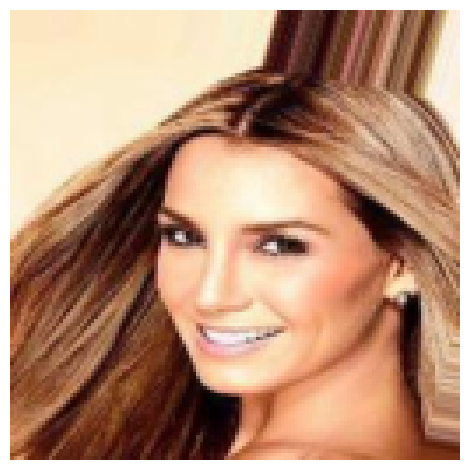

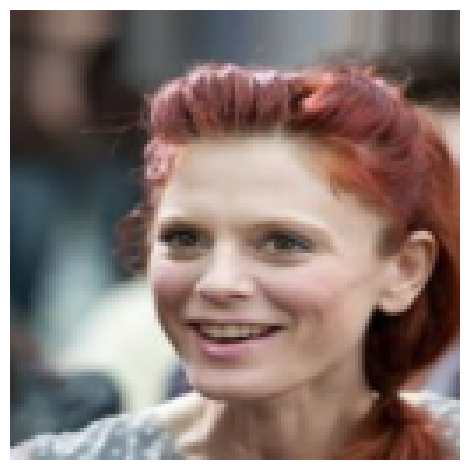

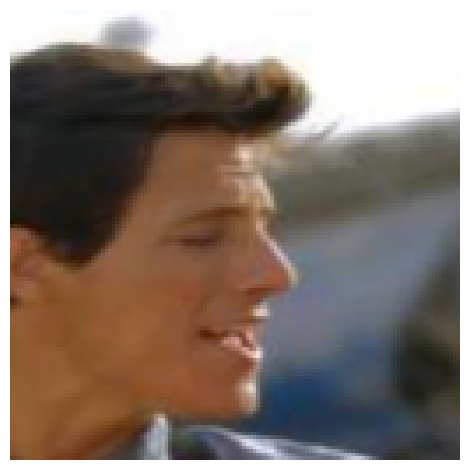

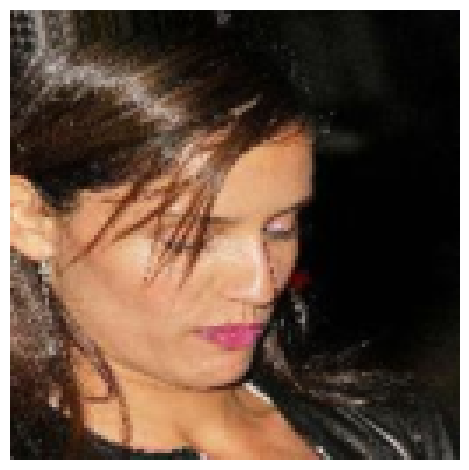

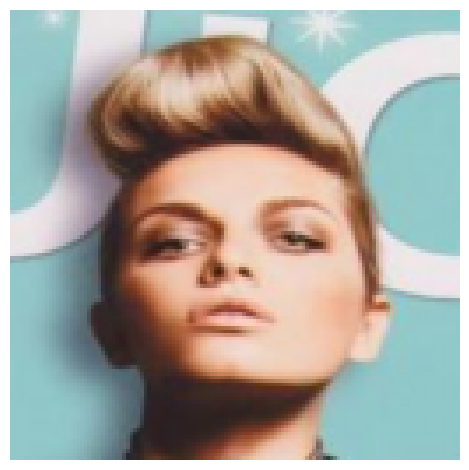

...

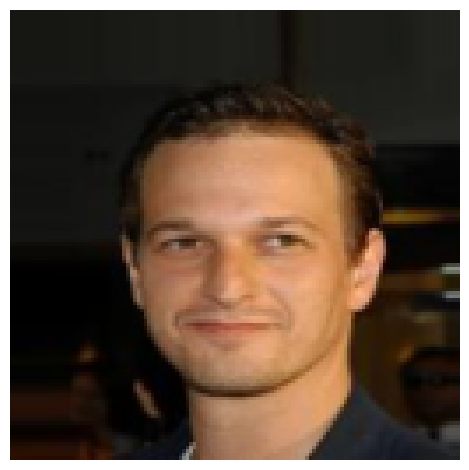

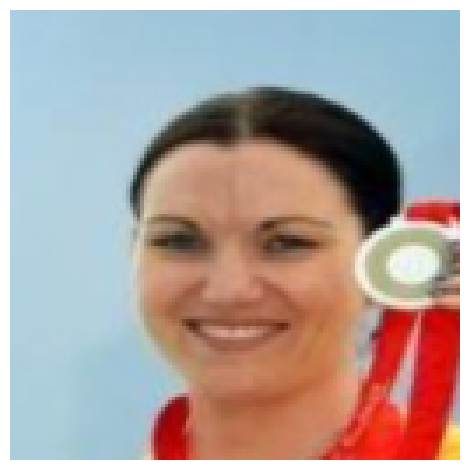

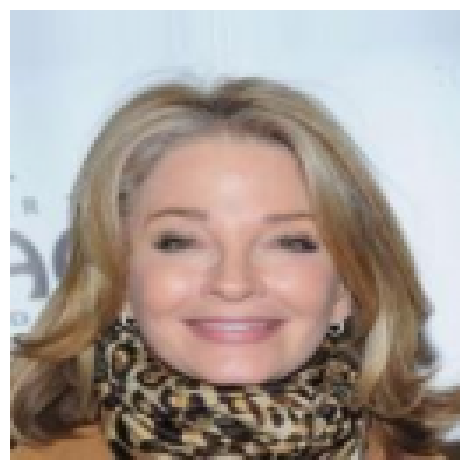

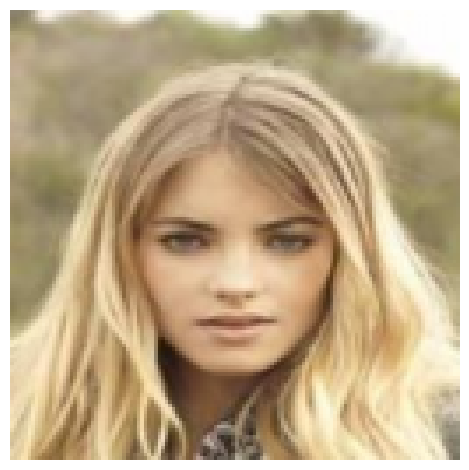

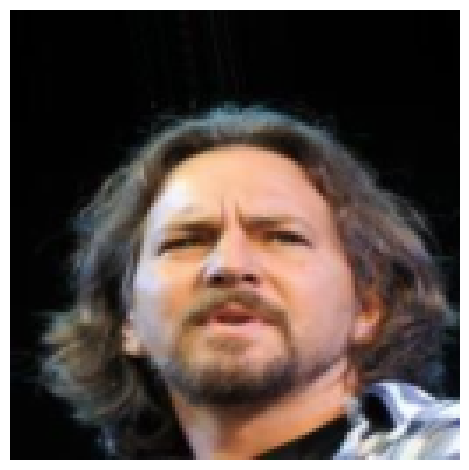

In [6]:
# 0 - 1

g_model_path = './temp_2_3/Diffusion_00_CelebA_models_sample_20_data_Traing_03/'
g_video_path = './temp_2_3/Diffusion_00_CelebA_videos_sample_20_data_Traing_03/'
g_log_path = './temp_2_3/log/Diffusion_00_CelebA_videos_sample_20_data_Traing_03/'
Path(g_model_path).mkdir(exist_ok=True, parents=True)
Path(g_video_path).mkdir(exist_ok=True, parents=True)
g_writer = SummaryWriter(g_log_path)

# parameters
n_steps = 1000
batch_size = 4
nsample = batch_size * 5
epoches = n_steps * nsample * 100
eval_step = nsample
nb_images = 4
img_channel = 3

# datasets

transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.Resize((128, 128),interpolation=transforms.InterpolationMode.BILINEAR, antialias=True),
                transforms.Normalize(mean=(0.5), std=(0.5)) # Normalizes to [-1, 1]
            ])
dataset = datasets.CelebA(root='./temp/data', split='train', download=True, transform = transform)
len(dataset)

data_sz = len(dataset)
# subset_sz = int(data_sz * 0.0005)
indices = list(range(nsample))
for i in indices:
    img_t = dataset[i][0]
    print(img_t.shape)
    img_t = (img_t + 1.0) * 0.5
    ts.show(img_t)



Epoch - 0 / 2000000- Loss: 5.33904; step 4; epoch 0: 100%|██████████| 5/5 [00:01<00:00,  2.62it/s]


best loss : 5.339039981365204


Sampling: 100%|██████████| 1000/1000 [01:58<00:00,  8.45it/s]
INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.FFMpegWriter'>
INFO:matplotlib.animation:MovieWriter._run: running command: ffmpeg -f rawvideo -vcodec rawvideo -s 640x480 -pix_fmt rgba -framerate 10 -loglevel error -i pipe: -vcodec h264 -pix_fmt yuv420p -y ./temp_2_3/Diffusion_00_CelebA_videos_sample_20_data_Traing_03/test_000.mp4
DPM-Solver Sampling: 100%|██████████| 10/10 [00:02<00:00,  4.57it/s]


ddpm - 118.79006, ddim - 5.84465, dpm_sampling - 2.18760


Epoch - 1 / 2000000- Loss: 4.24156; step 4; epoch 1: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]


best loss : 4.241560161113739


Epoch - 2 / 2000000- Loss: 3.71179; step 4; epoch 2: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]


best loss : 3.711789608001709


Epoch - 3 / 2000000- Loss: 2.90205; step 4; epoch 3: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]


best loss : 2.9020466208457947


Epoch - 4 / 2000000- Loss: 2.39173; step 4; epoch 4: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]


best loss : 2.3917346596717834


Epoch - 5 / 2000000- Loss: 2.09678; step 4; epoch 5: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]


best loss : 2.0967789590358734


Epoch - 6 / 2000000- Loss: 1.52593; step 4; epoch 6: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]


best loss : 1.5259262323379517


Epoch - 7 / 2000000- Loss: 1.42948; step 4; epoch 7: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]


best loss : 1.4294778406620026


Epoch - 8 / 2000000- Loss: 1.07884; step 4; epoch 8: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]


best loss : 1.0788388848304749


Epoch - 9 / 2000000- Loss: 1.09864; step 4; epoch 9: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 10 / 2000000- Loss: 0.78826; step 4; epoch 10: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]


best loss : 0.7882643043994904


Epoch - 11 / 2000000- Loss: 0.87843; step 4; epoch 11: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 12 / 2000000- Loss: 0.75165; step 4; epoch 12: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]


best loss : 0.751645103096962


Epoch - 13 / 2000000- Loss: 0.75722; step 4; epoch 13: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 14 / 2000000- Loss: 0.81312; step 4; epoch 14: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 15 / 2000000- Loss: 0.97875; step 4; epoch 15: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 16 / 2000000- Loss: 0.76205; step 4; epoch 16: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 17 / 2000000- Loss: 0.64151; step 4; epoch 17: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]


best loss : 0.6415055319666862


Epoch - 18 / 2000000- Loss: 0.62168; step 4; epoch 18: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]


best loss : 0.6216755285859108


Epoch - 19 / 2000000- Loss: 0.51974; step 4; epoch 19: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]


best loss : 0.5197436064481735


Epoch - 20 / 2000000- Loss: 0.54658; step 4; epoch 20: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 21 / 2000000- Loss: 0.80669; step 4; epoch 21: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 22 / 2000000- Loss: 0.80382; step 4; epoch 22: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 23 / 2000000- Loss: 0.48246; step 4; epoch 23: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]


best loss : 0.48246338218450546


Epoch - 24 / 2000000- Loss: 0.50662; step 4; epoch 24: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 25 / 2000000- Loss: 0.40781; step 4; epoch 25: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]


best loss : 0.40781471133232117


Epoch - 26 / 2000000- Loss: 0.66908; step 4; epoch 26: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 27 / 2000000- Loss: 0.72356; step 4; epoch 27: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 28 / 2000000- Loss: 0.35366; step 4; epoch 28: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]


best loss : 0.3536599949002266


Epoch - 29 / 2000000- Loss: 0.44111; step 4; epoch 29: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 30 / 2000000- Loss: 0.50521; step 4; epoch 30: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 31 / 2000000- Loss: 0.67404; step 4; epoch 31: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 32 / 2000000- Loss: 0.39367; step 4; epoch 32: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 33 / 2000000- Loss: 0.70209; step 4; epoch 33: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 34 / 2000000- Loss: 0.58490; step 4; epoch 34: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 35 / 2000000- Loss: 0.64848; step 4; epoch 35: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 36 / 2000000- Loss: 0.42978; step 4; epoch 36: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 37 / 2000000- Loss: 0.52628; step 4; epoch 37: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 38 / 2000000- Loss: 0.43796; step 4; epoch 38: 100%|██████████| 5/5 [00:01<00:00,  

best loss : 0.3336532898247242


Epoch - 42 / 2000000- Loss: 0.38202; step 4; epoch 42: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 43 / 2000000- Loss: 0.65343; step 4; epoch 43: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 44 / 2000000- Loss: 0.38307; step 4; epoch 44: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 45 / 2000000- Loss: 0.35568; step 4; epoch 45: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 46 / 2000000- Loss: 0.46805; step 4; epoch 46: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 47 / 2000000- Loss: 0.60664; step 4; epoch 47: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 48 / 2000000- Loss: 0.46561; step 4; epoch 48: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 49 / 2000000- Loss: 0.54437; step 4; epoch 49: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 50 / 2000000- Loss: 0.45674; step 4; epoch 50: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 51 / 2000000- Loss: 0.32091; step 4; epoch 51: 100%|██████████| 5/5 [00:01<00:00,  

best loss : 0.32091496139764786


Epoch - 52 / 2000000- Loss: 0.59428; step 4; epoch 52: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 53 / 2000000- Loss: 0.40634; step 4; epoch 53: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 54 / 2000000- Loss: 0.42950; step 4; epoch 54: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 55 / 2000000- Loss: 0.41654; step 4; epoch 55: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 56 / 2000000- Loss: 0.40558; step 4; epoch 56: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 57 / 2000000- Loss: 0.40135; step 4; epoch 57: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 58 / 2000000- Loss: 0.42416; step 4; epoch 58: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 59 / 2000000- Loss: 0.45118; step 4; epoch 59: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 60 / 2000000- Loss: 0.51724; step 4; epoch 60: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 61 / 2000000- Loss: 0.50151; step 4; epoch 61: 100%|██████████| 5/5 [00:01<00:00,  

best loss : 0.2764892391860485


Epoch - 63 / 2000000- Loss: 0.49119; step 4; epoch 63: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 64 / 2000000- Loss: 0.33188; step 4; epoch 64: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 65 / 2000000- Loss: 0.27763; step 4; epoch 65: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 66 / 2000000- Loss: 0.30352; step 4; epoch 66: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 67 / 2000000- Loss: 0.39601; step 4; epoch 67: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 68 / 2000000- Loss: 0.35380; step 4; epoch 68: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 69 / 2000000- Loss: 0.27447; step 4; epoch 69: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]


best loss : 0.2744653820991516


Epoch - 70 / 2000000- Loss: 0.39590; step 4; epoch 70: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 71 / 2000000- Loss: 0.31403; step 4; epoch 71: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 72 / 2000000- Loss: 0.43883; step 4; epoch 72: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 73 / 2000000- Loss: 0.49347; step 4; epoch 73: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 74 / 2000000- Loss: 0.34795; step 4; epoch 74: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 75 / 2000000- Loss: 0.29857; step 4; epoch 75: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 76 / 2000000- Loss: 0.28244; step 4; epoch 76: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 77 / 2000000- Loss: 0.54029; step 4; epoch 77: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 78 / 2000000- Loss: 0.51332; step 4; epoch 78: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 79 / 2000000- Loss: 0.31824; step 4; epoch 79: 100%|██████████| 5/5 [00:01<00:00,  

best loss : 0.2387736812233925


Epoch - 81 / 2000000- Loss: 0.30591; step 4; epoch 81: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 82 / 2000000- Loss: 0.56174; step 4; epoch 82: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 83 / 2000000- Loss: 0.26669; step 4; epoch 83: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 84 / 2000000- Loss: 0.46911; step 4; epoch 84: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 85 / 2000000- Loss: 0.41360; step 4; epoch 85: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 86 / 2000000- Loss: 0.23180; step 4; epoch 86: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]


best loss : 0.23179755359888077


Epoch - 87 / 2000000- Loss: 0.23949; step 4; epoch 87: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 88 / 2000000- Loss: 0.29803; step 4; epoch 88: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 89 / 2000000- Loss: 0.28971; step 4; epoch 89: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 90 / 2000000- Loss: 0.28787; step 4; epoch 90: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 91 / 2000000- Loss: 0.49892; step 4; epoch 91: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 92 / 2000000- Loss: 0.56858; step 4; epoch 92: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 93 / 2000000- Loss: 0.32726; step 4; epoch 93: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 94 / 2000000- Loss: 0.29214; step 4; epoch 94: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 95 / 2000000- Loss: 0.36072; step 4; epoch 95: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 96 / 2000000- Loss: 0.33390; step 4; epoch 96: 100%|██████████| 5/5 [00:01<00:00,  

best loss : 0.2127721644937992


Epoch - 102 / 2000000- Loss: 0.23390; step 4; epoch 102: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 103 / 2000000- Loss: 0.41866; step 4; epoch 103: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 104 / 2000000- Loss: 0.21713; step 4; epoch 104: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 105 / 2000000- Loss: 0.21884; step 4; epoch 105: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 106 / 2000000- Loss: 0.41983; step 4; epoch 106: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 107 / 2000000- Loss: 0.26721; step 4; epoch 107: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 108 / 2000000- Loss: 0.19793; step 4; epoch 108: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]


best loss : 0.19793282449245453


Epoch - 109 / 2000000- Loss: 0.27672; step 4; epoch 109: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 110 / 2000000- Loss: 0.60035; step 4; epoch 110: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 111 / 2000000- Loss: 0.38699; step 4; epoch 111: 100%|██████████| 5/5 [00:01<00:00,  2.93it/s]
Epoch - 112 / 2000000- Loss: 0.28809; step 4; epoch 112: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 113 / 2000000- Loss: 0.40440; step 4; epoch 113: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 114 / 2000000- Loss: 0.23001; step 4; epoch 114: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 115 / 2000000- Loss: 0.37060; step 4; epoch 115: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 116 / 2000000- Loss: 0.23471; step 4; epoch 116: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 117 / 2000000- Loss: 0.25501; step 4; epoch 117: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 118 / 2000000- Loss: 0.19657; step 4; epoch 118: 100%|██████████|

best loss : 0.19657349959015846


Epoch - 119 / 2000000- Loss: 0.36034; step 4; epoch 119: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 120 / 2000000- Loss: 0.22478; step 4; epoch 120: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 121 / 2000000- Loss: 0.48550; step 4; epoch 121: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 122 / 2000000- Loss: 0.21203; step 4; epoch 122: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 123 / 2000000- Loss: 0.24508; step 4; epoch 123: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 124 / 2000000- Loss: 0.22713; step 4; epoch 124: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 125 / 2000000- Loss: 0.20761; step 4; epoch 125: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 126 / 2000000- Loss: 0.24205; step 4; epoch 126: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 127 / 2000000- Loss: 0.21953; step 4; epoch 127: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 128 / 2000000- Loss: 0.21094; step 4; epoch 128: 100%|██████████|

best loss : 0.19574462436139584


Epoch - 132 / 2000000- Loss: 0.37872; step 4; epoch 132: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 133 / 2000000- Loss: 0.30939; step 4; epoch 133: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 134 / 2000000- Loss: 0.24985; step 4; epoch 134: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 135 / 2000000- Loss: 0.22057; step 4; epoch 135: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 136 / 2000000- Loss: 0.19589; step 4; epoch 136: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 137 / 2000000- Loss: 0.18330; step 4; epoch 137: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]


best loss : 0.1833040900528431


Epoch - 138 / 2000000- Loss: 0.38122; step 4; epoch 138: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 139 / 2000000- Loss: 0.23164; step 4; epoch 139: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 140 / 2000000- Loss: 0.15646; step 4; epoch 140: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]


best loss : 0.15646353736519814


Epoch - 141 / 2000000- Loss: 0.17782; step 4; epoch 141: 100%|██████████| 5/5 [00:01<00:00,  2.93it/s]
Epoch - 142 / 2000000- Loss: 0.20872; step 4; epoch 142: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 143 / 2000000- Loss: 0.14751; step 4; epoch 143: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]


best loss : 0.14751376397907734


Epoch - 144 / 2000000- Loss: 0.34532; step 4; epoch 144: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 145 / 2000000- Loss: 0.41471; step 4; epoch 145: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 146 / 2000000- Loss: 0.18181; step 4; epoch 146: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 147 / 2000000- Loss: 0.34359; step 4; epoch 147: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 148 / 2000000- Loss: 0.16866; step 4; epoch 148: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 149 / 2000000- Loss: 0.29333; step 4; epoch 149: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 150 / 2000000- Loss: 0.24126; step 4; epoch 150: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 151 / 2000000- Loss: 0.20916; step 4; epoch 151: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 152 / 2000000- Loss: 0.30270; step 4; epoch 152: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 153 / 2000000- Loss: 0.19606; step 4; epoch 153: 100%|██████████|

best loss : 0.1434210818260908


Epoch - 169 / 2000000- Loss: 0.22849; step 4; epoch 169: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 170 / 2000000- Loss: 0.27756; step 4; epoch 170: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 171 / 2000000- Loss: 0.16340; step 4; epoch 171: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 172 / 2000000- Loss: 0.41730; step 4; epoch 172: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 173 / 2000000- Loss: 0.17084; step 4; epoch 173: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 174 / 2000000- Loss: 0.15967; step 4; epoch 174: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 175 / 2000000- Loss: 0.14161; step 4; epoch 175: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]


best loss : 0.14160634391009808


Epoch - 176 / 2000000- Loss: 0.44628; step 4; epoch 176: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 177 / 2000000- Loss: 0.34214; step 4; epoch 177: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 178 / 2000000- Loss: 0.27978; step 4; epoch 178: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 179 / 2000000- Loss: 0.33747; step 4; epoch 179: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 180 / 2000000- Loss: 0.16010; step 4; epoch 180: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 181 / 2000000- Loss: 0.16730; step 4; epoch 181: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 182 / 2000000- Loss: 0.22250; step 4; epoch 182: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 183 / 2000000- Loss: 0.21937; step 4; epoch 183: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 184 / 2000000- Loss: 0.31679; step 4; epoch 184: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 185 / 2000000- Loss: 0.18791; step 4; epoch 185: 100%|██████████|

best loss : 0.1384271066635847


Epoch - 194 / 2000000- Loss: 0.26683; step 4; epoch 194: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 195 / 2000000- Loss: 0.20443; step 4; epoch 195: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 196 / 2000000- Loss: 0.19592; step 4; epoch 196: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 197 / 2000000- Loss: 0.16115; step 4; epoch 197: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 198 / 2000000- Loss: 0.27717; step 4; epoch 198: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 199 / 2000000- Loss: 0.15612; step 4; epoch 199: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 200 / 2000000- Loss: 0.21431; step 4; epoch 200: 100%|██████████| 5/5 [00:01<00:00,  2.93it/s]
Sampling: 100%|██████████| 1000/1000 [01:59<00:00,  8.39it/s]
INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.FFMpegWriter'>
INFO:matplotlib.animation:MovieWriter._run: running command: ffmpeg -f rawvideo -vcodec rawvideo -s 640x480 -pix_fmt rgba -fra

ddpm - 119.04956, ddim - 5.84612, dpm_sampling - 2.18404


Epoch - 201 / 2000000- Loss: 0.30304; step 4; epoch 201: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 202 / 2000000- Loss: 0.20595; step 4; epoch 202: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 203 / 2000000- Loss: 0.16946; step 4; epoch 203: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 204 / 2000000- Loss: 0.31274; step 4; epoch 204: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 205 / 2000000- Loss: 0.32123; step 4; epoch 205: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 206 / 2000000- Loss: 0.20598; step 4; epoch 206: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 207 / 2000000- Loss: 0.16921; step 4; epoch 207: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 208 / 2000000- Loss: 0.18389; step 4; epoch 208: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 209 / 2000000- Loss: 0.11639; step 4; epoch 209: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]


best loss : 0.11638546362519264


Epoch - 210 / 2000000- Loss: 0.15960; step 4; epoch 210: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 211 / 2000000- Loss: 0.18487; step 4; epoch 211: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 212 / 2000000- Loss: 0.19399; step 4; epoch 212: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 213 / 2000000- Loss: 0.20619; step 4; epoch 213: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 214 / 2000000- Loss: 0.16680; step 4; epoch 214: 100%|██████████| 5/5 [00:01<00:00,  2.93it/s]
Epoch - 215 / 2000000- Loss: 0.17907; step 4; epoch 215: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 216 / 2000000- Loss: 0.22551; step 4; epoch 216: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 217 / 2000000- Loss: 0.19023; step 4; epoch 217: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 218 / 2000000- Loss: 0.15305; step 4; epoch 218: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 219 / 2000000- Loss: 0.14513; step 4; epoch 219: 100%|██████████|

best loss : 0.1100367046892643


Epoch - 231 / 2000000- Loss: 0.45561; step 4; epoch 231: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 232 / 2000000- Loss: 0.22895; step 4; epoch 232: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 233 / 2000000- Loss: 0.20446; step 4; epoch 233: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 234 / 2000000- Loss: 0.15548; step 4; epoch 234: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 235 / 2000000- Loss: 0.15543; step 4; epoch 235: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 236 / 2000000- Loss: 0.18999; step 4; epoch 236: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 237 / 2000000- Loss: 0.12456; step 4; epoch 237: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 238 / 2000000- Loss: 0.14433; step 4; epoch 238: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 239 / 2000000- Loss: 0.17448; step 4; epoch 239: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 240 / 2000000- Loss: 0.12168; step 4; epoch 240: 100%|██████████|

best loss : 0.10380853805691004


Epoch - 251 / 2000000- Loss: 0.15815; step 4; epoch 251: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 252 / 2000000- Loss: 0.22388; step 4; epoch 252: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 253 / 2000000- Loss: 0.19180; step 4; epoch 253: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 254 / 2000000- Loss: 0.25835; step 4; epoch 254: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 255 / 2000000- Loss: 0.17757; step 4; epoch 255: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 256 / 2000000- Loss: 0.16920; step 4; epoch 256: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 257 / 2000000- Loss: 0.18317; step 4; epoch 257: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 258 / 2000000- Loss: 0.14638; step 4; epoch 258: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 259 / 2000000- Loss: 0.12177; step 4; epoch 259: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 260 / 2000000- Loss: 0.26388; step 4; epoch 260: 100%|██████████|

best loss : 0.10321847256273031


Epoch - 295 / 2000000- Loss: 0.14200; step 4; epoch 295: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 296 / 2000000- Loss: 0.16877; step 4; epoch 296: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 297 / 2000000- Loss: 0.13252; step 4; epoch 297: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 298 / 2000000- Loss: 0.19626; step 4; epoch 298: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 299 / 2000000- Loss: 0.16934; step 4; epoch 299: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 300 / 2000000- Loss: 0.08920; step 4; epoch 300: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]


best loss : 0.08920055441558361


Epoch - 301 / 2000000- Loss: 0.15524; step 4; epoch 301: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 302 / 2000000- Loss: 0.29652; step 4; epoch 302: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 303 / 2000000- Loss: 0.13820; step 4; epoch 303: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 304 / 2000000- Loss: 0.13028; step 4; epoch 304: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 305 / 2000000- Loss: 0.10462; step 4; epoch 305: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 306 / 2000000- Loss: 0.13343; step 4; epoch 306: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 307 / 2000000- Loss: 0.11015; step 4; epoch 307: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 308 / 2000000- Loss: 0.10998; step 4; epoch 308: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 309 / 2000000- Loss: 0.19940; step 4; epoch 309: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 310 / 2000000- Loss: 0.23979; step 4; epoch 310: 100%|██████████|

best loss : 0.07960456516593695


Epoch - 316 / 2000000- Loss: 0.22182; step 4; epoch 316: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 317 / 2000000- Loss: 0.20935; step 4; epoch 317: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 318 / 2000000- Loss: 0.16070; step 4; epoch 318: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 319 / 2000000- Loss: 0.16870; step 4; epoch 319: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 320 / 2000000- Loss: 0.07210; step 4; epoch 320: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]


best loss : 0.07209960836917162


Epoch - 321 / 2000000- Loss: 0.13799; step 4; epoch 321: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 322 / 2000000- Loss: 0.30796; step 4; epoch 322: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 323 / 2000000- Loss: 0.16512; step 4; epoch 323: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 324 / 2000000- Loss: 0.09726; step 4; epoch 324: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 325 / 2000000- Loss: 0.10495; step 4; epoch 325: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 326 / 2000000- Loss: 0.25522; step 4; epoch 326: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 327 / 2000000- Loss: 0.18677; step 4; epoch 327: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 328 / 2000000- Loss: 0.09718; step 4; epoch 328: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 329 / 2000000- Loss: 0.08215; step 4; epoch 329: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 330 / 2000000- Loss: 0.15288; step 4; epoch 330: 100%|██████████|

best loss : 0.06863092351704836


Epoch - 396 / 2000000- Loss: 0.14115; step 4; epoch 396: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 397 / 2000000- Loss: 0.13028; step 4; epoch 397: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 398 / 2000000- Loss: 0.05402; step 4; epoch 398: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]


best loss : 0.0540184760466218


Epoch - 399 / 2000000- Loss: 0.24441; step 4; epoch 399: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 400 / 2000000- Loss: 0.13681; step 4; epoch 400: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Sampling: 100%|██████████| 1000/1000 [01:59<00:00,  8.40it/s]
INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.FFMpegWriter'>
INFO:matplotlib.animation:MovieWriter._run: running command: ffmpeg -f rawvideo -vcodec rawvideo -s 640x480 -pix_fmt rgba -framerate 10 -loglevel error -i pipe: -vcodec h264 -pix_fmt yuv420p -y ./temp_2_3/Diffusion_00_CelebA_videos_sample_20_data_Traing_03/test_400.mp4
DPM-Solver Sampling: 100%|██████████| 10/10 [00:02<00:00,  4.56it/s]


ddpm - 119.08799, ddim - 5.86466, dpm_sampling - 2.19379


Epoch - 401 / 2000000- Loss: 0.09769; step 4; epoch 401: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 402 / 2000000- Loss: 0.10166; step 4; epoch 402: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 403 / 2000000- Loss: 0.18909; step 4; epoch 403: 100%|██████████| 5/5 [00:01<00:00,  2.93it/s]
Epoch - 404 / 2000000- Loss: 0.13958; step 4; epoch 404: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 405 / 2000000- Loss: 0.38016; step 4; epoch 405: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 406 / 2000000- Loss: 0.20144; step 4; epoch 406: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 407 / 2000000- Loss: 0.22624; step 4; epoch 407: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 408 / 2000000- Loss: 0.13398; step 4; epoch 408: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 409 / 2000000- Loss: 0.07894; step 4; epoch 409: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 410 / 2000000- Loss: 0.10816; step 4; epoch 410: 100%|██████████|

ddpm - 119.40796, ddim - 5.86731, dpm_sampling - 2.19328


Epoch - 601 / 2000000- Loss: 0.06652; step 4; epoch 601: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 602 / 2000000- Loss: 0.11975; step 4; epoch 602: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 603 / 2000000- Loss: 0.09838; step 4; epoch 603: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 604 / 2000000- Loss: 0.22076; step 4; epoch 604: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 605 / 2000000- Loss: 0.11068; step 4; epoch 605: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 606 / 2000000- Loss: 0.07078; step 4; epoch 606: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 607 / 2000000- Loss: 0.07843; step 4; epoch 607: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 608 / 2000000- Loss: 0.22828; step 4; epoch 608: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 609 / 2000000- Loss: 0.06298; step 4; epoch 609: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 610 / 2000000- Loss: 0.12335; step 4; epoch 610: 100%|██████████|

best loss : 0.05298616550862789


Epoch - 627 / 2000000- Loss: 0.21353; step 4; epoch 627: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 628 / 2000000- Loss: 0.09604; step 4; epoch 628: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 629 / 2000000- Loss: 0.10285; step 4; epoch 629: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 630 / 2000000- Loss: 0.08516; step 4; epoch 630: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 631 / 2000000- Loss: 0.12426; step 4; epoch 631: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 632 / 2000000- Loss: 0.05798; step 4; epoch 632: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 633 / 2000000- Loss: 0.11321; step 4; epoch 633: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 634 / 2000000- Loss: 0.05725; step 4; epoch 634: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 635 / 2000000- Loss: 0.15462; step 4; epoch 635: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 636 / 2000000- Loss: 0.06792; step 4; epoch 636: 100%|██████████|

best loss : 0.04450000263750553


Epoch - 641 / 2000000- Loss: 0.05501; step 4; epoch 641: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 642 / 2000000- Loss: 0.11727; step 4; epoch 642: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 643 / 2000000- Loss: 0.25185; step 4; epoch 643: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 644 / 2000000- Loss: 0.18752; step 4; epoch 644: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 645 / 2000000- Loss: 0.11450; step 4; epoch 645: 100%|██████████| 5/5 [00:01<00:00,  2.93it/s]
Epoch - 646 / 2000000- Loss: 0.06992; step 4; epoch 646: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 647 / 2000000- Loss: 0.15424; step 4; epoch 647: 100%|██████████| 5/5 [00:01<00:00,  2.93it/s]
Epoch - 648 / 2000000- Loss: 0.09256; step 4; epoch 648: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 649 / 2000000- Loss: 0.09138; step 4; epoch 649: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 650 / 2000000- Loss: 0.05491; step 4; epoch 650: 100%|██████████|

best loss : 0.04048949386924505


Epoch - 777 / 2000000- Loss: 0.10909; step 4; epoch 777: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 778 / 2000000- Loss: 0.16615; step 4; epoch 778: 100%|██████████| 5/5 [00:01<00:00,  2.93it/s]
Epoch - 779 / 2000000- Loss: 0.16284; step 4; epoch 779: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 780 / 2000000- Loss: 0.04979; step 4; epoch 780: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 781 / 2000000- Loss: 0.06603; step 4; epoch 781: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 782 / 2000000- Loss: 0.15263; step 4; epoch 782: 100%|██████████| 5/5 [00:01<00:00,  2.93it/s]
Epoch - 783 / 2000000- Loss: 0.19061; step 4; epoch 783: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 784 / 2000000- Loss: 0.12370; step 4; epoch 784: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 785 / 2000000- Loss: 0.05146; step 4; epoch 785: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 786 / 2000000- Loss: 0.06914; step 4; epoch 786: 100%|██████████|

ddpm - 119.21039, ddim - 5.85914, dpm_sampling - 2.18275


Epoch - 801 / 2000000- Loss: 0.16809; step 4; epoch 801: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 802 / 2000000- Loss: 0.17044; step 4; epoch 802: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 803 / 2000000- Loss: 0.18562; step 4; epoch 803: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 804 / 2000000- Loss: 0.08372; step 4; epoch 804: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 805 / 2000000- Loss: 0.16978; step 4; epoch 805: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 806 / 2000000- Loss: 0.07031; step 4; epoch 806: 100%|██████████| 5/5 [00:01<00:00,  2.93it/s]
Epoch - 807 / 2000000- Loss: 0.05883; step 4; epoch 807: 100%|██████████| 5/5 [00:01<00:00,  2.93it/s]
Epoch - 808 / 2000000- Loss: 0.10260; step 4; epoch 808: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 809 / 2000000- Loss: 0.06700; step 4; epoch 809: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 810 / 2000000- Loss: 0.05515; step 4; epoch 810: 100%|██████████|

best loss : 0.03077187156304717


Epoch - 893 / 2000000- Loss: 0.09183; step 4; epoch 893: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 894 / 2000000- Loss: 0.06909; step 4; epoch 894: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 895 / 2000000- Loss: 0.09478; step 4; epoch 895: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 896 / 2000000- Loss: 0.09134; step 4; epoch 896: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 897 / 2000000- Loss: 0.12813; step 4; epoch 897: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 898 / 2000000- Loss: 0.07958; step 4; epoch 898: 100%|██████████| 5/5 [00:01<00:00,  2.93it/s]
Epoch - 899 / 2000000- Loss: 0.18034; step 4; epoch 899: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 900 / 2000000- Loss: 0.23032; step 4; epoch 900: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 901 / 2000000- Loss: 0.08204; step 4; epoch 901: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 902 / 2000000- Loss: 0.13762; step 4; epoch 902: 100%|██████████|

best loss : 0.027632745448499918


Epoch - 913 / 2000000- Loss: 0.10353; step 4; epoch 913: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 914 / 2000000- Loss: 0.08075; step 4; epoch 914: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 915 / 2000000- Loss: 0.10254; step 4; epoch 915: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 916 / 2000000- Loss: 0.15075; step 4; epoch 916: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 917 / 2000000- Loss: 0.06882; step 4; epoch 917: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 918 / 2000000- Loss: 0.22297; step 4; epoch 918: 100%|██████████| 5/5 [00:01<00:00,  2.93it/s]
Epoch - 919 / 2000000- Loss: 0.04110; step 4; epoch 919: 100%|██████████| 5/5 [00:01<00:00,  2.93it/s]
Epoch - 920 / 2000000- Loss: 0.07054; step 4; epoch 920: 100%|██████████| 5/5 [00:01<00:00,  2.93it/s]
Epoch - 921 / 2000000- Loss: 0.07083; step 4; epoch 921: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 922 / 2000000- Loss: 0.07226; step 4; epoch 922: 100%|██████████|

ddpm - 113.97258, ddim - 5.66208, dpm_sampling - 2.14305


Epoch - 1001 / 2000000- Loss: 0.10643; step 4; epoch 1001: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 1002 / 2000000- Loss: 0.10517; step 4; epoch 1002: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 1003 / 2000000- Loss: 0.25900; step 4; epoch 1003: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1004 / 2000000- Loss: 0.10819; step 4; epoch 1004: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1005 / 2000000- Loss: 0.07158; step 4; epoch 1005: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1006 / 2000000- Loss: 0.05205; step 4; epoch 1006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 1007 / 2000000- Loss: 0.11477; step 4; epoch 1007: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1008 / 2000000- Loss: 0.07739; step 4; epoch 1008: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1009 / 2000000- Loss: 0.03752; step 4; epoch 1009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 1010 / 2000000- Loss: 0.12723; step 4; epoch 10

best loss : 0.025243613170459867


Epoch - 1036 / 2000000- Loss: 0.05182; step 4; epoch 1036: 100%|██████████| 5/5 [00:01<00:00,  3.10it/s]
Epoch - 1037 / 2000000- Loss: 0.06800; step 4; epoch 1037: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1038 / 2000000- Loss: 0.06551; step 4; epoch 1038: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 1039 / 2000000- Loss: 0.03376; step 4; epoch 1039: 100%|██████████| 5/5 [00:01<00:00,  3.10it/s]
Epoch - 1040 / 2000000- Loss: 0.03799; step 4; epoch 1040: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1041 / 2000000- Loss: 0.06495; step 4; epoch 1041: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 1042 / 2000000- Loss: 0.12755; step 4; epoch 1042: 100%|██████████| 5/5 [00:01<00:00,  3.10it/s]
Epoch - 1043 / 2000000- Loss: 0.05496; step 4; epoch 1043: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 1044 / 2000000- Loss: 0.05425; step 4; epoch 1044: 100%|██████████| 5/5 [00:01<00:00,  3.10it/s]
Epoch - 1045 / 2000000- Loss: 0.06863; step 4; epoch 10

ddpm - 114.04231, ddim - 5.65208, dpm_sampling - 2.14743


Epoch - 1201 / 2000000- Loss: 0.07240; step 4; epoch 1201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 1202 / 2000000- Loss: 0.17063; step 4; epoch 1202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 1203 / 2000000- Loss: 0.20788; step 4; epoch 1203: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 1204 / 2000000- Loss: 0.09336; step 4; epoch 1204: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 1205 / 2000000- Loss: 0.04400; step 4; epoch 1205: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1206 / 2000000- Loss: 0.04359; step 4; epoch 1206: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1207 / 2000000- Loss: 0.06307; step 4; epoch 1207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 1208 / 2000000- Loss: 0.12416; step 4; epoch 1208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 1209 / 2000000- Loss: 0.07223; step 4; epoch 1209: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1210 / 2000000- Loss: 0.14533; step 4; epoch 12

best loss : 0.02396096638403833


Epoch - 1322 / 2000000- Loss: 0.09933; step 4; epoch 1322: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1323 / 2000000- Loss: 0.18569; step 4; epoch 1323: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 1324 / 2000000- Loss: 0.18859; step 4; epoch 1324: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1325 / 2000000- Loss: 0.15003; step 4; epoch 1325: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1326 / 2000000- Loss: 0.09818; step 4; epoch 1326: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1327 / 2000000- Loss: 0.04994; step 4; epoch 1327: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1328 / 2000000- Loss: 0.06517; step 4; epoch 1328: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 1329 / 2000000- Loss: 0.04513; step 4; epoch 1329: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1330 / 2000000- Loss: 0.03277; step 4; epoch 1330: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 1331 / 2000000- Loss: 0.05644; step 4; epoch 13

best loss : 0.022327544167637825


Epoch - 1364 / 2000000- Loss: 0.03472; step 4; epoch 1364: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 1365 / 2000000- Loss: 0.05130; step 4; epoch 1365: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1366 / 2000000- Loss: 0.01668; step 4; epoch 1366: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]


best loss : 0.016683622729033232


Epoch - 1367 / 2000000- Loss: 0.12889; step 4; epoch 1367: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 1368 / 2000000- Loss: 0.04734; step 4; epoch 1368: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1369 / 2000000- Loss: 0.03245; step 4; epoch 1369: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1370 / 2000000- Loss: 0.03617; step 4; epoch 1370: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1371 / 2000000- Loss: 0.06866; step 4; epoch 1371: 100%|██████████| 5/5 [00:01<00:00,  3.10it/s]
Epoch - 1372 / 2000000- Loss: 0.06483; step 4; epoch 1372: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1373 / 2000000- Loss: 0.10375; step 4; epoch 1373: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1374 / 2000000- Loss: 0.06425; step 4; epoch 1374: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1375 / 2000000- Loss: 0.06253; step 4; epoch 1375: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1376 / 2000000- Loss: 0.07505; step 4; epoch 13

ddpm - 114.08225, ddim - 5.66022, dpm_sampling - 2.14792


Epoch - 1401 / 2000000- Loss: 0.02543; step 4; epoch 1401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 1402 / 2000000- Loss: 0.16451; step 4; epoch 1402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 1403 / 2000000- Loss: 0.11162; step 4; epoch 1403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 1404 / 2000000- Loss: 0.04534; step 4; epoch 1404: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 1405 / 2000000- Loss: 0.06113; step 4; epoch 1405: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1406 / 2000000- Loss: 0.02639; step 4; epoch 1406: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1407 / 2000000- Loss: 0.05062; step 4; epoch 1407: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1408 / 2000000- Loss: 0.02883; step 4; epoch 1408: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1409 / 2000000- Loss: 0.05740; step 4; epoch 1409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 1410 / 2000000- Loss: 0.04162; step 4; epoch 14

best loss : 0.0163179284427315


Epoch - 1453 / 2000000- Loss: 0.05272; step 4; epoch 1453: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 1454 / 2000000- Loss: 0.03322; step 4; epoch 1454: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1455 / 2000000- Loss: 0.03559; step 4; epoch 1455: 100%|██████████| 5/5 [00:01<00:00,  3.10it/s]
Epoch - 1456 / 2000000- Loss: 0.02151; step 4; epoch 1456: 100%|██████████| 5/5 [00:01<00:00,  3.11it/s]
Epoch - 1457 / 2000000- Loss: 0.03645; step 4; epoch 1457: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1458 / 2000000- Loss: 0.12617; step 4; epoch 1458: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1459 / 2000000- Loss: 0.17544; step 4; epoch 1459: 100%|██████████| 5/5 [00:01<00:00,  3.10it/s]
Epoch - 1460 / 2000000- Loss: 0.19049; step 4; epoch 1460: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1461 / 2000000- Loss: 0.05566; step 4; epoch 1461: 100%|██████████| 5/5 [00:01<00:00,  3.10it/s]
Epoch - 1462 / 2000000- Loss: 0.02201; step 4; epoch 14

ddpm - 114.08393, ddim - 5.66120, dpm_sampling - 2.13976


Epoch - 1601 / 2000000- Loss: 0.04746; step 4; epoch 1601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 1602 / 2000000- Loss: 0.07073; step 4; epoch 1602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 1603 / 2000000- Loss: 0.06202; step 4; epoch 1603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 1604 / 2000000- Loss: 0.02945; step 4; epoch 1604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 1605 / 2000000- Loss: 0.01772; step 4; epoch 1605: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 1606 / 2000000- Loss: 0.06562; step 4; epoch 1606: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1607 / 2000000- Loss: 0.05346; step 4; epoch 1607: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1608 / 2000000- Loss: 0.06370; step 4; epoch 1608: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1609 / 2000000- Loss: 0.13777; step 4; epoch 1609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 1610 / 2000000- Loss: 0.03101; step 4; epoch 16

best loss : 0.01597618719097227


Epoch - 1682 / 2000000- Loss: 0.05198; step 4; epoch 1682: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1683 / 2000000- Loss: 0.07023; step 4; epoch 1683: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1684 / 2000000- Loss: 0.03821; step 4; epoch 1684: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1685 / 2000000- Loss: 0.01410; step 4; epoch 1685: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]


best loss : 0.014096768572926521


Epoch - 1686 / 2000000- Loss: 0.03391; step 4; epoch 1686: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1687 / 2000000- Loss: 0.06036; step 4; epoch 1687: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1688 / 2000000- Loss: 0.02562; step 4; epoch 1688: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1689 / 2000000- Loss: 0.10292; step 4; epoch 1689: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1690 / 2000000- Loss: 0.01930; step 4; epoch 1690: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1691 / 2000000- Loss: 0.05316; step 4; epoch 1691: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1692 / 2000000- Loss: 0.13325; step 4; epoch 1692: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1693 / 2000000- Loss: 0.05671; step 4; epoch 1693: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1694 / 2000000- Loss: 0.14605; step 4; epoch 1694: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1695 / 2000000- Loss: 0.18462; step 4; epoch 16

ddpm - 114.13571, ddim - 5.66884, dpm_sampling - 2.14384


Epoch - 1801 / 2000000- Loss: 0.05943; step 4; epoch 1801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 1802 / 2000000- Loss: 0.03948; step 4; epoch 1802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 1803 / 2000000- Loss: 0.04848; step 4; epoch 1803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 1804 / 2000000- Loss: 0.08614; step 4; epoch 1804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 1805 / 2000000- Loss: 0.02252; step 4; epoch 1805: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1806 / 2000000- Loss: 0.01877; step 4; epoch 1806: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1807 / 2000000- Loss: 0.04514; step 4; epoch 1807: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1808 / 2000000- Loss: 0.17013; step 4; epoch 1808: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 1809 / 2000000- Loss: 0.06935; step 4; epoch 1809: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1810 / 2000000- Loss: 0.05541; step 4; epoch 18

best loss : 0.011899898992851377


Epoch - 1882 / 2000000- Loss: 0.06073; step 4; epoch 1882: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1883 / 2000000- Loss: 0.04226; step 4; epoch 1883: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1884 / 2000000- Loss: 0.09857; step 4; epoch 1884: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1885 / 2000000- Loss: 0.01635; step 4; epoch 1885: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 1886 / 2000000- Loss: 0.08300; step 4; epoch 1886: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 1887 / 2000000- Loss: 0.04039; step 4; epoch 1887: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1888 / 2000000- Loss: 0.02840; step 4; epoch 1888: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1889 / 2000000- Loss: 0.07753; step 4; epoch 1889: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 1890 / 2000000- Loss: 0.03971; step 4; epoch 1890: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 1891 / 2000000- Loss: 0.04150; step 4; epoch 18

ddpm - 114.12977, ddim - 5.66094, dpm_sampling - 2.14314


Epoch - 2001 / 2000000- Loss: 0.10887; step 4; epoch 2001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 2002 / 2000000- Loss: 0.10282; step 4; epoch 2002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 2003 / 2000000- Loss: 0.02131; step 4; epoch 2003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 2004 / 2000000- Loss: 0.07454; step 4; epoch 2004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 2005 / 2000000- Loss: 0.17199; step 4; epoch 2005: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 2006 / 2000000- Loss: 0.09699; step 4; epoch 2006: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 2007 / 2000000- Loss: 0.08448; step 4; epoch 2007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 2008 / 2000000- Loss: 0.03135; step 4; epoch 2008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 2009 / 2000000- Loss: 0.05804; step 4; epoch 2009: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 2010 / 2000000- Loss: 0.07297; step 4; epoch 20

best loss : 0.010580496513284743


Epoch - 2091 / 2000000- Loss: 0.08645; step 4; epoch 2091: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 2092 / 2000000- Loss: 0.09037; step 4; epoch 2092: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 2093 / 2000000- Loss: 0.02224; step 4; epoch 2093: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 2094 / 2000000- Loss: 0.04472; step 4; epoch 2094: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 2095 / 2000000- Loss: 0.05419; step 4; epoch 2095: 100%|██████████| 5/5 [00:01<00:00,  3.10it/s]
Epoch - 2096 / 2000000- Loss: 0.04785; step 4; epoch 2096: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 2097 / 2000000- Loss: 0.02477; step 4; epoch 2097: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 2098 / 2000000- Loss: 0.03722; step 4; epoch 2098: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 2099 / 2000000- Loss: 0.07676; step 4; epoch 2099: 100%|██████████| 5/5 [00:01<00:00,  3.10it/s]
Epoch - 2100 / 2000000- Loss: 0.07958; step 4; epoch 21

ddpm - 114.13450, ddim - 5.66630, dpm_sampling - 2.14063


Epoch - 2201 / 2000000- Loss: 0.03367; step 4; epoch 2201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 2202 / 2000000- Loss: 0.07966; step 4; epoch 2202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 2203 / 2000000- Loss: 0.07977; step 4; epoch 2203: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 2204 / 2000000- Loss: 0.03320; step 4; epoch 2204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 2205 / 2000000- Loss: 0.20384; step 4; epoch 2205: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 2206 / 2000000- Loss: 0.17583; step 4; epoch 2206: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 2207 / 2000000- Loss: 0.03471; step 4; epoch 2207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 2208 / 2000000- Loss: 0.14299; step 4; epoch 2208: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 2209 / 2000000- Loss: 0.08919; step 4; epoch 2209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 2210 / 2000000- Loss: 0.04306; step 4; epoch 22

best loss : 0.008964401786215603


Epoch - 2301 / 2000000- Loss: 0.03425; step 4; epoch 2301: 100%|██████████| 5/5 [00:01<00:00,  3.10it/s]
Epoch - 2302 / 2000000- Loss: 0.01431; step 4; epoch 2302: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 2303 / 2000000- Loss: 0.03756; step 4; epoch 2303: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 2304 / 2000000- Loss: 0.03333; step 4; epoch 2304: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 2305 / 2000000- Loss: 0.09335; step 4; epoch 2305: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 2306 / 2000000- Loss: 0.03734; step 4; epoch 2306: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 2307 / 2000000- Loss: 0.14204; step 4; epoch 2307: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 2308 / 2000000- Loss: 0.02427; step 4; epoch 2308: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 2309 / 2000000- Loss: 0.01471; step 4; epoch 2309: 100%|██████████| 5/5 [00:01<00:00,  3.10it/s]
Epoch - 2310 / 2000000- Loss: 0.04584; step 4; epoch 23

best loss : 0.00791717937681824


Epoch - 2378 / 2000000- Loss: 0.08567; step 4; epoch 2378: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 2379 / 2000000- Loss: 0.03549; step 4; epoch 2379: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 2380 / 2000000- Loss: 0.06668; step 4; epoch 2380: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 2381 / 2000000- Loss: 0.07129; step 4; epoch 2381: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 2382 / 2000000- Loss: 0.03834; step 4; epoch 2382: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 2383 / 2000000- Loss: 0.02873; step 4; epoch 2383: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 2384 / 2000000- Loss: 0.03429; step 4; epoch 2384: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 2385 / 2000000- Loss: 0.07003; step 4; epoch 2385: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 2386 / 2000000- Loss: 0.05719; step 4; epoch 2386: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 2387 / 2000000- Loss: 0.14982; step 4; epoch 23

ddpm - 114.01200, ddim - 5.65131, dpm_sampling - 2.13732


Epoch - 2401 / 2000000- Loss: 0.07336; step 4; epoch 2401: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 2402 / 2000000- Loss: 0.02894; step 4; epoch 2402: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 2403 / 2000000- Loss: 0.01693; step 4; epoch 2403: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 2404 / 2000000- Loss: 0.18568; step 4; epoch 2404: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 2405 / 2000000- Loss: 0.03727; step 4; epoch 2405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 2406 / 2000000- Loss: 0.05758; step 4; epoch 2406: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 2407 / 2000000- Loss: 0.01603; step 4; epoch 2407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 2408 / 2000000- Loss: 0.04592; step 4; epoch 2408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 2409 / 2000000- Loss: 0.04993; step 4; epoch 2409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 2410 / 2000000- Loss: 0.05064; step 4; epoch 24

ddpm - 114.08832, ddim - 5.66051, dpm_sampling - 2.14419


Epoch - 2601 / 2000000- Loss: 0.06161; step 4; epoch 2601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 2602 / 2000000- Loss: 0.05900; step 4; epoch 2602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 2603 / 2000000- Loss: 0.01692; step 4; epoch 2603: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 2604 / 2000000- Loss: 0.02213; step 4; epoch 2604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 2605 / 2000000- Loss: 0.01842; step 4; epoch 2605: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 2606 / 2000000- Loss: 0.12833; step 4; epoch 2606: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 2607 / 2000000- Loss: 0.05390; step 4; epoch 2607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 2608 / 2000000- Loss: 0.02636; step 4; epoch 2608: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 2609 / 2000000- Loss: 0.01719; step 4; epoch 2609: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 2610 / 2000000- Loss: 0.02244; step 4; epoch 26

ddpm - 114.09552, ddim - 5.65545, dpm_sampling - 2.15015


Epoch - 2801 / 2000000- Loss: 0.01696; step 4; epoch 2801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 2802 / 2000000- Loss: 0.02931; step 4; epoch 2802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 2803 / 2000000- Loss: 0.01713; step 4; epoch 2803: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 2804 / 2000000- Loss: 0.01003; step 4; epoch 2804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 2805 / 2000000- Loss: 0.03038; step 4; epoch 2805: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 2806 / 2000000- Loss: 0.07474; step 4; epoch 2806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 2807 / 2000000- Loss: 0.06290; step 4; epoch 2807: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 2808 / 2000000- Loss: 0.01763; step 4; epoch 2808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 2809 / 2000000- Loss: 0.01930; step 4; epoch 2809: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 2810 / 2000000- Loss: 0.12002; step 4; epoch 28

ddpm - 114.08969, ddim - 5.65743, dpm_sampling - 2.14498


Epoch - 3001 / 2000000- Loss: 0.01890; step 4; epoch 3001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 3002 / 2000000- Loss: 0.10570; step 4; epoch 3002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 3003 / 2000000- Loss: 0.10711; step 4; epoch 3003: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3004 / 2000000- Loss: 0.02420; step 4; epoch 3004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 3005 / 2000000- Loss: 0.03960; step 4; epoch 3005: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3006 / 2000000- Loss: 0.00898; step 4; epoch 3006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3007 / 2000000- Loss: 0.03895; step 4; epoch 3007: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 3008 / 2000000- Loss: 0.02728; step 4; epoch 3008: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 3009 / 2000000- Loss: 0.01867; step 4; epoch 3009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3010 / 2000000- Loss: 0.03000; step 4; epoch 30

best loss : 0.007524946122430265


Epoch - 3023 / 2000000- Loss: 0.20176; step 4; epoch 3023: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 3024 / 2000000- Loss: 0.01973; step 4; epoch 3024: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 3025 / 2000000- Loss: 0.01844; step 4; epoch 3025: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 3026 / 2000000- Loss: 0.01483; step 4; epoch 3026: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 3027 / 2000000- Loss: 0.02460; step 4; epoch 3027: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 3028 / 2000000- Loss: 0.01336; step 4; epoch 3028: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 3029 / 2000000- Loss: 0.03681; step 4; epoch 3029: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 3030 / 2000000- Loss: 0.04630; step 4; epoch 3030: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 3031 / 2000000- Loss: 0.01091; step 4; epoch 3031: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 3032 / 2000000- Loss: 0.01451; step 4; epoch 30

best loss : 0.006886599701829255


Epoch - 3157 / 2000000- Loss: 0.01321; step 4; epoch 3157: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 3158 / 2000000- Loss: 0.04963; step 4; epoch 3158: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 3159 / 2000000- Loss: 0.02793; step 4; epoch 3159: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 3160 / 2000000- Loss: 0.02828; step 4; epoch 3160: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 3161 / 2000000- Loss: 0.01780; step 4; epoch 3161: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3162 / 2000000- Loss: 0.03747; step 4; epoch 3162: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3163 / 2000000- Loss: 0.10663; step 4; epoch 3163: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3164 / 2000000- Loss: 0.01143; step 4; epoch 3164: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3165 / 2000000- Loss: 0.03804; step 4; epoch 3165: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3166 / 2000000- Loss: 0.02189; step 4; epoch 31

ddpm - 114.14827, ddim - 5.65548, dpm_sampling - 2.14921


Epoch - 3201 / 2000000- Loss: 0.08576; step 4; epoch 3201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 3202 / 2000000- Loss: 0.02455; step 4; epoch 3202: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3203 / 2000000- Loss: 0.03380; step 4; epoch 3203: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 3204 / 2000000- Loss: 0.04729; step 4; epoch 3204: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 3205 / 2000000- Loss: 0.02542; step 4; epoch 3205: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 3206 / 2000000- Loss: 0.03317; step 4; epoch 3206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3207 / 2000000- Loss: 0.03464; step 4; epoch 3207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3208 / 2000000- Loss: 0.07166; step 4; epoch 3208: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 3209 / 2000000- Loss: 0.05709; step 4; epoch 3209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3210 / 2000000- Loss: 0.01630; step 4; epoch 32

best loss : 0.006798643851652741


Epoch - 3389 / 2000000- Loss: 0.02747; step 4; epoch 3389: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 3390 / 2000000- Loss: 0.01536; step 4; epoch 3390: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 3391 / 2000000- Loss: 0.08971; step 4; epoch 3391: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 3392 / 2000000- Loss: 0.03145; step 4; epoch 3392: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 3393 / 2000000- Loss: 0.06287; step 4; epoch 3393: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 3394 / 2000000- Loss: 0.05268; step 4; epoch 3394: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3395 / 2000000- Loss: 0.00691; step 4; epoch 3395: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3396 / 2000000- Loss: 0.01567; step 4; epoch 3396: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 3397 / 2000000- Loss: 0.04546; step 4; epoch 3397: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 3398 / 2000000- Loss: 0.02064; step 4; epoch 33

ddpm - 114.14968, ddim - 5.66403, dpm_sampling - 2.14741


Epoch - 3401 / 2000000- Loss: 0.10953; step 4; epoch 3401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 3402 / 2000000- Loss: 0.05049; step 4; epoch 3402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 3403 / 2000000- Loss: 0.05121; step 4; epoch 3403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 3404 / 2000000- Loss: 0.01209; step 4; epoch 3404: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 3405 / 2000000- Loss: 0.01630; step 4; epoch 3405: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3406 / 2000000- Loss: 0.07834; step 4; epoch 3406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3407 / 2000000- Loss: 0.05449; step 4; epoch 3407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3408 / 2000000- Loss: 0.01834; step 4; epoch 3408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3409 / 2000000- Loss: 0.03036; step 4; epoch 3409: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 3410 / 2000000- Loss: 0.03609; step 4; epoch 34

best loss : 0.004985498439054936


Epoch - 3449 / 2000000- Loss: 0.02943; step 4; epoch 3449: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 3450 / 2000000- Loss: 0.00882; step 4; epoch 3450: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 3451 / 2000000- Loss: 0.06151; step 4; epoch 3451: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 3452 / 2000000- Loss: 0.01591; step 4; epoch 3452: 100%|██████████| 5/5 [00:01<00:00,  3.10it/s]
Epoch - 3453 / 2000000- Loss: 0.02886; step 4; epoch 3453: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 3454 / 2000000- Loss: 0.02022; step 4; epoch 3454: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 3455 / 2000000- Loss: 0.01148; step 4; epoch 3455: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 3456 / 2000000- Loss: 0.03925; step 4; epoch 3456: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 3457 / 2000000- Loss: 0.01193; step 4; epoch 3457: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 3458 / 2000000- Loss: 0.02564; step 4; epoch 34

ddpm - 114.14253, ddim - 5.66745, dpm_sampling - 2.13873


Epoch - 3601 / 2000000- Loss: 0.02921; step 4; epoch 3601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 3602 / 2000000- Loss: 0.03085; step 4; epoch 3602: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3603 / 2000000- Loss: 0.03059; step 4; epoch 3603: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3604 / 2000000- Loss: 0.05540; step 4; epoch 3604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3605 / 2000000- Loss: 0.01879; step 4; epoch 3605: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 3606 / 2000000- Loss: 0.01449; step 4; epoch 3606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 3607 / 2000000- Loss: 0.03474; step 4; epoch 3607: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 3608 / 2000000- Loss: 0.02145; step 4; epoch 3608: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 3609 / 2000000- Loss: 0.01845; step 4; epoch 3609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3610 / 2000000- Loss: 0.00888; step 4; epoch 36

ddpm - 114.16193, ddim - 5.66020, dpm_sampling - 2.14243


Epoch - 3801 / 2000000- Loss: 0.06527; step 4; epoch 3801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 3802 / 2000000- Loss: 0.04289; step 4; epoch 3802: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3803 / 2000000- Loss: 0.01275; step 4; epoch 3803: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 3804 / 2000000- Loss: 0.01718; step 4; epoch 3804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 3805 / 2000000- Loss: 0.02506; step 4; epoch 3805: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3806 / 2000000- Loss: 0.05961; step 4; epoch 3806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3807 / 2000000- Loss: 0.01091; step 4; epoch 3807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3808 / 2000000- Loss: 0.06371; step 4; epoch 3808: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 3809 / 2000000- Loss: 0.01376; step 4; epoch 3809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 3810 / 2000000- Loss: 0.03061; step 4; epoch 38

ddpm - 114.25037, ddim - 5.67230, dpm_sampling - 2.14001


Epoch - 4001 / 2000000- Loss: 0.03614; step 4; epoch 4001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 4002 / 2000000- Loss: 0.12175; step 4; epoch 4002: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 4003 / 2000000- Loss: 0.04611; step 4; epoch 4003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 4004 / 2000000- Loss: 0.04278; step 4; epoch 4004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 4005 / 2000000- Loss: 0.02314; step 4; epoch 4005: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 4006 / 2000000- Loss: 0.01243; step 4; epoch 4006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 4007 / 2000000- Loss: 0.10709; step 4; epoch 4007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 4008 / 2000000- Loss: 0.00848; step 4; epoch 4008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 4009 / 2000000- Loss: 0.06341; step 4; epoch 4009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 4010 / 2000000- Loss: 0.04545; step 4; epoch 40

best loss : 0.004453568661119789


Epoch - 4106 / 2000000- Loss: 0.02581; step 4; epoch 4106: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 4107 / 2000000- Loss: 0.05827; step 4; epoch 4107: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 4108 / 2000000- Loss: 0.00959; step 4; epoch 4108: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 4109 / 2000000- Loss: 0.01768; step 4; epoch 4109: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 4110 / 2000000- Loss: 0.00926; step 4; epoch 4110: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 4111 / 2000000- Loss: 0.02247; step 4; epoch 4111: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 4112 / 2000000- Loss: 0.01072; step 4; epoch 4112: 100%|██████████| 5/5 [00:01<00:00,  3.10it/s]
Epoch - 4113 / 2000000- Loss: 0.00978; step 4; epoch 4113: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 4114 / 2000000- Loss: 0.01322; step 4; epoch 4114: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 4115 / 2000000- Loss: 0.03288; step 4; epoch 41

ddpm - 114.24484, ddim - 5.66749, dpm_sampling - 2.15457


Epoch - 4201 / 2000000- Loss: 0.01713; step 4; epoch 4201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 4202 / 2000000- Loss: 0.04294; step 4; epoch 4202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 4203 / 2000000- Loss: 0.09971; step 4; epoch 4203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 4204 / 2000000- Loss: 0.01573; step 4; epoch 4204: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 4205 / 2000000- Loss: 0.00900; step 4; epoch 4205: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 4206 / 2000000- Loss: 0.04312; step 4; epoch 4206: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 4207 / 2000000- Loss: 0.10983; step 4; epoch 4207: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 4208 / 2000000- Loss: 0.05598; step 4; epoch 4208: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 4209 / 2000000- Loss: 0.01315; step 4; epoch 4209: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 4210 / 2000000- Loss: 0.02288; step 4; epoch 42

ddpm - 114.20576, ddim - 5.66698, dpm_sampling - 2.14152


Epoch - 4401 / 2000000- Loss: 0.01646; step 4; epoch 4401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 4402 / 2000000- Loss: 0.04949; step 4; epoch 4402: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 4403 / 2000000- Loss: 0.01325; step 4; epoch 4403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 4404 / 2000000- Loss: 0.02265; step 4; epoch 4404: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 4405 / 2000000- Loss: 0.01896; step 4; epoch 4405: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 4406 / 2000000- Loss: 0.04152; step 4; epoch 4406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 4407 / 2000000- Loss: 0.01423; step 4; epoch 4407: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 4408 / 2000000- Loss: 0.04913; step 4; epoch 4408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 4409 / 2000000- Loss: 0.03863; step 4; epoch 4409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 4410 / 2000000- Loss: 0.06395; step 4; epoch 44

ddpm - 114.31282, ddim - 5.66706, dpm_sampling - 2.15005


Epoch - 4601 / 2000000- Loss: 0.02694; step 4; epoch 4601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 4602 / 2000000- Loss: 0.06573; step 4; epoch 4602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 4603 / 2000000- Loss: 0.06534; step 4; epoch 4603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 4604 / 2000000- Loss: 0.06656; step 4; epoch 4604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 4605 / 2000000- Loss: 0.01332; step 4; epoch 4605: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 4606 / 2000000- Loss: 0.00870; step 4; epoch 4606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 4607 / 2000000- Loss: 0.00935; step 4; epoch 4607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 4608 / 2000000- Loss: 0.03302; step 4; epoch 4608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 4609 / 2000000- Loss: 0.02796; step 4; epoch 4609: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 4610 / 2000000- Loss: 0.04140; step 4; epoch 46

ddpm - 114.28447, ddim - 5.66805, dpm_sampling - 2.14019


Epoch - 4801 / 2000000- Loss: 0.01357; step 4; epoch 4801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 4802 / 2000000- Loss: 0.01657; step 4; epoch 4802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 4803 / 2000000- Loss: 0.04090; step 4; epoch 4803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 4804 / 2000000- Loss: 0.08316; step 4; epoch 4804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 4805 / 2000000- Loss: 0.03690; step 4; epoch 4805: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 4806 / 2000000- Loss: 0.04514; step 4; epoch 4806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 4807 / 2000000- Loss: 0.00860; step 4; epoch 4807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 4808 / 2000000- Loss: 0.03830; step 4; epoch 4808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 4809 / 2000000- Loss: 0.02359; step 4; epoch 4809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 4810 / 2000000- Loss: 0.01135; step 4; epoch 48

ddpm - 114.26663, ddim - 5.67075, dpm_sampling - 2.14410


Epoch - 5001 / 2000000- Loss: 0.05994; step 4; epoch 5001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 5002 / 2000000- Loss: 0.02370; step 4; epoch 5002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 5003 / 2000000- Loss: 0.01350; step 4; epoch 5003: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 5004 / 2000000- Loss: 0.05125; step 4; epoch 5004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 5005 / 2000000- Loss: 0.03133; step 4; epoch 5005: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5006 / 2000000- Loss: 0.06688; step 4; epoch 5006: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 5007 / 2000000- Loss: 0.01768; step 4; epoch 5007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5008 / 2000000- Loss: 0.03432; step 4; epoch 5008: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 5009 / 2000000- Loss: 0.01406; step 4; epoch 5009: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 5010 / 2000000- Loss: 0.01104; step 4; epoch 50

best loss : 0.004346598871052265


Epoch - 5135 / 2000000- Loss: 0.01962; step 4; epoch 5135: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 5136 / 2000000- Loss: 0.01458; step 4; epoch 5136: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5137 / 2000000- Loss: 0.05385; step 4; epoch 5137: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 5138 / 2000000- Loss: 0.05877; step 4; epoch 5138: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 5139 / 2000000- Loss: 0.01340; step 4; epoch 5139: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 5140 / 2000000- Loss: 0.10433; step 4; epoch 5140: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5141 / 2000000- Loss: 0.00803; step 4; epoch 5141: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 5142 / 2000000- Loss: 0.08566; step 4; epoch 5142: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 5143 / 2000000- Loss: 0.00784; step 4; epoch 5143: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 5144 / 2000000- Loss: 0.06481; step 4; epoch 51

ddpm - 114.25800, ddim - 5.66680, dpm_sampling - 2.14897


Epoch - 5201 / 2000000- Loss: 0.07435; step 4; epoch 5201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 5202 / 2000000- Loss: 0.01740; step 4; epoch 5202: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5203 / 2000000- Loss: 0.00478; step 4; epoch 5203: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5204 / 2000000- Loss: 0.10100; step 4; epoch 5204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 5205 / 2000000- Loss: 0.01024; step 4; epoch 5205: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5206 / 2000000- Loss: 0.03780; step 4; epoch 5206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5207 / 2000000- Loss: 0.02955; step 4; epoch 5207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5208 / 2000000- Loss: 0.07683; step 4; epoch 5208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5209 / 2000000- Loss: 0.01274; step 4; epoch 5209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5210 / 2000000- Loss: 0.01550; step 4; epoch 52

best loss : 0.004334734054282308


Epoch - 5262 / 2000000- Loss: 0.02986; step 4; epoch 5262: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5263 / 2000000- Loss: 0.04639; step 4; epoch 5263: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 5264 / 2000000- Loss: 0.03416; step 4; epoch 5264: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 5265 / 2000000- Loss: 0.06817; step 4; epoch 5265: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 5266 / 2000000- Loss: 0.06074; step 4; epoch 5266: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 5267 / 2000000- Loss: 0.03608; step 4; epoch 5267: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 5268 / 2000000- Loss: 0.02845; step 4; epoch 5268: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5269 / 2000000- Loss: 0.08720; step 4; epoch 5269: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 5270 / 2000000- Loss: 0.00860; step 4; epoch 5270: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 5271 / 2000000- Loss: 0.10777; step 4; epoch 52

ddpm - 114.25163, ddim - 5.67647, dpm_sampling - 2.14932


Epoch - 5401 / 2000000- Loss: 0.05272; step 4; epoch 5401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 5402 / 2000000- Loss: 0.01195; step 4; epoch 5402: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5403 / 2000000- Loss: 0.02641; step 4; epoch 5403: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 5404 / 2000000- Loss: 0.01102; step 4; epoch 5404: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 5405 / 2000000- Loss: 0.03141; step 4; epoch 5405: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 5406 / 2000000- Loss: 0.00642; step 4; epoch 5406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5407 / 2000000- Loss: 0.03657; step 4; epoch 5407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 5408 / 2000000- Loss: 0.08355; step 4; epoch 5408: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 5409 / 2000000- Loss: 0.00588; step 4; epoch 5409: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 5410 / 2000000- Loss: 0.01252; step 4; epoch 54

best loss : 0.004001703520771116


Epoch - 5508 / 2000000- Loss: 0.02243; step 4; epoch 5508: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 5509 / 2000000- Loss: 0.00972; step 4; epoch 5509: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5510 / 2000000- Loss: 0.03774; step 4; epoch 5510: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 5511 / 2000000- Loss: 0.05169; step 4; epoch 5511: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 5512 / 2000000- Loss: 0.07631; step 4; epoch 5512: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 5513 / 2000000- Loss: 0.01169; step 4; epoch 5513: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 5514 / 2000000- Loss: 0.00890; step 4; epoch 5514: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 5515 / 2000000- Loss: 0.02124; step 4; epoch 5515: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 5516 / 2000000- Loss: 0.01345; step 4; epoch 5516: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 5517 / 2000000- Loss: 0.00961; step 4; epoch 55

best loss : 0.003990756638813764


Epoch - 5563 / 2000000- Loss: 0.00797; step 4; epoch 5563: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5564 / 2000000- Loss: 0.04245; step 4; epoch 5564: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 5565 / 2000000- Loss: 0.06927; step 4; epoch 5565: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 5566 / 2000000- Loss: 0.03785; step 4; epoch 5566: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 5567 / 2000000- Loss: 0.04790; step 4; epoch 5567: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 5568 / 2000000- Loss: 0.03225; step 4; epoch 5568: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 5569 / 2000000- Loss: 0.05204; step 4; epoch 5569: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5570 / 2000000- Loss: 0.03981; step 4; epoch 5570: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 5571 / 2000000- Loss: 0.09455; step 4; epoch 5571: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 5572 / 2000000- Loss: 0.01253; step 4; epoch 55

ddpm - 114.26974, ddim - 5.67321, dpm_sampling - 2.15320


Epoch - 5601 / 2000000- Loss: 0.01724; step 4; epoch 5601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 5602 / 2000000- Loss: 0.03604; step 4; epoch 5602: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5603 / 2000000- Loss: 0.05402; step 4; epoch 5603: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5604 / 2000000- Loss: 0.00821; step 4; epoch 5604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 5605 / 2000000- Loss: 0.03742; step 4; epoch 5605: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5606 / 2000000- Loss: 0.02714; step 4; epoch 5606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5607 / 2000000- Loss: 0.03038; step 4; epoch 5607: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 5608 / 2000000- Loss: 0.02613; step 4; epoch 5608: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 5609 / 2000000- Loss: 0.09077; step 4; epoch 5609: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 5610 / 2000000- Loss: 0.03602; step 4; epoch 56

ddpm - 114.30214, ddim - 5.67078, dpm_sampling - 2.14558


Epoch - 5801 / 2000000- Loss: 0.00993; step 4; epoch 5801: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 5802 / 2000000- Loss: 0.00581; step 4; epoch 5802: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 5803 / 2000000- Loss: 0.02749; step 4; epoch 5803: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5804 / 2000000- Loss: 0.00468; step 4; epoch 5804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 5805 / 2000000- Loss: 0.02197; step 4; epoch 5805: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5806 / 2000000- Loss: 0.01033; step 4; epoch 5806: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 5807 / 2000000- Loss: 0.01913; step 4; epoch 5807: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 5808 / 2000000- Loss: 0.01872; step 4; epoch 5808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5809 / 2000000- Loss: 0.06154; step 4; epoch 5809: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 5810 / 2000000- Loss: 0.08307; step 4; epoch 58

best loss : 0.003432079334743321


Epoch - 5969 / 2000000- Loss: 0.01404; step 4; epoch 5969: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 5970 / 2000000- Loss: 0.01164; step 4; epoch 5970: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 5971 / 2000000- Loss: 0.00379; step 4; epoch 5971: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5972 / 2000000- Loss: 0.06258; step 4; epoch 5972: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 5973 / 2000000- Loss: 0.05187; step 4; epoch 5973: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5974 / 2000000- Loss: 0.06422; step 4; epoch 5974: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 5975 / 2000000- Loss: 0.01108; step 4; epoch 5975: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5976 / 2000000- Loss: 0.01698; step 4; epoch 5976: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 5977 / 2000000- Loss: 0.03644; step 4; epoch 5977: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 5978 / 2000000- Loss: 0.02631; step 4; epoch 59

ddpm - 114.26918, ddim - 5.67137, dpm_sampling - 2.14596


Epoch - 6001 / 2000000- Loss: 0.02364; step 4; epoch 6001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 6002 / 2000000- Loss: 0.01888; step 4; epoch 6002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 6003 / 2000000- Loss: 0.04921; step 4; epoch 6003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 6004 / 2000000- Loss: 0.02136; step 4; epoch 6004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6005 / 2000000- Loss: 0.05372; step 4; epoch 6005: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6006 / 2000000- Loss: 0.25643; step 4; epoch 6006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 6007 / 2000000- Loss: 0.00456; step 4; epoch 6007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6008 / 2000000- Loss: 0.00692; step 4; epoch 6008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6009 / 2000000- Loss: 0.07171; step 4; epoch 6009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6010 / 2000000- Loss: 0.12841; step 4; epoch 60

ddpm - 114.28461, ddim - 5.67553, dpm_sampling - 2.14705


Epoch - 6201 / 2000000- Loss: 0.01147; step 4; epoch 6201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 6202 / 2000000- Loss: 0.00898; step 4; epoch 6202: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 6203 / 2000000- Loss: 0.03993; step 4; epoch 6203: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 6204 / 2000000- Loss: 0.02894; step 4; epoch 6204: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 6205 / 2000000- Loss: 0.08199; step 4; epoch 6205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 6206 / 2000000- Loss: 0.02243; step 4; epoch 6206: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 6207 / 2000000- Loss: 0.01360; step 4; epoch 6207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 6208 / 2000000- Loss: 0.00551; step 4; epoch 6208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6209 / 2000000- Loss: 0.03282; step 4; epoch 6209: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 6210 / 2000000- Loss: 0.03180; step 4; epoch 62

ddpm - 114.25289, ddim - 5.67517, dpm_sampling - 2.14569


Epoch - 6401 / 2000000- Loss: 0.06793; step 4; epoch 6401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 6402 / 2000000- Loss: 0.02251; step 4; epoch 6402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 6403 / 2000000- Loss: 0.14112; step 4; epoch 6403: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6404 / 2000000- Loss: 0.08752; step 4; epoch 6404: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6405 / 2000000- Loss: 0.01370; step 4; epoch 6405: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6406 / 2000000- Loss: 0.03135; step 4; epoch 6406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6407 / 2000000- Loss: 0.02033; step 4; epoch 6407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6408 / 2000000- Loss: 0.05257; step 4; epoch 6408: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 6409 / 2000000- Loss: 0.03728; step 4; epoch 6409: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 6410 / 2000000- Loss: 0.02527; step 4; epoch 64

best loss : 0.0033353694598190486


Epoch - 6542 / 2000000- Loss: 0.04257; step 4; epoch 6542: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6543 / 2000000- Loss: 0.01262; step 4; epoch 6543: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 6544 / 2000000- Loss: 0.05238; step 4; epoch 6544: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 6545 / 2000000- Loss: 0.02080; step 4; epoch 6545: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 6546 / 2000000- Loss: 0.00733; step 4; epoch 6546: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6547 / 2000000- Loss: 0.02329; step 4; epoch 6547: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6548 / 2000000- Loss: 0.03019; step 4; epoch 6548: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 6549 / 2000000- Loss: 0.01004; step 4; epoch 6549: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6550 / 2000000- Loss: 0.00938; step 4; epoch 6550: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 6551 / 2000000- Loss: 0.04234; step 4; epoch 65

ddpm - 114.28022, ddim - 5.66430, dpm_sampling - 2.14511


Epoch - 6601 / 2000000- Loss: 0.00607; step 4; epoch 6601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 6602 / 2000000- Loss: 0.00394; step 4; epoch 6602: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6603 / 2000000- Loss: 0.02325; step 4; epoch 6603: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6604 / 2000000- Loss: 0.03265; step 4; epoch 6604: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 6605 / 2000000- Loss: 0.01137; step 4; epoch 6605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 6606 / 2000000- Loss: 0.03202; step 4; epoch 6606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 6607 / 2000000- Loss: 0.02314; step 4; epoch 6607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6608 / 2000000- Loss: 0.01517; step 4; epoch 6608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6609 / 2000000- Loss: 0.00903; step 4; epoch 6609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6610 / 2000000- Loss: 0.06968; step 4; epoch 66

ddpm - 114.28277, ddim - 5.66217, dpm_sampling - 2.14671


Epoch - 6801 / 2000000- Loss: 0.01832; step 4; epoch 6801: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 6802 / 2000000- Loss: 0.01419; step 4; epoch 6802: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6803 / 2000000- Loss: 0.05044; step 4; epoch 6803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 6804 / 2000000- Loss: 0.03961; step 4; epoch 6804: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 6805 / 2000000- Loss: 0.01262; step 4; epoch 6805: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 6806 / 2000000- Loss: 0.00745; step 4; epoch 6806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6807 / 2000000- Loss: 0.00776; step 4; epoch 6807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6808 / 2000000- Loss: 0.02477; step 4; epoch 6808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6809 / 2000000- Loss: 0.03981; step 4; epoch 6809: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 6810 / 2000000- Loss: 0.00773; step 4; epoch 68

best loss : 0.0032648127526044846


Epoch - 6977 / 2000000- Loss: 0.01441; step 4; epoch 6977: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 6978 / 2000000- Loss: 0.03147; step 4; epoch 6978: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6979 / 2000000- Loss: 0.00504; step 4; epoch 6979: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6980 / 2000000- Loss: 0.01170; step 4; epoch 6980: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 6981 / 2000000- Loss: 0.01483; step 4; epoch 6981: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 6982 / 2000000- Loss: 0.00550; step 4; epoch 6982: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 6983 / 2000000- Loss: 0.02110; step 4; epoch 6983: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 6984 / 2000000- Loss: 0.01519; step 4; epoch 6984: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 6985 / 2000000- Loss: 0.00865; step 4; epoch 6985: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 6986 / 2000000- Loss: 0.01061; step 4; epoch 69

ddpm - 114.31687, ddim - 5.66792, dpm_sampling - 2.14092


Epoch - 7001 / 2000000- Loss: 0.05479; step 4; epoch 7001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 7002 / 2000000- Loss: 0.00653; step 4; epoch 7002: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 7003 / 2000000- Loss: 0.05501; step 4; epoch 7003: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 7004 / 2000000- Loss: 0.02552; step 4; epoch 7004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 7005 / 2000000- Loss: 0.01977; step 4; epoch 7005: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 7006 / 2000000- Loss: 0.07232; step 4; epoch 7006: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 7007 / 2000000- Loss: 0.05714; step 4; epoch 7007: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 7008 / 2000000- Loss: 0.00630; step 4; epoch 7008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 7009 / 2000000- Loss: 0.02649; step 4; epoch 7009: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 7010 / 2000000- Loss: 0.00458; step 4; epoch 70

ddpm - 114.33914, ddim - 5.67749, dpm_sampling - 2.14771


Epoch - 7201 / 2000000- Loss: 0.00632; step 4; epoch 7201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 7202 / 2000000- Loss: 0.01220; step 4; epoch 7202: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 7203 / 2000000- Loss: 0.04026; step 4; epoch 7203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 7204 / 2000000- Loss: 0.02618; step 4; epoch 7204: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 7205 / 2000000- Loss: 0.00852; step 4; epoch 7205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 7206 / 2000000- Loss: 0.07493; step 4; epoch 7206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 7207 / 2000000- Loss: 0.01777; step 4; epoch 7207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 7208 / 2000000- Loss: 0.01899; step 4; epoch 7208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 7209 / 2000000- Loss: 0.01009; step 4; epoch 7209: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 7210 / 2000000- Loss: 0.02981; step 4; epoch 72

best loss : 0.003095012390986085


Epoch - 7240 / 2000000- Loss: 0.00871; step 4; epoch 7240: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 7241 / 2000000- Loss: 0.00607; step 4; epoch 7241: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 7242 / 2000000- Loss: 0.06687; step 4; epoch 7242: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 7243 / 2000000- Loss: 0.01850; step 4; epoch 7243: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 7244 / 2000000- Loss: 0.01557; step 4; epoch 7244: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 7245 / 2000000- Loss: 0.04359; step 4; epoch 7245: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 7246 / 2000000- Loss: 0.00828; step 4; epoch 7246: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 7247 / 2000000- Loss: 0.01581; step 4; epoch 7247: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 7248 / 2000000- Loss: 0.10555; step 4; epoch 7248: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 7249 / 2000000- Loss: 0.02323; step 4; epoch 72

best loss : 0.002802372764563188


Sampling: 100%|██████████| 1000/1000 [01:54<00:00,  8.74it/s]
INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.FFMpegWriter'>
INFO:matplotlib.animation:MovieWriter._run: running command: ffmpeg -f rawvideo -vcodec rawvideo -s 640x480 -pix_fmt rgba -framerate 10 -loglevel error -i pipe: -vcodec h264 -pix_fmt yuv420p -y ./temp_2_3/Diffusion_00_CelebA_videos_sample_20_data_Traing_03/test_7400.mp4
DPM-Solver Sampling: 100%|██████████| 10/10 [00:02<00:00,  4.67it/s]


ddpm - 114.35310, ddim - 5.66645, dpm_sampling - 2.14426


Epoch - 7401 / 2000000- Loss: 0.01522; step 4; epoch 7401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 7402 / 2000000- Loss: 0.03993; step 4; epoch 7402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 7403 / 2000000- Loss: 0.01235; step 4; epoch 7403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 7404 / 2000000- Loss: 0.01883; step 4; epoch 7404: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 7405 / 2000000- Loss: 0.02215; step 4; epoch 7405: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 7406 / 2000000- Loss: 0.04212; step 4; epoch 7406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 7407 / 2000000- Loss: 0.06983; step 4; epoch 7407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 7408 / 2000000- Loss: 0.03071; step 4; epoch 7408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 7409 / 2000000- Loss: 0.01194; step 4; epoch 7409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 7410 / 2000000- Loss: 0.01529; step 4; epoch 74

ddpm - 114.27679, ddim - 5.66374, dpm_sampling - 2.14596


Epoch - 7601 / 2000000- Loss: 0.01249; step 4; epoch 7601: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 7602 / 2000000- Loss: 0.09243; step 4; epoch 7602: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 7603 / 2000000- Loss: 0.07803; step 4; epoch 7603: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 7604 / 2000000- Loss: 0.00699; step 4; epoch 7604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 7605 / 2000000- Loss: 0.04576; step 4; epoch 7605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 7606 / 2000000- Loss: 0.01792; step 4; epoch 7606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 7607 / 2000000- Loss: 0.00593; step 4; epoch 7607: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 7608 / 2000000- Loss: 0.00932; step 4; epoch 7608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 7609 / 2000000- Loss: 0.06236; step 4; epoch 7609: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 7610 / 2000000- Loss: 0.01952; step 4; epoch 76

ddpm - 114.28797, ddim - 5.64892, dpm_sampling - 2.12184


Epoch - 7801 / 2000000- Loss: 0.00543; step 4; epoch 7801: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 7802 / 2000000- Loss: 0.05286; step 4; epoch 7802: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 7803 / 2000000- Loss: 0.01675; step 4; epoch 7803: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 7804 / 2000000- Loss: 0.01747; step 4; epoch 7804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 7805 / 2000000- Loss: 0.01132; step 4; epoch 7805: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 7806 / 2000000- Loss: 0.01984; step 4; epoch 7806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 7807 / 2000000- Loss: 0.03132; step 4; epoch 7807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 7808 / 2000000- Loss: 0.02052; step 4; epoch 7808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 7809 / 2000000- Loss: 0.01260; step 4; epoch 7809: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 7810 / 2000000- Loss: 0.00459; step 4; epoch 78

ddpm - 114.33173, ddim - 5.64252, dpm_sampling - 2.12012


Epoch - 8001 / 2000000- Loss: 0.02313; step 4; epoch 8001: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 8002 / 2000000- Loss: 0.00783; step 4; epoch 8002: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 8003 / 2000000- Loss: 0.01095; step 4; epoch 8003: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 8004 / 2000000- Loss: 0.05281; step 4; epoch 8004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 8005 / 2000000- Loss: 0.01985; step 4; epoch 8005: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 8006 / 2000000- Loss: 0.00938; step 4; epoch 8006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 8007 / 2000000- Loss: 0.00779; step 4; epoch 8007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 8008 / 2000000- Loss: 0.04540; step 4; epoch 8008: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 8009 / 2000000- Loss: 0.11754; step 4; epoch 8009: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 8010 / 2000000- Loss: 0.02770; step 4; epoch 80

ddpm - 114.27101, ddim - 5.63451, dpm_sampling - 2.12015


Epoch - 8201 / 2000000- Loss: 0.06029; step 4; epoch 8201: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 8202 / 2000000- Loss: 0.08199; step 4; epoch 8202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 8203 / 2000000- Loss: 0.00765; step 4; epoch 8203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 8204 / 2000000- Loss: 0.00714; step 4; epoch 8204: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 8205 / 2000000- Loss: 0.00716; step 4; epoch 8205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 8206 / 2000000- Loss: 0.01965; step 4; epoch 8206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 8207 / 2000000- Loss: 0.01899; step 4; epoch 8207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 8208 / 2000000- Loss: 0.02241; step 4; epoch 8208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 8209 / 2000000- Loss: 0.01354; step 4; epoch 8209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 8210 / 2000000- Loss: 0.02996; step 4; epoch 82

ddpm - 114.31461, ddim - 5.64074, dpm_sampling - 2.11283


Epoch - 8401 / 2000000- Loss: 0.02111; step 4; epoch 8401: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 8402 / 2000000- Loss: 0.00812; step 4; epoch 8402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 8403 / 2000000- Loss: 0.00657; step 4; epoch 8403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 8404 / 2000000- Loss: 0.02010; step 4; epoch 8404: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 8405 / 2000000- Loss: 0.04555; step 4; epoch 8405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 8406 / 2000000- Loss: 0.01437; step 4; epoch 8406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 8407 / 2000000- Loss: 0.00431; step 4; epoch 8407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 8408 / 2000000- Loss: 0.01751; step 4; epoch 8408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 8409 / 2000000- Loss: 0.02432; step 4; epoch 8409: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 8410 / 2000000- Loss: 0.00512; step 4; epoch 84

ddpm - 114.26750, ddim - 5.63279, dpm_sampling - 2.11671


Epoch - 8601 / 2000000- Loss: 0.00575; step 4; epoch 8601: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 8602 / 2000000- Loss: 0.02198; step 4; epoch 8602: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 8603 / 2000000- Loss: 0.01166; step 4; epoch 8603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 8604 / 2000000- Loss: 0.03322; step 4; epoch 8604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 8605 / 2000000- Loss: 0.00837; step 4; epoch 8605: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 8606 / 2000000- Loss: 0.03610; step 4; epoch 8606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 8607 / 2000000- Loss: 0.01713; step 4; epoch 8607: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 8608 / 2000000- Loss: 0.05494; step 4; epoch 8608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 8609 / 2000000- Loss: 0.00666; step 4; epoch 8609: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 8610 / 2000000- Loss: 0.01408; step 4; epoch 86

best loss : 0.0027437586977612227


Epoch - 8618 / 2000000- Loss: 0.00973; step 4; epoch 8618: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 8619 / 2000000- Loss: 0.00448; step 4; epoch 8619: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 8620 / 2000000- Loss: 0.01203; step 4; epoch 8620: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 8621 / 2000000- Loss: 0.01532; step 4; epoch 8621: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 8622 / 2000000- Loss: 0.02685; step 4; epoch 8622: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 8623 / 2000000- Loss: 0.00903; step 4; epoch 8623: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 8624 / 2000000- Loss: 0.00845; step 4; epoch 8624: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 8625 / 2000000- Loss: 0.01675; step 4; epoch 8625: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 8626 / 2000000- Loss: 0.00684; step 4; epoch 8626: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 8627 / 2000000- Loss: 0.00654; step 4; epoch 86

ddpm - 114.30120, ddim - 5.63731, dpm_sampling - 2.12066


Epoch - 8801 / 2000000- Loss: 0.01455; step 4; epoch 8801: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 8802 / 2000000- Loss: 0.00453; step 4; epoch 8802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 8803 / 2000000- Loss: 0.09839; step 4; epoch 8803: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 8804 / 2000000- Loss: 0.00579; step 4; epoch 8804: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 8805 / 2000000- Loss: 0.00310; step 4; epoch 8805: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 8806 / 2000000- Loss: 0.07559; step 4; epoch 8806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 8807 / 2000000- Loss: 0.00441; step 4; epoch 8807: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 8808 / 2000000- Loss: 0.01604; step 4; epoch 8808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 8809 / 2000000- Loss: 0.00395; step 4; epoch 8809: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 8810 / 2000000- Loss: 0.01086; step 4; epoch 88

ddpm - 114.27852, ddim - 5.63760, dpm_sampling - 2.11118


Epoch - 9001 / 2000000- Loss: 0.06057; step 4; epoch 9001: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 9002 / 2000000- Loss: 0.03272; step 4; epoch 9002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 9003 / 2000000- Loss: 0.01623; step 4; epoch 9003: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 9004 / 2000000- Loss: 0.00925; step 4; epoch 9004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 9005 / 2000000- Loss: 0.02496; step 4; epoch 9005: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 9006 / 2000000- Loss: 0.08287; step 4; epoch 9006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 9007 / 2000000- Loss: 0.01711; step 4; epoch 9007: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 9008 / 2000000- Loss: 0.03995; step 4; epoch 9008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 9009 / 2000000- Loss: 0.11066; step 4; epoch 9009: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 9010 / 2000000- Loss: 0.00703; step 4; epoch 90

best loss : 0.0025551901198923588


Epoch - 9013 / 2000000- Loss: 0.01230; step 4; epoch 9013: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 9014 / 2000000- Loss: 0.00639; step 4; epoch 9014: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 9015 / 2000000- Loss: 0.00497; step 4; epoch 9015: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 9016 / 2000000- Loss: 0.02366; step 4; epoch 9016: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 9017 / 2000000- Loss: 0.02527; step 4; epoch 9017: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 9018 / 2000000- Loss: 0.00836; step 4; epoch 9018: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 9019 / 2000000- Loss: 0.02858; step 4; epoch 9019: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 9020 / 2000000- Loss: 0.01988; step 4; epoch 9020: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 9021 / 2000000- Loss: 0.01846; step 4; epoch 9021: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 9022 / 2000000- Loss: 0.02150; step 4; epoch 90

ddpm - 114.24167, ddim - 5.62378, dpm_sampling - 2.11617


Epoch - 9201 / 2000000- Loss: 0.01931; step 4; epoch 9201: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 9202 / 2000000- Loss: 0.00683; step 4; epoch 9202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 9203 / 2000000- Loss: 0.02908; step 4; epoch 9203: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 9204 / 2000000- Loss: 0.02242; step 4; epoch 9204: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 9205 / 2000000- Loss: 0.01490; step 4; epoch 9205: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 9206 / 2000000- Loss: 0.01086; step 4; epoch 9206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 9207 / 2000000- Loss: 0.02782; step 4; epoch 9207: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 9208 / 2000000- Loss: 0.04553; step 4; epoch 9208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 9209 / 2000000- Loss: 0.02342; step 4; epoch 9209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 9210 / 2000000- Loss: 0.00512; step 4; epoch 92

ddpm - 114.21465, ddim - 5.63695, dpm_sampling - 2.11805


Epoch - 9401 / 2000000- Loss: 0.02706; step 4; epoch 9401: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 9402 / 2000000- Loss: 0.00822; step 4; epoch 9402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 9403 / 2000000- Loss: 0.04751; step 4; epoch 9403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 9404 / 2000000- Loss: 0.01547; step 4; epoch 9404: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 9405 / 2000000- Loss: 0.00681; step 4; epoch 9405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 9406 / 2000000- Loss: 0.01753; step 4; epoch 9406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 9407 / 2000000- Loss: 0.02789; step 4; epoch 9407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 9408 / 2000000- Loss: 0.02328; step 4; epoch 9408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 9409 / 2000000- Loss: 0.04038; step 4; epoch 9409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 9410 / 2000000- Loss: 0.01941; step 4; epoch 94

ddpm - 114.22723, ddim - 5.63051, dpm_sampling - 2.11969


Epoch - 9601 / 2000000- Loss: 0.00562; step 4; epoch 9601: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 9602 / 2000000- Loss: 0.00648; step 4; epoch 9602: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 9603 / 2000000- Loss: 0.00540; step 4; epoch 9603: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 9604 / 2000000- Loss: 0.01183; step 4; epoch 9604: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 9605 / 2000000- Loss: 0.00740; step 4; epoch 9605: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 9606 / 2000000- Loss: 0.05782; step 4; epoch 9606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 9607 / 2000000- Loss: 0.00884; step 4; epoch 9607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 9608 / 2000000- Loss: 0.00522; step 4; epoch 9608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 9609 / 2000000- Loss: 0.00228; step 4; epoch 9609: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]


best loss : 0.002276990417158231


Epoch - 9610 / 2000000- Loss: 0.01194; step 4; epoch 9610: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 9611 / 2000000- Loss: 0.02592; step 4; epoch 9611: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 9612 / 2000000- Loss: 0.01193; step 4; epoch 9612: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 9613 / 2000000- Loss: 0.01463; step 4; epoch 9613: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 9614 / 2000000- Loss: 0.00571; step 4; epoch 9614: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 9615 / 2000000- Loss: 0.00897; step 4; epoch 9615: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 9616 / 2000000- Loss: 0.05440; step 4; epoch 9616: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 9617 / 2000000- Loss: 0.00355; step 4; epoch 9617: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 9618 / 2000000- Loss: 0.01914; step 4; epoch 9618: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 9619 / 2000000- Loss: 0.00898; step 4; epoch 96

ddpm - 114.15162, ddim - 5.63095, dpm_sampling - 2.11563


Epoch - 9801 / 2000000- Loss: 0.01375; step 4; epoch 9801: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 9802 / 2000000- Loss: 0.02398; step 4; epoch 9802: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 9803 / 2000000- Loss: 0.05129; step 4; epoch 9803: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 9804 / 2000000- Loss: 0.00856; step 4; epoch 9804: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 9805 / 2000000- Loss: 0.04630; step 4; epoch 9805: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 9806 / 2000000- Loss: 0.00631; step 4; epoch 9806: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 9807 / 2000000- Loss: 0.01038; step 4; epoch 9807: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 9808 / 2000000- Loss: 0.01165; step 4; epoch 9808: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 9809 / 2000000- Loss: 0.01560; step 4; epoch 9809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 9810 / 2000000- Loss: 0.00787; step 4; epoch 98

ddpm - 114.14578, ddim - 5.63200, dpm_sampling - 2.11938


Epoch - 10001 / 2000000- Loss: 0.02056; step 4; epoch 10001: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 10002 / 2000000- Loss: 0.00599; step 4; epoch 10002: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 10003 / 2000000- Loss: 0.00650; step 4; epoch 10003: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 10004 / 2000000- Loss: 0.01437; step 4; epoch 10004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 10005 / 2000000- Loss: 0.00266; step 4; epoch 10005: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 10006 / 2000000- Loss: 0.00621; step 4; epoch 10006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 10007 / 2000000- Loss: 0.00503; step 4; epoch 10007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 10008 / 2000000- Loss: 0.00520; step 4; epoch 10008: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 10009 / 2000000- Loss: 0.00921; step 4; epoch 10009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 10010 / 2000000- Loss: 0.0028

ddpm - 114.29163, ddim - 5.67418, dpm_sampling - 2.15176


Epoch - 10201 / 2000000- Loss: 0.03705; step 4; epoch 10201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 10202 / 2000000- Loss: 0.05690; step 4; epoch 10202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 10203 / 2000000- Loss: 0.04873; step 4; epoch 10203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 10204 / 2000000- Loss: 0.00994; step 4; epoch 10204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 10205 / 2000000- Loss: 0.07111; step 4; epoch 10205: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 10206 / 2000000- Loss: 0.01304; step 4; epoch 10206: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 10207 / 2000000- Loss: 0.01751; step 4; epoch 10207: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 10208 / 2000000- Loss: 0.03319; step 4; epoch 10208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 10209 / 2000000- Loss: 0.00902; step 4; epoch 10209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 10210 / 2000000- Loss: 0.0064

ddpm - 114.22585, ddim - 5.67412, dpm_sampling - 2.14751


Epoch - 10401 / 2000000- Loss: 0.00738; step 4; epoch 10401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 10402 / 2000000- Loss: 0.01900; step 4; epoch 10402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 10403 / 2000000- Loss: 0.01740; step 4; epoch 10403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 10404 / 2000000- Loss: 0.00456; step 4; epoch 10404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 10405 / 2000000- Loss: 0.04204; step 4; epoch 10405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 10406 / 2000000- Loss: 0.02089; step 4; epoch 10406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 10407 / 2000000- Loss: 0.00557; step 4; epoch 10407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 10408 / 2000000- Loss: 0.01229; step 4; epoch 10408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 10409 / 2000000- Loss: 0.01417; step 4; epoch 10409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 10410 / 2000000- Loss: 0.1579

best loss : 0.0020137362007517368


Epoch - 10579 / 2000000- Loss: 0.00601; step 4; epoch 10579: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 10580 / 2000000- Loss: 0.02555; step 4; epoch 10580: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 10581 / 2000000- Loss: 0.00748; step 4; epoch 10581: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 10582 / 2000000- Loss: 0.00390; step 4; epoch 10582: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 10583 / 2000000- Loss: 0.01483; step 4; epoch 10583: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 10584 / 2000000- Loss: 0.00541; step 4; epoch 10584: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 10585 / 2000000- Loss: 0.05286; step 4; epoch 10585: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 10586 / 2000000- Loss: 0.01852; step 4; epoch 10586: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 10587 / 2000000- Loss: 0.11256; step 4; epoch 10587: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 10588 / 2000000- Loss: 0.0050

ddpm - 114.29130, ddim - 5.67299, dpm_sampling - 2.14554


Epoch - 10601 / 2000000- Loss: 0.00450; step 4; epoch 10601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 10602 / 2000000- Loss: 0.00525; step 4; epoch 10602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 10603 / 2000000- Loss: 0.00911; step 4; epoch 10603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 10604 / 2000000- Loss: 0.00354; step 4; epoch 10604: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 10605 / 2000000- Loss: 0.02635; step 4; epoch 10605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 10606 / 2000000- Loss: 0.01246; step 4; epoch 10606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 10607 / 2000000- Loss: 0.05059; step 4; epoch 10607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 10608 / 2000000- Loss: 0.01890; step 4; epoch 10608: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 10609 / 2000000- Loss: 0.00425; step 4; epoch 10609: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 10610 / 2000000- Loss: 0.0070

ddpm - 114.30575, ddim - 5.66983, dpm_sampling - 2.14921


Epoch - 10801 / 2000000- Loss: 0.01765; step 4; epoch 10801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 10802 / 2000000- Loss: 0.00558; step 4; epoch 10802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 10803 / 2000000- Loss: 0.04099; step 4; epoch 10803: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 10804 / 2000000- Loss: 0.00949; step 4; epoch 10804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 10805 / 2000000- Loss: 0.01495; step 4; epoch 10805: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 10806 / 2000000- Loss: 0.09257; step 4; epoch 10806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 10807 / 2000000- Loss: 0.02068; step 4; epoch 10807: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 10808 / 2000000- Loss: 0.01522; step 4; epoch 10808: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 10809 / 2000000- Loss: 0.02783; step 4; epoch 10809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 10810 / 2000000- Loss: 0.0934

ddpm - 114.34318, ddim - 5.67002, dpm_sampling - 2.14678


Epoch - 11001 / 2000000- Loss: 0.03021; step 4; epoch 11001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 11002 / 2000000- Loss: 0.08312; step 4; epoch 11002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 11003 / 2000000- Loss: 0.03092; step 4; epoch 11003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 11004 / 2000000- Loss: 0.00787; step 4; epoch 11004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 11005 / 2000000- Loss: 0.08123; step 4; epoch 11005: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 11006 / 2000000- Loss: 0.03012; step 4; epoch 11006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 11007 / 2000000- Loss: 0.01166; step 4; epoch 11007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 11008 / 2000000- Loss: 0.00769; step 4; epoch 11008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 11009 / 2000000- Loss: 0.02066; step 4; epoch 11009: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 11010 / 2000000- Loss: 0.0045

ddpm - 114.39199, ddim - 5.68340, dpm_sampling - 2.15600


Epoch - 11201 / 2000000- Loss: 0.01846; step 4; epoch 11201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 11202 / 2000000- Loss: 0.00367; step 4; epoch 11202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 11203 / 2000000- Loss: 0.00570; step 4; epoch 11203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 11204 / 2000000- Loss: 0.01399; step 4; epoch 11204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 11205 / 2000000- Loss: 0.01823; step 4; epoch 11205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 11206 / 2000000- Loss: 0.00555; step 4; epoch 11206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 11207 / 2000000- Loss: 0.01118; step 4; epoch 11207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 11208 / 2000000- Loss: 0.03401; step 4; epoch 11208: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 11209 / 2000000- Loss: 0.00711; step 4; epoch 11209: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 11210 / 2000000- Loss: 0.0071

ddpm - 114.62338, ddim - 5.68698, dpm_sampling - 2.15164


Epoch - 11401 / 2000000- Loss: 0.00579; step 4; epoch 11401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 11402 / 2000000- Loss: 0.02720; step 4; epoch 11402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 11403 / 2000000- Loss: 0.00742; step 4; epoch 11403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 11404 / 2000000- Loss: 0.01594; step 4; epoch 11404: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 11405 / 2000000- Loss: 0.01190; step 4; epoch 11405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 11406 / 2000000- Loss: 0.01343; step 4; epoch 11406: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 11407 / 2000000- Loss: 0.00656; step 4; epoch 11407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 11408 / 2000000- Loss: 0.01921; step 4; epoch 11408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 11409 / 2000000- Loss: 0.00494; step 4; epoch 11409: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 11410 / 2000000- Loss: 0.0387

ddpm - 114.55310, ddim - 5.69151, dpm_sampling - 2.14873


Epoch - 11601 / 2000000- Loss: 0.01950; step 4; epoch 11601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 11602 / 2000000- Loss: 0.01354; step 4; epoch 11602: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 11603 / 2000000- Loss: 0.04221; step 4; epoch 11603: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 11604 / 2000000- Loss: 0.00752; step 4; epoch 11604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 11605 / 2000000- Loss: 0.00627; step 4; epoch 11605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 11606 / 2000000- Loss: 0.00779; step 4; epoch 11606: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 11607 / 2000000- Loss: 0.02830; step 4; epoch 11607: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 11608 / 2000000- Loss: 0.00528; step 4; epoch 11608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 11609 / 2000000- Loss: 0.01881; step 4; epoch 11609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 11610 / 2000000- Loss: 0.0159

best loss : 0.0019753347587538883


Epoch - 11612 / 2000000- Loss: 0.00939; step 4; epoch 11612: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 11613 / 2000000- Loss: 0.02530; step 4; epoch 11613: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 11614 / 2000000- Loss: 0.00800; step 4; epoch 11614: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 11615 / 2000000- Loss: 0.01697; step 4; epoch 11615: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 11616 / 2000000- Loss: 0.00483; step 4; epoch 11616: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 11617 / 2000000- Loss: 0.01332; step 4; epoch 11617: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 11618 / 2000000- Loss: 0.01125; step 4; epoch 11618: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 11619 / 2000000- Loss: 0.00538; step 4; epoch 11619: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 11620 / 2000000- Loss: 0.00594; step 4; epoch 11620: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 11621 / 2000000- Loss: 0.0069

ddpm - 114.62515, ddim - 5.68000, dpm_sampling - 2.15558


Epoch - 11801 / 2000000- Loss: 0.03519; step 4; epoch 11801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 11802 / 2000000- Loss: 0.01271; step 4; epoch 11802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 11803 / 2000000- Loss: 0.00442; step 4; epoch 11803: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 11804 / 2000000- Loss: 0.00553; step 4; epoch 11804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 11805 / 2000000- Loss: 0.00384; step 4; epoch 11805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 11806 / 2000000- Loss: 0.00983; step 4; epoch 11806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 11807 / 2000000- Loss: 0.01970; step 4; epoch 11807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 11808 / 2000000- Loss: 0.00794; step 4; epoch 11808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 11809 / 2000000- Loss: 0.01202; step 4; epoch 11809: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 11810 / 2000000- Loss: 0.0994

best loss : 0.0018489183275960386


Epoch - 11976 / 2000000- Loss: 0.00499; step 4; epoch 11976: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 11977 / 2000000- Loss: 0.00290; step 4; epoch 11977: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 11978 / 2000000- Loss: 0.09080; step 4; epoch 11978: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 11979 / 2000000- Loss: 0.00961; step 4; epoch 11979: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 11980 / 2000000- Loss: 0.00551; step 4; epoch 11980: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 11981 / 2000000- Loss: 0.00615; step 4; epoch 11981: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 11982 / 2000000- Loss: 0.00421; step 4; epoch 11982: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 11983 / 2000000- Loss: 0.02324; step 4; epoch 11983: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 11984 / 2000000- Loss: 0.00929; step 4; epoch 11984: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 11985 / 2000000- Loss: 0.0047

ddpm - 114.54568, ddim - 5.68963, dpm_sampling - 2.15533


Epoch - 12001 / 2000000- Loss: 0.00915; step 4; epoch 12001: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 12002 / 2000000- Loss: 0.00780; step 4; epoch 12002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 12003 / 2000000- Loss: 0.00419; step 4; epoch 12003: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 12004 / 2000000- Loss: 0.00375; step 4; epoch 12004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 12005 / 2000000- Loss: 0.01513; step 4; epoch 12005: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 12006 / 2000000- Loss: 0.00358; step 4; epoch 12006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 12007 / 2000000- Loss: 0.01183; step 4; epoch 12007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 12008 / 2000000- Loss: 0.00282; step 4; epoch 12008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 12009 / 2000000- Loss: 0.01422; step 4; epoch 12009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 12010 / 2000000- Loss: 0.0147

ddpm - 114.51750, ddim - 5.67810, dpm_sampling - 2.14262


Epoch - 12201 / 2000000- Loss: 0.00564; step 4; epoch 12201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 12202 / 2000000- Loss: 0.00522; step 4; epoch 12202: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 12203 / 2000000- Loss: 0.00653; step 4; epoch 12203: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 12204 / 2000000- Loss: 0.01128; step 4; epoch 12204: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 12205 / 2000000- Loss: 0.00248; step 4; epoch 12205: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 12206 / 2000000- Loss: 0.00722; step 4; epoch 12206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 12207 / 2000000- Loss: 0.00602; step 4; epoch 12207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 12208 / 2000000- Loss: 0.01398; step 4; epoch 12208: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 12209 / 2000000- Loss: 0.00892; step 4; epoch 12209: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 12210 / 2000000- Loss: 0.0617

ddpm - 114.51917, ddim - 5.66308, dpm_sampling - 2.12170


Epoch - 12401 / 2000000- Loss: 0.00879; step 4; epoch 12401: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 12402 / 2000000- Loss: 0.01615; step 4; epoch 12402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 12403 / 2000000- Loss: 0.00240; step 4; epoch 12403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 12404 / 2000000- Loss: 0.00868; step 4; epoch 12404: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 12405 / 2000000- Loss: 0.00535; step 4; epoch 12405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 12406 / 2000000- Loss: 0.02106; step 4; epoch 12406: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 12407 / 2000000- Loss: 0.00323; step 4; epoch 12407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 12408 / 2000000- Loss: 0.00492; step 4; epoch 12408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 12409 / 2000000- Loss: 0.00496; step 4; epoch 12409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 12410 / 2000000- Loss: 0.0150

ddpm - 114.52712, ddim - 5.64998, dpm_sampling - 2.11618


Epoch - 12601 / 2000000- Loss: 0.02492; step 4; epoch 12601: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 12602 / 2000000- Loss: 0.00259; step 4; epoch 12602: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 12603 / 2000000- Loss: 0.00768; step 4; epoch 12603: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 12604 / 2000000- Loss: 0.01529; step 4; epoch 12604: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 12605 / 2000000- Loss: 0.00933; step 4; epoch 12605: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 12606 / 2000000- Loss: 0.01550; step 4; epoch 12606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 12607 / 2000000- Loss: 0.09736; step 4; epoch 12607: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 12608 / 2000000- Loss: 0.00861; step 4; epoch 12608: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 12609 / 2000000- Loss: 0.00950; step 4; epoch 12609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 12610 / 2000000- Loss: 0.0081

ddpm - 114.49509, ddim - 5.65769, dpm_sampling - 2.11914


Epoch - 12801 / 2000000- Loss: 0.01543; step 4; epoch 12801: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 12802 / 2000000- Loss: 0.00515; step 4; epoch 12802: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 12803 / 2000000- Loss: 0.05509; step 4; epoch 12803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 12804 / 2000000- Loss: 0.02815; step 4; epoch 12804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 12805 / 2000000- Loss: 0.02360; step 4; epoch 12805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 12806 / 2000000- Loss: 0.07344; step 4; epoch 12806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 12807 / 2000000- Loss: 0.01613; step 4; epoch 12807: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 12808 / 2000000- Loss: 0.03679; step 4; epoch 12808: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 12809 / 2000000- Loss: 0.00659; step 4; epoch 12809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 12810 / 2000000- Loss: 0.0084

ddpm - 114.53071, ddim - 5.64762, dpm_sampling - 2.11889


Epoch - 13001 / 2000000- Loss: 0.04286; step 4; epoch 13001: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 13002 / 2000000- Loss: 0.01956; step 4; epoch 13002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 13003 / 2000000- Loss: 0.03944; step 4; epoch 13003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 13004 / 2000000- Loss: 0.00583; step 4; epoch 13004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 13005 / 2000000- Loss: 0.00735; step 4; epoch 13005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 13006 / 2000000- Loss: 0.02888; step 4; epoch 13006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 13007 / 2000000- Loss: 0.00495; step 4; epoch 13007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 13008 / 2000000- Loss: 0.01787; step 4; epoch 13008: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 13009 / 2000000- Loss: 0.01959; step 4; epoch 13009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 13010 / 2000000- Loss: 0.0321

ddpm - 114.58362, ddim - 5.65391, dpm_sampling - 2.12481


Epoch - 13201 / 2000000- Loss: 0.00867; step 4; epoch 13201: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 13202 / 2000000- Loss: 0.01353; step 4; epoch 13202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 13203 / 2000000- Loss: 0.00241; step 4; epoch 13203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 13204 / 2000000- Loss: 0.00603; step 4; epoch 13204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 13205 / 2000000- Loss: 0.00423; step 4; epoch 13205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 13206 / 2000000- Loss: 0.01178; step 4; epoch 13206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 13207 / 2000000- Loss: 0.00569; step 4; epoch 13207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 13208 / 2000000- Loss: 0.00728; step 4; epoch 13208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 13209 / 2000000- Loss: 0.03843; step 4; epoch 13209: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 13210 / 2000000- Loss: 0.0151

ddpm - 114.58806, ddim - 5.65135, dpm_sampling - 2.12466


Epoch - 13401 / 2000000- Loss: 0.05213; step 4; epoch 13401: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 13402 / 2000000- Loss: 0.00487; step 4; epoch 13402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 13403 / 2000000- Loss: 0.00467; step 4; epoch 13403: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 13404 / 2000000- Loss: 0.00266; step 4; epoch 13404: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 13405 / 2000000- Loss: 0.00870; step 4; epoch 13405: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 13406 / 2000000- Loss: 0.00820; step 4; epoch 13406: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 13407 / 2000000- Loss: 0.00591; step 4; epoch 13407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 13408 / 2000000- Loss: 0.06713; step 4; epoch 13408: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 13409 / 2000000- Loss: 0.02558; step 4; epoch 13409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 13410 / 2000000- Loss: 0.0078

best loss : 0.0018231260473839939


Epoch - 13489 / 2000000- Loss: 0.03591; step 4; epoch 13489: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 13490 / 2000000- Loss: 0.00755; step 4; epoch 13490: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 13491 / 2000000- Loss: 0.00813; step 4; epoch 13491: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 13492 / 2000000- Loss: 0.04254; step 4; epoch 13492: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 13493 / 2000000- Loss: 0.02583; step 4; epoch 13493: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 13494 / 2000000- Loss: 0.00923; step 4; epoch 13494: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 13495 / 2000000- Loss: 0.03833; step 4; epoch 13495: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 13496 / 2000000- Loss: 0.04977; step 4; epoch 13496: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 13497 / 2000000- Loss: 0.01863; step 4; epoch 13497: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 13498 / 2000000- Loss: 0.0086

ddpm - 114.61276, ddim - 5.65622, dpm_sampling - 2.12547


Epoch - 13601 / 2000000- Loss: 0.00988; step 4; epoch 13601: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 13602 / 2000000- Loss: 0.02111; step 4; epoch 13602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 13603 / 2000000- Loss: 0.00565; step 4; epoch 13603: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 13604 / 2000000- Loss: 0.00564; step 4; epoch 13604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 13605 / 2000000- Loss: 0.02399; step 4; epoch 13605: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 13606 / 2000000- Loss: 0.02128; step 4; epoch 13606: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 13607 / 2000000- Loss: 0.00216; step 4; epoch 13607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 13608 / 2000000- Loss: 0.01814; step 4; epoch 13608: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 13609 / 2000000- Loss: 0.01269; step 4; epoch 13609: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 13610 / 2000000- Loss: 0.0394

ddpm - 114.62558, ddim - 5.67945, dpm_sampling - 2.14590


Epoch - 13801 / 2000000- Loss: 0.02035; step 4; epoch 13801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 13802 / 2000000- Loss: 0.01273; step 4; epoch 13802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 13803 / 2000000- Loss: 0.00535; step 4; epoch 13803: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 13804 / 2000000- Loss: 0.02855; step 4; epoch 13804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 13805 / 2000000- Loss: 0.01028; step 4; epoch 13805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 13806 / 2000000- Loss: 0.02578; step 4; epoch 13806: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 13807 / 2000000- Loss: 0.01301; step 4; epoch 13807: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 13808 / 2000000- Loss: 0.01740; step 4; epoch 13808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 13809 / 2000000- Loss: 0.00264; step 4; epoch 13809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 13810 / 2000000- Loss: 0.0098

ddpm - 114.58783, ddim - 5.68366, dpm_sampling - 2.14860


Epoch - 14001 / 2000000- Loss: 0.00777; step 4; epoch 14001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 14002 / 2000000- Loss: 0.09161; step 4; epoch 14002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 14003 / 2000000- Loss: 0.00632; step 4; epoch 14003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 14004 / 2000000- Loss: 0.01428; step 4; epoch 14004: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 14005 / 2000000- Loss: 0.01539; step 4; epoch 14005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 14006 / 2000000- Loss: 0.01180; step 4; epoch 14006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 14007 / 2000000- Loss: 0.02724; step 4; epoch 14007: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 14008 / 2000000- Loss: 0.03224; step 4; epoch 14008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 14009 / 2000000- Loss: 0.01979; step 4; epoch 14009: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 14010 / 2000000- Loss: 0.0231

ddpm - 114.62427, ddim - 5.68933, dpm_sampling - 2.15786


Epoch - 14201 / 2000000- Loss: 0.00612; step 4; epoch 14201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 14202 / 2000000- Loss: 0.04498; step 4; epoch 14202: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 14203 / 2000000- Loss: 0.00438; step 4; epoch 14203: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 14204 / 2000000- Loss: 0.00686; step 4; epoch 14204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 14205 / 2000000- Loss: 0.08578; step 4; epoch 14205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 14206 / 2000000- Loss: 0.03400; step 4; epoch 14206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 14207 / 2000000- Loss: 0.00654; step 4; epoch 14207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 14208 / 2000000- Loss: 0.00619; step 4; epoch 14208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 14209 / 2000000- Loss: 0.04748; step 4; epoch 14209: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 14210 / 2000000- Loss: 0.0038

best loss : 0.0018168428068747744


Epoch - 14247 / 2000000- Loss: 0.00198; step 4; epoch 14247: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 14248 / 2000000- Loss: 0.01155; step 4; epoch 14248: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 14249 / 2000000- Loss: 0.00153; step 4; epoch 14249: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]


best loss : 0.0015339431120082736


Epoch - 14250 / 2000000- Loss: 0.01848; step 4; epoch 14250: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 14251 / 2000000- Loss: 0.02178; step 4; epoch 14251: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 14252 / 2000000- Loss: 0.00903; step 4; epoch 14252: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 14253 / 2000000- Loss: 0.02050; step 4; epoch 14253: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 14254 / 2000000- Loss: 0.02003; step 4; epoch 14254: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 14255 / 2000000- Loss: 0.01478; step 4; epoch 14255: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 14256 / 2000000- Loss: 0.00433; step 4; epoch 14256: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 14257 / 2000000- Loss: 0.00542; step 4; epoch 14257: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 14258 / 2000000- Loss: 0.00363; step 4; epoch 14258: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 14259 / 2000000- Loss: 0.0052

ddpm - 114.63547, ddim - 5.69382, dpm_sampling - 2.15799


Epoch - 14401 / 2000000- Loss: 0.01175; step 4; epoch 14401: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 14402 / 2000000- Loss: 0.00261; step 4; epoch 14402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 14403 / 2000000- Loss: 0.01759; step 4; epoch 14403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 14404 / 2000000- Loss: 0.01124; step 4; epoch 14404: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 14405 / 2000000- Loss: 0.00865; step 4; epoch 14405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 14406 / 2000000- Loss: 0.02139; step 4; epoch 14406: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 14407 / 2000000- Loss: 0.01338; step 4; epoch 14407: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 14408 / 2000000- Loss: 0.01455; step 4; epoch 14408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 14409 / 2000000- Loss: 0.01993; step 4; epoch 14409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 14410 / 2000000- Loss: 0.0197

ddpm - 114.64233, ddim - 5.69530, dpm_sampling - 2.15282


Epoch - 14601 / 2000000- Loss: 0.00382; step 4; epoch 14601: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 14602 / 2000000- Loss: 0.00403; step 4; epoch 14602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 14603 / 2000000- Loss: 0.01855; step 4; epoch 14603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 14604 / 2000000- Loss: 0.00301; step 4; epoch 14604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 14605 / 2000000- Loss: 0.06887; step 4; epoch 14605: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 14606 / 2000000- Loss: 0.00556; step 4; epoch 14606: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 14607 / 2000000- Loss: 0.02072; step 4; epoch 14607: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 14608 / 2000000- Loss: 0.11369; step 4; epoch 14608: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 14609 / 2000000- Loss: 0.01127; step 4; epoch 14609: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 14610 / 2000000- Loss: 0.0137

ddpm - 114.67061, ddim - 5.69477, dpm_sampling - 2.15203


Epoch - 14801 / 2000000- Loss: 0.00419; step 4; epoch 14801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 14802 / 2000000- Loss: 0.00898; step 4; epoch 14802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 14803 / 2000000- Loss: 0.00748; step 4; epoch 14803: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 14804 / 2000000- Loss: 0.02217; step 4; epoch 14804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 14805 / 2000000- Loss: 0.00342; step 4; epoch 14805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 14806 / 2000000- Loss: 0.04624; step 4; epoch 14806: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 14807 / 2000000- Loss: 0.02101; step 4; epoch 14807: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 14808 / 2000000- Loss: 0.00883; step 4; epoch 14808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 14809 / 2000000- Loss: 0.00613; step 4; epoch 14809: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 14810 / 2000000- Loss: 0.0154

ddpm - 114.70493, ddim - 5.68716, dpm_sampling - 2.14689


Epoch - 15001 / 2000000- Loss: 0.00486; step 4; epoch 15001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 15002 / 2000000- Loss: 0.01374; step 4; epoch 15002: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 15003 / 2000000- Loss: 0.00365; step 4; epoch 15003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 15004 / 2000000- Loss: 0.00336; step 4; epoch 15004: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 15005 / 2000000- Loss: 0.00883; step 4; epoch 15005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 15006 / 2000000- Loss: 0.01585; step 4; epoch 15006: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 15007 / 2000000- Loss: 0.00423; step 4; epoch 15007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 15008 / 2000000- Loss: 0.00274; step 4; epoch 15008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 15009 / 2000000- Loss: 0.03878; step 4; epoch 15009: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 15010 / 2000000- Loss: 0.0081

ddpm - 114.67355, ddim - 5.68689, dpm_sampling - 2.15452


Epoch - 15201 / 2000000- Loss: 0.00666; step 4; epoch 15201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 15202 / 2000000- Loss: 0.06749; step 4; epoch 15202: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 15203 / 2000000- Loss: 0.00520; step 4; epoch 15203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 15204 / 2000000- Loss: 0.08531; step 4; epoch 15204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 15205 / 2000000- Loss: 0.00472; step 4; epoch 15205: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 15206 / 2000000- Loss: 0.06664; step 4; epoch 15206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 15207 / 2000000- Loss: 0.01674; step 4; epoch 15207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 15208 / 2000000- Loss: 0.00974; step 4; epoch 15208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 15209 / 2000000- Loss: 0.01403; step 4; epoch 15209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 15210 / 2000000- Loss: 0.0185

ddpm - 114.73364, ddim - 5.70094, dpm_sampling - 2.16443


Epoch - 15401 / 2000000- Loss: 0.00918; step 4; epoch 15401: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 15402 / 2000000- Loss: 0.00843; step 4; epoch 15402: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 15403 / 2000000- Loss: 0.00582; step 4; epoch 15403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 15404 / 2000000- Loss: 0.06454; step 4; epoch 15404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 15405 / 2000000- Loss: 0.01380; step 4; epoch 15405: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 15406 / 2000000- Loss: 0.00747; step 4; epoch 15406: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 15407 / 2000000- Loss: 0.00891; step 4; epoch 15407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 15408 / 2000000- Loss: 0.02465; step 4; epoch 15408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 15409 / 2000000- Loss: 0.01471; step 4; epoch 15409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 15410 / 2000000- Loss: 0.0096

ddpm - 114.87498, ddim - 5.70343, dpm_sampling - 2.16228


Epoch - 15601 / 2000000- Loss: 0.00337; step 4; epoch 15601: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 15602 / 2000000- Loss: 0.00997; step 4; epoch 15602: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 15603 / 2000000- Loss: 0.00370; step 4; epoch 15603: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 15604 / 2000000- Loss: 0.01262; step 4; epoch 15604: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 15605 / 2000000- Loss: 0.00357; step 4; epoch 15605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 15606 / 2000000- Loss: 0.02049; step 4; epoch 15606: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 15607 / 2000000- Loss: 0.00616; step 4; epoch 15607: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 15608 / 2000000- Loss: 0.10278; step 4; epoch 15608: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 15609 / 2000000- Loss: 0.00290; step 4; epoch 15609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 15610 / 2000000- Loss: 0.0071

ddpm - 114.87048, ddim - 5.70296, dpm_sampling - 2.16297


Epoch - 15801 / 2000000- Loss: 0.03112; step 4; epoch 15801: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 15802 / 2000000- Loss: 0.01848; step 4; epoch 15802: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 15803 / 2000000- Loss: 0.00240; step 4; epoch 15803: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 15804 / 2000000- Loss: 0.00396; step 4; epoch 15804: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 15805 / 2000000- Loss: 0.01406; step 4; epoch 15805: 100%|██████████| 5/5 [00:01<00:00,  2.93it/s]
Epoch - 15806 / 2000000- Loss: 0.00613; step 4; epoch 15806: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 15807 / 2000000- Loss: 0.09853; step 4; epoch 15807: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 15808 / 2000000- Loss: 0.02662; step 4; epoch 15808: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 15809 / 2000000- Loss: 0.00250; step 4; epoch 15809: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 15810 / 2000000- Loss: 0.0034

ddpm - 114.90809, ddim - 5.69662, dpm_sampling - 2.15792


Epoch - 16001 / 2000000- Loss: 0.01103; step 4; epoch 16001: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 16002 / 2000000- Loss: 0.00876; step 4; epoch 16002: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 16003 / 2000000- Loss: 0.02814; step 4; epoch 16003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 16004 / 2000000- Loss: 0.00481; step 4; epoch 16004: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 16005 / 2000000- Loss: 0.03128; step 4; epoch 16005: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 16006 / 2000000- Loss: 0.02176; step 4; epoch 16006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 16007 / 2000000- Loss: 0.02848; step 4; epoch 16007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 16008 / 2000000- Loss: 0.01775; step 4; epoch 16008: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 16009 / 2000000- Loss: 0.02951; step 4; epoch 16009: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 16010 / 2000000- Loss: 0.0247

ddpm - 114.82090, ddim - 5.70655, dpm_sampling - 2.15415


Epoch - 16201 / 2000000- Loss: 0.00377; step 4; epoch 16201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 16202 / 2000000- Loss: 0.00535; step 4; epoch 16202: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 16203 / 2000000- Loss: 0.00275; step 4; epoch 16203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 16204 / 2000000- Loss: 0.00800; step 4; epoch 16204: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 16205 / 2000000- Loss: 0.00260; step 4; epoch 16205: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 16206 / 2000000- Loss: 0.00687; step 4; epoch 16206: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 16207 / 2000000- Loss: 0.00255; step 4; epoch 16207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 16208 / 2000000- Loss: 0.01065; step 4; epoch 16208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 16209 / 2000000- Loss: 0.01003; step 4; epoch 16209: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 16210 / 2000000- Loss: 0.0020

ddpm - 114.81549, ddim - 5.69440, dpm_sampling - 2.16074


Epoch - 16401 / 2000000- Loss: 0.00700; step 4; epoch 16401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 16402 / 2000000- Loss: 0.01557; step 4; epoch 16402: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 16403 / 2000000- Loss: 0.05084; step 4; epoch 16403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 16404 / 2000000- Loss: 0.01277; step 4; epoch 16404: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 16405 / 2000000- Loss: 0.03851; step 4; epoch 16405: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 16406 / 2000000- Loss: 0.00617; step 4; epoch 16406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 16407 / 2000000- Loss: 0.00374; step 4; epoch 16407: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 16408 / 2000000- Loss: 0.00853; step 4; epoch 16408: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 16409 / 2000000- Loss: 0.06761; step 4; epoch 16409: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 16410 / 2000000- Loss: 0.0237

ddpm - 114.87584, ddim - 5.70202, dpm_sampling - 2.16358


Epoch - 16601 / 2000000- Loss: 0.00747; step 4; epoch 16601: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 16602 / 2000000- Loss: 0.00399; step 4; epoch 16602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 16603 / 2000000- Loss: 0.01342; step 4; epoch 16603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 16604 / 2000000- Loss: 0.00184; step 4; epoch 16604: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 16605 / 2000000- Loss: 0.00741; step 4; epoch 16605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 16606 / 2000000- Loss: 0.02469; step 4; epoch 16606: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 16607 / 2000000- Loss: 0.00405; step 4; epoch 16607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 16608 / 2000000- Loss: 0.04120; step 4; epoch 16608: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 16609 / 2000000- Loss: 0.01492; step 4; epoch 16609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 16610 / 2000000- Loss: 0.0065

ddpm - 114.87000, ddim - 5.69578, dpm_sampling - 2.15270


Epoch - 16801 / 2000000- Loss: 0.00255; step 4; epoch 16801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 16802 / 2000000- Loss: 0.00767; step 4; epoch 16802: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 16803 / 2000000- Loss: 0.00759; step 4; epoch 16803: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 16804 / 2000000- Loss: 0.00243; step 4; epoch 16804: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 16805 / 2000000- Loss: 0.00516; step 4; epoch 16805: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 16806 / 2000000- Loss: 0.00483; step 4; epoch 16806: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 16807 / 2000000- Loss: 0.00224; step 4; epoch 16807: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 16808 / 2000000- Loss: 0.00579; step 4; epoch 16808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 16809 / 2000000- Loss: 0.00800; step 4; epoch 16809: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 16810 / 2000000- Loss: 0.0036

best loss : 0.001232619455549866


Epoch - 16982 / 2000000- Loss: 0.00542; step 4; epoch 16982: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 16983 / 2000000- Loss: 0.00725; step 4; epoch 16983: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 16984 / 2000000- Loss: 0.03742; step 4; epoch 16984: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 16985 / 2000000- Loss: 0.01344; step 4; epoch 16985: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 16986 / 2000000- Loss: 0.00439; step 4; epoch 16986: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 16987 / 2000000- Loss: 0.05613; step 4; epoch 16987: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 16988 / 2000000- Loss: 0.00181; step 4; epoch 16988: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 16989 / 2000000- Loss: 0.08674; step 4; epoch 16989: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 16990 / 2000000- Loss: 0.02217; step 4; epoch 16990: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 16991 / 2000000- Loss: 0.0036

ddpm - 115.23559, ddim - 5.69571, dpm_sampling - 2.14836


Epoch - 17001 / 2000000- Loss: 0.01554; step 4; epoch 17001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 17002 / 2000000- Loss: 0.00780; step 4; epoch 17002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 17003 / 2000000- Loss: 0.00215; step 4; epoch 17003: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 17004 / 2000000- Loss: 0.01954; step 4; epoch 17004: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 17005 / 2000000- Loss: 0.01481; step 4; epoch 17005: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 17006 / 2000000- Loss: 0.00768; step 4; epoch 17006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 17007 / 2000000- Loss: 0.01572; step 4; epoch 17007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 17008 / 2000000- Loss: 0.00375; step 4; epoch 17008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 17009 / 2000000- Loss: 0.00226; step 4; epoch 17009: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 17010 / 2000000- Loss: 0.0196

ddpm - 114.77436, ddim - 5.70139, dpm_sampling - 2.16225


Epoch - 17201 / 2000000- Loss: 0.00646; step 4; epoch 17201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 17202 / 2000000- Loss: 0.02967; step 4; epoch 17202: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 17203 / 2000000- Loss: 0.00847; step 4; epoch 17203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 17204 / 2000000- Loss: 0.00214; step 4; epoch 17204: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 17205 / 2000000- Loss: 0.00521; step 4; epoch 17205: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 17206 / 2000000- Loss: 0.01065; step 4; epoch 17206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 17207 / 2000000- Loss: 0.00325; step 4; epoch 17207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 17208 / 2000000- Loss: 0.00956; step 4; epoch 17208: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 17209 / 2000000- Loss: 0.01258; step 4; epoch 17209: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 17210 / 2000000- Loss: 0.0105

ddpm - 114.81117, ddim - 5.69787, dpm_sampling - 2.15524


Epoch - 17401 / 2000000- Loss: 0.01661; step 4; epoch 17401: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 17402 / 2000000- Loss: 0.00759; step 4; epoch 17402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 17403 / 2000000- Loss: 0.02165; step 4; epoch 17403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 17404 / 2000000- Loss: 0.03431; step 4; epoch 17404: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 17405 / 2000000- Loss: 0.01199; step 4; epoch 17405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 17406 / 2000000- Loss: 0.01137; step 4; epoch 17406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 17407 / 2000000- Loss: 0.00481; step 4; epoch 17407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 17408 / 2000000- Loss: 0.00970; step 4; epoch 17408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 17409 / 2000000- Loss: 0.01353; step 4; epoch 17409: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 17410 / 2000000- Loss: 0.0053

ddpm - 114.83935, ddim - 5.69763, dpm_sampling - 2.15505


Epoch - 17601 / 2000000- Loss: 0.00512; step 4; epoch 17601: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 17602 / 2000000- Loss: 0.00750; step 4; epoch 17602: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 17603 / 2000000- Loss: 0.00567; step 4; epoch 17603: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 17604 / 2000000- Loss: 0.02353; step 4; epoch 17604: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 17605 / 2000000- Loss: 0.00678; step 4; epoch 17605: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 17606 / 2000000- Loss: 0.00240; step 4; epoch 17606: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 17607 / 2000000- Loss: 0.00694; step 4; epoch 17607: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 17608 / 2000000- Loss: 0.00431; step 4; epoch 17608: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 17609 / 2000000- Loss: 0.00514; step 4; epoch 17609: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 17610 / 2000000- Loss: 0.0097

ddpm - 114.81805, ddim - 5.70209, dpm_sampling - 2.15514


Epoch - 17801 / 2000000- Loss: 0.03755; step 4; epoch 17801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 17802 / 2000000- Loss: 0.00322; step 4; epoch 17802: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 17803 / 2000000- Loss: 0.01422; step 4; epoch 17803: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 17804 / 2000000- Loss: 0.00982; step 4; epoch 17804: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 17805 / 2000000- Loss: 0.06496; step 4; epoch 17805: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 17806 / 2000000- Loss: 0.00637; step 4; epoch 17806: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 17807 / 2000000- Loss: 0.00995; step 4; epoch 17807: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 17808 / 2000000- Loss: 0.00679; step 4; epoch 17808: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 17809 / 2000000- Loss: 0.04166; step 4; epoch 17809: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 17810 / 2000000- Loss: 0.0050

ddpm - 114.84094, ddim - 5.71157, dpm_sampling - 2.16138


Epoch - 18001 / 2000000- Loss: 0.00805; step 4; epoch 18001: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 18002 / 2000000- Loss: 0.01000; step 4; epoch 18002: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 18003 / 2000000- Loss: 0.01844; step 4; epoch 18003: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 18004 / 2000000- Loss: 0.02499; step 4; epoch 18004: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 18005 / 2000000- Loss: 0.00890; step 4; epoch 18005: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 18006 / 2000000- Loss: 0.00860; step 4; epoch 18006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 18007 / 2000000- Loss: 0.00880; step 4; epoch 18007: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 18008 / 2000000- Loss: 0.04231; step 4; epoch 18008: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 18009 / 2000000- Loss: 0.01533; step 4; epoch 18009: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 18010 / 2000000- Loss: 0.0064

ddpm - 114.84387, ddim - 5.69810, dpm_sampling - 2.16046


Epoch - 18201 / 2000000- Loss: 0.01989; step 4; epoch 18201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 18202 / 2000000- Loss: 0.00343; step 4; epoch 18202: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 18203 / 2000000- Loss: 0.01217; step 4; epoch 18203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 18204 / 2000000- Loss: 0.00554; step 4; epoch 18204: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 18205 / 2000000- Loss: 0.00443; step 4; epoch 18205: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 18206 / 2000000- Loss: 0.00948; step 4; epoch 18206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 18207 / 2000000- Loss: 0.00886; step 4; epoch 18207: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 18208 / 2000000- Loss: 0.02292; step 4; epoch 18208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 18209 / 2000000- Loss: 0.00729; step 4; epoch 18209: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 18210 / 2000000- Loss: 0.0071

ddpm - 114.97044, ddim - 5.71008, dpm_sampling - 2.15904


Epoch - 18401 / 2000000- Loss: 0.03311; step 4; epoch 18401: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 18402 / 2000000- Loss: 0.00415; step 4; epoch 18402: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 18403 / 2000000- Loss: 0.03376; step 4; epoch 18403: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 18404 / 2000000- Loss: 0.01420; step 4; epoch 18404: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 18405 / 2000000- Loss: 0.00643; step 4; epoch 18405: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 18406 / 2000000- Loss: 0.01413; step 4; epoch 18406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 18407 / 2000000- Loss: 0.00838; step 4; epoch 18407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 18408 / 2000000- Loss: 0.01416; step 4; epoch 18408: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 18409 / 2000000- Loss: 0.00271; step 4; epoch 18409: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 18410 / 2000000- Loss: 0.0125

ddpm - 114.92029, ddim - 5.69553, dpm_sampling - 2.16233


Epoch - 18601 / 2000000- Loss: 0.00630; step 4; epoch 18601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 18602 / 2000000- Loss: 0.01269; step 4; epoch 18602: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 18603 / 2000000- Loss: 0.00659; step 4; epoch 18603: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 18604 / 2000000- Loss: 0.06323; step 4; epoch 18604: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 18605 / 2000000- Loss: 0.00222; step 4; epoch 18605: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 18606 / 2000000- Loss: 0.00317; step 4; epoch 18606: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 18607 / 2000000- Loss: 0.00601; step 4; epoch 18607: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 18608 / 2000000- Loss: 0.01681; step 4; epoch 18608: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 18609 / 2000000- Loss: 0.00543; step 4; epoch 18609: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 18610 / 2000000- Loss: 0.0176

ddpm - 114.92234, ddim - 5.69950, dpm_sampling - 2.16405


Epoch - 18801 / 2000000- Loss: 0.01658; step 4; epoch 18801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 18802 / 2000000- Loss: 0.00778; step 4; epoch 18802: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 18803 / 2000000- Loss: 0.09521; step 4; epoch 18803: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 18804 / 2000000- Loss: 0.01163; step 4; epoch 18804: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 18805 / 2000000- Loss: 0.08679; step 4; epoch 18805: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 18806 / 2000000- Loss: 0.10720; step 4; epoch 18806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 18807 / 2000000- Loss: 0.00480; step 4; epoch 18807: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 18808 / 2000000- Loss: 0.01699; step 4; epoch 18808: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 18809 / 2000000- Loss: 0.01292; step 4; epoch 18809: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 18810 / 2000000- Loss: 0.0012

ddpm - 114.91209, ddim - 5.70689, dpm_sampling - 2.16239


Epoch - 19001 / 2000000- Loss: 0.00706; step 4; epoch 19001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 19002 / 2000000- Loss: 0.02240; step 4; epoch 19002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 19003 / 2000000- Loss: 0.02104; step 4; epoch 19003: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 19004 / 2000000- Loss: 0.00676; step 4; epoch 19004: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 19005 / 2000000- Loss: 0.01479; step 4; epoch 19005: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 19006 / 2000000- Loss: 0.00301; step 4; epoch 19006: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 19007 / 2000000- Loss: 0.00537; step 4; epoch 19007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 19008 / 2000000- Loss: 0.05670; step 4; epoch 19008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 19009 / 2000000- Loss: 0.00356; step 4; epoch 19009: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 19010 / 2000000- Loss: 0.0101

ddpm - 114.95776, ddim - 5.70386, dpm_sampling - 2.16424


Epoch - 19201 / 2000000- Loss: 0.00234; step 4; epoch 19201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 19202 / 2000000- Loss: 0.01944; step 4; epoch 19202: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 19203 / 2000000- Loss: 0.01448; step 4; epoch 19203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 19204 / 2000000- Loss: 0.03833; step 4; epoch 19204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 19205 / 2000000- Loss: 0.00322; step 4; epoch 19205: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 19206 / 2000000- Loss: 0.03162; step 4; epoch 19206: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 19207 / 2000000- Loss: 0.01302; step 4; epoch 19207: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 19208 / 2000000- Loss: 0.01043; step 4; epoch 19208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 19209 / 2000000- Loss: 0.00882; step 4; epoch 19209: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 19210 / 2000000- Loss: 0.0031

ddpm - 114.92392, ddim - 5.69948, dpm_sampling - 2.16253


Epoch - 19401 / 2000000- Loss: 0.01861; step 4; epoch 19401: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 19402 / 2000000- Loss: 0.02150; step 4; epoch 19402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 19403 / 2000000- Loss: 0.01093; step 4; epoch 19403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 19404 / 2000000- Loss: 0.00124; step 4; epoch 19404: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 19405 / 2000000- Loss: 0.00339; step 4; epoch 19405: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 19406 / 2000000- Loss: 0.00920; step 4; epoch 19406: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 19407 / 2000000- Loss: 0.00315; step 4; epoch 19407: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 19408 / 2000000- Loss: 0.00417; step 4; epoch 19408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 19409 / 2000000- Loss: 0.05288; step 4; epoch 19409: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 19410 / 2000000- Loss: 0.0022

ddpm - 114.92126, ddim - 5.72153, dpm_sampling - 2.16223


Epoch - 19601 / 2000000- Loss: 0.01973; step 4; epoch 19601: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 19602 / 2000000- Loss: 0.05296; step 4; epoch 19602: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 19603 / 2000000- Loss: 0.04784; step 4; epoch 19603: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 19604 / 2000000- Loss: 0.00586; step 4; epoch 19604: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 19605 / 2000000- Loss: 0.01784; step 4; epoch 19605: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 19606 / 2000000- Loss: 0.00399; step 4; epoch 19606: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 19607 / 2000000- Loss: 0.03868; step 4; epoch 19607: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 19608 / 2000000- Loss: 0.00275; step 4; epoch 19608: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 19609 / 2000000- Loss: 0.03412; step 4; epoch 19609: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 19610 / 2000000- Loss: 0.0282

ddpm - 114.92539, ddim - 5.69992, dpm_sampling - 2.15505


Epoch - 19801 / 2000000- Loss: 0.01057; step 4; epoch 19801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 19802 / 2000000- Loss: 0.00406; step 4; epoch 19802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 19803 / 2000000- Loss: 0.01410; step 4; epoch 19803: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 19804 / 2000000- Loss: 0.02477; step 4; epoch 19804: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 19805 / 2000000- Loss: 0.02713; step 4; epoch 19805: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 19806 / 2000000- Loss: 0.00566; step 4; epoch 19806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 19807 / 2000000- Loss: 0.02262; step 4; epoch 19807: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 19808 / 2000000- Loss: 0.00474; step 4; epoch 19808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 19809 / 2000000- Loss: 0.00381; step 4; epoch 19809: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 19810 / 2000000- Loss: 0.0141

ddpm - 114.70103, ddim - 5.68786, dpm_sampling - 2.15714


Epoch - 20001 / 2000000- Loss: 0.00487; step 4; epoch 20001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 20002 / 2000000- Loss: 0.00996; step 4; epoch 20002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 20003 / 2000000- Loss: 0.01504; step 4; epoch 20003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 20004 / 2000000- Loss: 0.00363; step 4; epoch 20004: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 20005 / 2000000- Loss: 0.00364; step 4; epoch 20005: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 20006 / 2000000- Loss: 0.02503; step 4; epoch 20006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 20007 / 2000000- Loss: 0.01839; step 4; epoch 20007: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 20008 / 2000000- Loss: 0.00866; step 4; epoch 20008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 20009 / 2000000- Loss: 0.01065; step 4; epoch 20009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 20010 / 2000000- Loss: 0.0685

ddpm - 114.56582, ddim - 5.68628, dpm_sampling - 2.15241


Epoch - 20201 / 2000000- Loss: 0.00322; step 4; epoch 20201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 20202 / 2000000- Loss: 0.00266; step 4; epoch 20202: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 20203 / 2000000- Loss: 0.00472; step 4; epoch 20203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 20204 / 2000000- Loss: 0.01237; step 4; epoch 20204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 20205 / 2000000- Loss: 0.00566; step 4; epoch 20205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 20206 / 2000000- Loss: 0.00504; step 4; epoch 20206: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 20207 / 2000000- Loss: 0.08637; step 4; epoch 20207: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 20208 / 2000000- Loss: 0.00843; step 4; epoch 20208: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 20209 / 2000000- Loss: 0.00287; step 4; epoch 20209: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 20210 / 2000000- Loss: 0.0054

best loss : 0.001040201765135862


Epoch - 20303 / 2000000- Loss: 0.00801; step 4; epoch 20303: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 20304 / 2000000- Loss: 0.00363; step 4; epoch 20304: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 20305 / 2000000- Loss: 0.00201; step 4; epoch 20305: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 20306 / 2000000- Loss: 0.00258; step 4; epoch 20306: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 20307 / 2000000- Loss: 0.00640; step 4; epoch 20307: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 20308 / 2000000- Loss: 0.01744; step 4; epoch 20308: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 20309 / 2000000- Loss: 0.02021; step 4; epoch 20309: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 20310 / 2000000- Loss: 0.01881; step 4; epoch 20310: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 20311 / 2000000- Loss: 0.00253; step 4; epoch 20311: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 20312 / 2000000- Loss: 0.0210

ddpm - 114.61290, ddim - 5.68038, dpm_sampling - 2.15197


Epoch - 20401 / 2000000- Loss: 0.01732; step 4; epoch 20401: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 20402 / 2000000- Loss: 0.00772; step 4; epoch 20402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 20403 / 2000000- Loss: 0.00469; step 4; epoch 20403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 20404 / 2000000- Loss: 0.00501; step 4; epoch 20404: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 20405 / 2000000- Loss: 0.00316; step 4; epoch 20405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 20406 / 2000000- Loss: 0.00362; step 4; epoch 20406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 20407 / 2000000- Loss: 0.00397; step 4; epoch 20407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 20408 / 2000000- Loss: 0.02522; step 4; epoch 20408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 20409 / 2000000- Loss: 0.00857; step 4; epoch 20409: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 20410 / 2000000- Loss: 0.0054

ddpm - 114.57468, ddim - 5.68128, dpm_sampling - 2.15438


Epoch - 20601 / 2000000- Loss: 0.01011; step 4; epoch 20601: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 20602 / 2000000- Loss: 0.00668; step 4; epoch 20602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 20603 / 2000000- Loss: 0.01186; step 4; epoch 20603: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 20604 / 2000000- Loss: 0.00307; step 4; epoch 20604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 20605 / 2000000- Loss: 0.00295; step 4; epoch 20605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 20606 / 2000000- Loss: 0.00160; step 4; epoch 20606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 20607 / 2000000- Loss: 0.00367; step 4; epoch 20607: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 20608 / 2000000- Loss: 0.05615; step 4; epoch 20608: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 20609 / 2000000- Loss: 0.00560; step 4; epoch 20609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 20610 / 2000000- Loss: 0.0148

ddpm - 114.59873, ddim - 5.68482, dpm_sampling - 2.15451


Epoch - 20801 / 2000000- Loss: 0.02439; step 4; epoch 20801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 20802 / 2000000- Loss: 0.00591; step 4; epoch 20802: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 20803 / 2000000- Loss: 0.00384; step 4; epoch 20803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 20804 / 2000000- Loss: 0.00982; step 4; epoch 20804: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 20805 / 2000000- Loss: 0.00456; step 4; epoch 20805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 20806 / 2000000- Loss: 0.13162; step 4; epoch 20806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 20807 / 2000000- Loss: 0.00572; step 4; epoch 20807: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 20808 / 2000000- Loss: 0.00623; step 4; epoch 20808: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 20809 / 2000000- Loss: 0.00482; step 4; epoch 20809: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 20810 / 2000000- Loss: 0.0040

ddpm - 114.56385, ddim - 5.68368, dpm_sampling - 2.15399


Epoch - 21001 / 2000000- Loss: 0.00402; step 4; epoch 21001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 21002 / 2000000- Loss: 0.00228; step 4; epoch 21002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 21003 / 2000000- Loss: 0.00526; step 4; epoch 21003: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 21004 / 2000000- Loss: 0.00235; step 4; epoch 21004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 21005 / 2000000- Loss: 0.00699; step 4; epoch 21005: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 21006 / 2000000- Loss: 0.00925; step 4; epoch 21006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 21007 / 2000000- Loss: 0.00151; step 4; epoch 21007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 21008 / 2000000- Loss: 0.02919; step 4; epoch 21008: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 21009 / 2000000- Loss: 0.00234; step 4; epoch 21009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 21010 / 2000000- Loss: 0.0048

ddpm - 114.63206, ddim - 5.68496, dpm_sampling - 2.15661


Epoch - 21201 / 2000000- Loss: 0.05628; step 4; epoch 21201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 21202 / 2000000- Loss: 0.01048; step 4; epoch 21202: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 21203 / 2000000- Loss: 0.00399; step 4; epoch 21203: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 21204 / 2000000- Loss: 0.00159; step 4; epoch 21204: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 21205 / 2000000- Loss: 0.01497; step 4; epoch 21205: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 21206 / 2000000- Loss: 0.01042; step 4; epoch 21206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 21207 / 2000000- Loss: 0.00278; step 4; epoch 21207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 21208 / 2000000- Loss: 0.00910; step 4; epoch 21208: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 21209 / 2000000- Loss: 0.00389; step 4; epoch 21209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 21210 / 2000000- Loss: 0.0090

ddpm - 114.66806, ddim - 5.68452, dpm_sampling - 2.15691


Epoch - 21401 / 2000000- Loss: 0.07049; step 4; epoch 21401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 21402 / 2000000- Loss: 0.02837; step 4; epoch 21402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 21403 / 2000000- Loss: 0.00795; step 4; epoch 21403: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 21404 / 2000000- Loss: 0.05849; step 4; epoch 21404: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 21405 / 2000000- Loss: 0.00670; step 4; epoch 21405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 21406 / 2000000- Loss: 0.00280; step 4; epoch 21406: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 21407 / 2000000- Loss: 0.03083; step 4; epoch 21407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 21408 / 2000000- Loss: 0.05726; step 4; epoch 21408: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 21409 / 2000000- Loss: 0.00250; step 4; epoch 21409: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 21410 / 2000000- Loss: 0.0045

ddpm - 114.60971, ddim - 5.67709, dpm_sampling - 2.14926


Epoch - 21601 / 2000000- Loss: 0.00776; step 4; epoch 21601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 21602 / 2000000- Loss: 0.00686; step 4; epoch 21602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 21603 / 2000000- Loss: 0.00303; step 4; epoch 21603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 21604 / 2000000- Loss: 0.01400; step 4; epoch 21604: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 21605 / 2000000- Loss: 0.00867; step 4; epoch 21605: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 21606 / 2000000- Loss: 0.01117; step 4; epoch 21606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 21607 / 2000000- Loss: 0.00211; step 4; epoch 21607: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 21608 / 2000000- Loss: 0.01810; step 4; epoch 21608: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 21609 / 2000000- Loss: 0.00575; step 4; epoch 21609: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 21610 / 2000000- Loss: 0.0225

ddpm - 114.62232, ddim - 5.68370, dpm_sampling - 2.15628


Epoch - 21801 / 2000000- Loss: 0.00232; step 4; epoch 21801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 21802 / 2000000- Loss: 0.00582; step 4; epoch 21802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 21803 / 2000000- Loss: 0.06380; step 4; epoch 21803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 21804 / 2000000- Loss: 0.00998; step 4; epoch 21804: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 21805 / 2000000- Loss: 0.01072; step 4; epoch 21805: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 21806 / 2000000- Loss: 0.03118; step 4; epoch 21806: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 21807 / 2000000- Loss: 0.01425; step 4; epoch 21807: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 21808 / 2000000- Loss: 0.01884; step 4; epoch 21808: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 21809 / 2000000- Loss: 0.04702; step 4; epoch 21809: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 21810 / 2000000- Loss: 0.0642

ddpm - 114.65714, ddim - 5.68777, dpm_sampling - 2.16041


Epoch - 22001 / 2000000- Loss: 0.01810; step 4; epoch 22001: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 22002 / 2000000- Loss: 0.02747; step 4; epoch 22002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 22003 / 2000000- Loss: 0.04867; step 4; epoch 22003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 22004 / 2000000- Loss: 0.00942; step 4; epoch 22004: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 22005 / 2000000- Loss: 0.00286; step 4; epoch 22005: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 22006 / 2000000- Loss: 0.01690; step 4; epoch 22006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 22007 / 2000000- Loss: 0.00447; step 4; epoch 22007: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 22008 / 2000000- Loss: 0.00676; step 4; epoch 22008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 22009 / 2000000- Loss: 0.02159; step 4; epoch 22009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 22010 / 2000000- Loss: 0.0074

ddpm - 114.64175, ddim - 5.69876, dpm_sampling - 2.15334


Epoch - 22201 / 2000000- Loss: 0.02718; step 4; epoch 22201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 22202 / 2000000- Loss: 0.00345; step 4; epoch 22202: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 22203 / 2000000- Loss: 0.07590; step 4; epoch 22203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 22204 / 2000000- Loss: 0.00467; step 4; epoch 22204: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 22205 / 2000000- Loss: 0.00663; step 4; epoch 22205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 22206 / 2000000- Loss: 0.03956; step 4; epoch 22206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 22207 / 2000000- Loss: 0.03646; step 4; epoch 22207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 22208 / 2000000- Loss: 0.00748; step 4; epoch 22208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 22209 / 2000000- Loss: 0.00448; step 4; epoch 22209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 22210 / 2000000- Loss: 0.0054

ddpm - 114.63125, ddim - 5.68424, dpm_sampling - 2.16360


Epoch - 22401 / 2000000- Loss: 0.00689; step 4; epoch 22401: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 22402 / 2000000- Loss: 0.00244; step 4; epoch 22402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 22403 / 2000000- Loss: 0.01154; step 4; epoch 22403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 22404 / 2000000- Loss: 0.01574; step 4; epoch 22404: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 22405 / 2000000- Loss: 0.03604; step 4; epoch 22405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 22406 / 2000000- Loss: 0.01226; step 4; epoch 22406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 22407 / 2000000- Loss: 0.00215; step 4; epoch 22407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 22408 / 2000000- Loss: 0.00342; step 4; epoch 22408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 22409 / 2000000- Loss: 0.00822; step 4; epoch 22409: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 22410 / 2000000- Loss: 0.0298

ddpm - 114.62228, ddim - 5.69443, dpm_sampling - 2.15531


Epoch - 22601 / 2000000- Loss: 0.04166; step 4; epoch 22601: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 22602 / 2000000- Loss: 0.00825; step 4; epoch 22602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 22603 / 2000000- Loss: 0.00714; step 4; epoch 22603: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 22604 / 2000000- Loss: 0.01749; step 4; epoch 22604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 22605 / 2000000- Loss: 0.00616; step 4; epoch 22605: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 22606 / 2000000- Loss: 0.00337; step 4; epoch 22606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 22607 / 2000000- Loss: 0.01400; step 4; epoch 22607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 22608 / 2000000- Loss: 0.00542; step 4; epoch 22608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 22609 / 2000000- Loss: 0.00985; step 4; epoch 22609: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 22610 / 2000000- Loss: 0.0023

ddpm - 114.66560, ddim - 5.69088, dpm_sampling - 2.15279


Epoch - 22801 / 2000000- Loss: 0.01015; step 4; epoch 22801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 22802 / 2000000- Loss: 0.01862; step 4; epoch 22802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 22803 / 2000000- Loss: 0.00650; step 4; epoch 22803: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 22804 / 2000000- Loss: 0.04581; step 4; epoch 22804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 22805 / 2000000- Loss: 0.00299; step 4; epoch 22805: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 22806 / 2000000- Loss: 0.02588; step 4; epoch 22806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 22807 / 2000000- Loss: 0.00422; step 4; epoch 22807: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 22808 / 2000000- Loss: 0.00319; step 4; epoch 22808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 22809 / 2000000- Loss: 0.00411; step 4; epoch 22809: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 22810 / 2000000- Loss: 0.0035

ddpm - 114.60912, ddim - 5.69119, dpm_sampling - 2.15682


Epoch - 23001 / 2000000- Loss: 0.00946; step 4; epoch 23001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 23002 / 2000000- Loss: 0.00251; step 4; epoch 23002: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 23003 / 2000000- Loss: 0.00318; step 4; epoch 23003: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 23004 / 2000000- Loss: 0.00433; step 4; epoch 23004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 23005 / 2000000- Loss: 0.00356; step 4; epoch 23005: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 23006 / 2000000- Loss: 0.00847; step 4; epoch 23006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 23007 / 2000000- Loss: 0.00346; step 4; epoch 23007: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 23008 / 2000000- Loss: 0.00297; step 4; epoch 23008: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 23009 / 2000000- Loss: 0.00830; step 4; epoch 23009: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 23010 / 2000000- Loss: 0.0020

ddpm - 114.62841, ddim - 5.68974, dpm_sampling - 2.15491


Epoch - 23201 / 2000000- Loss: 0.00846; step 4; epoch 23201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 23202 / 2000000- Loss: 0.01097; step 4; epoch 23202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 23203 / 2000000- Loss: 0.00589; step 4; epoch 23203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 23204 / 2000000- Loss: 0.00132; step 4; epoch 23204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 23205 / 2000000- Loss: 0.00866; step 4; epoch 23205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 23206 / 2000000- Loss: 0.00521; step 4; epoch 23206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 23207 / 2000000- Loss: 0.00508; step 4; epoch 23207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 23208 / 2000000- Loss: 0.01484; step 4; epoch 23208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 23209 / 2000000- Loss: 0.00481; step 4; epoch 23209: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 23210 / 2000000- Loss: 0.0062

ddpm - 114.62996, ddim - 5.68550, dpm_sampling - 2.14954


Epoch - 23401 / 2000000- Loss: 0.00607; step 4; epoch 23401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 23402 / 2000000- Loss: 0.01008; step 4; epoch 23402: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 23403 / 2000000- Loss: 0.01443; step 4; epoch 23403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 23404 / 2000000- Loss: 0.00341; step 4; epoch 23404: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 23405 / 2000000- Loss: 0.01310; step 4; epoch 23405: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 23406 / 2000000- Loss: 0.00434; step 4; epoch 23406: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 23407 / 2000000- Loss: 0.02572; step 4; epoch 23407: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 23408 / 2000000- Loss: 0.00890; step 4; epoch 23408: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 23409 / 2000000- Loss: 0.00571; step 4; epoch 23409: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 23410 / 2000000- Loss: 0.0194

ddpm - 114.57803, ddim - 5.65493, dpm_sampling - 2.12244


Epoch - 23601 / 2000000- Loss: 0.00841; step 4; epoch 23601: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 23602 / 2000000- Loss: 0.00494; step 4; epoch 23602: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 23603 / 2000000- Loss: 0.07392; step 4; epoch 23603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 23604 / 2000000- Loss: 0.00712; step 4; epoch 23604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 23605 / 2000000- Loss: 0.01679; step 4; epoch 23605: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 23606 / 2000000- Loss: 0.00378; step 4; epoch 23606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 23607 / 2000000- Loss: 0.00539; step 4; epoch 23607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 23608 / 2000000- Loss: 0.01286; step 4; epoch 23608: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 23609 / 2000000- Loss: 0.01021; step 4; epoch 23609: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 23610 / 2000000- Loss: 0.0050

ddpm - 114.58523, ddim - 5.65003, dpm_sampling - 2.12380


Epoch - 23801 / 2000000- Loss: 0.01965; step 4; epoch 23801: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 23802 / 2000000- Loss: 0.00984; step 4; epoch 23802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 23803 / 2000000- Loss: 0.00281; step 4; epoch 23803: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 23804 / 2000000- Loss: 0.00825; step 4; epoch 23804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 23805 / 2000000- Loss: 0.00365; step 4; epoch 23805: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 23806 / 2000000- Loss: 0.00481; step 4; epoch 23806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 23807 / 2000000- Loss: 0.00195; step 4; epoch 23807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 23808 / 2000000- Loss: 0.02668; step 4; epoch 23808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 23809 / 2000000- Loss: 0.00504; step 4; epoch 23809: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 23810 / 2000000- Loss: 0.0226

ddpm - 114.57248, ddim - 5.65215, dpm_sampling - 2.12298


Epoch - 24001 / 2000000- Loss: 0.00582; step 4; epoch 24001: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 24002 / 2000000- Loss: 0.00597; step 4; epoch 24002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 24003 / 2000000- Loss: 0.01213; step 4; epoch 24003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 24004 / 2000000- Loss: 0.01292; step 4; epoch 24004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 24005 / 2000000- Loss: 0.02335; step 4; epoch 24005: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 24006 / 2000000- Loss: 0.01903; step 4; epoch 24006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 24007 / 2000000- Loss: 0.00353; step 4; epoch 24007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 24008 / 2000000- Loss: 0.01410; step 4; epoch 24008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 24009 / 2000000- Loss: 0.02500; step 4; epoch 24009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 24010 / 2000000- Loss: 0.0031

ddpm - 114.59966, ddim - 5.65237, dpm_sampling - 2.12240


Epoch - 24201 / 2000000- Loss: 0.01239; step 4; epoch 24201: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 24202 / 2000000- Loss: 0.02794; step 4; epoch 24202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 24203 / 2000000- Loss: 0.05538; step 4; epoch 24203: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 24204 / 2000000- Loss: 0.01962; step 4; epoch 24204: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 24205 / 2000000- Loss: 0.00365; step 4; epoch 24205: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 24206 / 2000000- Loss: 0.00553; step 4; epoch 24206: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 24207 / 2000000- Loss: 0.00241; step 4; epoch 24207: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 24208 / 2000000- Loss: 0.00309; step 4; epoch 24208: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 24209 / 2000000- Loss: 0.00322; step 4; epoch 24209: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 24210 / 2000000- Loss: 0.0029

ddpm - 114.57024, ddim - 5.65507, dpm_sampling - 2.11882


Epoch - 24401 / 2000000- Loss: 0.01569; step 4; epoch 24401: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 24402 / 2000000- Loss: 0.00303; step 4; epoch 24402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 24403 / 2000000- Loss: 0.02589; step 4; epoch 24403: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 24404 / 2000000- Loss: 0.00460; step 4; epoch 24404: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 24405 / 2000000- Loss: 0.00674; step 4; epoch 24405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 24406 / 2000000- Loss: 0.00917; step 4; epoch 24406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 24407 / 2000000- Loss: 0.00845; step 4; epoch 24407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 24408 / 2000000- Loss: 0.00475; step 4; epoch 24408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 24409 / 2000000- Loss: 0.00504; step 4; epoch 24409: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 24410 / 2000000- Loss: 0.0061

ddpm - 114.49493, ddim - 5.64810, dpm_sampling - 2.12191


Epoch - 24601 / 2000000- Loss: 0.00308; step 4; epoch 24601: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 24602 / 2000000- Loss: 0.03635; step 4; epoch 24602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 24603 / 2000000- Loss: 0.03289; step 4; epoch 24603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 24604 / 2000000- Loss: 0.02208; step 4; epoch 24604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 24605 / 2000000- Loss: 0.00245; step 4; epoch 24605: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 24606 / 2000000- Loss: 0.00632; step 4; epoch 24606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 24607 / 2000000- Loss: 0.00578; step 4; epoch 24607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 24608 / 2000000- Loss: 0.00697; step 4; epoch 24608: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 24609 / 2000000- Loss: 0.00386; step 4; epoch 24609: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 24610 / 2000000- Loss: 0.0018

ddpm - 114.53834, ddim - 5.65196, dpm_sampling - 2.11401


Epoch - 24801 / 2000000- Loss: 0.00334; step 4; epoch 24801: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 24802 / 2000000- Loss: 0.04238; step 4; epoch 24802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 24803 / 2000000- Loss: 0.00734; step 4; epoch 24803: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 24804 / 2000000- Loss: 0.00666; step 4; epoch 24804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 24805 / 2000000- Loss: 0.00426; step 4; epoch 24805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 24806 / 2000000- Loss: 0.00405; step 4; epoch 24806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 24807 / 2000000- Loss: 0.01730; step 4; epoch 24807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 24808 / 2000000- Loss: 0.01101; step 4; epoch 24808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 24809 / 2000000- Loss: 0.00541; step 4; epoch 24809: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 24810 / 2000000- Loss: 0.0057

ddpm - 114.51966, ddim - 5.65435, dpm_sampling - 2.12089


Epoch - 25001 / 2000000- Loss: 0.00426; step 4; epoch 25001: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 25002 / 2000000- Loss: 0.00355; step 4; epoch 25002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 25003 / 2000000- Loss: 0.06936; step 4; epoch 25003: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 25004 / 2000000- Loss: 0.00234; step 4; epoch 25004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 25005 / 2000000- Loss: 0.02660; step 4; epoch 25005: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 25006 / 2000000- Loss: 0.00672; step 4; epoch 25006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 25007 / 2000000- Loss: 0.00537; step 4; epoch 25007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 25008 / 2000000- Loss: 0.00548; step 4; epoch 25008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 25009 / 2000000- Loss: 0.02854; step 4; epoch 25009: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 25010 / 2000000- Loss: 0.0129

ddpm - 114.53065, ddim - 5.69173, dpm_sampling - 2.15536


Epoch - 25201 / 2000000- Loss: 0.00612; step 4; epoch 25201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 25202 / 2000000- Loss: 0.00968; step 4; epoch 25202: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 25203 / 2000000- Loss: 0.00891; step 4; epoch 25203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 25204 / 2000000- Loss: 0.02155; step 4; epoch 25204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 25205 / 2000000- Loss: 0.01691; step 4; epoch 25205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 25206 / 2000000- Loss: 0.00288; step 4; epoch 25206: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 25207 / 2000000- Loss: 0.00424; step 4; epoch 25207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 25208 / 2000000- Loss: 0.00577; step 4; epoch 25208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 25209 / 2000000- Loss: 0.00290; step 4; epoch 25209: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 25210 / 2000000- Loss: 0.0099

ddpm - 114.58185, ddim - 5.69001, dpm_sampling - 2.15882


Epoch - 25401 / 2000000- Loss: 0.01377; step 4; epoch 25401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 25402 / 2000000- Loss: 0.00337; step 4; epoch 25402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 25403 / 2000000- Loss: 0.00389; step 4; epoch 25403: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 25404 / 2000000- Loss: 0.00563; step 4; epoch 25404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 25405 / 2000000- Loss: 0.00373; step 4; epoch 25405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 25406 / 2000000- Loss: 0.00962; step 4; epoch 25406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 25407 / 2000000- Loss: 0.01534; step 4; epoch 25407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 25408 / 2000000- Loss: 0.01524; step 4; epoch 25408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 25409 / 2000000- Loss: 0.02109; step 4; epoch 25409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 25410 / 2000000- Loss: 0.0022

ddpm - 114.60284, ddim - 5.68531, dpm_sampling - 2.14566


Epoch - 25601 / 2000000- Loss: 0.01085; step 4; epoch 25601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 25602 / 2000000- Loss: 0.02023; step 4; epoch 25602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 25603 / 2000000- Loss: 0.01165; step 4; epoch 25603: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 25604 / 2000000- Loss: 0.00937; step 4; epoch 25604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 25605 / 2000000- Loss: 0.00826; step 4; epoch 25605: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 25606 / 2000000- Loss: 0.00858; step 4; epoch 25606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 25607 / 2000000- Loss: 0.05382; step 4; epoch 25607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 25608 / 2000000- Loss: 0.00411; step 4; epoch 25608: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 25609 / 2000000- Loss: 0.01015; step 4; epoch 25609: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 25610 / 2000000- Loss: 0.0033

ddpm - 114.52245, ddim - 5.68256, dpm_sampling - 2.15430


Epoch - 25801 / 2000000- Loss: 0.00805; step 4; epoch 25801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 25802 / 2000000- Loss: 0.00120; step 4; epoch 25802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 25803 / 2000000- Loss: 0.00230; step 4; epoch 25803: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 25804 / 2000000- Loss: 0.00373; step 4; epoch 25804: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 25805 / 2000000- Loss: 0.00755; step 4; epoch 25805: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 25806 / 2000000- Loss: 0.00191; step 4; epoch 25806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 25807 / 2000000- Loss: 0.00629; step 4; epoch 25807: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 25808 / 2000000- Loss: 0.01181; step 4; epoch 25808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 25809 / 2000000- Loss: 0.01326; step 4; epoch 25809: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 25810 / 2000000- Loss: 0.0360

ddpm - 114.52682, ddim - 5.68307, dpm_sampling - 2.15245


Epoch - 26001 / 2000000- Loss: 0.00529; step 4; epoch 26001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 26002 / 2000000- Loss: 0.00354; step 4; epoch 26002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 26003 / 2000000- Loss: 0.05009; step 4; epoch 26003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 26004 / 2000000- Loss: 0.00568; step 4; epoch 26004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 26005 / 2000000- Loss: 0.00753; step 4; epoch 26005: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 26006 / 2000000- Loss: 0.01006; step 4; epoch 26006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 26007 / 2000000- Loss: 0.00616; step 4; epoch 26007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 26008 / 2000000- Loss: 0.00285; step 4; epoch 26008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 26009 / 2000000- Loss: 0.00724; step 4; epoch 26009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 26010 / 2000000- Loss: 0.0043

ddpm - 114.47855, ddim - 5.67074, dpm_sampling - 2.15346


Epoch - 26201 / 2000000- Loss: 0.01562; step 4; epoch 26201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 26202 / 2000000- Loss: 0.00615; step 4; epoch 26202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 26203 / 2000000- Loss: 0.00469; step 4; epoch 26203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 26204 / 2000000- Loss: 0.00811; step 4; epoch 26204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 26205 / 2000000- Loss: 0.00785; step 4; epoch 26205: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 26206 / 2000000- Loss: 0.01325; step 4; epoch 26206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 26207 / 2000000- Loss: 0.00286; step 4; epoch 26207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 26208 / 2000000- Loss: 0.00193; step 4; epoch 26208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 26209 / 2000000- Loss: 0.00460; step 4; epoch 26209: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 26210 / 2000000- Loss: 0.0053

ddpm - 114.54817, ddim - 5.67308, dpm_sampling - 2.14837


Epoch - 26401 / 2000000- Loss: 0.07127; step 4; epoch 26401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 26402 / 2000000- Loss: 0.03152; step 4; epoch 26402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 26403 / 2000000- Loss: 0.00807; step 4; epoch 26403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 26404 / 2000000- Loss: 0.01591; step 4; epoch 26404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 26405 / 2000000- Loss: 0.01629; step 4; epoch 26405: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 26406 / 2000000- Loss: 0.00762; step 4; epoch 26406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 26407 / 2000000- Loss: 0.02914; step 4; epoch 26407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 26408 / 2000000- Loss: 0.00716; step 4; epoch 26408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 26409 / 2000000- Loss: 0.02776; step 4; epoch 26409: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 26410 / 2000000- Loss: 0.0090

ddpm - 114.48685, ddim - 5.67992, dpm_sampling - 2.15061


Epoch - 26601 / 2000000- Loss: 0.00816; step 4; epoch 26601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 26602 / 2000000- Loss: 0.00185; step 4; epoch 26602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 26603 / 2000000- Loss: 0.00655; step 4; epoch 26603: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 26604 / 2000000- Loss: 0.01716; step 4; epoch 26604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 26605 / 2000000- Loss: 0.00492; step 4; epoch 26605: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 26606 / 2000000- Loss: 0.00198; step 4; epoch 26606: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 26607 / 2000000- Loss: 0.03521; step 4; epoch 26607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 26608 / 2000000- Loss: 0.00830; step 4; epoch 26608: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 26609 / 2000000- Loss: 0.00265; step 4; epoch 26609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 26610 / 2000000- Loss: 0.0124

ddpm - 114.51827, ddim - 5.68583, dpm_sampling - 2.15744


Epoch - 26801 / 2000000- Loss: 0.00460; step 4; epoch 26801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 26802 / 2000000- Loss: 0.01688; step 4; epoch 26802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 26803 / 2000000- Loss: 0.01375; step 4; epoch 26803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 26804 / 2000000- Loss: 0.00212; step 4; epoch 26804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 26805 / 2000000- Loss: 0.01456; step 4; epoch 26805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 26806 / 2000000- Loss: 0.00212; step 4; epoch 26806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 26807 / 2000000- Loss: 0.00604; step 4; epoch 26807: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 26808 / 2000000- Loss: 0.07635; step 4; epoch 26808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 26809 / 2000000- Loss: 0.01343; step 4; epoch 26809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 26810 / 2000000- Loss: 0.0156

ddpm - 114.51143, ddim - 5.68469, dpm_sampling - 2.15326


Epoch - 27001 / 2000000- Loss: 0.00758; step 4; epoch 27001: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 27002 / 2000000- Loss: 0.01575; step 4; epoch 27002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 27003 / 2000000- Loss: 0.00291; step 4; epoch 27003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 27004 / 2000000- Loss: 0.00262; step 4; epoch 27004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 27005 / 2000000- Loss: 0.00339; step 4; epoch 27005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 27006 / 2000000- Loss: 0.00694; step 4; epoch 27006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 27007 / 2000000- Loss: 0.01319; step 4; epoch 27007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 27008 / 2000000- Loss: 0.05200; step 4; epoch 27008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 27009 / 2000000- Loss: 0.00220; step 4; epoch 27009: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 27010 / 2000000- Loss: 0.0018

ddpm - 114.45361, ddim - 5.68227, dpm_sampling - 2.15320


Epoch - 27201 / 2000000- Loss: 0.00534; step 4; epoch 27201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 27202 / 2000000- Loss: 0.00378; step 4; epoch 27202: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 27203 / 2000000- Loss: 0.00399; step 4; epoch 27203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 27204 / 2000000- Loss: 0.01952; step 4; epoch 27204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 27205 / 2000000- Loss: 0.00364; step 4; epoch 27205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 27206 / 2000000- Loss: 0.00739; step 4; epoch 27206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 27207 / 2000000- Loss: 0.00528; step 4; epoch 27207: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 27208 / 2000000- Loss: 0.01301; step 4; epoch 27208: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 27209 / 2000000- Loss: 0.00241; step 4; epoch 27209: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 27210 / 2000000- Loss: 0.0051

ddpm - 114.44199, ddim - 5.69371, dpm_sampling - 2.15326


Epoch - 27401 / 2000000- Loss: 0.00295; step 4; epoch 27401: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 27402 / 2000000- Loss: 0.00864; step 4; epoch 27402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 27403 / 2000000- Loss: 0.00210; step 4; epoch 27403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 27404 / 2000000- Loss: 0.00693; step 4; epoch 27404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 27405 / 2000000- Loss: 0.00537; step 4; epoch 27405: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 27406 / 2000000- Loss: 0.03581; step 4; epoch 27406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 27407 / 2000000- Loss: 0.01161; step 4; epoch 27407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 27408 / 2000000- Loss: 0.03551; step 4; epoch 27408: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 27409 / 2000000- Loss: 0.00181; step 4; epoch 27409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 27410 / 2000000- Loss: 0.0039

ddpm - 114.50287, ddim - 5.68533, dpm_sampling - 2.14693


Epoch - 27601 / 2000000- Loss: 0.01986; step 4; epoch 27601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 27602 / 2000000- Loss: 0.00434; step 4; epoch 27602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 27603 / 2000000- Loss: 0.01003; step 4; epoch 27603: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 27604 / 2000000- Loss: 0.01752; step 4; epoch 27604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 27605 / 2000000- Loss: 0.00611; step 4; epoch 27605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 27606 / 2000000- Loss: 0.00418; step 4; epoch 27606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 27607 / 2000000- Loss: 0.00250; step 4; epoch 27607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 27608 / 2000000- Loss: 0.01089; step 4; epoch 27608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 27609 / 2000000- Loss: 0.01578; step 4; epoch 27609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 27610 / 2000000- Loss: 0.0028

ddpm - 114.46809, ddim - 5.67964, dpm_sampling - 2.14569


Epoch - 27801 / 2000000- Loss: 0.00258; step 4; epoch 27801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 27802 / 2000000- Loss: 0.00151; step 4; epoch 27802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 27803 / 2000000- Loss: 0.01407; step 4; epoch 27803: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 27804 / 2000000- Loss: 0.07177; step 4; epoch 27804: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 27805 / 2000000- Loss: 0.00181; step 4; epoch 27805: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 27806 / 2000000- Loss: 0.01908; step 4; epoch 27806: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 27807 / 2000000- Loss: 0.01049; step 4; epoch 27807: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 27808 / 2000000- Loss: 0.00455; step 4; epoch 27808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 27809 / 2000000- Loss: 0.00802; step 4; epoch 27809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 27810 / 2000000- Loss: 0.0025

ddpm - 114.45707, ddim - 5.68998, dpm_sampling - 2.14981


Epoch - 28001 / 2000000- Loss: 0.01094; step 4; epoch 28001: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 28002 / 2000000- Loss: 0.00391; step 4; epoch 28002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 28003 / 2000000- Loss: 0.01845; step 4; epoch 28003: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 28004 / 2000000- Loss: 0.00382; step 4; epoch 28004: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 28005 / 2000000- Loss: 0.00203; step 4; epoch 28005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 28006 / 2000000- Loss: 0.01314; step 4; epoch 28006: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 28007 / 2000000- Loss: 0.00552; step 4; epoch 28007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 28008 / 2000000- Loss: 0.01014; step 4; epoch 28008: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 28009 / 2000000- Loss: 0.01048; step 4; epoch 28009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 28010 / 2000000- Loss: 0.0044

ddpm - 114.46806, ddim - 5.68469, dpm_sampling - 2.15076


Epoch - 28201 / 2000000- Loss: 0.00673; step 4; epoch 28201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 28202 / 2000000- Loss: 0.10185; step 4; epoch 28202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 28203 / 2000000- Loss: 0.00477; step 4; epoch 28203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 28204 / 2000000- Loss: 0.00401; step 4; epoch 28204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 28205 / 2000000- Loss: 0.00601; step 4; epoch 28205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 28206 / 2000000- Loss: 0.01421; step 4; epoch 28206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 28207 / 2000000- Loss: 0.01974; step 4; epoch 28207: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 28208 / 2000000- Loss: 0.00827; step 4; epoch 28208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 28209 / 2000000- Loss: 0.00189; step 4; epoch 28209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 28210 / 2000000- Loss: 0.0195

ddpm - 114.43731, ddim - 5.67469, dpm_sampling - 2.15214


Epoch - 28401 / 2000000- Loss: 0.01559; step 4; epoch 28401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 28402 / 2000000- Loss: 0.00483; step 4; epoch 28402: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 28403 / 2000000- Loss: 0.00220; step 4; epoch 28403: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 28404 / 2000000- Loss: 0.07772; step 4; epoch 28404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 28405 / 2000000- Loss: 0.00310; step 4; epoch 28405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 28406 / 2000000- Loss: 0.00587; step 4; epoch 28406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 28407 / 2000000- Loss: 0.00994; step 4; epoch 28407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 28408 / 2000000- Loss: 0.00546; step 4; epoch 28408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 28409 / 2000000- Loss: 0.02136; step 4; epoch 28409: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 28410 / 2000000- Loss: 0.0024

ddpm - 114.36805, ddim - 5.67260, dpm_sampling - 2.14619


Epoch - 28601 / 2000000- Loss: 0.00515; step 4; epoch 28601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 28602 / 2000000- Loss: 0.00900; step 4; epoch 28602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 28603 / 2000000- Loss: 0.00200; step 4; epoch 28603: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 28604 / 2000000- Loss: 0.00495; step 4; epoch 28604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 28605 / 2000000- Loss: 0.06570; step 4; epoch 28605: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 28606 / 2000000- Loss: 0.00470; step 4; epoch 28606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 28607 / 2000000- Loss: 0.00242; step 4; epoch 28607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 28608 / 2000000- Loss: 0.00604; step 4; epoch 28608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 28609 / 2000000- Loss: 0.00310; step 4; epoch 28609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 28610 / 2000000- Loss: 0.0030

ddpm - 114.31275, ddim - 5.67936, dpm_sampling - 2.15177


Epoch - 28801 / 2000000- Loss: 0.00292; step 4; epoch 28801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 28802 / 2000000- Loss: 0.00738; step 4; epoch 28802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 28803 / 2000000- Loss: 0.00408; step 4; epoch 28803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 28804 / 2000000- Loss: 0.00449; step 4; epoch 28804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 28805 / 2000000- Loss: 0.00407; step 4; epoch 28805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 28806 / 2000000- Loss: 0.00428; step 4; epoch 28806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 28807 / 2000000- Loss: 0.00408; step 4; epoch 28807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 28808 / 2000000- Loss: 0.07497; step 4; epoch 28808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 28809 / 2000000- Loss: 0.00297; step 4; epoch 28809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 28810 / 2000000- Loss: 0.0295

ddpm - 114.46343, ddim - 5.67909, dpm_sampling - 2.14884


Epoch - 29001 / 2000000- Loss: 0.00575; step 4; epoch 29001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 29002 / 2000000- Loss: 0.02757; step 4; epoch 29002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 29003 / 2000000- Loss: 0.02869; step 4; epoch 29003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 29004 / 2000000- Loss: 0.01218; step 4; epoch 29004: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 29005 / 2000000- Loss: 0.00905; step 4; epoch 29005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 29006 / 2000000- Loss: 0.00873; step 4; epoch 29006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 29007 / 2000000- Loss: 0.00661; step 4; epoch 29007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 29008 / 2000000- Loss: 0.00312; step 4; epoch 29008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 29009 / 2000000- Loss: 0.00234; step 4; epoch 29009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 29010 / 2000000- Loss: 0.0028

ddpm - 114.47128, ddim - 5.67971, dpm_sampling - 2.14856


Epoch - 29201 / 2000000- Loss: 0.00389; step 4; epoch 29201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 29202 / 2000000- Loss: 0.00597; step 4; epoch 29202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 29203 / 2000000- Loss: 0.01077; step 4; epoch 29203: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 29204 / 2000000- Loss: 0.03539; step 4; epoch 29204: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 29205 / 2000000- Loss: 0.01811; step 4; epoch 29205: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 29206 / 2000000- Loss: 0.04045; step 4; epoch 29206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 29207 / 2000000- Loss: 0.00380; step 4; epoch 29207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 29208 / 2000000- Loss: 0.04335; step 4; epoch 29208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 29209 / 2000000- Loss: 0.00856; step 4; epoch 29209: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 29210 / 2000000- Loss: 0.0044

ddpm - 114.34301, ddim - 5.67303, dpm_sampling - 2.15147


Epoch - 29401 / 2000000- Loss: 0.00680; step 4; epoch 29401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 29402 / 2000000- Loss: 0.00420; step 4; epoch 29402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 29403 / 2000000- Loss: 0.00205; step 4; epoch 29403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 29404 / 2000000- Loss: 0.00322; step 4; epoch 29404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 29405 / 2000000- Loss: 0.00539; step 4; epoch 29405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 29406 / 2000000- Loss: 0.00347; step 4; epoch 29406: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 29407 / 2000000- Loss: 0.00747; step 4; epoch 29407: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 29408 / 2000000- Loss: 0.00277; step 4; epoch 29408: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 29409 / 2000000- Loss: 0.00188; step 4; epoch 29409: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 29410 / 2000000- Loss: 0.0029

ddpm - 114.37933, ddim - 5.68044, dpm_sampling - 2.15026


Epoch - 29601 / 2000000- Loss: 0.00455; step 4; epoch 29601: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 29602 / 2000000- Loss: 0.01940; step 4; epoch 29602: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 29603 / 2000000- Loss: 0.00675; step 4; epoch 29603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 29604 / 2000000- Loss: 0.01511; step 4; epoch 29604: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 29605 / 2000000- Loss: 0.00516; step 4; epoch 29605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 29606 / 2000000- Loss: 0.04210; step 4; epoch 29606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 29607 / 2000000- Loss: 0.00451; step 4; epoch 29607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 29608 / 2000000- Loss: 0.01128; step 4; epoch 29608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 29609 / 2000000- Loss: 0.02292; step 4; epoch 29609: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 29610 / 2000000- Loss: 0.0048

ddpm - 114.39121, ddim - 5.67126, dpm_sampling - 2.15146


Epoch - 29801 / 2000000- Loss: 0.01178; step 4; epoch 29801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 29802 / 2000000- Loss: 0.00291; step 4; epoch 29802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 29803 / 2000000- Loss: 0.00259; step 4; epoch 29803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 29804 / 2000000- Loss: 0.00747; step 4; epoch 29804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 29805 / 2000000- Loss: 0.04717; step 4; epoch 29805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 29806 / 2000000- Loss: 0.01757; step 4; epoch 29806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 29807 / 2000000- Loss: 0.00360; step 4; epoch 29807: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 29808 / 2000000- Loss: 0.01122; step 4; epoch 29808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 29809 / 2000000- Loss: 0.01587; step 4; epoch 29809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 29810 / 2000000- Loss: 0.0059

ddpm - 114.38614, ddim - 5.68604, dpm_sampling - 2.15731


Epoch - 30001 / 2000000- Loss: 0.02562; step 4; epoch 30001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 30002 / 2000000- Loss: 0.04071; step 4; epoch 30002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 30003 / 2000000- Loss: 0.00228; step 4; epoch 30003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 30004 / 2000000- Loss: 0.00130; step 4; epoch 30004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 30005 / 2000000- Loss: 0.05512; step 4; epoch 30005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 30006 / 2000000- Loss: 0.01225; step 4; epoch 30006: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 30007 / 2000000- Loss: 0.00415; step 4; epoch 30007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 30008 / 2000000- Loss: 0.08193; step 4; epoch 30008: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 30009 / 2000000- Loss: 0.00537; step 4; epoch 30009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 30010 / 2000000- Loss: 0.0449

ddpm - 114.38033, ddim - 5.67661, dpm_sampling - 2.15435


Epoch - 30201 / 2000000- Loss: 0.00739; step 4; epoch 30201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 30202 / 2000000- Loss: 0.02789; step 4; epoch 30202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 30203 / 2000000- Loss: 0.06680; step 4; epoch 30203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 30204 / 2000000- Loss: 0.01936; step 4; epoch 30204: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 30205 / 2000000- Loss: 0.00373; step 4; epoch 30205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 30206 / 2000000- Loss: 0.03624; step 4; epoch 30206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 30207 / 2000000- Loss: 0.01608; step 4; epoch 30207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 30208 / 2000000- Loss: 0.00307; step 4; epoch 30208: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 30209 / 2000000- Loss: 0.00908; step 4; epoch 30209: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 30210 / 2000000- Loss: 0.0031

best loss : 0.0010099328792421147


Epoch - 30281 / 2000000- Loss: 0.00999; step 4; epoch 30281: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 30282 / 2000000- Loss: 0.02283; step 4; epoch 30282: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 30283 / 2000000- Loss: 0.00903; step 4; epoch 30283: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 30284 / 2000000- Loss: 0.00404; step 4; epoch 30284: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 30285 / 2000000- Loss: 0.01109; step 4; epoch 30285: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 30286 / 2000000- Loss: 0.00244; step 4; epoch 30286: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 30287 / 2000000- Loss: 0.00887; step 4; epoch 30287: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 30288 / 2000000- Loss: 0.00694; step 4; epoch 30288: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 30289 / 2000000- Loss: 0.00533; step 4; epoch 30289: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 30290 / 2000000- Loss: 0.0091

ddpm - 114.32843, ddim - 5.66756, dpm_sampling - 2.15627


Epoch - 30401 / 2000000- Loss: 0.00722; step 4; epoch 30401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 30402 / 2000000- Loss: 0.00748; step 4; epoch 30402: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 30403 / 2000000- Loss: 0.01660; step 4; epoch 30403: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 30404 / 2000000- Loss: 0.00259; step 4; epoch 30404: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 30405 / 2000000- Loss: 0.00599; step 4; epoch 30405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 30406 / 2000000- Loss: 0.00250; step 4; epoch 30406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 30407 / 2000000- Loss: 0.00592; step 4; epoch 30407: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 30408 / 2000000- Loss: 0.00780; step 4; epoch 30408: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 30409 / 2000000- Loss: 0.02596; step 4; epoch 30409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 30410 / 2000000- Loss: 0.0019

ddpm - 114.39149, ddim - 5.67310, dpm_sampling - 2.15354


Epoch - 30601 / 2000000- Loss: 0.00339; step 4; epoch 30601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 30602 / 2000000- Loss: 0.00787; step 4; epoch 30602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 30603 / 2000000- Loss: 0.00465; step 4; epoch 30603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 30604 / 2000000- Loss: 0.00224; step 4; epoch 30604: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 30605 / 2000000- Loss: 0.00843; step 4; epoch 30605: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 30606 / 2000000- Loss: 0.00332; step 4; epoch 30606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 30607 / 2000000- Loss: 0.00577; step 4; epoch 30607: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 30608 / 2000000- Loss: 0.00468; step 4; epoch 30608: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 30609 / 2000000- Loss: 0.00480; step 4; epoch 30609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 30610 / 2000000- Loss: 0.0055

ddpm - 114.30387, ddim - 5.67435, dpm_sampling - 2.14636


Epoch - 30801 / 2000000- Loss: 0.02343; step 4; epoch 30801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 30802 / 2000000- Loss: 0.07979; step 4; epoch 30802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 30803 / 2000000- Loss: 0.00423; step 4; epoch 30803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 30804 / 2000000- Loss: 0.00632; step 4; epoch 30804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 30805 / 2000000- Loss: 0.00578; step 4; epoch 30805: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 30806 / 2000000- Loss: 0.00595; step 4; epoch 30806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 30807 / 2000000- Loss: 0.00982; step 4; epoch 30807: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 30808 / 2000000- Loss: 0.00532; step 4; epoch 30808: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 30809 / 2000000- Loss: 0.01825; step 4; epoch 30809: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 30810 / 2000000- Loss: 0.0076

ddpm - 114.30956, ddim - 5.67372, dpm_sampling - 2.14801


Epoch - 31001 / 2000000- Loss: 0.00109; step 4; epoch 31001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 31002 / 2000000- Loss: 0.01897; step 4; epoch 31002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 31003 / 2000000- Loss: 0.02845; step 4; epoch 31003: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 31004 / 2000000- Loss: 0.01337; step 4; epoch 31004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 31005 / 2000000- Loss: 0.00527; step 4; epoch 31005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 31006 / 2000000- Loss: 0.00225; step 4; epoch 31006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 31007 / 2000000- Loss: 0.00859; step 4; epoch 31007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 31008 / 2000000- Loss: 0.00236; step 4; epoch 31008: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 31009 / 2000000- Loss: 0.00144; step 4; epoch 31009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 31010 / 2000000- Loss: 0.0022

ddpm - 114.27292, ddim - 5.67324, dpm_sampling - 2.15338


Epoch - 31201 / 2000000- Loss: 0.00310; step 4; epoch 31201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 31202 / 2000000- Loss: 0.00430; step 4; epoch 31202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 31203 / 2000000- Loss: 0.01986; step 4; epoch 31203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 31204 / 2000000- Loss: 0.00279; step 4; epoch 31204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 31205 / 2000000- Loss: 0.00254; step 4; epoch 31205: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 31206 / 2000000- Loss: 0.00412; step 4; epoch 31206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 31207 / 2000000- Loss: 0.03965; step 4; epoch 31207: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 31208 / 2000000- Loss: 0.05006; step 4; epoch 31208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 31209 / 2000000- Loss: 0.00396; step 4; epoch 31209: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 31210 / 2000000- Loss: 0.0076

ddpm - 114.31199, ddim - 5.67780, dpm_sampling - 2.14372


Epoch - 31401 / 2000000- Loss: 0.00308; step 4; epoch 31401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 31402 / 2000000- Loss: 0.00554; step 4; epoch 31402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 31403 / 2000000- Loss: 0.00202; step 4; epoch 31403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 31404 / 2000000- Loss: 0.01327; step 4; epoch 31404: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 31405 / 2000000- Loss: 0.02502; step 4; epoch 31405: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 31406 / 2000000- Loss: 0.00349; step 4; epoch 31406: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 31407 / 2000000- Loss: 0.00179; step 4; epoch 31407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 31408 / 2000000- Loss: 0.00872; step 4; epoch 31408: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 31409 / 2000000- Loss: 0.01157; step 4; epoch 31409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 31410 / 2000000- Loss: 0.0027

ddpm - 114.38728, ddim - 5.67450, dpm_sampling - 2.14826


Epoch - 31601 / 2000000- Loss: 0.00510; step 4; epoch 31601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 31602 / 2000000- Loss: 0.00716; step 4; epoch 31602: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 31603 / 2000000- Loss: 0.02185; step 4; epoch 31603: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 31604 / 2000000- Loss: 0.01470; step 4; epoch 31604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 31605 / 2000000- Loss: 0.07156; step 4; epoch 31605: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 31606 / 2000000- Loss: 0.00750; step 4; epoch 31606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 31607 / 2000000- Loss: 0.00666; step 4; epoch 31607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 31608 / 2000000- Loss: 0.06008; step 4; epoch 31608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 31609 / 2000000- Loss: 0.00426; step 4; epoch 31609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 31610 / 2000000- Loss: 0.0111

ddpm - 114.36082, ddim - 5.67851, dpm_sampling - 2.14875


Epoch - 31801 / 2000000- Loss: 0.00191; step 4; epoch 31801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 31802 / 2000000- Loss: 0.00413; step 4; epoch 31802: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 31803 / 2000000- Loss: 0.01356; step 4; epoch 31803: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 31804 / 2000000- Loss: 0.00392; step 4; epoch 31804: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 31805 / 2000000- Loss: 0.02191; step 4; epoch 31805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 31806 / 2000000- Loss: 0.01133; step 4; epoch 31806: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 31807 / 2000000- Loss: 0.00195; step 4; epoch 31807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 31808 / 2000000- Loss: 0.00529; step 4; epoch 31808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 31809 / 2000000- Loss: 0.00389; step 4; epoch 31809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 31810 / 2000000- Loss: 0.0121

ddpm - 114.32066, ddim - 5.66775, dpm_sampling - 2.15102


Epoch - 32001 / 2000000- Loss: 0.01721; step 4; epoch 32001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 32002 / 2000000- Loss: 0.00495; step 4; epoch 32002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 32003 / 2000000- Loss: 0.00354; step 4; epoch 32003: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 32004 / 2000000- Loss: 0.00285; step 4; epoch 32004: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 32005 / 2000000- Loss: 0.01410; step 4; epoch 32005: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 32006 / 2000000- Loss: 0.00250; step 4; epoch 32006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 32007 / 2000000- Loss: 0.00396; step 4; epoch 32007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 32008 / 2000000- Loss: 0.00418; step 4; epoch 32008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 32009 / 2000000- Loss: 0.00792; step 4; epoch 32009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 32010 / 2000000- Loss: 0.0039

ddpm - 114.30392, ddim - 5.67218, dpm_sampling - 2.15265


Epoch - 32201 / 2000000- Loss: 0.00942; step 4; epoch 32201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 32202 / 2000000- Loss: 0.09133; step 4; epoch 32202: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 32203 / 2000000- Loss: 0.01587; step 4; epoch 32203: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 32204 / 2000000- Loss: 0.00429; step 4; epoch 32204: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 32205 / 2000000- Loss: 0.00480; step 4; epoch 32205: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 32206 / 2000000- Loss: 0.00596; step 4; epoch 32206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 32207 / 2000000- Loss: 0.00696; step 4; epoch 32207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 32208 / 2000000- Loss: 0.00912; step 4; epoch 32208: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 32209 / 2000000- Loss: 0.00521; step 4; epoch 32209: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 32210 / 2000000- Loss: 0.0210

best loss : 0.0009409904014319181


Epoch - 32388 / 2000000- Loss: 0.00271; step 4; epoch 32388: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 32389 / 2000000- Loss: 0.01006; step 4; epoch 32389: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 32390 / 2000000- Loss: 0.00375; step 4; epoch 32390: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 32391 / 2000000- Loss: 0.01192; step 4; epoch 32391: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 32392 / 2000000- Loss: 0.00722; step 4; epoch 32392: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 32393 / 2000000- Loss: 0.01650; step 4; epoch 32393: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 32394 / 2000000- Loss: 0.00429; step 4; epoch 32394: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 32395 / 2000000- Loss: 0.00265; step 4; epoch 32395: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 32396 / 2000000- Loss: 0.00527; step 4; epoch 32396: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 32397 / 2000000- Loss: 0.0071

ddpm - 114.23874, ddim - 5.66957, dpm_sampling - 2.14794


Epoch - 32401 / 2000000- Loss: 0.00731; step 4; epoch 32401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 32402 / 2000000- Loss: 0.00260; step 4; epoch 32402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 32403 / 2000000- Loss: 0.00961; step 4; epoch 32403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 32404 / 2000000- Loss: 0.01300; step 4; epoch 32404: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 32405 / 2000000- Loss: 0.00208; step 4; epoch 32405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 32406 / 2000000- Loss: 0.00758; step 4; epoch 32406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 32407 / 2000000- Loss: 0.00389; step 4; epoch 32407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 32408 / 2000000- Loss: 0.04865; step 4; epoch 32408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 32409 / 2000000- Loss: 0.02207; step 4; epoch 32409: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 32410 / 2000000- Loss: 0.0019

ddpm - 114.20735, ddim - 5.66098, dpm_sampling - 2.14837


Epoch - 32601 / 2000000- Loss: 0.00432; step 4; epoch 32601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 32602 / 2000000- Loss: 0.00667; step 4; epoch 32602: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 32603 / 2000000- Loss: 0.00407; step 4; epoch 32603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 32604 / 2000000- Loss: 0.01031; step 4; epoch 32604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 32605 / 2000000- Loss: 0.04407; step 4; epoch 32605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 32606 / 2000000- Loss: 0.00805; step 4; epoch 32606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 32607 / 2000000- Loss: 0.01574; step 4; epoch 32607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 32608 / 2000000- Loss: 0.02193; step 4; epoch 32608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 32609 / 2000000- Loss: 0.00596; step 4; epoch 32609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 32610 / 2000000- Loss: 0.0037

ddpm - 114.22805, ddim - 5.66185, dpm_sampling - 2.14880


Epoch - 32801 / 2000000- Loss: 0.00639; step 4; epoch 32801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 32802 / 2000000- Loss: 0.00634; step 4; epoch 32802: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 32803 / 2000000- Loss: 0.03334; step 4; epoch 32803: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 32804 / 2000000- Loss: 0.00275; step 4; epoch 32804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 32805 / 2000000- Loss: 0.00528; step 4; epoch 32805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 32806 / 2000000- Loss: 0.00888; step 4; epoch 32806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 32807 / 2000000- Loss: 0.00361; step 4; epoch 32807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 32808 / 2000000- Loss: 0.00183; step 4; epoch 32808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 32809 / 2000000- Loss: 0.01670; step 4; epoch 32809: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 32810 / 2000000- Loss: 0.0037

ddpm - 114.19671, ddim - 5.66119, dpm_sampling - 2.14323


Epoch - 33001 / 2000000- Loss: 0.00342; step 4; epoch 33001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 33002 / 2000000- Loss: 0.00258; step 4; epoch 33002: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 33003 / 2000000- Loss: 0.00273; step 4; epoch 33003: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 33004 / 2000000- Loss: 0.00684; step 4; epoch 33004: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 33005 / 2000000- Loss: 0.00387; step 4; epoch 33005: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 33006 / 2000000- Loss: 0.00425; step 4; epoch 33006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 33007 / 2000000- Loss: 0.06849; step 4; epoch 33007: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 33008 / 2000000- Loss: 0.00336; step 4; epoch 33008: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 33009 / 2000000- Loss: 0.00334; step 4; epoch 33009: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 33010 / 2000000- Loss: 0.0184

ddpm - 114.26636, ddim - 5.67353, dpm_sampling - 2.14375


Epoch - 33201 / 2000000- Loss: 0.00811; step 4; epoch 33201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 33202 / 2000000- Loss: 0.00885; step 4; epoch 33202: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 33203 / 2000000- Loss: 0.01504; step 4; epoch 33203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 33204 / 2000000- Loss: 0.00404; step 4; epoch 33204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 33205 / 2000000- Loss: 0.01403; step 4; epoch 33205: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 33206 / 2000000- Loss: 0.00321; step 4; epoch 33206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 33207 / 2000000- Loss: 0.02119; step 4; epoch 33207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 33208 / 2000000- Loss: 0.01643; step 4; epoch 33208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 33209 / 2000000- Loss: 0.00609; step 4; epoch 33209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 33210 / 2000000- Loss: 0.0012

ddpm - 114.23841, ddim - 5.67069, dpm_sampling - 2.14866


Epoch - 33401 / 2000000- Loss: 0.00232; step 4; epoch 33401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 33402 / 2000000- Loss: 0.00829; step 4; epoch 33402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 33403 / 2000000- Loss: 0.00453; step 4; epoch 33403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 33404 / 2000000- Loss: 0.01787; step 4; epoch 33404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 33405 / 2000000- Loss: 0.00277; step 4; epoch 33405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 33406 / 2000000- Loss: 0.00407; step 4; epoch 33406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 33407 / 2000000- Loss: 0.00154; step 4; epoch 33407: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 33408 / 2000000- Loss: 0.00709; step 4; epoch 33408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 33409 / 2000000- Loss: 0.01847; step 4; epoch 33409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 33410 / 2000000- Loss: 0.0016

ddpm - 114.25965, ddim - 5.67463, dpm_sampling - 2.14649


Epoch - 33601 / 2000000- Loss: 0.00751; step 4; epoch 33601: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 33602 / 2000000- Loss: 0.00348; step 4; epoch 33602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 33603 / 2000000- Loss: 0.00472; step 4; epoch 33603: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 33604 / 2000000- Loss: 0.00806; step 4; epoch 33604: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 33605 / 2000000- Loss: 0.00713; step 4; epoch 33605: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 33606 / 2000000- Loss: 0.01809; step 4; epoch 33606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 33607 / 2000000- Loss: 0.00371; step 4; epoch 33607: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 33608 / 2000000- Loss: 0.00164; step 4; epoch 33608: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 33609 / 2000000- Loss: 0.04030; step 4; epoch 33609: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 33610 / 2000000- Loss: 0.0033

ddpm - 114.18394, ddim - 5.67102, dpm_sampling - 2.14895


Epoch - 33801 / 2000000- Loss: 0.01751; step 4; epoch 33801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 33802 / 2000000- Loss: 0.00375; step 4; epoch 33802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 33803 / 2000000- Loss: 0.00574; step 4; epoch 33803: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 33804 / 2000000- Loss: 0.00965; step 4; epoch 33804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 33805 / 2000000- Loss: 0.00938; step 4; epoch 33805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 33806 / 2000000- Loss: 0.00765; step 4; epoch 33806: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 33807 / 2000000- Loss: 0.00196; step 4; epoch 33807: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 33808 / 2000000- Loss: 0.01320; step 4; epoch 33808: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 33809 / 2000000- Loss: 0.00278; step 4; epoch 33809: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 33810 / 2000000- Loss: 0.0046

ddpm - 114.24864, ddim - 5.67187, dpm_sampling - 2.14493


Epoch - 34001 / 2000000- Loss: 0.00352; step 4; epoch 34001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 34002 / 2000000- Loss: 0.00334; step 4; epoch 34002: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 34003 / 2000000- Loss: 0.00927; step 4; epoch 34003: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 34004 / 2000000- Loss: 0.11657; step 4; epoch 34004: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 34005 / 2000000- Loss: 0.01658; step 4; epoch 34005: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 34006 / 2000000- Loss: 0.00539; step 4; epoch 34006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 34007 / 2000000- Loss: 0.04892; step 4; epoch 34007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 34008 / 2000000- Loss: 0.01734; step 4; epoch 34008: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 34009 / 2000000- Loss: 0.00383; step 4; epoch 34009: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 34010 / 2000000- Loss: 0.0024

ddpm - 114.23685, ddim - 5.67470, dpm_sampling - 2.14213


Epoch - 34201 / 2000000- Loss: 0.00733; step 4; epoch 34201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 34202 / 2000000- Loss: 0.00314; step 4; epoch 34202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 34203 / 2000000- Loss: 0.00261; step 4; epoch 34203: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 34204 / 2000000- Loss: 0.00556; step 4; epoch 34204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 34205 / 2000000- Loss: 0.02254; step 4; epoch 34205: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 34206 / 2000000- Loss: 0.03312; step 4; epoch 34206: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 34207 / 2000000- Loss: 0.00246; step 4; epoch 34207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 34208 / 2000000- Loss: 0.02718; step 4; epoch 34208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 34209 / 2000000- Loss: 0.00263; step 4; epoch 34209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 34210 / 2000000- Loss: 0.0301

ddpm - 114.36388, ddim - 5.68401, dpm_sampling - 2.14905


Epoch - 34401 / 2000000- Loss: 0.00348; step 4; epoch 34401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 34402 / 2000000- Loss: 0.04868; step 4; epoch 34402: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 34403 / 2000000- Loss: 0.00529; step 4; epoch 34403: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 34404 / 2000000- Loss: 0.00782; step 4; epoch 34404: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 34405 / 2000000- Loss: 0.01803; step 4; epoch 34405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 34406 / 2000000- Loss: 0.00513; step 4; epoch 34406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 34407 / 2000000- Loss: 0.00521; step 4; epoch 34407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 34408 / 2000000- Loss: 0.00379; step 4; epoch 34408: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 34409 / 2000000- Loss: 0.00625; step 4; epoch 34409: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 34410 / 2000000- Loss: 0.0033

ddpm - 114.44157, ddim - 5.68456, dpm_sampling - 2.15280


Epoch - 34601 / 2000000- Loss: 0.00289; step 4; epoch 34601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 34602 / 2000000- Loss: 0.00668; step 4; epoch 34602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 34603 / 2000000- Loss: 0.03926; step 4; epoch 34603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 34604 / 2000000- Loss: 0.00610; step 4; epoch 34604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 34605 / 2000000- Loss: 0.00402; step 4; epoch 34605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 34606 / 2000000- Loss: 0.03652; step 4; epoch 34606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 34607 / 2000000- Loss: 0.01636; step 4; epoch 34607: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 34608 / 2000000- Loss: 0.00667; step 4; epoch 34608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 34609 / 2000000- Loss: 0.00683; step 4; epoch 34609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 34610 / 2000000- Loss: 0.0035

ddpm - 114.55471, ddim - 5.68759, dpm_sampling - 2.15531


Epoch - 34801 / 2000000- Loss: 0.05108; step 4; epoch 34801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 34802 / 2000000- Loss: 0.00393; step 4; epoch 34802: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 34803 / 2000000- Loss: 0.00953; step 4; epoch 34803: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 34804 / 2000000- Loss: 0.00239; step 4; epoch 34804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 34805 / 2000000- Loss: 0.00371; step 4; epoch 34805: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 34806 / 2000000- Loss: 0.00940; step 4; epoch 34806: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 34807 / 2000000- Loss: 0.06902; step 4; epoch 34807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 34808 / 2000000- Loss: 0.00964; step 4; epoch 34808: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 34809 / 2000000- Loss: 0.00769; step 4; epoch 34809: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 34810 / 2000000- Loss: 0.0125

ddpm - 114.57169, ddim - 5.68602, dpm_sampling - 2.15043


Epoch - 35001 / 2000000- Loss: 0.05804; step 4; epoch 35001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 35002 / 2000000- Loss: 0.00176; step 4; epoch 35002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 35003 / 2000000- Loss: 0.00391; step 4; epoch 35003: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 35004 / 2000000- Loss: 0.00501; step 4; epoch 35004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 35005 / 2000000- Loss: 0.02834; step 4; epoch 35005: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 35006 / 2000000- Loss: 0.00362; step 4; epoch 35006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 35007 / 2000000- Loss: 0.00410; step 4; epoch 35007: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 35008 / 2000000- Loss: 0.00450; step 4; epoch 35008: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 35009 / 2000000- Loss: 0.09128; step 4; epoch 35009: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 35010 / 2000000- Loss: 0.0442

ddpm - 114.45396, ddim - 5.68578, dpm_sampling - 2.15421


Epoch - 35201 / 2000000- Loss: 0.04284; step 4; epoch 35201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 35202 / 2000000- Loss: 0.01140; step 4; epoch 35202: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 35203 / 2000000- Loss: 0.00710; step 4; epoch 35203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 35204 / 2000000- Loss: 0.00754; step 4; epoch 35204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 35205 / 2000000- Loss: 0.01423; step 4; epoch 35205: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 35206 / 2000000- Loss: 0.00222; step 4; epoch 35206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 35207 / 2000000- Loss: 0.01481; step 4; epoch 35207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 35208 / 2000000- Loss: 0.00475; step 4; epoch 35208: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 35209 / 2000000- Loss: 0.02083; step 4; epoch 35209: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 35210 / 2000000- Loss: 0.0192

ddpm - 114.45005, ddim - 5.68701, dpm_sampling - 2.15610


Epoch - 35401 / 2000000- Loss: 0.02288; step 4; epoch 35401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 35402 / 2000000- Loss: 0.01269; step 4; epoch 35402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 35403 / 2000000- Loss: 0.00247; step 4; epoch 35403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 35404 / 2000000- Loss: 0.00224; step 4; epoch 35404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 35405 / 2000000- Loss: 0.00364; step 4; epoch 35405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 35406 / 2000000- Loss: 0.01968; step 4; epoch 35406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 35407 / 2000000- Loss: 0.02297; step 4; epoch 35407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 35408 / 2000000- Loss: 0.02163; step 4; epoch 35408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 35409 / 2000000- Loss: 0.01054; step 4; epoch 35409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 35410 / 2000000- Loss: 0.0695

ddpm - 114.44592, ddim - 5.68737, dpm_sampling - 2.15741


Epoch - 35601 / 2000000- Loss: 0.00489; step 4; epoch 35601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 35602 / 2000000- Loss: 0.00345; step 4; epoch 35602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 35603 / 2000000- Loss: 0.00281; step 4; epoch 35603: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 35604 / 2000000- Loss: 0.01099; step 4; epoch 35604: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 35605 / 2000000- Loss: 0.02669; step 4; epoch 35605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 35606 / 2000000- Loss: 0.02022; step 4; epoch 35606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 35607 / 2000000- Loss: 0.00377; step 4; epoch 35607: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 35608 / 2000000- Loss: 0.00325; step 4; epoch 35608: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 35609 / 2000000- Loss: 0.00147; step 4; epoch 35609: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 35610 / 2000000- Loss: 0.0050

ddpm - 114.42396, ddim - 5.68918, dpm_sampling - 2.15102


Epoch - 35801 / 2000000- Loss: 0.00160; step 4; epoch 35801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 35802 / 2000000- Loss: 0.02693; step 4; epoch 35802: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 35803 / 2000000- Loss: 0.00627; step 4; epoch 35803: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 35804 / 2000000- Loss: 0.01643; step 4; epoch 35804: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 35805 / 2000000- Loss: 0.00267; step 4; epoch 35805: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 35806 / 2000000- Loss: 0.01341; step 4; epoch 35806: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 35807 / 2000000- Loss: 0.04663; step 4; epoch 35807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 35808 / 2000000- Loss: 0.00186; step 4; epoch 35808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 35809 / 2000000- Loss: 0.04381; step 4; epoch 35809: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 35810 / 2000000- Loss: 0.0261

ddpm - 114.42697, ddim - 5.68135, dpm_sampling - 2.14928


Epoch - 36001 / 2000000- Loss: 0.00329; step 4; epoch 36001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 36002 / 2000000- Loss: 0.03926; step 4; epoch 36002: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 36003 / 2000000- Loss: 0.07797; step 4; epoch 36003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 36004 / 2000000- Loss: 0.04281; step 4; epoch 36004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 36005 / 2000000- Loss: 0.01148; step 4; epoch 36005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 36006 / 2000000- Loss: 0.01304; step 4; epoch 36006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 36007 / 2000000- Loss: 0.00335; step 4; epoch 36007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 36008 / 2000000- Loss: 0.00703; step 4; epoch 36008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 36009 / 2000000- Loss: 0.00167; step 4; epoch 36009: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 36010 / 2000000- Loss: 0.0193

best loss : 0.0008996726392069831


Epoch - 36094 / 2000000- Loss: 0.00158; step 4; epoch 36094: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 36095 / 2000000- Loss: 0.00174; step 4; epoch 36095: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 36096 / 2000000- Loss: 0.00255; step 4; epoch 36096: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 36097 / 2000000- Loss: 0.00982; step 4; epoch 36097: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 36098 / 2000000- Loss: 0.01553; step 4; epoch 36098: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 36099 / 2000000- Loss: 0.00941; step 4; epoch 36099: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 36100 / 2000000- Loss: 0.00794; step 4; epoch 36100: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 36101 / 2000000- Loss: 0.01362; step 4; epoch 36101: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 36102 / 2000000- Loss: 0.02799; step 4; epoch 36102: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 36103 / 2000000- Loss: 0.0042

ddpm - 114.40989, ddim - 5.68243, dpm_sampling - 2.14657


Epoch - 36201 / 2000000- Loss: 0.00583; step 4; epoch 36201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 36202 / 2000000- Loss: 0.00515; step 4; epoch 36202: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 36203 / 2000000- Loss: 0.00345; step 4; epoch 36203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 36204 / 2000000- Loss: 0.00140; step 4; epoch 36204: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 36205 / 2000000- Loss: 0.08567; step 4; epoch 36205: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 36206 / 2000000- Loss: 0.00965; step 4; epoch 36206: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 36207 / 2000000- Loss: 0.02041; step 4; epoch 36207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 36208 / 2000000- Loss: 0.00704; step 4; epoch 36208: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 36209 / 2000000- Loss: 0.00664; step 4; epoch 36209: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 36210 / 2000000- Loss: 0.0162

ddpm - 114.39271, ddim - 5.67533, dpm_sampling - 2.14706


Epoch - 36401 / 2000000- Loss: 0.00164; step 4; epoch 36401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 36402 / 2000000- Loss: 0.01294; step 4; epoch 36402: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 36403 / 2000000- Loss: 0.00944; step 4; epoch 36403: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 36404 / 2000000- Loss: 0.01291; step 4; epoch 36404: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 36405 / 2000000- Loss: 0.00375; step 4; epoch 36405: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 36406 / 2000000- Loss: 0.05876; step 4; epoch 36406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 36407 / 2000000- Loss: 0.00488; step 4; epoch 36407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 36408 / 2000000- Loss: 0.00299; step 4; epoch 36408: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 36409 / 2000000- Loss: 0.00643; step 4; epoch 36409: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 36410 / 2000000- Loss: 0.0056

ddpm - 114.42590, ddim - 5.68063, dpm_sampling - 2.16188


Epoch - 36601 / 2000000- Loss: 0.00238; step 4; epoch 36601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 36602 / 2000000- Loss: 0.00747; step 4; epoch 36602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 36603 / 2000000- Loss: 0.00759; step 4; epoch 36603: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 36604 / 2000000- Loss: 0.00223; step 4; epoch 36604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 36605 / 2000000- Loss: 0.00494; step 4; epoch 36605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 36606 / 2000000- Loss: 0.00217; step 4; epoch 36606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 36607 / 2000000- Loss: 0.02347; step 4; epoch 36607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 36608 / 2000000- Loss: 0.00639; step 4; epoch 36608: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 36609 / 2000000- Loss: 0.00256; step 4; epoch 36609: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 36610 / 2000000- Loss: 0.0023

ddpm - 114.42209, ddim - 5.67906, dpm_sampling - 2.15464


Epoch - 36801 / 2000000- Loss: 0.00593; step 4; epoch 36801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 36802 / 2000000- Loss: 0.00614; step 4; epoch 36802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 36803 / 2000000- Loss: 0.00338; step 4; epoch 36803: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 36804 / 2000000- Loss: 0.00541; step 4; epoch 36804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 36805 / 2000000- Loss: 0.00637; step 4; epoch 36805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 36806 / 2000000- Loss: 0.00638; step 4; epoch 36806: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 36807 / 2000000- Loss: 0.00273; step 4; epoch 36807: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 36808 / 2000000- Loss: 0.00420; step 4; epoch 36808: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 36809 / 2000000- Loss: 0.03755; step 4; epoch 36809: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 36810 / 2000000- Loss: 0.0037

ddpm - 114.41741, ddim - 5.67497, dpm_sampling - 2.14888


Epoch - 37001 / 2000000- Loss: 0.00358; step 4; epoch 37001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 37002 / 2000000- Loss: 0.00646; step 4; epoch 37002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 37003 / 2000000- Loss: 0.00485; step 4; epoch 37003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 37004 / 2000000- Loss: 0.03046; step 4; epoch 37004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 37005 / 2000000- Loss: 0.02321; step 4; epoch 37005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 37006 / 2000000- Loss: 0.01017; step 4; epoch 37006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 37007 / 2000000- Loss: 0.00149; step 4; epoch 37007: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 37008 / 2000000- Loss: 0.00546; step 4; epoch 37008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 37009 / 2000000- Loss: 0.00734; step 4; epoch 37009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 37010 / 2000000- Loss: 0.0052

ddpm - 114.42817, ddim - 5.68635, dpm_sampling - 2.14815


Epoch - 37201 / 2000000- Loss: 0.00401; step 4; epoch 37201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 37202 / 2000000- Loss: 0.00733; step 4; epoch 37202: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 37203 / 2000000- Loss: 0.00152; step 4; epoch 37203: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 37204 / 2000000- Loss: 0.04644; step 4; epoch 37204: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 37205 / 2000000- Loss: 0.03844; step 4; epoch 37205: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 37206 / 2000000- Loss: 0.00249; step 4; epoch 37206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 37207 / 2000000- Loss: 0.01629; step 4; epoch 37207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 37208 / 2000000- Loss: 0.00763; step 4; epoch 37208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 37209 / 2000000- Loss: 0.01272; step 4; epoch 37209: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 37210 / 2000000- Loss: 0.0028

ddpm - 114.44217, ddim - 5.68367, dpm_sampling - 2.15650


Epoch - 37401 / 2000000- Loss: 0.00311; step 4; epoch 37401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 37402 / 2000000- Loss: 0.00310; step 4; epoch 37402: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 37403 / 2000000- Loss: 0.00397; step 4; epoch 37403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 37404 / 2000000- Loss: 0.00530; step 4; epoch 37404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 37405 / 2000000- Loss: 0.01294; step 4; epoch 37405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 37406 / 2000000- Loss: 0.00121; step 4; epoch 37406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 37407 / 2000000- Loss: 0.02137; step 4; epoch 37407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 37408 / 2000000- Loss: 0.00552; step 4; epoch 37408: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 37409 / 2000000- Loss: 0.00201; step 4; epoch 37409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 37410 / 2000000- Loss: 0.0028

ddpm - 114.52051, ddim - 5.68018, dpm_sampling - 2.15251


Epoch - 37601 / 2000000- Loss: 0.00252; step 4; epoch 37601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 37602 / 2000000- Loss: 0.02545; step 4; epoch 37602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 37603 / 2000000- Loss: 0.01338; step 4; epoch 37603: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 37604 / 2000000- Loss: 0.00392; step 4; epoch 37604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 37605 / 2000000- Loss: 0.02814; step 4; epoch 37605: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 37606 / 2000000- Loss: 0.01021; step 4; epoch 37606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 37607 / 2000000- Loss: 0.00326; step 4; epoch 37607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 37608 / 2000000- Loss: 0.00702; step 4; epoch 37608: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 37609 / 2000000- Loss: 0.00235; step 4; epoch 37609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 37610 / 2000000- Loss: 0.0056

ddpm - 114.50284, ddim - 5.68369, dpm_sampling - 2.15234


Epoch - 37801 / 2000000- Loss: 0.03770; step 4; epoch 37801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 37802 / 2000000- Loss: 0.01031; step 4; epoch 37802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 37803 / 2000000- Loss: 0.00376; step 4; epoch 37803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 37804 / 2000000- Loss: 0.00399; step 4; epoch 37804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 37805 / 2000000- Loss: 0.00823; step 4; epoch 37805: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 37806 / 2000000- Loss: 0.00538; step 4; epoch 37806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 37807 / 2000000- Loss: 0.01664; step 4; epoch 37807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 37808 / 2000000- Loss: 0.04222; step 4; epoch 37808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 37809 / 2000000- Loss: 0.00273; step 4; epoch 37809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 37810 / 2000000- Loss: 0.0042

ddpm - 114.51951, ddim - 5.68149, dpm_sampling - 2.14896


Epoch - 38001 / 2000000- Loss: 0.00938; step 4; epoch 38001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 38002 / 2000000- Loss: 0.06080; step 4; epoch 38002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 38003 / 2000000- Loss: 0.02671; step 4; epoch 38003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 38004 / 2000000- Loss: 0.01118; step 4; epoch 38004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 38005 / 2000000- Loss: 0.00339; step 4; epoch 38005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 38006 / 2000000- Loss: 0.02061; step 4; epoch 38006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 38007 / 2000000- Loss: 0.03105; step 4; epoch 38007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 38008 / 2000000- Loss: 0.02500; step 4; epoch 38008: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 38009 / 2000000- Loss: 0.02373; step 4; epoch 38009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 38010 / 2000000- Loss: 0.0017

ddpm - 114.50822, ddim - 5.68281, dpm_sampling - 2.15152


Epoch - 38201 / 2000000- Loss: 0.00137; step 4; epoch 38201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 38202 / 2000000- Loss: 0.00128; step 4; epoch 38202: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 38203 / 2000000- Loss: 0.00719; step 4; epoch 38203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 38204 / 2000000- Loss: 0.01743; step 4; epoch 38204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 38205 / 2000000- Loss: 0.00321; step 4; epoch 38205: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 38206 / 2000000- Loss: 0.00188; step 4; epoch 38206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 38207 / 2000000- Loss: 0.06981; step 4; epoch 38207: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 38208 / 2000000- Loss: 0.00149; step 4; epoch 38208: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 38209 / 2000000- Loss: 0.00338; step 4; epoch 38209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 38210 / 2000000- Loss: 0.0030

ddpm - 114.54532, ddim - 5.67863, dpm_sampling - 2.15413


Epoch - 38401 / 2000000- Loss: 0.00192; step 4; epoch 38401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 38402 / 2000000- Loss: 0.00633; step 4; epoch 38402: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 38403 / 2000000- Loss: 0.00522; step 4; epoch 38403: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 38404 / 2000000- Loss: 0.00374; step 4; epoch 38404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 38405 / 2000000- Loss: 0.00578; step 4; epoch 38405: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 38406 / 2000000- Loss: 0.00188; step 4; epoch 38406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 38407 / 2000000- Loss: 0.00210; step 4; epoch 38407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 38408 / 2000000- Loss: 0.00759; step 4; epoch 38408: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 38409 / 2000000- Loss: 0.00374; step 4; epoch 38409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 38410 / 2000000- Loss: 0.0038

ddpm - 114.56109, ddim - 5.67971, dpm_sampling - 2.15107


Epoch - 38601 / 2000000- Loss: 0.00246; step 4; epoch 38601: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 38602 / 2000000- Loss: 0.01226; step 4; epoch 38602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 38603 / 2000000- Loss: 0.00361; step 4; epoch 38603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 38604 / 2000000- Loss: 0.00371; step 4; epoch 38604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 38605 / 2000000- Loss: 0.00879; step 4; epoch 38605: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 38606 / 2000000- Loss: 0.00992; step 4; epoch 38606: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 38607 / 2000000- Loss: 0.00237; step 4; epoch 38607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 38608 / 2000000- Loss: 0.00320; step 4; epoch 38608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 38609 / 2000000- Loss: 0.00238; step 4; epoch 38609: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 38610 / 2000000- Loss: 0.0049

ddpm - 114.57294, ddim - 5.68799, dpm_sampling - 2.15535


Epoch - 38801 / 2000000- Loss: 0.00905; step 4; epoch 38801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 38802 / 2000000- Loss: 0.01051; step 4; epoch 38802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 38803 / 2000000- Loss: 0.00650; step 4; epoch 38803: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 38804 / 2000000- Loss: 0.00362; step 4; epoch 38804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 38805 / 2000000- Loss: 0.00423; step 4; epoch 38805: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 38806 / 2000000- Loss: 0.01367; step 4; epoch 38806: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 38807 / 2000000- Loss: 0.01793; step 4; epoch 38807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 38808 / 2000000- Loss: 0.00328; step 4; epoch 38808: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 38809 / 2000000- Loss: 0.00354; step 4; epoch 38809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 38810 / 2000000- Loss: 0.0017

ddpm - 114.56984, ddim - 5.67463, dpm_sampling - 2.16325


Epoch - 39001 / 2000000- Loss: 0.01196; step 4; epoch 39001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 39002 / 2000000- Loss: 0.00279; step 4; epoch 39002: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 39003 / 2000000- Loss: 0.00239; step 4; epoch 39003: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 39004 / 2000000- Loss: 0.00458; step 4; epoch 39004: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 39005 / 2000000- Loss: 0.01707; step 4; epoch 39005: 100%|██████████| 5/5 [00:01<00:00,  2.93it/s]
Epoch - 39006 / 2000000- Loss: 0.00215; step 4; epoch 39006: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 39007 / 2000000- Loss: 0.00246; step 4; epoch 39007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 39008 / 2000000- Loss: 0.00286; step 4; epoch 39008: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 39009 / 2000000- Loss: 0.01008; step 4; epoch 39009: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 39010 / 2000000- Loss: 0.0059

ddpm - 114.61316, ddim - 5.68682, dpm_sampling - 2.16183


Epoch - 39201 / 2000000- Loss: 0.00812; step 4; epoch 39201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 39202 / 2000000- Loss: 0.01132; step 4; epoch 39202: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 39203 / 2000000- Loss: 0.03314; step 4; epoch 39203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 39204 / 2000000- Loss: 0.00266; step 4; epoch 39204: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 39205 / 2000000- Loss: 0.01363; step 4; epoch 39205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 39206 / 2000000- Loss: 0.02497; step 4; epoch 39206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 39207 / 2000000- Loss: 0.03038; step 4; epoch 39207: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 39208 / 2000000- Loss: 0.00875; step 4; epoch 39208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 39209 / 2000000- Loss: 0.00189; step 4; epoch 39209: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 39210 / 2000000- Loss: 0.0035

ddpm - 114.61522, ddim - 5.65143, dpm_sampling - 2.12249


Epoch - 39401 / 2000000- Loss: 0.00158; step 4; epoch 39401: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 39402 / 2000000- Loss: 0.02531; step 4; epoch 39402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 39403 / 2000000- Loss: 0.00292; step 4; epoch 39403: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 39404 / 2000000- Loss: 0.01684; step 4; epoch 39404: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 39405 / 2000000- Loss: 0.00458; step 4; epoch 39405: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 39406 / 2000000- Loss: 0.00899; step 4; epoch 39406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 39407 / 2000000- Loss: 0.00719; step 4; epoch 39407: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 39408 / 2000000- Loss: 0.00616; step 4; epoch 39408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 39409 / 2000000- Loss: 0.02303; step 4; epoch 39409: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 39410 / 2000000- Loss: 0.0119

ddpm - 114.57176, ddim - 5.66094, dpm_sampling - 2.12634


Epoch - 39601 / 2000000- Loss: 0.00159; step 4; epoch 39601: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 39602 / 2000000- Loss: 0.00886; step 4; epoch 39602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 39603 / 2000000- Loss: 0.03641; step 4; epoch 39603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 39604 / 2000000- Loss: 0.00459; step 4; epoch 39604: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 39605 / 2000000- Loss: 0.00252; step 4; epoch 39605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 39606 / 2000000- Loss: 0.00254; step 4; epoch 39606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 39607 / 2000000- Loss: 0.00162; step 4; epoch 39607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 39608 / 2000000- Loss: 0.01266; step 4; epoch 39608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 39609 / 2000000- Loss: 0.00208; step 4; epoch 39609: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 39610 / 2000000- Loss: 0.0011

ddpm - 114.55392, ddim - 5.64950, dpm_sampling - 2.12627


Epoch - 39801 / 2000000- Loss: 0.00783; step 4; epoch 39801: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 39802 / 2000000- Loss: 0.00586; step 4; epoch 39802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 39803 / 2000000- Loss: 0.00086; step 4; epoch 39803: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]


best loss : 0.0008578301931265742


Epoch - 39804 / 2000000- Loss: 0.00488; step 4; epoch 39804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 39805 / 2000000- Loss: 0.04863; step 4; epoch 39805: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 39806 / 2000000- Loss: 0.00566; step 4; epoch 39806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 39807 / 2000000- Loss: 0.06066; step 4; epoch 39807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 39808 / 2000000- Loss: 0.00191; step 4; epoch 39808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 39809 / 2000000- Loss: 0.00624; step 4; epoch 39809: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 39810 / 2000000- Loss: 0.00652; step 4; epoch 39810: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 39811 / 2000000- Loss: 0.00348; step 4; epoch 39811: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 39812 / 2000000- Loss: 0.00918; step 4; epoch 39812: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 39813 / 2000000- Loss: 0.0034

ddpm - 114.68887, ddim - 5.65850, dpm_sampling - 2.12559


Epoch - 40001 / 2000000- Loss: 0.00456; step 4; epoch 40001: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 40002 / 2000000- Loss: 0.00368; step 4; epoch 40002: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 40003 / 2000000- Loss: 0.00446; step 4; epoch 40003: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 40004 / 2000000- Loss: 0.03887; step 4; epoch 40004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 40005 / 2000000- Loss: 0.00396; step 4; epoch 40005: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 40006 / 2000000- Loss: 0.00393; step 4; epoch 40006: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 40007 / 2000000- Loss: 0.00329; step 4; epoch 40007: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 40008 / 2000000- Loss: 0.00892; step 4; epoch 40008: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 40009 / 2000000- Loss: 0.00677; step 4; epoch 40009: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 40010 / 2000000- Loss: 0.0174

ddpm - 114.62362, ddim - 5.65782, dpm_sampling - 2.12169


Epoch - 40201 / 2000000- Loss: 0.03426; step 4; epoch 40201: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 40202 / 2000000- Loss: 0.00287; step 4; epoch 40202: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 40203 / 2000000- Loss: 0.01006; step 4; epoch 40203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 40204 / 2000000- Loss: 0.03212; step 4; epoch 40204: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 40205 / 2000000- Loss: 0.00195; step 4; epoch 40205: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 40206 / 2000000- Loss: 0.01068; step 4; epoch 40206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 40207 / 2000000- Loss: 0.00176; step 4; epoch 40207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 40208 / 2000000- Loss: 0.00704; step 4; epoch 40208: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 40209 / 2000000- Loss: 0.01282; step 4; epoch 40209: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 40210 / 2000000- Loss: 0.0065

ddpm - 114.61903, ddim - 5.65708, dpm_sampling - 2.12599


Epoch - 40401 / 2000000- Loss: 0.01050; step 4; epoch 40401: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 40402 / 2000000- Loss: 0.02436; step 4; epoch 40402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 40403 / 2000000- Loss: 0.00983; step 4; epoch 40403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 40404 / 2000000- Loss: 0.00330; step 4; epoch 40404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 40405 / 2000000- Loss: 0.00376; step 4; epoch 40405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 40406 / 2000000- Loss: 0.00087; step 4; epoch 40406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 40407 / 2000000- Loss: 0.00223; step 4; epoch 40407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 40408 / 2000000- Loss: 0.00844; step 4; epoch 40408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 40409 / 2000000- Loss: 0.00252; step 4; epoch 40409: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 40410 / 2000000- Loss: 0.0111

ddpm - 114.57638, ddim - 5.65055, dpm_sampling - 2.12045


Epoch - 40601 / 2000000- Loss: 0.00228; step 4; epoch 40601: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 40602 / 2000000- Loss: 0.00305; step 4; epoch 40602: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 40603 / 2000000- Loss: 0.03214; step 4; epoch 40603: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 40604 / 2000000- Loss: 0.00865; step 4; epoch 40604: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 40605 / 2000000- Loss: 0.01045; step 4; epoch 40605: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 40606 / 2000000- Loss: 0.02911; step 4; epoch 40606: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 40607 / 2000000- Loss: 0.00195; step 4; epoch 40607: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 40608 / 2000000- Loss: 0.03249; step 4; epoch 40608: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 40609 / 2000000- Loss: 0.05036; step 4; epoch 40609: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 40610 / 2000000- Loss: 0.0058

ddpm - 114.60136, ddim - 5.65544, dpm_sampling - 2.12179


Epoch - 40801 / 2000000- Loss: 0.00199; step 4; epoch 40801: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 40802 / 2000000- Loss: 0.02423; step 4; epoch 40802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 40803 / 2000000- Loss: 0.00956; step 4; epoch 40803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 40804 / 2000000- Loss: 0.00176; step 4; epoch 40804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 40805 / 2000000- Loss: 0.06576; step 4; epoch 40805: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 40806 / 2000000- Loss: 0.00820; step 4; epoch 40806: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 40807 / 2000000- Loss: 0.00408; step 4; epoch 40807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 40808 / 2000000- Loss: 0.00260; step 4; epoch 40808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 40809 / 2000000- Loss: 0.00269; step 4; epoch 40809: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 40810 / 2000000- Loss: 0.0162

best loss : 0.000813477199699264


Epoch - 40848 / 2000000- Loss: 0.00137; step 4; epoch 40848: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 40849 / 2000000- Loss: 0.00937; step 4; epoch 40849: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 40850 / 2000000- Loss: 0.00831; step 4; epoch 40850: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 40851 / 2000000- Loss: 0.02177; step 4; epoch 40851: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 40852 / 2000000- Loss: 0.00452; step 4; epoch 40852: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 40853 / 2000000- Loss: 0.00330; step 4; epoch 40853: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 40854 / 2000000- Loss: 0.00164; step 4; epoch 40854: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 40855 / 2000000- Loss: 0.00344; step 4; epoch 40855: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 40856 / 2000000- Loss: 0.01245; step 4; epoch 40856: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 40857 / 2000000- Loss: 0.0058

ddpm - 114.61720, ddim - 5.65351, dpm_sampling - 2.12100


Epoch - 41001 / 2000000- Loss: 0.02886; step 4; epoch 41001: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 41002 / 2000000- Loss: 0.00215; step 4; epoch 41002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 41003 / 2000000- Loss: 0.00242; step 4; epoch 41003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 41004 / 2000000- Loss: 0.01131; step 4; epoch 41004: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 41005 / 2000000- Loss: 0.00256; step 4; epoch 41005: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 41006 / 2000000- Loss: 0.00890; step 4; epoch 41006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 41007 / 2000000- Loss: 0.00221; step 4; epoch 41007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 41008 / 2000000- Loss: 0.00226; step 4; epoch 41008: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 41009 / 2000000- Loss: 0.00178; step 4; epoch 41009: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 41010 / 2000000- Loss: 0.0026

ddpm - 114.58845, ddim - 5.65389, dpm_sampling - 2.12205


Epoch - 41201 / 2000000- Loss: 0.00665; step 4; epoch 41201: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 41202 / 2000000- Loss: 0.00263; step 4; epoch 41202: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 41203 / 2000000- Loss: 0.03899; step 4; epoch 41203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 41204 / 2000000- Loss: 0.01528; step 4; epoch 41204: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 41205 / 2000000- Loss: 0.00408; step 4; epoch 41205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 41206 / 2000000- Loss: 0.00626; step 4; epoch 41206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 41207 / 2000000- Loss: 0.01022; step 4; epoch 41207: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 41208 / 2000000- Loss: 0.00314; step 4; epoch 41208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 41209 / 2000000- Loss: 0.00217; step 4; epoch 41209: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 41210 / 2000000- Loss: 0.0402

ddpm - 114.74162, ddim - 5.65837, dpm_sampling - 2.12291


Epoch - 41401 / 2000000- Loss: 0.00315; step 4; epoch 41401: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 41402 / 2000000- Loss: 0.00216; step 4; epoch 41402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 41403 / 2000000- Loss: 0.02845; step 4; epoch 41403: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 41404 / 2000000- Loss: 0.00615; step 4; epoch 41404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 41405 / 2000000- Loss: 0.01360; step 4; epoch 41405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 41406 / 2000000- Loss: 0.02006; step 4; epoch 41406: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 41407 / 2000000- Loss: 0.00265; step 4; epoch 41407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 41408 / 2000000- Loss: 0.00270; step 4; epoch 41408: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 41409 / 2000000- Loss: 0.00908; step 4; epoch 41409: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 41410 / 2000000- Loss: 0.0012

ddpm - 114.59636, ddim - 5.65166, dpm_sampling - 2.11368


Epoch - 41601 / 2000000- Loss: 0.01399; step 4; epoch 41601: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 41602 / 2000000- Loss: 0.00521; step 4; epoch 41602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 41603 / 2000000- Loss: 0.00901; step 4; epoch 41603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 41604 / 2000000- Loss: 0.00680; step 4; epoch 41604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 41605 / 2000000- Loss: 0.00255; step 4; epoch 41605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 41606 / 2000000- Loss: 0.00816; step 4; epoch 41606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 41607 / 2000000- Loss: 0.00979; step 4; epoch 41607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 41608 / 2000000- Loss: 0.00460; step 4; epoch 41608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 41609 / 2000000- Loss: 0.00488; step 4; epoch 41609: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 41610 / 2000000- Loss: 0.0107

ddpm - 114.65304, ddim - 5.65265, dpm_sampling - 2.12068


Epoch - 41801 / 2000000- Loss: 0.00180; step 4; epoch 41801: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 41802 / 2000000- Loss: 0.00446; step 4; epoch 41802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 41803 / 2000000- Loss: 0.00220; step 4; epoch 41803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 41804 / 2000000- Loss: 0.00394; step 4; epoch 41804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 41805 / 2000000- Loss: 0.00963; step 4; epoch 41805: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 41806 / 2000000- Loss: 0.00506; step 4; epoch 41806: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 41807 / 2000000- Loss: 0.02967; step 4; epoch 41807: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 41808 / 2000000- Loss: 0.00831; step 4; epoch 41808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 41809 / 2000000- Loss: 0.00324; step 4; epoch 41809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 41810 / 2000000- Loss: 0.0052

ddpm - 114.64519, ddim - 5.65616, dpm_sampling - 2.12181


Epoch - 42001 / 2000000- Loss: 0.00198; step 4; epoch 42001: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 42002 / 2000000- Loss: 0.01885; step 4; epoch 42002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 42003 / 2000000- Loss: 0.00254; step 4; epoch 42003: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 42004 / 2000000- Loss: 0.00529; step 4; epoch 42004: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 42005 / 2000000- Loss: 0.00753; step 4; epoch 42005: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 42006 / 2000000- Loss: 0.00224; step 4; epoch 42006: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 42007 / 2000000- Loss: 0.00600; step 4; epoch 42007: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 42008 / 2000000- Loss: 0.02483; step 4; epoch 42008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 42009 / 2000000- Loss: 0.00589; step 4; epoch 42009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 42010 / 2000000- Loss: 0.0102

ddpm - 114.65434, ddim - 5.65865, dpm_sampling - 2.12190


Epoch - 42201 / 2000000- Loss: 0.00898; step 4; epoch 42201: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 42202 / 2000000- Loss: 0.00466; step 4; epoch 42202: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 42203 / 2000000- Loss: 0.00522; step 4; epoch 42203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 42204 / 2000000- Loss: 0.01998; step 4; epoch 42204: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 42205 / 2000000- Loss: 0.00873; step 4; epoch 42205: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 42206 / 2000000- Loss: 0.00528; step 4; epoch 42206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 42207 / 2000000- Loss: 0.01016; step 4; epoch 42207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 42208 / 2000000- Loss: 0.01610; step 4; epoch 42208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 42209 / 2000000- Loss: 0.00637; step 4; epoch 42209: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 42210 / 2000000- Loss: 0.0020

ddpm - 114.66871, ddim - 5.65823, dpm_sampling - 2.11988


Epoch - 42401 / 2000000- Loss: 0.01139; step 4; epoch 42401: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 42402 / 2000000- Loss: 0.02524; step 4; epoch 42402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 42403 / 2000000- Loss: 0.00574; step 4; epoch 42403: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 42404 / 2000000- Loss: 0.00575; step 4; epoch 42404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 42405 / 2000000- Loss: 0.01400; step 4; epoch 42405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 42406 / 2000000- Loss: 0.02409; step 4; epoch 42406: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 42407 / 2000000- Loss: 0.00184; step 4; epoch 42407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 42408 / 2000000- Loss: 0.00900; step 4; epoch 42408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 42409 / 2000000- Loss: 0.00572; step 4; epoch 42409: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 42410 / 2000000- Loss: 0.0023

ddpm - 114.60065, ddim - 5.65530, dpm_sampling - 2.12265


Epoch - 42601 / 2000000- Loss: 0.08215; step 4; epoch 42601: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 42602 / 2000000- Loss: 0.03632; step 4; epoch 42602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 42603 / 2000000- Loss: 0.00598; step 4; epoch 42603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 42604 / 2000000- Loss: 0.00538; step 4; epoch 42604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 42605 / 2000000- Loss: 0.00623; step 4; epoch 42605: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 42606 / 2000000- Loss: 0.00463; step 4; epoch 42606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 42607 / 2000000- Loss: 0.01366; step 4; epoch 42607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 42608 / 2000000- Loss: 0.00953; step 4; epoch 42608: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 42609 / 2000000- Loss: 0.04579; step 4; epoch 42609: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 42610 / 2000000- Loss: 0.0021

ddpm - 114.65882, ddim - 5.65881, dpm_sampling - 2.12405


Epoch - 42801 / 2000000- Loss: 0.00311; step 4; epoch 42801: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 42802 / 2000000- Loss: 0.00164; step 4; epoch 42802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 42803 / 2000000- Loss: 0.01258; step 4; epoch 42803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 42804 / 2000000- Loss: 0.02602; step 4; epoch 42804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 42805 / 2000000- Loss: 0.00602; step 4; epoch 42805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 42806 / 2000000- Loss: 0.03933; step 4; epoch 42806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 42807 / 2000000- Loss: 0.00409; step 4; epoch 42807: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 42808 / 2000000- Loss: 0.01189; step 4; epoch 42808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 42809 / 2000000- Loss: 0.00213; step 4; epoch 42809: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 42810 / 2000000- Loss: 0.0123

ddpm - 114.57974, ddim - 5.65915, dpm_sampling - 2.12005


Epoch - 43001 / 2000000- Loss: 0.01126; step 4; epoch 43001: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 43002 / 2000000- Loss: 0.00785; step 4; epoch 43002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 43003 / 2000000- Loss: 0.00374; step 4; epoch 43003: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 43004 / 2000000- Loss: 0.01188; step 4; epoch 43004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 43005 / 2000000- Loss: 0.00092; step 4; epoch 43005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 43006 / 2000000- Loss: 0.00371; step 4; epoch 43006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 43007 / 2000000- Loss: 0.02665; step 4; epoch 43007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 43008 / 2000000- Loss: 0.00957; step 4; epoch 43008: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 43009 / 2000000- Loss: 0.00823; step 4; epoch 43009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 43010 / 2000000- Loss: 0.0078

ddpm - 114.62260, ddim - 5.65788, dpm_sampling - 2.12268


Epoch - 43201 / 2000000- Loss: 0.00375; step 4; epoch 43201: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 43202 / 2000000- Loss: 0.00907; step 4; epoch 43202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 43203 / 2000000- Loss: 0.00606; step 4; epoch 43203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 43204 / 2000000- Loss: 0.01997; step 4; epoch 43204: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 43205 / 2000000- Loss: 0.02693; step 4; epoch 43205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 43206 / 2000000- Loss: 0.00308; step 4; epoch 43206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 43207 / 2000000- Loss: 0.00913; step 4; epoch 43207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 43208 / 2000000- Loss: 0.00340; step 4; epoch 43208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 43209 / 2000000- Loss: 0.05725; step 4; epoch 43209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 43210 / 2000000- Loss: 0.0709

ddpm - 114.60439, ddim - 5.65327, dpm_sampling - 2.12533


Epoch - 43401 / 2000000- Loss: 0.00376; step 4; epoch 43401: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 43402 / 2000000- Loss: 0.00471; step 4; epoch 43402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 43403 / 2000000- Loss: 0.01130; step 4; epoch 43403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 43404 / 2000000- Loss: 0.01888; step 4; epoch 43404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 43405 / 2000000- Loss: 0.00571; step 4; epoch 43405: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 43406 / 2000000- Loss: 0.02213; step 4; epoch 43406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 43407 / 2000000- Loss: 0.00270; step 4; epoch 43407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 43408 / 2000000- Loss: 0.00214; step 4; epoch 43408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 43409 / 2000000- Loss: 0.01403; step 4; epoch 43409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 43410 / 2000000- Loss: 0.0072

ddpm - 114.61964, ddim - 5.65719, dpm_sampling - 2.11857


Epoch - 43601 / 2000000- Loss: 0.00211; step 4; epoch 43601: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 43602 / 2000000- Loss: 0.00194; step 4; epoch 43602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 43603 / 2000000- Loss: 0.00694; step 4; epoch 43603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 43604 / 2000000- Loss: 0.00135; step 4; epoch 43604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 43605 / 2000000- Loss: 0.06159; step 4; epoch 43605: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 43606 / 2000000- Loss: 0.00315; step 4; epoch 43606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 43607 / 2000000- Loss: 0.01046; step 4; epoch 43607: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 43608 / 2000000- Loss: 0.00728; step 4; epoch 43608: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 43609 / 2000000- Loss: 0.00173; step 4; epoch 43609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 43610 / 2000000- Loss: 0.0046

ddpm - 114.61565, ddim - 5.65886, dpm_sampling - 2.12084


Epoch - 43801 / 2000000- Loss: 0.00538; step 4; epoch 43801: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 43802 / 2000000- Loss: 0.00283; step 4; epoch 43802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 43803 / 2000000- Loss: 0.00182; step 4; epoch 43803: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 43804 / 2000000- Loss: 0.01626; step 4; epoch 43804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 43805 / 2000000- Loss: 0.00446; step 4; epoch 43805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 43806 / 2000000- Loss: 0.00215; step 4; epoch 43806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 43807 / 2000000- Loss: 0.00224; step 4; epoch 43807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 43808 / 2000000- Loss: 0.00456; step 4; epoch 43808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 43809 / 2000000- Loss: 0.03300; step 4; epoch 43809: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 43810 / 2000000- Loss: 0.0029

ddpm - 114.62530, ddim - 5.65591, dpm_sampling - 2.12274


Epoch - 44001 / 2000000- Loss: 0.01108; step 4; epoch 44001: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 44002 / 2000000- Loss: 0.00657; step 4; epoch 44002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 44003 / 2000000- Loss: 0.00536; step 4; epoch 44003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 44004 / 2000000- Loss: 0.00574; step 4; epoch 44004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 44005 / 2000000- Loss: 0.00531; step 4; epoch 44005: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 44006 / 2000000- Loss: 0.00310; step 4; epoch 44006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 44007 / 2000000- Loss: 0.00507; step 4; epoch 44007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 44008 / 2000000- Loss: 0.02098; step 4; epoch 44008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 44009 / 2000000- Loss: 0.01570; step 4; epoch 44009: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 44010 / 2000000- Loss: 0.0170

ddpm - 114.61978, ddim - 5.65597, dpm_sampling - 2.12595


Epoch - 44201 / 2000000- Loss: 0.00622; step 4; epoch 44201: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 44202 / 2000000- Loss: 0.04952; step 4; epoch 44202: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 44203 / 2000000- Loss: 0.00307; step 4; epoch 44203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 44204 / 2000000- Loss: 0.00291; step 4; epoch 44204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 44205 / 2000000- Loss: 0.00949; step 4; epoch 44205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 44206 / 2000000- Loss: 0.00653; step 4; epoch 44206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 44207 / 2000000- Loss: 0.00164; step 4; epoch 44207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 44208 / 2000000- Loss: 0.00399; step 4; epoch 44208: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 44209 / 2000000- Loss: 0.00275; step 4; epoch 44209: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 44210 / 2000000- Loss: 0.0013

ddpm - 114.65924, ddim - 5.68830, dpm_sampling - 2.15167


Epoch - 44401 / 2000000- Loss: 0.02526; step 4; epoch 44401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 44402 / 2000000- Loss: 0.00442; step 4; epoch 44402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 44403 / 2000000- Loss: 0.01553; step 4; epoch 44403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 44404 / 2000000- Loss: 0.00446; step 4; epoch 44404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 44405 / 2000000- Loss: 0.00464; step 4; epoch 44405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 44406 / 2000000- Loss: 0.00158; step 4; epoch 44406: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 44407 / 2000000- Loss: 0.00736; step 4; epoch 44407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 44408 / 2000000- Loss: 0.00321; step 4; epoch 44408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 44409 / 2000000- Loss: 0.00576; step 4; epoch 44409: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 44410 / 2000000- Loss: 0.0023

ddpm - 114.65501, ddim - 5.68710, dpm_sampling - 2.15095


Epoch - 44601 / 2000000- Loss: 0.01449; step 4; epoch 44601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 44602 / 2000000- Loss: 0.03049; step 4; epoch 44602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 44603 / 2000000- Loss: 0.00299; step 4; epoch 44603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 44604 / 2000000- Loss: 0.00782; step 4; epoch 44604: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 44605 / 2000000- Loss: 0.00422; step 4; epoch 44605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 44606 / 2000000- Loss: 0.01988; step 4; epoch 44606: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 44607 / 2000000- Loss: 0.00652; step 4; epoch 44607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 44608 / 2000000- Loss: 0.00296; step 4; epoch 44608: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 44609 / 2000000- Loss: 0.00486; step 4; epoch 44609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 44610 / 2000000- Loss: 0.0019

ddpm - 114.63892, ddim - 5.69191, dpm_sampling - 2.15275


Epoch - 44801 / 2000000- Loss: 0.03295; step 4; epoch 44801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 44802 / 2000000- Loss: 0.00388; step 4; epoch 44802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 44803 / 2000000- Loss: 0.01538; step 4; epoch 44803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 44804 / 2000000- Loss: 0.00575; step 4; epoch 44804: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 44805 / 2000000- Loss: 0.00125; step 4; epoch 44805: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 44806 / 2000000- Loss: 0.01764; step 4; epoch 44806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 44807 / 2000000- Loss: 0.00104; step 4; epoch 44807: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 44808 / 2000000- Loss: 0.00200; step 4; epoch 44808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 44809 / 2000000- Loss: 0.00504; step 4; epoch 44809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 44810 / 2000000- Loss: 0.0044

ddpm - 114.66727, ddim - 5.68585, dpm_sampling - 2.15811


Epoch - 45001 / 2000000- Loss: 0.00358; step 4; epoch 45001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 45002 / 2000000- Loss: 0.00168; step 4; epoch 45002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 45003 / 2000000- Loss: 0.01151; step 4; epoch 45003: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 45004 / 2000000- Loss: 0.01123; step 4; epoch 45004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 45005 / 2000000- Loss: 0.00615; step 4; epoch 45005: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 45006 / 2000000- Loss: 0.00254; step 4; epoch 45006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 45007 / 2000000- Loss: 0.00957; step 4; epoch 45007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 45008 / 2000000- Loss: 0.01652; step 4; epoch 45008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 45009 / 2000000- Loss: 0.00522; step 4; epoch 45009: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 45010 / 2000000- Loss: 0.0019

ddpm - 114.66100, ddim - 5.68765, dpm_sampling - 2.14952


Epoch - 45201 / 2000000- Loss: 0.02171; step 4; epoch 45201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 45202 / 2000000- Loss: 0.00301; step 4; epoch 45202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 45203 / 2000000- Loss: 0.00351; step 4; epoch 45203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 45204 / 2000000- Loss: 0.00391; step 4; epoch 45204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 45205 / 2000000- Loss: 0.00389; step 4; epoch 45205: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 45206 / 2000000- Loss: 0.00240; step 4; epoch 45206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 45207 / 2000000- Loss: 0.00453; step 4; epoch 45207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 45208 / 2000000- Loss: 0.01819; step 4; epoch 45208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 45209 / 2000000- Loss: 0.00938; step 4; epoch 45209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 45210 / 2000000- Loss: 0.0023

ddpm - 114.64867, ddim - 5.68774, dpm_sampling - 2.15139


Epoch - 45401 / 2000000- Loss: 0.00134; step 4; epoch 45401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 45402 / 2000000- Loss: 0.00430; step 4; epoch 45402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 45403 / 2000000- Loss: 0.01205; step 4; epoch 45403: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 45404 / 2000000- Loss: 0.00432; step 4; epoch 45404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 45405 / 2000000- Loss: 0.00283; step 4; epoch 45405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 45406 / 2000000- Loss: 0.00356; step 4; epoch 45406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 45407 / 2000000- Loss: 0.00504; step 4; epoch 45407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 45408 / 2000000- Loss: 0.01190; step 4; epoch 45408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 45409 / 2000000- Loss: 0.00385; step 4; epoch 45409: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 45410 / 2000000- Loss: 0.0045

ddpm - 114.63590, ddim - 5.68910, dpm_sampling - 2.15159


Epoch - 45601 / 2000000- Loss: 0.00608; step 4; epoch 45601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 45602 / 2000000- Loss: 0.00364; step 4; epoch 45602: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 45603 / 2000000- Loss: 0.00550; step 4; epoch 45603: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 45604 / 2000000- Loss: 0.01001; step 4; epoch 45604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 45605 / 2000000- Loss: 0.02456; step 4; epoch 45605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 45606 / 2000000- Loss: 0.00689; step 4; epoch 45606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 45607 / 2000000- Loss: 0.00283; step 4; epoch 45607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 45608 / 2000000- Loss: 0.00203; step 4; epoch 45608: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 45609 / 2000000- Loss: 0.01230; step 4; epoch 45609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 45610 / 2000000- Loss: 0.0026

ddpm - 114.63905, ddim - 5.69392, dpm_sampling - 2.15226


Epoch - 45801 / 2000000- Loss: 0.00281; step 4; epoch 45801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 45802 / 2000000- Loss: 0.00515; step 4; epoch 45802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 45803 / 2000000- Loss: 0.00221; step 4; epoch 45803: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 45804 / 2000000- Loss: 0.00288; step 4; epoch 45804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 45805 / 2000000- Loss: 0.02004; step 4; epoch 45805: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 45806 / 2000000- Loss: 0.00158; step 4; epoch 45806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 45807 / 2000000- Loss: 0.00505; step 4; epoch 45807: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 45808 / 2000000- Loss: 0.00289; step 4; epoch 45808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 45809 / 2000000- Loss: 0.00475; step 4; epoch 45809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 45810 / 2000000- Loss: 0.0030

ddpm - 114.65407, ddim - 5.69124, dpm_sampling - 2.15128


Epoch - 46001 / 2000000- Loss: 0.03287; step 4; epoch 46001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 46002 / 2000000- Loss: 0.01027; step 4; epoch 46002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 46003 / 2000000- Loss: 0.01427; step 4; epoch 46003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 46004 / 2000000- Loss: 0.00593; step 4; epoch 46004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 46005 / 2000000- Loss: 0.00337; step 4; epoch 46005: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 46006 / 2000000- Loss: 0.00397; step 4; epoch 46006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 46007 / 2000000- Loss: 0.01869; step 4; epoch 46007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 46008 / 2000000- Loss: 0.04322; step 4; epoch 46008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 46009 / 2000000- Loss: 0.00896; step 4; epoch 46009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 46010 / 2000000- Loss: 0.0080

ddpm - 114.65899, ddim - 5.68788, dpm_sampling - 2.16303


Epoch - 46201 / 2000000- Loss: 0.00348; step 4; epoch 46201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 46202 / 2000000- Loss: 0.00430; step 4; epoch 46202: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 46203 / 2000000- Loss: 0.03653; step 4; epoch 46203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 46204 / 2000000- Loss: 0.00738; step 4; epoch 46204: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 46205 / 2000000- Loss: 0.00313; step 4; epoch 46205: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 46206 / 2000000- Loss: 0.00489; step 4; epoch 46206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 46207 / 2000000- Loss: 0.01292; step 4; epoch 46207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 46208 / 2000000- Loss: 0.00551; step 4; epoch 46208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 46209 / 2000000- Loss: 0.01128; step 4; epoch 46209: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 46210 / 2000000- Loss: 0.0044

ddpm - 114.62609, ddim - 5.69250, dpm_sampling - 2.15518


Epoch - 46401 / 2000000- Loss: 0.00267; step 4; epoch 46401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 46402 / 2000000- Loss: 0.00152; step 4; epoch 46402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 46403 / 2000000- Loss: 0.00810; step 4; epoch 46403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 46404 / 2000000- Loss: 0.00219; step 4; epoch 46404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 46405 / 2000000- Loss: 0.00215; step 4; epoch 46405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 46406 / 2000000- Loss: 0.00218; step 4; epoch 46406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 46407 / 2000000- Loss: 0.01049; step 4; epoch 46407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 46408 / 2000000- Loss: 0.00335; step 4; epoch 46408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 46409 / 2000000- Loss: 0.00429; step 4; epoch 46409: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 46410 / 2000000- Loss: 0.0021

ddpm - 114.52001, ddim - 5.70110, dpm_sampling - 2.15151


Epoch - 46601 / 2000000- Loss: 0.00732; step 4; epoch 46601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 46602 / 2000000- Loss: 0.00480; step 4; epoch 46602: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 46603 / 2000000- Loss: 0.02321; step 4; epoch 46603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 46604 / 2000000- Loss: 0.00484; step 4; epoch 46604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 46605 / 2000000- Loss: 0.00266; step 4; epoch 46605: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 46606 / 2000000- Loss: 0.00576; step 4; epoch 46606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 46607 / 2000000- Loss: 0.02183; step 4; epoch 46607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 46608 / 2000000- Loss: 0.00995; step 4; epoch 46608: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 46609 / 2000000- Loss: 0.00833; step 4; epoch 46609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 46610 / 2000000- Loss: 0.0074

ddpm - 114.63527, ddim - 5.68313, dpm_sampling - 2.15130


Epoch - 46801 / 2000000- Loss: 0.00534; step 4; epoch 46801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 46802 / 2000000- Loss: 0.05553; step 4; epoch 46802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 46803 / 2000000- Loss: 0.00246; step 4; epoch 46803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 46804 / 2000000- Loss: 0.00903; step 4; epoch 46804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 46805 / 2000000- Loss: 0.00404; step 4; epoch 46805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 46806 / 2000000- Loss: 0.08715; step 4; epoch 46806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 46807 / 2000000- Loss: 0.00960; step 4; epoch 46807: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 46808 / 2000000- Loss: 0.00864; step 4; epoch 46808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 46809 / 2000000- Loss: 0.00568; step 4; epoch 46809: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 46810 / 2000000- Loss: 0.0062

ddpm - 114.63407, ddim - 5.68212, dpm_sampling - 2.15416


Epoch - 47001 / 2000000- Loss: 0.00226; step 4; epoch 47001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 47002 / 2000000- Loss: 0.00324; step 4; epoch 47002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 47003 / 2000000- Loss: 0.00289; step 4; epoch 47003: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 47004 / 2000000- Loss: 0.00617; step 4; epoch 47004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 47005 / 2000000- Loss: 0.01267; step 4; epoch 47005: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 47006 / 2000000- Loss: 0.01152; step 4; epoch 47006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 47007 / 2000000- Loss: 0.00772; step 4; epoch 47007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 47008 / 2000000- Loss: 0.00487; step 4; epoch 47008: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 47009 / 2000000- Loss: 0.00843; step 4; epoch 47009: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 47010 / 2000000- Loss: 0.0021

ddpm - 114.62287, ddim - 5.68846, dpm_sampling - 2.14765


Epoch - 47201 / 2000000- Loss: 0.00247; step 4; epoch 47201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 47202 / 2000000- Loss: 0.00255; step 4; epoch 47202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 47203 / 2000000- Loss: 0.01225; step 4; epoch 47203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 47204 / 2000000- Loss: 0.03210; step 4; epoch 47204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 47205 / 2000000- Loss: 0.01319; step 4; epoch 47205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 47206 / 2000000- Loss: 0.00206; step 4; epoch 47206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 47207 / 2000000- Loss: 0.00356; step 4; epoch 47207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 47208 / 2000000- Loss: 0.00455; step 4; epoch 47208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 47209 / 2000000- Loss: 0.00313; step 4; epoch 47209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 47210 / 2000000- Loss: 0.0075

best loss : 0.00075276724237483


Epoch - 47231 / 2000000- Loss: 0.00175; step 4; epoch 47231: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 47232 / 2000000- Loss: 0.00554; step 4; epoch 47232: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 47233 / 2000000- Loss: 0.00288; step 4; epoch 47233: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 47234 / 2000000- Loss: 0.00248; step 4; epoch 47234: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 47235 / 2000000- Loss: 0.03032; step 4; epoch 47235: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 47236 / 2000000- Loss: 0.00744; step 4; epoch 47236: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 47237 / 2000000- Loss: 0.01111; step 4; epoch 47237: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 47238 / 2000000- Loss: 0.04262; step 4; epoch 47238: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 47239 / 2000000- Loss: 0.00819; step 4; epoch 47239: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 47240 / 2000000- Loss: 0.0047

ddpm - 114.61804, ddim - 5.69082, dpm_sampling - 2.15749


Epoch - 47401 / 2000000- Loss: 0.02523; step 4; epoch 47401: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 47402 / 2000000- Loss: 0.01353; step 4; epoch 47402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 47403 / 2000000- Loss: 0.00437; step 4; epoch 47403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 47404 / 2000000- Loss: 0.00328; step 4; epoch 47404: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 47405 / 2000000- Loss: 0.02363; step 4; epoch 47405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 47406 / 2000000- Loss: 0.01044; step 4; epoch 47406: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 47407 / 2000000- Loss: 0.00206; step 4; epoch 47407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 47408 / 2000000- Loss: 0.00503; step 4; epoch 47408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 47409 / 2000000- Loss: 0.00707; step 4; epoch 47409: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 47410 / 2000000- Loss: 0.0040

ddpm - 114.76509, ddim - 5.69520, dpm_sampling - 2.16047


Epoch - 47601 / 2000000- Loss: 0.01432; step 4; epoch 47601: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 47602 / 2000000- Loss: 0.00462; step 4; epoch 47602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 47603 / 2000000- Loss: 0.01263; step 4; epoch 47603: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 47604 / 2000000- Loss: 0.00497; step 4; epoch 47604: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 47605 / 2000000- Loss: 0.00220; step 4; epoch 47605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 47606 / 2000000- Loss: 0.00294; step 4; epoch 47606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 47607 / 2000000- Loss: 0.00351; step 4; epoch 47607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 47608 / 2000000- Loss: 0.01681; step 4; epoch 47608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 47609 / 2000000- Loss: 0.00680; step 4; epoch 47609: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 47610 / 2000000- Loss: 0.0044

ddpm - 114.77691, ddim - 5.69500, dpm_sampling - 2.15620


Epoch - 47801 / 2000000- Loss: 0.00281; step 4; epoch 47801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 47802 / 2000000- Loss: 0.00172; step 4; epoch 47802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 47803 / 2000000- Loss: 0.03728; step 4; epoch 47803: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 47804 / 2000000- Loss: 0.01607; step 4; epoch 47804: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 47805 / 2000000- Loss: 0.01366; step 4; epoch 47805: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 47806 / 2000000- Loss: 0.00359; step 4; epoch 47806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 47807 / 2000000- Loss: 0.00948; step 4; epoch 47807: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 47808 / 2000000- Loss: 0.00250; step 4; epoch 47808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 47809 / 2000000- Loss: 0.00727; step 4; epoch 47809: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 47810 / 2000000- Loss: 0.0024

ddpm - 114.78152, ddim - 5.68652, dpm_sampling - 2.15202


Epoch - 48001 / 2000000- Loss: 0.00081; step 4; epoch 48001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 48002 / 2000000- Loss: 0.00850; step 4; epoch 48002: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 48003 / 2000000- Loss: 0.00475; step 4; epoch 48003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 48004 / 2000000- Loss: 0.00874; step 4; epoch 48004: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 48005 / 2000000- Loss: 0.02403; step 4; epoch 48005: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 48006 / 2000000- Loss: 0.03399; step 4; epoch 48006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 48007 / 2000000- Loss: 0.00258; step 4; epoch 48007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 48008 / 2000000- Loss: 0.01423; step 4; epoch 48008: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 48009 / 2000000- Loss: 0.00209; step 4; epoch 48009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 48010 / 2000000- Loss: 0.0033

ddpm - 114.75831, ddim - 5.68918, dpm_sampling - 2.15972


Epoch - 48201 / 2000000- Loss: 0.00712; step 4; epoch 48201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 48202 / 2000000- Loss: 0.00157; step 4; epoch 48202: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 48203 / 2000000- Loss: 0.02026; step 4; epoch 48203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 48204 / 2000000- Loss: 0.00477; step 4; epoch 48204: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 48205 / 2000000- Loss: 0.01571; step 4; epoch 48205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 48206 / 2000000- Loss: 0.00597; step 4; epoch 48206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 48207 / 2000000- Loss: 0.00821; step 4; epoch 48207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 48208 / 2000000- Loss: 0.01379; step 4; epoch 48208: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 48209 / 2000000- Loss: 0.00208; step 4; epoch 48209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 48210 / 2000000- Loss: 0.0026

ddpm - 114.76327, ddim - 5.69627, dpm_sampling - 2.15483


Epoch - 48401 / 2000000- Loss: 0.07187; step 4; epoch 48401: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 48402 / 2000000- Loss: 0.01792; step 4; epoch 48402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 48403 / 2000000- Loss: 0.07694; step 4; epoch 48403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 48404 / 2000000- Loss: 0.00403; step 4; epoch 48404: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 48405 / 2000000- Loss: 0.00284; step 4; epoch 48405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 48406 / 2000000- Loss: 0.00920; step 4; epoch 48406: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 48407 / 2000000- Loss: 0.00381; step 4; epoch 48407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 48408 / 2000000- Loss: 0.00448; step 4; epoch 48408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 48409 / 2000000- Loss: 0.00392; step 4; epoch 48409: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 48410 / 2000000- Loss: 0.0266

ddpm - 114.73323, ddim - 5.68586, dpm_sampling - 2.16296


Epoch - 48601 / 2000000- Loss: 0.00268; step 4; epoch 48601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 48602 / 2000000- Loss: 0.02027; step 4; epoch 48602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 48603 / 2000000- Loss: 0.01080; step 4; epoch 48603: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 48604 / 2000000- Loss: 0.00614; step 4; epoch 48604: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 48605 / 2000000- Loss: 0.00355; step 4; epoch 48605: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 48606 / 2000000- Loss: 0.00204; step 4; epoch 48606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 48607 / 2000000- Loss: 0.00143; step 4; epoch 48607: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 48608 / 2000000- Loss: 0.00283; step 4; epoch 48608: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 48609 / 2000000- Loss: 0.00076; step 4; epoch 48609: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 48610 / 2000000- Loss: 0.0107

ddpm - 114.63369, ddim - 5.68148, dpm_sampling - 2.15204


Epoch - 48801 / 2000000- Loss: 0.01573; step 4; epoch 48801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 48802 / 2000000- Loss: 0.02859; step 4; epoch 48802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 48803 / 2000000- Loss: 0.00139; step 4; epoch 48803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 48804 / 2000000- Loss: 0.01700; step 4; epoch 48804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 48805 / 2000000- Loss: 0.01363; step 4; epoch 48805: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 48806 / 2000000- Loss: 0.00389; step 4; epoch 48806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 48807 / 2000000- Loss: 0.01456; step 4; epoch 48807: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 48808 / 2000000- Loss: 0.00514; step 4; epoch 48808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 48809 / 2000000- Loss: 0.00607; step 4; epoch 48809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 48810 / 2000000- Loss: 0.0216

ddpm - 114.65753, ddim - 5.69164, dpm_sampling - 2.16526


Epoch - 49001 / 2000000- Loss: 0.00355; step 4; epoch 49001: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 49002 / 2000000- Loss: 0.01340; step 4; epoch 49002: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 49003 / 2000000- Loss: 0.01281; step 4; epoch 49003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 49004 / 2000000- Loss: 0.01415; step 4; epoch 49004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 49005 / 2000000- Loss: 0.00701; step 4; epoch 49005: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 49006 / 2000000- Loss: 0.00286; step 4; epoch 49006: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 49007 / 2000000- Loss: 0.00165; step 4; epoch 49007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 49008 / 2000000- Loss: 0.03187; step 4; epoch 49008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 49009 / 2000000- Loss: 0.00531; step 4; epoch 49009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 49010 / 2000000- Loss: 0.0115

ddpm - 114.62657, ddim - 5.69801, dpm_sampling - 2.15628


Epoch - 49201 / 2000000- Loss: 0.00384; step 4; epoch 49201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 49202 / 2000000- Loss: 0.00759; step 4; epoch 49202: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 49203 / 2000000- Loss: 0.00181; step 4; epoch 49203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 49204 / 2000000- Loss: 0.00574; step 4; epoch 49204: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 49205 / 2000000- Loss: 0.00151; step 4; epoch 49205: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 49206 / 2000000- Loss: 0.00673; step 4; epoch 49206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 49207 / 2000000- Loss: 0.00083; step 4; epoch 49207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 49208 / 2000000- Loss: 0.00349; step 4; epoch 49208: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 49209 / 2000000- Loss: 0.00233; step 4; epoch 49209: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 49210 / 2000000- Loss: 0.0381

ddpm - 114.65761, ddim - 5.68823, dpm_sampling - 2.15202


Epoch - 49401 / 2000000- Loss: 0.00682; step 4; epoch 49401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 49402 / 2000000- Loss: 0.00211; step 4; epoch 49402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 49403 / 2000000- Loss: 0.00729; step 4; epoch 49403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 49404 / 2000000- Loss: 0.00591; step 4; epoch 49404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 49405 / 2000000- Loss: 0.00213; step 4; epoch 49405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 49406 / 2000000- Loss: 0.01492; step 4; epoch 49406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 49407 / 2000000- Loss: 0.00563; step 4; epoch 49407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 49408 / 2000000- Loss: 0.00184; step 4; epoch 49408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 49409 / 2000000- Loss: 0.00473; step 4; epoch 49409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 49410 / 2000000- Loss: 0.0025

best loss : 0.0006995237563387491


Epoch - 49522 / 2000000- Loss: 0.00251; step 4; epoch 49522: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 49523 / 2000000- Loss: 0.00270; step 4; epoch 49523: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 49524 / 2000000- Loss: 0.00122; step 4; epoch 49524: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 49525 / 2000000- Loss: 0.02508; step 4; epoch 49525: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 49526 / 2000000- Loss: 0.00397; step 4; epoch 49526: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 49527 / 2000000- Loss: 0.00526; step 4; epoch 49527: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 49528 / 2000000- Loss: 0.00729; step 4; epoch 49528: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 49529 / 2000000- Loss: 0.00175; step 4; epoch 49529: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 49530 / 2000000- Loss: 0.00391; step 4; epoch 49530: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 49531 / 2000000- Loss: 0.0036

ddpm - 114.63598, ddim - 5.68497, dpm_sampling - 2.15206


Epoch - 49601 / 2000000- Loss: 0.00520; step 4; epoch 49601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 49602 / 2000000- Loss: 0.00417; step 4; epoch 49602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 49603 / 2000000- Loss: 0.00494; step 4; epoch 49603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 49604 / 2000000- Loss: 0.01589; step 4; epoch 49604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 49605 / 2000000- Loss: 0.00429; step 4; epoch 49605: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 49606 / 2000000- Loss: 0.00279; step 4; epoch 49606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 49607 / 2000000- Loss: 0.00243; step 4; epoch 49607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 49608 / 2000000- Loss: 0.00465; step 4; epoch 49608: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 49609 / 2000000- Loss: 0.00179; step 4; epoch 49609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 49610 / 2000000- Loss: 0.0297

ddpm - 114.57384, ddim - 5.68243, dpm_sampling - 2.15345


Epoch - 49801 / 2000000- Loss: 0.00131; step 4; epoch 49801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 49802 / 2000000- Loss: 0.00134; step 4; epoch 49802: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 49803 / 2000000- Loss: 0.00275; step 4; epoch 49803: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 49804 / 2000000- Loss: 0.00393; step 4; epoch 49804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 49805 / 2000000- Loss: 0.01803; step 4; epoch 49805: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 49806 / 2000000- Loss: 0.01382; step 4; epoch 49806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 49807 / 2000000- Loss: 0.00213; step 4; epoch 49807: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 49808 / 2000000- Loss: 0.00202; step 4; epoch 49808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 49809 / 2000000- Loss: 0.00719; step 4; epoch 49809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 49810 / 2000000- Loss: 0.0049

ddpm - 114.56458, ddim - 5.68337, dpm_sampling - 2.14913


Epoch - 50001 / 2000000- Loss: 0.00482; step 4; epoch 50001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 50002 / 2000000- Loss: 0.01313; step 4; epoch 50002: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 50003 / 2000000- Loss: 0.00748; step 4; epoch 50003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 50004 / 2000000- Loss: 0.00555; step 4; epoch 50004: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 50005 / 2000000- Loss: 0.00122; step 4; epoch 50005: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 50006 / 2000000- Loss: 0.00231; step 4; epoch 50006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 50007 / 2000000- Loss: 0.00413; step 4; epoch 50007: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 50008 / 2000000- Loss: 0.00302; step 4; epoch 50008: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 50009 / 2000000- Loss: 0.00092; step 4; epoch 50009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 50010 / 2000000- Loss: 0.0025

ddpm - 114.57318, ddim - 5.68250, dpm_sampling - 2.15083


Epoch - 50201 / 2000000- Loss: 0.00462; step 4; epoch 50201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 50202 / 2000000- Loss: 0.00212; step 4; epoch 50202: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 50203 / 2000000- Loss: 0.01001; step 4; epoch 50203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 50204 / 2000000- Loss: 0.00593; step 4; epoch 50204: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 50205 / 2000000- Loss: 0.00489; step 4; epoch 50205: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 50206 / 2000000- Loss: 0.02275; step 4; epoch 50206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 50207 / 2000000- Loss: 0.00337; step 4; epoch 50207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 50208 / 2000000- Loss: 0.00139; step 4; epoch 50208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 50209 / 2000000- Loss: 0.00839; step 4; epoch 50209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 50210 / 2000000- Loss: 0.0047

ddpm - 114.48039, ddim - 5.67977, dpm_sampling - 2.15515


Epoch - 50401 / 2000000- Loss: 0.00182; step 4; epoch 50401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 50402 / 2000000- Loss: 0.01541; step 4; epoch 50402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 50403 / 2000000- Loss: 0.00385; step 4; epoch 50403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 50404 / 2000000- Loss: 0.00609; step 4; epoch 50404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 50405 / 2000000- Loss: 0.00427; step 4; epoch 50405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 50406 / 2000000- Loss: 0.00228; step 4; epoch 50406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 50407 / 2000000- Loss: 0.00552; step 4; epoch 50407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 50408 / 2000000- Loss: 0.00398; step 4; epoch 50408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 50409 / 2000000- Loss: 0.01404; step 4; epoch 50409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 50410 / 2000000- Loss: 0.0040

ddpm - 114.54239, ddim - 5.68253, dpm_sampling - 2.15522


Epoch - 50601 / 2000000- Loss: 0.00323; step 4; epoch 50601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 50602 / 2000000- Loss: 0.00198; step 4; epoch 50602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 50603 / 2000000- Loss: 0.00941; step 4; epoch 50603: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 50604 / 2000000- Loss: 0.01008; step 4; epoch 50604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 50605 / 2000000- Loss: 0.00407; step 4; epoch 50605: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 50606 / 2000000- Loss: 0.00139; step 4; epoch 50606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 50607 / 2000000- Loss: 0.02433; step 4; epoch 50607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 50608 / 2000000- Loss: 0.03774; step 4; epoch 50608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 50609 / 2000000- Loss: 0.00474; step 4; epoch 50609: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 50610 / 2000000- Loss: 0.0023

ddpm - 114.48008, ddim - 5.68190, dpm_sampling - 2.14960


Epoch - 50801 / 2000000- Loss: 0.00634; step 4; epoch 50801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 50802 / 2000000- Loss: 0.00354; step 4; epoch 50802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 50803 / 2000000- Loss: 0.00339; step 4; epoch 50803: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 50804 / 2000000- Loss: 0.00720; step 4; epoch 50804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 50805 / 2000000- Loss: 0.00472; step 4; epoch 50805: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 50806 / 2000000- Loss: 0.01027; step 4; epoch 50806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 50807 / 2000000- Loss: 0.00492; step 4; epoch 50807: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 50808 / 2000000- Loss: 0.00374; step 4; epoch 50808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 50809 / 2000000- Loss: 0.00827; step 4; epoch 50809: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 50810 / 2000000- Loss: 0.0324

ddpm - 114.55228, ddim - 5.67937, dpm_sampling - 2.15153


Epoch - 51001 / 2000000- Loss: 0.00266; step 4; epoch 51001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 51002 / 2000000- Loss: 0.00243; step 4; epoch 51002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 51003 / 2000000- Loss: 0.00738; step 4; epoch 51003: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 51004 / 2000000- Loss: 0.00192; step 4; epoch 51004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 51005 / 2000000- Loss: 0.00960; step 4; epoch 51005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 51006 / 2000000- Loss: 0.01959; step 4; epoch 51006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 51007 / 2000000- Loss: 0.00508; step 4; epoch 51007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 51008 / 2000000- Loss: 0.00525; step 4; epoch 51008: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 51009 / 2000000- Loss: 0.03516; step 4; epoch 51009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 51010 / 2000000- Loss: 0.0082

ddpm - 114.48598, ddim - 5.68264, dpm_sampling - 2.15827


Epoch - 51201 / 2000000- Loss: 0.01528; step 4; epoch 51201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 51202 / 2000000- Loss: 0.06630; step 4; epoch 51202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 51203 / 2000000- Loss: 0.00468; step 4; epoch 51203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 51204 / 2000000- Loss: 0.00396; step 4; epoch 51204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 51205 / 2000000- Loss: 0.00210; step 4; epoch 51205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 51206 / 2000000- Loss: 0.00564; step 4; epoch 51206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 51207 / 2000000- Loss: 0.00702; step 4; epoch 51207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 51208 / 2000000- Loss: 0.01083; step 4; epoch 51208: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 51209 / 2000000- Loss: 0.00652; step 4; epoch 51209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 51210 / 2000000- Loss: 0.0049

ddpm - 114.49811, ddim - 5.68612, dpm_sampling - 2.15429


Epoch - 51401 / 2000000- Loss: 0.00771; step 4; epoch 51401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 51402 / 2000000- Loss: 0.00468; step 4; epoch 51402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 51403 / 2000000- Loss: 0.00412; step 4; epoch 51403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 51404 / 2000000- Loss: 0.01194; step 4; epoch 51404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 51405 / 2000000- Loss: 0.00515; step 4; epoch 51405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 51406 / 2000000- Loss: 0.00343; step 4; epoch 51406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 51407 / 2000000- Loss: 0.00746; step 4; epoch 51407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 51408 / 2000000- Loss: 0.00458; step 4; epoch 51408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 51409 / 2000000- Loss: 0.00192; step 4; epoch 51409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 51410 / 2000000- Loss: 0.0009

ddpm - 114.55521, ddim - 5.68392, dpm_sampling - 2.15268


Epoch - 51601 / 2000000- Loss: 0.01692; step 4; epoch 51601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 51602 / 2000000- Loss: 0.00395; step 4; epoch 51602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 51603 / 2000000- Loss: 0.00400; step 4; epoch 51603: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 51604 / 2000000- Loss: 0.00961; step 4; epoch 51604: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 51605 / 2000000- Loss: 0.00221; step 4; epoch 51605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 51606 / 2000000- Loss: 0.00652; step 4; epoch 51606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 51607 / 2000000- Loss: 0.00286; step 4; epoch 51607: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 51608 / 2000000- Loss: 0.00337; step 4; epoch 51608: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 51609 / 2000000- Loss: 0.01896; step 4; epoch 51609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 51610 / 2000000- Loss: 0.0049

ddpm - 114.53479, ddim - 5.68199, dpm_sampling - 2.15542


Epoch - 51801 / 2000000- Loss: 0.00683; step 4; epoch 51801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 51802 / 2000000- Loss: 0.00244; step 4; epoch 51802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 51803 / 2000000- Loss: 0.01738; step 4; epoch 51803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 51804 / 2000000- Loss: 0.05322; step 4; epoch 51804: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 51805 / 2000000- Loss: 0.00631; step 4; epoch 51805: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 51806 / 2000000- Loss: 0.00353; step 4; epoch 51806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 51807 / 2000000- Loss: 0.00936; step 4; epoch 51807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 51808 / 2000000- Loss: 0.00190; step 4; epoch 51808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 51809 / 2000000- Loss: 0.00338; step 4; epoch 51809: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 51810 / 2000000- Loss: 0.0073

ddpm - 114.40844, ddim - 5.67438, dpm_sampling - 2.15527


Epoch - 52001 / 2000000- Loss: 0.00186; step 4; epoch 52001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 52002 / 2000000- Loss: 0.00335; step 4; epoch 52002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 52003 / 2000000- Loss: 0.00156; step 4; epoch 52003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 52004 / 2000000- Loss: 0.00184; step 4; epoch 52004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 52005 / 2000000- Loss: 0.01252; step 4; epoch 52005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 52006 / 2000000- Loss: 0.00138; step 4; epoch 52006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 52007 / 2000000- Loss: 0.00284; step 4; epoch 52007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 52008 / 2000000- Loss: 0.00258; step 4; epoch 52008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 52009 / 2000000- Loss: 0.00260; step 4; epoch 52009: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 52010 / 2000000- Loss: 0.0045

ddpm - 114.44220, ddim - 5.68194, dpm_sampling - 2.15199


Epoch - 52201 / 2000000- Loss: 0.00967; step 4; epoch 52201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 52202 / 2000000- Loss: 0.00428; step 4; epoch 52202: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 52203 / 2000000- Loss: 0.00387; step 4; epoch 52203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 52204 / 2000000- Loss: 0.00147; step 4; epoch 52204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 52205 / 2000000- Loss: 0.00592; step 4; epoch 52205: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 52206 / 2000000- Loss: 0.00127; step 4; epoch 52206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 52207 / 2000000- Loss: 0.01728; step 4; epoch 52207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 52208 / 2000000- Loss: 0.00388; step 4; epoch 52208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 52209 / 2000000- Loss: 0.00548; step 4; epoch 52209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 52210 / 2000000- Loss: 0.0033

ddpm - 114.34685, ddim - 5.68249, dpm_sampling - 2.15710


Epoch - 52401 / 2000000- Loss: 0.00957; step 4; epoch 52401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 52402 / 2000000- Loss: 0.00344; step 4; epoch 52402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 52403 / 2000000- Loss: 0.00645; step 4; epoch 52403: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 52404 / 2000000- Loss: 0.01452; step 4; epoch 52404: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 52405 / 2000000- Loss: 0.00462; step 4; epoch 52405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 52406 / 2000000- Loss: 0.00304; step 4; epoch 52406: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 52407 / 2000000- Loss: 0.00654; step 4; epoch 52407: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 52408 / 2000000- Loss: 0.01579; step 4; epoch 52408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 52409 / 2000000- Loss: 0.00485; step 4; epoch 52409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 52410 / 2000000- Loss: 0.0016

ddpm - 114.39640, ddim - 5.67532, dpm_sampling - 2.15416


Epoch - 52601 / 2000000- Loss: 0.01002; step 4; epoch 52601: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 52602 / 2000000- Loss: 0.00699; step 4; epoch 52602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 52603 / 2000000- Loss: 0.00298; step 4; epoch 52603: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 52604 / 2000000- Loss: 0.00759; step 4; epoch 52604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 52605 / 2000000- Loss: 0.00279; step 4; epoch 52605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 52606 / 2000000- Loss: 0.00587; step 4; epoch 52606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 52607 / 2000000- Loss: 0.00229; step 4; epoch 52607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 52608 / 2000000- Loss: 0.00382; step 4; epoch 52608: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 52609 / 2000000- Loss: 0.00405; step 4; epoch 52609: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 52610 / 2000000- Loss: 0.0023

ddpm - 114.46351, ddim - 5.67832, dpm_sampling - 2.14713


Epoch - 52801 / 2000000- Loss: 0.00980; step 4; epoch 52801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 52802 / 2000000- Loss: 0.00221; step 4; epoch 52802: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 52803 / 2000000- Loss: 0.00898; step 4; epoch 52803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 52804 / 2000000- Loss: 0.00785; step 4; epoch 52804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 52805 / 2000000- Loss: 0.00188; step 4; epoch 52805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 52806 / 2000000- Loss: 0.00516; step 4; epoch 52806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 52807 / 2000000- Loss: 0.00713; step 4; epoch 52807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 52808 / 2000000- Loss: 0.00176; step 4; epoch 52808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 52809 / 2000000- Loss: 0.00278; step 4; epoch 52809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 52810 / 2000000- Loss: 0.0094

ddpm - 114.44305, ddim - 5.67709, dpm_sampling - 2.15304


Epoch - 53001 / 2000000- Loss: 0.00336; step 4; epoch 53001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 53002 / 2000000- Loss: 0.00127; step 4; epoch 53002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 53003 / 2000000- Loss: 0.02893; step 4; epoch 53003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 53004 / 2000000- Loss: 0.01364; step 4; epoch 53004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 53005 / 2000000- Loss: 0.00479; step 4; epoch 53005: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 53006 / 2000000- Loss: 0.01503; step 4; epoch 53006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 53007 / 2000000- Loss: 0.00170; step 4; epoch 53007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 53008 / 2000000- Loss: 0.00258; step 4; epoch 53008: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 53009 / 2000000- Loss: 0.00529; step 4; epoch 53009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 53010 / 2000000- Loss: 0.0009

ddpm - 114.49553, ddim - 5.67829, dpm_sampling - 2.15131


Epoch - 53201 / 2000000- Loss: 0.00943; step 4; epoch 53201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 53202 / 2000000- Loss: 0.00335; step 4; epoch 53202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 53203 / 2000000- Loss: 0.00166; step 4; epoch 53203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 53204 / 2000000- Loss: 0.01508; step 4; epoch 53204: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 53205 / 2000000- Loss: 0.03898; step 4; epoch 53205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 53206 / 2000000- Loss: 0.00369; step 4; epoch 53206: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 53207 / 2000000- Loss: 0.00172; step 4; epoch 53207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 53208 / 2000000- Loss: 0.00311; step 4; epoch 53208: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 53209 / 2000000- Loss: 0.00108; step 4; epoch 53209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 53210 / 2000000- Loss: 0.0029

ddpm - 116.07322, ddim - 5.68664, dpm_sampling - 2.14770


Epoch - 53401 / 2000000- Loss: 0.00520; step 4; epoch 53401: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 53402 / 2000000- Loss: 0.00326; step 4; epoch 53402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 53403 / 2000000- Loss: 0.00373; step 4; epoch 53403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 53404 / 2000000- Loss: 0.00258; step 4; epoch 53404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 53405 / 2000000- Loss: 0.00298; step 4; epoch 53405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 53406 / 2000000- Loss: 0.00130; step 4; epoch 53406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 53407 / 2000000- Loss: 0.00249; step 4; epoch 53407: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 53408 / 2000000- Loss: 0.00642; step 4; epoch 53408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 53409 / 2000000- Loss: 0.00117; step 4; epoch 53409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 53410 / 2000000- Loss: 0.0085

ddpm - 114.49734, ddim - 5.67325, dpm_sampling - 2.15381


Epoch - 53601 / 2000000- Loss: 0.00812; step 4; epoch 53601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 53602 / 2000000- Loss: 0.00802; step 4; epoch 53602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 53603 / 2000000- Loss: 0.00549; step 4; epoch 53603: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 53604 / 2000000- Loss: 0.01179; step 4; epoch 53604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 53605 / 2000000- Loss: 0.00380; step 4; epoch 53605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 53606 / 2000000- Loss: 0.00270; step 4; epoch 53606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 53607 / 2000000- Loss: 0.02090; step 4; epoch 53607: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 53608 / 2000000- Loss: 0.00502; step 4; epoch 53608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 53609 / 2000000- Loss: 0.00511; step 4; epoch 53609: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 53610 / 2000000- Loss: 0.0031

ddpm - 114.50096, ddim - 5.67904, dpm_sampling - 2.14801


Epoch - 53801 / 2000000- Loss: 0.01987; step 4; epoch 53801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 53802 / 2000000- Loss: 0.00934; step 4; epoch 53802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 53803 / 2000000- Loss: 0.00183; step 4; epoch 53803: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 53804 / 2000000- Loss: 0.00580; step 4; epoch 53804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 53805 / 2000000- Loss: 0.01412; step 4; epoch 53805: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 53806 / 2000000- Loss: 0.00665; step 4; epoch 53806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 53807 / 2000000- Loss: 0.00093; step 4; epoch 53807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 53808 / 2000000- Loss: 0.00183; step 4; epoch 53808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 53809 / 2000000- Loss: 0.01044; step 4; epoch 53809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 53810 / 2000000- Loss: 0.0239

ddpm - 114.46252, ddim - 5.67747, dpm_sampling - 2.14645


Epoch - 54001 / 2000000- Loss: 0.00196; step 4; epoch 54001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 54002 / 2000000- Loss: 0.05959; step 4; epoch 54002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 54003 / 2000000- Loss: 0.00172; step 4; epoch 54003: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 54004 / 2000000- Loss: 0.00507; step 4; epoch 54004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 54005 / 2000000- Loss: 0.06440; step 4; epoch 54005: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 54006 / 2000000- Loss: 0.01469; step 4; epoch 54006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 54007 / 2000000- Loss: 0.00252; step 4; epoch 54007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 54008 / 2000000- Loss: 0.01622; step 4; epoch 54008: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 54009 / 2000000- Loss: 0.00180; step 4; epoch 54009: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 54010 / 2000000- Loss: 0.0036

ddpm - 114.44446, ddim - 5.67427, dpm_sampling - 2.14297


Epoch - 54201 / 2000000- Loss: 0.00240; step 4; epoch 54201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 54202 / 2000000- Loss: 0.00699; step 4; epoch 54202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 54203 / 2000000- Loss: 0.01543; step 4; epoch 54203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 54204 / 2000000- Loss: 0.00758; step 4; epoch 54204: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 54205 / 2000000- Loss: 0.00295; step 4; epoch 54205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 54206 / 2000000- Loss: 0.00236; step 4; epoch 54206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 54207 / 2000000- Loss: 0.00848; step 4; epoch 54207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 54208 / 2000000- Loss: 0.00669; step 4; epoch 54208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 54209 / 2000000- Loss: 0.00853; step 4; epoch 54209: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 54210 / 2000000- Loss: 0.0036

ddpm - 114.43494, ddim - 5.66806, dpm_sampling - 2.14693


Epoch - 54401 / 2000000- Loss: 0.02363; step 4; epoch 54401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 54402 / 2000000- Loss: 0.00213; step 4; epoch 54402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 54403 / 2000000- Loss: 0.06217; step 4; epoch 54403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 54404 / 2000000- Loss: 0.01170; step 4; epoch 54404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 54405 / 2000000- Loss: 0.00523; step 4; epoch 54405: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 54406 / 2000000- Loss: 0.00168; step 4; epoch 54406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 54407 / 2000000- Loss: 0.01314; step 4; epoch 54407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 54408 / 2000000- Loss: 0.00785; step 4; epoch 54408: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 54409 / 2000000- Loss: 0.00316; step 4; epoch 54409: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 54410 / 2000000- Loss: 0.0016

ddpm - 114.45576, ddim - 5.68193, dpm_sampling - 2.15189


Epoch - 54601 / 2000000- Loss: 0.00618; step 4; epoch 54601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 54602 / 2000000- Loss: 0.01386; step 4; epoch 54602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 54603 / 2000000- Loss: 0.00287; step 4; epoch 54603: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 54604 / 2000000- Loss: 0.01253; step 4; epoch 54604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 54605 / 2000000- Loss: 0.00491; step 4; epoch 54605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 54606 / 2000000- Loss: 0.00486; step 4; epoch 54606: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 54607 / 2000000- Loss: 0.00106; step 4; epoch 54607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 54608 / 2000000- Loss: 0.00301; step 4; epoch 54608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 54609 / 2000000- Loss: 0.02170; step 4; epoch 54609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 54610 / 2000000- Loss: 0.0011

ddpm - 114.44960, ddim - 5.67863, dpm_sampling - 2.14894


Epoch - 54801 / 2000000- Loss: 0.00644; step 4; epoch 54801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 54802 / 2000000- Loss: 0.00689; step 4; epoch 54802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 54803 / 2000000- Loss: 0.00224; step 4; epoch 54803: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 54804 / 2000000- Loss: 0.01006; step 4; epoch 54804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 54805 / 2000000- Loss: 0.01245; step 4; epoch 54805: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 54806 / 2000000- Loss: 0.01430; step 4; epoch 54806: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 54807 / 2000000- Loss: 0.00235; step 4; epoch 54807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 54808 / 2000000- Loss: 0.00462; step 4; epoch 54808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 54809 / 2000000- Loss: 0.00467; step 4; epoch 54809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 54810 / 2000000- Loss: 0.0053

ddpm - 114.40891, ddim - 5.68026, dpm_sampling - 2.15925


Epoch - 55001 / 2000000- Loss: 0.00122; step 4; epoch 55001: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 55002 / 2000000- Loss: 0.00222; step 4; epoch 55002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 55003 / 2000000- Loss: 0.00535; step 4; epoch 55003: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 55004 / 2000000- Loss: 0.05678; step 4; epoch 55004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 55005 / 2000000- Loss: 0.00164; step 4; epoch 55005: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 55006 / 2000000- Loss: 0.00309; step 4; epoch 55006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 55007 / 2000000- Loss: 0.01220; step 4; epoch 55007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 55008 / 2000000- Loss: 0.02235; step 4; epoch 55008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 55009 / 2000000- Loss: 0.00369; step 4; epoch 55009: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 55010 / 2000000- Loss: 0.0032

best loss : 0.000693426001816988


Epoch - 55185 / 2000000- Loss: 0.00702; step 4; epoch 55185: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 55186 / 2000000- Loss: 0.00144; step 4; epoch 55186: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 55187 / 2000000- Loss: 0.00154; step 4; epoch 55187: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 55188 / 2000000- Loss: 0.00868; step 4; epoch 55188: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 55189 / 2000000- Loss: 0.00473; step 4; epoch 55189: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 55190 / 2000000- Loss: 0.00324; step 4; epoch 55190: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 55191 / 2000000- Loss: 0.00212; step 4; epoch 55191: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 55192 / 2000000- Loss: 0.00097; step 4; epoch 55192: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 55193 / 2000000- Loss: 0.02654; step 4; epoch 55193: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 55194 / 2000000- Loss: 0.0154

ddpm - 114.34674, ddim - 5.67168, dpm_sampling - 2.14664


Epoch - 55201 / 2000000- Loss: 0.02525; step 4; epoch 55201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 55202 / 2000000- Loss: 0.01288; step 4; epoch 55202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 55203 / 2000000- Loss: 0.00345; step 4; epoch 55203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 55204 / 2000000- Loss: 0.00617; step 4; epoch 55204: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 55205 / 2000000- Loss: 0.00187; step 4; epoch 55205: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 55206 / 2000000- Loss: 0.00119; step 4; epoch 55206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 55207 / 2000000- Loss: 0.00555; step 4; epoch 55207: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 55208 / 2000000- Loss: 0.00363; step 4; epoch 55208: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 55209 / 2000000- Loss: 0.02061; step 4; epoch 55209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 55210 / 2000000- Loss: 0.0218

ddpm - 114.42809, ddim - 5.67819, dpm_sampling - 2.14851


Epoch - 55401 / 2000000- Loss: 0.00292; step 4; epoch 55401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 55402 / 2000000- Loss: 0.00855; step 4; epoch 55402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 55403 / 2000000- Loss: 0.00280; step 4; epoch 55403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 55404 / 2000000- Loss: 0.00583; step 4; epoch 55404: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 55405 / 2000000- Loss: 0.00407; step 4; epoch 55405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 55406 / 2000000- Loss: 0.00334; step 4; epoch 55406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 55407 / 2000000- Loss: 0.01279; step 4; epoch 55407: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 55408 / 2000000- Loss: 0.00593; step 4; epoch 55408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 55409 / 2000000- Loss: 0.00818; step 4; epoch 55409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 55410 / 2000000- Loss: 0.0020

ddpm - 114.39330, ddim - 5.67464, dpm_sampling - 2.15138


Epoch - 55601 / 2000000- Loss: 0.00557; step 4; epoch 55601: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 55602 / 2000000- Loss: 0.00255; step 4; epoch 55602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 55603 / 2000000- Loss: 0.00539; step 4; epoch 55603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 55604 / 2000000- Loss: 0.00300; step 4; epoch 55604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 55605 / 2000000- Loss: 0.00230; step 4; epoch 55605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 55606 / 2000000- Loss: 0.00359; step 4; epoch 55606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 55607 / 2000000- Loss: 0.00203; step 4; epoch 55607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 55608 / 2000000- Loss: 0.04134; step 4; epoch 55608: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 55609 / 2000000- Loss: 0.02138; step 4; epoch 55609: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 55610 / 2000000- Loss: 0.0071

ddpm - 114.49131, ddim - 5.68202, dpm_sampling - 2.14818


Epoch - 55801 / 2000000- Loss: 0.00145; step 4; epoch 55801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 55802 / 2000000- Loss: 0.00207; step 4; epoch 55802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 55803 / 2000000- Loss: 0.00188; step 4; epoch 55803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 55804 / 2000000- Loss: 0.00984; step 4; epoch 55804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 55805 / 2000000- Loss: 0.00336; step 4; epoch 55805: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 55806 / 2000000- Loss: 0.00552; step 4; epoch 55806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 55807 / 2000000- Loss: 0.00125; step 4; epoch 55807: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 55808 / 2000000- Loss: 0.01667; step 4; epoch 55808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 55809 / 2000000- Loss: 0.02502; step 4; epoch 55809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 55810 / 2000000- Loss: 0.0021

ddpm - 114.53846, ddim - 5.68328, dpm_sampling - 2.15543


Epoch - 56001 / 2000000- Loss: 0.00289; step 4; epoch 56001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 56002 / 2000000- Loss: 0.00257; step 4; epoch 56002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 56003 / 2000000- Loss: 0.00326; step 4; epoch 56003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 56004 / 2000000- Loss: 0.02162; step 4; epoch 56004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 56005 / 2000000- Loss: 0.01720; step 4; epoch 56005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 56006 / 2000000- Loss: 0.00137; step 4; epoch 56006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 56007 / 2000000- Loss: 0.00672; step 4; epoch 56007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 56008 / 2000000- Loss: 0.01394; step 4; epoch 56008: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 56009 / 2000000- Loss: 0.00845; step 4; epoch 56009: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 56010 / 2000000- Loss: 0.0195

ddpm - 114.52072, ddim - 5.68355, dpm_sampling - 2.15573


Epoch - 56201 / 2000000- Loss: 0.00243; step 4; epoch 56201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 56202 / 2000000- Loss: 0.00971; step 4; epoch 56202: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 56203 / 2000000- Loss: 0.00348; step 4; epoch 56203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 56204 / 2000000- Loss: 0.01453; step 4; epoch 56204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 56205 / 2000000- Loss: 0.00159; step 4; epoch 56205: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 56206 / 2000000- Loss: 0.00231; step 4; epoch 56206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 56207 / 2000000- Loss: 0.00325; step 4; epoch 56207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 56208 / 2000000- Loss: 0.00207; step 4; epoch 56208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 56209 / 2000000- Loss: 0.02337; step 4; epoch 56209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 56210 / 2000000- Loss: 0.0014

ddpm - 114.38480, ddim - 5.66847, dpm_sampling - 2.15112


Epoch - 56401 / 2000000- Loss: 0.02962; step 4; epoch 56401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 56402 / 2000000- Loss: 0.00274; step 4; epoch 56402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 56403 / 2000000- Loss: 0.00800; step 4; epoch 56403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 56404 / 2000000- Loss: 0.01063; step 4; epoch 56404: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 56405 / 2000000- Loss: 0.00493; step 4; epoch 56405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 56406 / 2000000- Loss: 0.00303; step 4; epoch 56406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 56407 / 2000000- Loss: 0.00315; step 4; epoch 56407: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 56408 / 2000000- Loss: 0.00827; step 4; epoch 56408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 56409 / 2000000- Loss: 0.00257; step 4; epoch 56409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 56410 / 2000000- Loss: 0.0074

ddpm - 114.36457, ddim - 5.67978, dpm_sampling - 2.14940


Epoch - 56601 / 2000000- Loss: 0.00893; step 4; epoch 56601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 56602 / 2000000- Loss: 0.00941; step 4; epoch 56602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 56603 / 2000000- Loss: 0.00836; step 4; epoch 56603: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 56604 / 2000000- Loss: 0.03175; step 4; epoch 56604: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 56605 / 2000000- Loss: 0.00180; step 4; epoch 56605: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 56606 / 2000000- Loss: 0.00165; step 4; epoch 56606: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 56607 / 2000000- Loss: 0.04147; step 4; epoch 56607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 56608 / 2000000- Loss: 0.00298; step 4; epoch 56608: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 56609 / 2000000- Loss: 0.00181; step 4; epoch 56609: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 56610 / 2000000- Loss: 0.0131

ddpm - 114.38076, ddim - 5.67708, dpm_sampling - 2.15855


Epoch - 56801 / 2000000- Loss: 0.01526; step 4; epoch 56801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 56802 / 2000000- Loss: 0.00323; step 4; epoch 56802: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 56803 / 2000000- Loss: 0.02105; step 4; epoch 56803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 56804 / 2000000- Loss: 0.00487; step 4; epoch 56804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 56805 / 2000000- Loss: 0.00137; step 4; epoch 56805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 56806 / 2000000- Loss: 0.00689; step 4; epoch 56806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 56807 / 2000000- Loss: 0.00324; step 4; epoch 56807: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 56808 / 2000000- Loss: 0.02161; step 4; epoch 56808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 56809 / 2000000- Loss: 0.02527; step 4; epoch 56809: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 56810 / 2000000- Loss: 0.0053

ddpm - 114.36801, ddim - 5.67716, dpm_sampling - 2.15485


Epoch - 57001 / 2000000- Loss: 0.03661; step 4; epoch 57001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 57002 / 2000000- Loss: 0.00275; step 4; epoch 57002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 57003 / 2000000- Loss: 0.00699; step 4; epoch 57003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 57004 / 2000000- Loss: 0.00597; step 4; epoch 57004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 57005 / 2000000- Loss: 0.00976; step 4; epoch 57005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 57006 / 2000000- Loss: 0.00281; step 4; epoch 57006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 57007 / 2000000- Loss: 0.00193; step 4; epoch 57007: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 57008 / 2000000- Loss: 0.00532; step 4; epoch 57008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57009 / 2000000- Loss: 0.00816; step 4; epoch 57009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57010 / 2000000- Loss: 0.0120

ddpm - 114.34656, ddim - 5.66950, dpm_sampling - 2.15034


Epoch - 57201 / 2000000- Loss: 0.00342; step 4; epoch 57201: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 57202 / 2000000- Loss: 0.00421; step 4; epoch 57202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 57203 / 2000000- Loss: 0.00103; step 4; epoch 57203: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57204 / 2000000- Loss: 0.00273; step 4; epoch 57204: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57205 / 2000000- Loss: 0.00460; step 4; epoch 57205: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57206 / 2000000- Loss: 0.01900; step 4; epoch 57206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57207 / 2000000- Loss: 0.03321; step 4; epoch 57207: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 57208 / 2000000- Loss: 0.00166; step 4; epoch 57208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57209 / 2000000- Loss: 0.01757; step 4; epoch 57209: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 57210 / 2000000- Loss: 0.0020

best loss : 0.0006846987816970795


Epoch - 57284 / 2000000- Loss: 0.01908; step 4; epoch 57284: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 57285 / 2000000- Loss: 0.01356; step 4; epoch 57285: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 57286 / 2000000- Loss: 0.00611; step 4; epoch 57286: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57287 / 2000000- Loss: 0.02639; step 4; epoch 57287: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 57288 / 2000000- Loss: 0.00368; step 4; epoch 57288: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57289 / 2000000- Loss: 0.00379; step 4; epoch 57289: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 57290 / 2000000- Loss: 0.00199; step 4; epoch 57290: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 57291 / 2000000- Loss: 0.00267; step 4; epoch 57291: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57292 / 2000000- Loss: 0.01055; step 4; epoch 57292: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 57293 / 2000000- Loss: 0.0257

ddpm - 114.36376, ddim - 5.66780, dpm_sampling - 2.15816


Epoch - 57401 / 2000000- Loss: 0.00562; step 4; epoch 57401: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 57402 / 2000000- Loss: 0.00479; step 4; epoch 57402: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57403 / 2000000- Loss: 0.00209; step 4; epoch 57403: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57404 / 2000000- Loss: 0.00480; step 4; epoch 57404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 57405 / 2000000- Loss: 0.03066; step 4; epoch 57405: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57406 / 2000000- Loss: 0.00321; step 4; epoch 57406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57407 / 2000000- Loss: 0.01066; step 4; epoch 57407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57408 / 2000000- Loss: 0.00298; step 4; epoch 57408: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 57409 / 2000000- Loss: 0.00295; step 4; epoch 57409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57410 / 2000000- Loss: 0.0049

ddpm - 114.24945, ddim - 5.67053, dpm_sampling - 2.14606


Epoch - 57601 / 2000000- Loss: 0.05950; step 4; epoch 57601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 57602 / 2000000- Loss: 0.03105; step 4; epoch 57602: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57603 / 2000000- Loss: 0.00287; step 4; epoch 57603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 57604 / 2000000- Loss: 0.00194; step 4; epoch 57604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57605 / 2000000- Loss: 0.00994; step 4; epoch 57605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 57606 / 2000000- Loss: 0.00426; step 4; epoch 57606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57607 / 2000000- Loss: 0.00485; step 4; epoch 57607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 57608 / 2000000- Loss: 0.00741; step 4; epoch 57608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57609 / 2000000- Loss: 0.00332; step 4; epoch 57609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57610 / 2000000- Loss: 0.0026

ddpm - 114.27114, ddim - 5.66681, dpm_sampling - 2.14448


Epoch - 57801 / 2000000- Loss: 0.00467; step 4; epoch 57801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 57802 / 2000000- Loss: 0.00167; step 4; epoch 57802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 57803 / 2000000- Loss: 0.00127; step 4; epoch 57803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 57804 / 2000000- Loss: 0.01421; step 4; epoch 57804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57805 / 2000000- Loss: 0.00991; step 4; epoch 57805: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57806 / 2000000- Loss: 0.00665; step 4; epoch 57806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57807 / 2000000- Loss: 0.00845; step 4; epoch 57807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57808 / 2000000- Loss: 0.00170; step 4; epoch 57808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 57809 / 2000000- Loss: 0.00769; step 4; epoch 57809: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 57810 / 2000000- Loss: 0.0026

ddpm - 114.35393, ddim - 5.67550, dpm_sampling - 2.15337


Epoch - 58001 / 2000000- Loss: 0.00378; step 4; epoch 58001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 58002 / 2000000- Loss: 0.01156; step 4; epoch 58002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 58003 / 2000000- Loss: 0.02919; step 4; epoch 58003: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 58004 / 2000000- Loss: 0.00352; step 4; epoch 58004: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 58005 / 2000000- Loss: 0.00964; step 4; epoch 58005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 58006 / 2000000- Loss: 0.00524; step 4; epoch 58006: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 58007 / 2000000- Loss: 0.01618; step 4; epoch 58007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 58008 / 2000000- Loss: 0.00291; step 4; epoch 58008: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 58009 / 2000000- Loss: 0.00668; step 4; epoch 58009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 58010 / 2000000- Loss: 0.0032

ddpm - 114.28318, ddim - 5.66971, dpm_sampling - 2.14638


Epoch - 58201 / 2000000- Loss: 0.00183; step 4; epoch 58201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 58202 / 2000000- Loss: 0.00264; step 4; epoch 58202: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 58203 / 2000000- Loss: 0.01374; step 4; epoch 58203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 58204 / 2000000- Loss: 0.00471; step 4; epoch 58204: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 58205 / 2000000- Loss: 0.00909; step 4; epoch 58205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 58206 / 2000000- Loss: 0.00375; step 4; epoch 58206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 58207 / 2000000- Loss: 0.00440; step 4; epoch 58207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 58208 / 2000000- Loss: 0.00318; step 4; epoch 58208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 58209 / 2000000- Loss: 0.00744; step 4; epoch 58209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 58210 / 2000000- Loss: 0.0077

ddpm - 114.27749, ddim - 5.66952, dpm_sampling - 2.14497


Epoch - 58401 / 2000000- Loss: 0.00475; step 4; epoch 58401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 58402 / 2000000- Loss: 0.00483; step 4; epoch 58402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 58403 / 2000000- Loss: 0.01275; step 4; epoch 58403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 58404 / 2000000- Loss: 0.00098; step 4; epoch 58404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 58405 / 2000000- Loss: 0.00439; step 4; epoch 58405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 58406 / 2000000- Loss: 0.00365; step 4; epoch 58406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 58407 / 2000000- Loss: 0.00334; step 4; epoch 58407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 58408 / 2000000- Loss: 0.09635; step 4; epoch 58408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 58409 / 2000000- Loss: 0.00446; step 4; epoch 58409: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 58410 / 2000000- Loss: 0.0055

ddpm - 114.22749, ddim - 5.67545, dpm_sampling - 2.14844


Epoch - 58601 / 2000000- Loss: 0.00548; step 4; epoch 58601: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 58602 / 2000000- Loss: 0.02615; step 4; epoch 58602: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 58603 / 2000000- Loss: 0.00632; step 4; epoch 58603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 58604 / 2000000- Loss: 0.02904; step 4; epoch 58604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 58605 / 2000000- Loss: 0.00221; step 4; epoch 58605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 58606 / 2000000- Loss: 0.00200; step 4; epoch 58606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 58607 / 2000000- Loss: 0.00540; step 4; epoch 58607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 58608 / 2000000- Loss: 0.02532; step 4; epoch 58608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 58609 / 2000000- Loss: 0.01941; step 4; epoch 58609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 58610 / 2000000- Loss: 0.0108

ddpm - 114.28248, ddim - 5.66243, dpm_sampling - 2.14778


Epoch - 58801 / 2000000- Loss: 0.00754; step 4; epoch 58801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 58802 / 2000000- Loss: 0.01312; step 4; epoch 58802: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 58803 / 2000000- Loss: 0.00897; step 4; epoch 58803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 58804 / 2000000- Loss: 0.00373; step 4; epoch 58804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 58805 / 2000000- Loss: 0.00920; step 4; epoch 58805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 58806 / 2000000- Loss: 0.00712; step 4; epoch 58806: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 58807 / 2000000- Loss: 0.00409; step 4; epoch 58807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 58808 / 2000000- Loss: 0.00629; step 4; epoch 58808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 58809 / 2000000- Loss: 0.00250; step 4; epoch 58809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 58810 / 2000000- Loss: 0.0015

ddpm - 114.25037, ddim - 5.67352, dpm_sampling - 2.15155


Epoch - 59001 / 2000000- Loss: 0.03358; step 4; epoch 59001: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 59002 / 2000000- Loss: 0.00545; step 4; epoch 59002: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 59003 / 2000000- Loss: 0.02019; step 4; epoch 59003: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 59004 / 2000000- Loss: 0.00446; step 4; epoch 59004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 59005 / 2000000- Loss: 0.00685; step 4; epoch 59005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 59006 / 2000000- Loss: 0.04870; step 4; epoch 59006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 59007 / 2000000- Loss: 0.00893; step 4; epoch 59007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 59008 / 2000000- Loss: 0.00351; step 4; epoch 59008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 59009 / 2000000- Loss: 0.00733; step 4; epoch 59009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 59010 / 2000000- Loss: 0.0067

best loss : 0.0005305488375597633


Epoch - 59036 / 2000000- Loss: 0.02242; step 4; epoch 59036: 100%|██████████| 5/5 [00:01<00:00,  3.10it/s]
Epoch - 59037 / 2000000- Loss: 0.01180; step 4; epoch 59037: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 59038 / 2000000- Loss: 0.00431; step 4; epoch 59038: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 59039 / 2000000- Loss: 0.01889; step 4; epoch 59039: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 59040 / 2000000- Loss: 0.00084; step 4; epoch 59040: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 59041 / 2000000- Loss: 0.00610; step 4; epoch 59041: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 59042 / 2000000- Loss: 0.00147; step 4; epoch 59042: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 59043 / 2000000- Loss: 0.00540; step 4; epoch 59043: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 59044 / 2000000- Loss: 0.00254; step 4; epoch 59044: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 59045 / 2000000- Loss: 0.0251

ddpm - 114.26453, ddim - 5.66699, dpm_sampling - 2.14744


Epoch - 59201 / 2000000- Loss: 0.02469; step 4; epoch 59201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 59202 / 2000000- Loss: 0.01193; step 4; epoch 59202: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 59203 / 2000000- Loss: 0.03453; step 4; epoch 59203: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 59204 / 2000000- Loss: 0.00340; step 4; epoch 59204: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 59205 / 2000000- Loss: 0.00144; step 4; epoch 59205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 59206 / 2000000- Loss: 0.09073; step 4; epoch 59206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 59207 / 2000000- Loss: 0.00973; step 4; epoch 59207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 59208 / 2000000- Loss: 0.00153; step 4; epoch 59208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 59209 / 2000000- Loss: 0.00412; step 4; epoch 59209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 59210 / 2000000- Loss: 0.0029

ddpm - 114.27097, ddim - 5.66565, dpm_sampling - 2.15312


Epoch - 59401 / 2000000- Loss: 0.05473; step 4; epoch 59401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 59402 / 2000000- Loss: 0.01449; step 4; epoch 59402: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 59403 / 2000000- Loss: 0.00275; step 4; epoch 59403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 59404 / 2000000- Loss: 0.00265; step 4; epoch 59404: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 59405 / 2000000- Loss: 0.00371; step 4; epoch 59405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 59406 / 2000000- Loss: 0.02204; step 4; epoch 59406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 59407 / 2000000- Loss: 0.00114; step 4; epoch 59407: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 59408 / 2000000- Loss: 0.00519; step 4; epoch 59408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 59409 / 2000000- Loss: 0.01476; step 4; epoch 59409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 59410 / 2000000- Loss: 0.0111

ddpm - 114.13045, ddim - 5.65582, dpm_sampling - 2.14376


Epoch - 59601 / 2000000- Loss: 0.00576; step 4; epoch 59601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 59602 / 2000000- Loss: 0.00452; step 4; epoch 59602: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 59603 / 2000000- Loss: 0.01380; step 4; epoch 59603: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 59604 / 2000000- Loss: 0.00815; step 4; epoch 59604: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 59605 / 2000000- Loss: 0.01701; step 4; epoch 59605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 59606 / 2000000- Loss: 0.00503; step 4; epoch 59606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 59607 / 2000000- Loss: 0.00238; step 4; epoch 59607: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 59608 / 2000000- Loss: 0.00146; step 4; epoch 59608: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 59609 / 2000000- Loss: 0.00165; step 4; epoch 59609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 59610 / 2000000- Loss: 0.0379

ddpm - 114.13661, ddim - 5.65993, dpm_sampling - 2.13939


Epoch - 59801 / 2000000- Loss: 0.00493; step 4; epoch 59801: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 59802 / 2000000- Loss: 0.00227; step 4; epoch 59802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 59803 / 2000000- Loss: 0.00847; step 4; epoch 59803: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 59804 / 2000000- Loss: 0.00624; step 4; epoch 59804: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 59805 / 2000000- Loss: 0.00673; step 4; epoch 59805: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 59806 / 2000000- Loss: 0.00664; step 4; epoch 59806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 59807 / 2000000- Loss: 0.00454; step 4; epoch 59807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 59808 / 2000000- Loss: 0.00129; step 4; epoch 59808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 59809 / 2000000- Loss: 0.00208; step 4; epoch 59809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 59810 / 2000000- Loss: 0.0060

ddpm - 114.11503, ddim - 5.65859, dpm_sampling - 2.14698


Epoch - 60001 / 2000000- Loss: 0.00507; step 4; epoch 60001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 60002 / 2000000- Loss: 0.00739; step 4; epoch 60002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 60003 / 2000000- Loss: 0.02781; step 4; epoch 60003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 60004 / 2000000- Loss: 0.00118; step 4; epoch 60004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 60005 / 2000000- Loss: 0.00834; step 4; epoch 60005: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 60006 / 2000000- Loss: 0.00262; step 4; epoch 60006: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 60007 / 2000000- Loss: 0.00273; step 4; epoch 60007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 60008 / 2000000- Loss: 0.00948; step 4; epoch 60008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 60009 / 2000000- Loss: 0.00198; step 4; epoch 60009: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 60010 / 2000000- Loss: 0.0030

ddpm - 114.04733, ddim - 5.65996, dpm_sampling - 2.14420


Epoch - 60201 / 2000000- Loss: 0.01270; step 4; epoch 60201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 60202 / 2000000- Loss: 0.00779; step 4; epoch 60202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 60203 / 2000000- Loss: 0.00326; step 4; epoch 60203: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 60204 / 2000000- Loss: 0.00268; step 4; epoch 60204: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 60205 / 2000000- Loss: 0.00712; step 4; epoch 60205: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 60206 / 2000000- Loss: 0.00197; step 4; epoch 60206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 60207 / 2000000- Loss: 0.00847; step 4; epoch 60207: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 60208 / 2000000- Loss: 0.00361; step 4; epoch 60208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 60209 / 2000000- Loss: 0.00251; step 4; epoch 60209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 60210 / 2000000- Loss: 0.0010

ddpm - 114.11950, ddim - 5.65770, dpm_sampling - 2.14278


Epoch - 60401 / 2000000- Loss: 0.01056; step 4; epoch 60401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 60402 / 2000000- Loss: 0.00590; step 4; epoch 60402: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 60403 / 2000000- Loss: 0.00112; step 4; epoch 60403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 60404 / 2000000- Loss: 0.00301; step 4; epoch 60404: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 60405 / 2000000- Loss: 0.01164; step 4; epoch 60405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 60406 / 2000000- Loss: 0.00645; step 4; epoch 60406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 60407 / 2000000- Loss: 0.00719; step 4; epoch 60407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 60408 / 2000000- Loss: 0.00475; step 4; epoch 60408: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 60409 / 2000000- Loss: 0.00491; step 4; epoch 60409: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 60410 / 2000000- Loss: 0.0176

ddpm - 114.33416, ddim - 5.67899, dpm_sampling - 2.15782


Epoch - 60601 / 2000000- Loss: 0.00432; step 4; epoch 60601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 60602 / 2000000- Loss: 0.00197; step 4; epoch 60602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 60603 / 2000000- Loss: 0.00087; step 4; epoch 60603: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 60604 / 2000000- Loss: 0.02278; step 4; epoch 60604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 60605 / 2000000- Loss: 0.00171; step 4; epoch 60605: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 60606 / 2000000- Loss: 0.00323; step 4; epoch 60606: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 60607 / 2000000- Loss: 0.06053; step 4; epoch 60607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 60608 / 2000000- Loss: 0.01130; step 4; epoch 60608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 60609 / 2000000- Loss: 0.00201; step 4; epoch 60609: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 60610 / 2000000- Loss: 0.0014

ddpm - 114.19465, ddim - 5.66218, dpm_sampling - 2.14530


Epoch - 60801 / 2000000- Loss: 0.01189; step 4; epoch 60801: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 60802 / 2000000- Loss: 0.00554; step 4; epoch 60802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 60803 / 2000000- Loss: 0.00257; step 4; epoch 60803: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 60804 / 2000000- Loss: 0.00707; step 4; epoch 60804: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 60805 / 2000000- Loss: 0.00097; step 4; epoch 60805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 60806 / 2000000- Loss: 0.00569; step 4; epoch 60806: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 60807 / 2000000- Loss: 0.00151; step 4; epoch 60807: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 60808 / 2000000- Loss: 0.00134; step 4; epoch 60808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 60809 / 2000000- Loss: 0.00270; step 4; epoch 60809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 60810 / 2000000- Loss: 0.0056

ddpm - 114.58217, ddim - 5.66603, dpm_sampling - 2.14859


Epoch - 61001 / 2000000- Loss: 0.00770; step 4; epoch 61001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 61002 / 2000000- Loss: 0.02459; step 4; epoch 61002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 61003 / 2000000- Loss: 0.00555; step 4; epoch 61003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 61004 / 2000000- Loss: 0.01276; step 4; epoch 61004: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 61005 / 2000000- Loss: 0.00201; step 4; epoch 61005: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 61006 / 2000000- Loss: 0.00197; step 4; epoch 61006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 61007 / 2000000- Loss: 0.00205; step 4; epoch 61007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 61008 / 2000000- Loss: 0.00240; step 4; epoch 61008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 61009 / 2000000- Loss: 0.06825; step 4; epoch 61009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 61010 / 2000000- Loss: 0.0060

ddpm - 114.37575, ddim - 5.67164, dpm_sampling - 2.14894


Epoch - 61201 / 2000000- Loss: 0.01178; step 4; epoch 61201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 61202 / 2000000- Loss: 0.00827; step 4; epoch 61202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 61203 / 2000000- Loss: 0.04014; step 4; epoch 61203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 61204 / 2000000- Loss: 0.00949; step 4; epoch 61204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 61205 / 2000000- Loss: 0.02937; step 4; epoch 61205: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 61206 / 2000000- Loss: 0.00257; step 4; epoch 61206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 61207 / 2000000- Loss: 0.00198; step 4; epoch 61207: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 61208 / 2000000- Loss: 0.00236; step 4; epoch 61208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 61209 / 2000000- Loss: 0.00169; step 4; epoch 61209: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 61210 / 2000000- Loss: 0.0063

ddpm - 114.22158, ddim - 5.67672, dpm_sampling - 2.14932


Epoch - 61401 / 2000000- Loss: 0.00338; step 4; epoch 61401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 61402 / 2000000- Loss: 0.00264; step 4; epoch 61402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 61403 / 2000000- Loss: 0.00286; step 4; epoch 61403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 61404 / 2000000- Loss: 0.00415; step 4; epoch 61404: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 61405 / 2000000- Loss: 0.00517; step 4; epoch 61405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 61406 / 2000000- Loss: 0.00648; step 4; epoch 61406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 61407 / 2000000- Loss: 0.00265; step 4; epoch 61407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 61408 / 2000000- Loss: 0.00203; step 4; epoch 61408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 61409 / 2000000- Loss: 0.00266; step 4; epoch 61409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 61410 / 2000000- Loss: 0.0055

ddpm - 114.38893, ddim - 5.66374, dpm_sampling - 2.14441


Epoch - 61601 / 2000000- Loss: 0.00797; step 4; epoch 61601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 61602 / 2000000- Loss: 0.08440; step 4; epoch 61602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 61603 / 2000000- Loss: 0.00215; step 4; epoch 61603: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 61604 / 2000000- Loss: 0.00596; step 4; epoch 61604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 61605 / 2000000- Loss: 0.00414; step 4; epoch 61605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 61606 / 2000000- Loss: 0.03120; step 4; epoch 61606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 61607 / 2000000- Loss: 0.00466; step 4; epoch 61607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 61608 / 2000000- Loss: 0.00636; step 4; epoch 61608: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 61609 / 2000000- Loss: 0.02778; step 4; epoch 61609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 61610 / 2000000- Loss: 0.0219

ddpm - 114.35046, ddim - 5.66822, dpm_sampling - 2.14934


Epoch - 61801 / 2000000- Loss: 0.00233; step 4; epoch 61801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 61802 / 2000000- Loss: 0.02918; step 4; epoch 61802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 61803 / 2000000- Loss: 0.00385; step 4; epoch 61803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 61804 / 2000000- Loss: 0.00899; step 4; epoch 61804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 61805 / 2000000- Loss: 0.00199; step 4; epoch 61805: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 61806 / 2000000- Loss: 0.00696; step 4; epoch 61806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 61807 / 2000000- Loss: 0.00850; step 4; epoch 61807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 61808 / 2000000- Loss: 0.00438; step 4; epoch 61808: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 61809 / 2000000- Loss: 0.00449; step 4; epoch 61809: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 61810 / 2000000- Loss: 0.0016

ddpm - 114.36242, ddim - 5.67885, dpm_sampling - 2.14370


Epoch - 62001 / 2000000- Loss: 0.00523; step 4; epoch 62001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 62002 / 2000000- Loss: 0.01277; step 4; epoch 62002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 62003 / 2000000- Loss: 0.00396; step 4; epoch 62003: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 62004 / 2000000- Loss: 0.00284; step 4; epoch 62004: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 62005 / 2000000- Loss: 0.00501; step 4; epoch 62005: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 62006 / 2000000- Loss: 0.01085; step 4; epoch 62006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 62007 / 2000000- Loss: 0.00185; step 4; epoch 62007: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 62008 / 2000000- Loss: 0.00220; step 4; epoch 62008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 62009 / 2000000- Loss: 0.00385; step 4; epoch 62009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 62010 / 2000000- Loss: 0.0094

ddpm - 114.39280, ddim - 5.67721, dpm_sampling - 2.15096


Epoch - 62201 / 2000000- Loss: 0.00904; step 4; epoch 62201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 62202 / 2000000- Loss: 0.00387; step 4; epoch 62202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 62203 / 2000000- Loss: 0.00285; step 4; epoch 62203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 62204 / 2000000- Loss: 0.00549; step 4; epoch 62204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 62205 / 2000000- Loss: 0.00551; step 4; epoch 62205: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 62206 / 2000000- Loss: 0.00151; step 4; epoch 62206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 62207 / 2000000- Loss: 0.00518; step 4; epoch 62207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 62208 / 2000000- Loss: 0.01063; step 4; epoch 62208: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 62209 / 2000000- Loss: 0.00319; step 4; epoch 62209: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 62210 / 2000000- Loss: 0.0016

ddpm - 114.38178, ddim - 5.67538, dpm_sampling - 2.14156


Epoch - 62401 / 2000000- Loss: 0.00218; step 4; epoch 62401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 62402 / 2000000- Loss: 0.00158; step 4; epoch 62402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 62403 / 2000000- Loss: 0.03033; step 4; epoch 62403: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 62404 / 2000000- Loss: 0.00769; step 4; epoch 62404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 62405 / 2000000- Loss: 0.01803; step 4; epoch 62405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 62406 / 2000000- Loss: 0.00878; step 4; epoch 62406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 62407 / 2000000- Loss: 0.00620; step 4; epoch 62407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 62408 / 2000000- Loss: 0.00597; step 4; epoch 62408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 62409 / 2000000- Loss: 0.00272; step 4; epoch 62409: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 62410 / 2000000- Loss: 0.0237

ddpm - 114.42744, ddim - 5.67261, dpm_sampling - 2.15119


Epoch - 62601 / 2000000- Loss: 0.00172; step 4; epoch 62601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 62602 / 2000000- Loss: 0.00087; step 4; epoch 62602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 62603 / 2000000- Loss: 0.01888; step 4; epoch 62603: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 62604 / 2000000- Loss: 0.00214; step 4; epoch 62604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 62605 / 2000000- Loss: 0.00428; step 4; epoch 62605: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 62606 / 2000000- Loss: 0.02276; step 4; epoch 62606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 62607 / 2000000- Loss: 0.00157; step 4; epoch 62607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 62608 / 2000000- Loss: 0.00982; step 4; epoch 62608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 62609 / 2000000- Loss: 0.00963; step 4; epoch 62609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 62610 / 2000000- Loss: 0.0028

ddpm - 114.41188, ddim - 5.67539, dpm_sampling - 2.14787


Epoch - 62801 / 2000000- Loss: 0.00968; step 4; epoch 62801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 62802 / 2000000- Loss: 0.00423; step 4; epoch 62802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 62803 / 2000000- Loss: 0.01308; step 4; epoch 62803: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 62804 / 2000000- Loss: 0.01653; step 4; epoch 62804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 62805 / 2000000- Loss: 0.00395; step 4; epoch 62805: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 62806 / 2000000- Loss: 0.01862; step 4; epoch 62806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 62807 / 2000000- Loss: 0.00209; step 4; epoch 62807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 62808 / 2000000- Loss: 0.00370; step 4; epoch 62808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 62809 / 2000000- Loss: 0.00509; step 4; epoch 62809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 62810 / 2000000- Loss: 0.0061

ddpm - 114.38483, ddim - 5.68299, dpm_sampling - 2.14543


Epoch - 63001 / 2000000- Loss: 0.00313; step 4; epoch 63001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 63002 / 2000000- Loss: 0.03842; step 4; epoch 63002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 63003 / 2000000- Loss: 0.00848; step 4; epoch 63003: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 63004 / 2000000- Loss: 0.03955; step 4; epoch 63004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 63005 / 2000000- Loss: 0.00986; step 4; epoch 63005: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 63006 / 2000000- Loss: 0.00348; step 4; epoch 63006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 63007 / 2000000- Loss: 0.00869; step 4; epoch 63007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 63008 / 2000000- Loss: 0.01116; step 4; epoch 63008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 63009 / 2000000- Loss: 0.01942; step 4; epoch 63009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 63010 / 2000000- Loss: 0.0028

ddpm - 114.39679, ddim - 5.67914, dpm_sampling - 2.14407


Epoch - 63201 / 2000000- Loss: 0.00846; step 4; epoch 63201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 63202 / 2000000- Loss: 0.02667; step 4; epoch 63202: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 63203 / 2000000- Loss: 0.02421; step 4; epoch 63203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 63204 / 2000000- Loss: 0.02066; step 4; epoch 63204: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 63205 / 2000000- Loss: 0.00907; step 4; epoch 63205: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 63206 / 2000000- Loss: 0.00714; step 4; epoch 63206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 63207 / 2000000- Loss: 0.00395; step 4; epoch 63207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 63208 / 2000000- Loss: 0.00197; step 4; epoch 63208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 63209 / 2000000- Loss: 0.00276; step 4; epoch 63209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 63210 / 2000000- Loss: 0.0093

ddpm - 114.47386, ddim - 5.67582, dpm_sampling - 2.14549


Epoch - 63401 / 2000000- Loss: 0.00275; step 4; epoch 63401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 63402 / 2000000- Loss: 0.00147; step 4; epoch 63402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 63403 / 2000000- Loss: 0.00196; step 4; epoch 63403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 63404 / 2000000- Loss: 0.00181; step 4; epoch 63404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 63405 / 2000000- Loss: 0.01955; step 4; epoch 63405: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 63406 / 2000000- Loss: 0.01221; step 4; epoch 63406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 63407 / 2000000- Loss: 0.01264; step 4; epoch 63407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 63408 / 2000000- Loss: 0.00697; step 4; epoch 63408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 63409 / 2000000- Loss: 0.00202; step 4; epoch 63409: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 63410 / 2000000- Loss: 0.0099

ddpm - 114.44924, ddim - 5.67325, dpm_sampling - 2.15909


Epoch - 63601 / 2000000- Loss: 0.00262; step 4; epoch 63601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 63602 / 2000000- Loss: 0.00817; step 4; epoch 63602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 63603 / 2000000- Loss: 0.00249; step 4; epoch 63603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 63604 / 2000000- Loss: 0.00608; step 4; epoch 63604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 63605 / 2000000- Loss: 0.00253; step 4; epoch 63605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 63606 / 2000000- Loss: 0.00244; step 4; epoch 63606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 63607 / 2000000- Loss: 0.00083; step 4; epoch 63607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 63608 / 2000000- Loss: 0.00434; step 4; epoch 63608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 63609 / 2000000- Loss: 0.02872; step 4; epoch 63609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 63610 / 2000000- Loss: 0.0023

ddpm - 114.40393, ddim - 5.67986, dpm_sampling - 2.14546


Epoch - 63801 / 2000000- Loss: 0.00177; step 4; epoch 63801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 63802 / 2000000- Loss: 0.00774; step 4; epoch 63802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 63803 / 2000000- Loss: 0.01047; step 4; epoch 63803: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 63804 / 2000000- Loss: 0.01144; step 4; epoch 63804: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 63805 / 2000000- Loss: 0.01085; step 4; epoch 63805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 63806 / 2000000- Loss: 0.00458; step 4; epoch 63806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 63807 / 2000000- Loss: 0.00817; step 4; epoch 63807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 63808 / 2000000- Loss: 0.00588; step 4; epoch 63808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 63809 / 2000000- Loss: 0.00591; step 4; epoch 63809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 63810 / 2000000- Loss: 0.0023

ddpm - 114.40083, ddim - 5.67693, dpm_sampling - 2.14334


Epoch - 64001 / 2000000- Loss: 0.00457; step 4; epoch 64001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 64002 / 2000000- Loss: 0.00613; step 4; epoch 64002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 64003 / 2000000- Loss: 0.00579; step 4; epoch 64003: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 64004 / 2000000- Loss: 0.00193; step 4; epoch 64004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 64005 / 2000000- Loss: 0.00931; step 4; epoch 64005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 64006 / 2000000- Loss: 0.02891; step 4; epoch 64006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 64007 / 2000000- Loss: 0.00395; step 4; epoch 64007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 64008 / 2000000- Loss: 0.00319; step 4; epoch 64008: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 64009 / 2000000- Loss: 0.00649; step 4; epoch 64009: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 64010 / 2000000- Loss: 0.0096

ddpm - 114.39932, ddim - 5.66882, dpm_sampling - 2.14581


Epoch - 64201 / 2000000- Loss: 0.00703; step 4; epoch 64201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 64202 / 2000000- Loss: 0.01975; step 4; epoch 64202: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 64203 / 2000000- Loss: 0.02956; step 4; epoch 64203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 64204 / 2000000- Loss: 0.00135; step 4; epoch 64204: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 64205 / 2000000- Loss: 0.00349; step 4; epoch 64205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 64206 / 2000000- Loss: 0.00764; step 4; epoch 64206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 64207 / 2000000- Loss: 0.00399; step 4; epoch 64207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 64208 / 2000000- Loss: 0.01242; step 4; epoch 64208: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 64209 / 2000000- Loss: 0.00831; step 4; epoch 64209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 64210 / 2000000- Loss: 0.0080

ddpm - 114.36827, ddim - 5.68084, dpm_sampling - 2.14930


Epoch - 64401 / 2000000- Loss: 0.00692; step 4; epoch 64401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 64402 / 2000000- Loss: 0.01370; step 4; epoch 64402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 64403 / 2000000- Loss: 0.01080; step 4; epoch 64403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 64404 / 2000000- Loss: 0.03594; step 4; epoch 64404: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 64405 / 2000000- Loss: 0.01053; step 4; epoch 64405: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 64406 / 2000000- Loss: 0.00367; step 4; epoch 64406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 64407 / 2000000- Loss: 0.00444; step 4; epoch 64407: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 64408 / 2000000- Loss: 0.00392; step 4; epoch 64408: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 64409 / 2000000- Loss: 0.00374; step 4; epoch 64409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 64410 / 2000000- Loss: 0.0009

ddpm - 114.42413, ddim - 5.67379, dpm_sampling - 2.14916


Epoch - 64601 / 2000000- Loss: 0.00175; step 4; epoch 64601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 64602 / 2000000- Loss: 0.03760; step 4; epoch 64602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 64603 / 2000000- Loss: 0.00132; step 4; epoch 64603: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 64604 / 2000000- Loss: 0.00689; step 4; epoch 64604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 64605 / 2000000- Loss: 0.01409; step 4; epoch 64605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 64606 / 2000000- Loss: 0.00383; step 4; epoch 64606: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 64607 / 2000000- Loss: 0.00185; step 4; epoch 64607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 64608 / 2000000- Loss: 0.00326; step 4; epoch 64608: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 64609 / 2000000- Loss: 0.00245; step 4; epoch 64609: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 64610 / 2000000- Loss: 0.0081

ddpm - 114.38499, ddim - 5.68040, dpm_sampling - 2.14864


Epoch - 64801 / 2000000- Loss: 0.04027; step 4; epoch 64801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 64802 / 2000000- Loss: 0.02034; step 4; epoch 64802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 64803 / 2000000- Loss: 0.03675; step 4; epoch 64803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 64804 / 2000000- Loss: 0.06238; step 4; epoch 64804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 64805 / 2000000- Loss: 0.00199; step 4; epoch 64805: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 64806 / 2000000- Loss: 0.00357; step 4; epoch 64806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 64807 / 2000000- Loss: 0.02092; step 4; epoch 64807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 64808 / 2000000- Loss: 0.03649; step 4; epoch 64808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 64809 / 2000000- Loss: 0.00227; step 4; epoch 64809: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 64810 / 2000000- Loss: 0.0090

ddpm - 114.39548, ddim - 5.67737, dpm_sampling - 2.14567


Epoch - 65001 / 2000000- Loss: 0.00963; step 4; epoch 65001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 65002 / 2000000- Loss: 0.00304; step 4; epoch 65002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 65003 / 2000000- Loss: 0.00116; step 4; epoch 65003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 65004 / 2000000- Loss: 0.00162; step 4; epoch 65004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 65005 / 2000000- Loss: 0.00262; step 4; epoch 65005: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 65006 / 2000000- Loss: 0.00094; step 4; epoch 65006: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 65007 / 2000000- Loss: 0.00090; step 4; epoch 65007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 65008 / 2000000- Loss: 0.00515; step 4; epoch 65008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 65009 / 2000000- Loss: 0.00310; step 4; epoch 65009: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 65010 / 2000000- Loss: 0.0063

ddpm - 114.42781, ddim - 5.67517, dpm_sampling - 2.15508


Epoch - 65201 / 2000000- Loss: 0.00151; step 4; epoch 65201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 65202 / 2000000- Loss: 0.00614; step 4; epoch 65202: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 65203 / 2000000- Loss: 0.00141; step 4; epoch 65203: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 65204 / 2000000- Loss: 0.00172; step 4; epoch 65204: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 65205 / 2000000- Loss: 0.00224; step 4; epoch 65205: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 65206 / 2000000- Loss: 0.02541; step 4; epoch 65206: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 65207 / 2000000- Loss: 0.06798; step 4; epoch 65207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 65208 / 2000000- Loss: 0.00338; step 4; epoch 65208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 65209 / 2000000- Loss: 0.04000; step 4; epoch 65209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 65210 / 2000000- Loss: 0.0028

ddpm - 114.43876, ddim - 5.67374, dpm_sampling - 2.14278


Epoch - 65401 / 2000000- Loss: 0.00506; step 4; epoch 65401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 65402 / 2000000- Loss: 0.00256; step 4; epoch 65402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 65403 / 2000000- Loss: 0.00218; step 4; epoch 65403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 65404 / 2000000- Loss: 0.00089; step 4; epoch 65404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 65405 / 2000000- Loss: 0.00208; step 4; epoch 65405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 65406 / 2000000- Loss: 0.02491; step 4; epoch 65406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 65407 / 2000000- Loss: 0.00164; step 4; epoch 65407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 65408 / 2000000- Loss: 0.00518; step 4; epoch 65408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 65409 / 2000000- Loss: 0.01264; step 4; epoch 65409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 65410 / 2000000- Loss: 0.0087

ddpm - 114.46068, ddim - 5.67094, dpm_sampling - 2.14353


Epoch - 65601 / 2000000- Loss: 0.00199; step 4; epoch 65601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 65602 / 2000000- Loss: 0.00143; step 4; epoch 65602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 65603 / 2000000- Loss: 0.00365; step 4; epoch 65603: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 65604 / 2000000- Loss: 0.00169; step 4; epoch 65604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 65605 / 2000000- Loss: 0.00096; step 4; epoch 65605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 65606 / 2000000- Loss: 0.00235; step 4; epoch 65606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 65607 / 2000000- Loss: 0.00308; step 4; epoch 65607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 65608 / 2000000- Loss: 0.00136; step 4; epoch 65608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 65609 / 2000000- Loss: 0.01419; step 4; epoch 65609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 65610 / 2000000- Loss: 0.0025

ddpm - 114.47608, ddim - 5.67792, dpm_sampling - 2.13925


Epoch - 65801 / 2000000- Loss: 0.02743; step 4; epoch 65801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 65802 / 2000000- Loss: 0.00325; step 4; epoch 65802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 65803 / 2000000- Loss: 0.00536; step 4; epoch 65803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 65804 / 2000000- Loss: 0.00239; step 4; epoch 65804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 65805 / 2000000- Loss: 0.00453; step 4; epoch 65805: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 65806 / 2000000- Loss: 0.00123; step 4; epoch 65806: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 65807 / 2000000- Loss: 0.00433; step 4; epoch 65807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 65808 / 2000000- Loss: 0.00204; step 4; epoch 65808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 65809 / 2000000- Loss: 0.00868; step 4; epoch 65809: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 65810 / 2000000- Loss: 0.0016

ddpm - 114.48917, ddim - 5.68495, dpm_sampling - 2.14902


Epoch - 66001 / 2000000- Loss: 0.00384; step 4; epoch 66001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 66002 / 2000000- Loss: 0.00268; step 4; epoch 66002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 66003 / 2000000- Loss: 0.00262; step 4; epoch 66003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 66004 / 2000000- Loss: 0.00217; step 4; epoch 66004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 66005 / 2000000- Loss: 0.00992; step 4; epoch 66005: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 66006 / 2000000- Loss: 0.00797; step 4; epoch 66006: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 66007 / 2000000- Loss: 0.00301; step 4; epoch 66007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 66008 / 2000000- Loss: 0.00425; step 4; epoch 66008: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 66009 / 2000000- Loss: 0.00225; step 4; epoch 66009: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 66010 / 2000000- Loss: 0.0065

ddpm - 114.48203, ddim - 5.68094, dpm_sampling - 2.15004


Epoch - 66201 / 2000000- Loss: 0.00425; step 4; epoch 66201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 66202 / 2000000- Loss: 0.00766; step 4; epoch 66202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 66203 / 2000000- Loss: 0.02815; step 4; epoch 66203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 66204 / 2000000- Loss: 0.00453; step 4; epoch 66204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 66205 / 2000000- Loss: 0.00985; step 4; epoch 66205: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 66206 / 2000000- Loss: 0.00245; step 4; epoch 66206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 66207 / 2000000- Loss: 0.00343; step 4; epoch 66207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 66208 / 2000000- Loss: 0.00297; step 4; epoch 66208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 66209 / 2000000- Loss: 0.00434; step 4; epoch 66209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 66210 / 2000000- Loss: 0.0322

ddpm - 114.46329, ddim - 5.67755, dpm_sampling - 2.14937


Epoch - 66401 / 2000000- Loss: 0.00441; step 4; epoch 66401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 66402 / 2000000- Loss: 0.00636; step 4; epoch 66402: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 66403 / 2000000- Loss: 0.01066; step 4; epoch 66403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 66404 / 2000000- Loss: 0.00803; step 4; epoch 66404: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 66405 / 2000000- Loss: 0.02320; step 4; epoch 66405: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 66406 / 2000000- Loss: 0.03393; step 4; epoch 66406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 66407 / 2000000- Loss: 0.04845; step 4; epoch 66407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 66408 / 2000000- Loss: 0.00272; step 4; epoch 66408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 66409 / 2000000- Loss: 0.00409; step 4; epoch 66409: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 66410 / 2000000- Loss: 0.0043

ddpm - 114.51272, ddim - 5.68218, dpm_sampling - 2.15761


Epoch - 66601 / 2000000- Loss: 0.00889; step 4; epoch 66601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 66602 / 2000000- Loss: 0.00110; step 4; epoch 66602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 66603 / 2000000- Loss: 0.00110; step 4; epoch 66603: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 66604 / 2000000- Loss: 0.00349; step 4; epoch 66604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 66605 / 2000000- Loss: 0.00180; step 4; epoch 66605: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 66606 / 2000000- Loss: 0.00227; step 4; epoch 66606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 66607 / 2000000- Loss: 0.00684; step 4; epoch 66607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 66608 / 2000000- Loss: 0.00218; step 4; epoch 66608: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 66609 / 2000000- Loss: 0.00288; step 4; epoch 66609: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 66610 / 2000000- Loss: 0.0179

ddpm - 114.60607, ddim - 5.69007, dpm_sampling - 2.15560


Epoch - 66801 / 2000000- Loss: 0.00294; step 4; epoch 66801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 66802 / 2000000- Loss: 0.00266; step 4; epoch 66802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 66803 / 2000000- Loss: 0.00386; step 4; epoch 66803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 66804 / 2000000- Loss: 0.00323; step 4; epoch 66804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 66805 / 2000000- Loss: 0.00184; step 4; epoch 66805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 66806 / 2000000- Loss: 0.00155; step 4; epoch 66806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 66807 / 2000000- Loss: 0.03651; step 4; epoch 66807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 66808 / 2000000- Loss: 0.00390; step 4; epoch 66808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 66809 / 2000000- Loss: 0.03643; step 4; epoch 66809: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 66810 / 2000000- Loss: 0.0215

ddpm - 114.60246, ddim - 5.69301, dpm_sampling - 2.15563


Epoch - 67001 / 2000000- Loss: 0.00246; step 4; epoch 67001: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 67002 / 2000000- Loss: 0.00350; step 4; epoch 67002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 67003 / 2000000- Loss: 0.00250; step 4; epoch 67003: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 67004 / 2000000- Loss: 0.00356; step 4; epoch 67004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 67005 / 2000000- Loss: 0.00578; step 4; epoch 67005: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 67006 / 2000000- Loss: 0.00635; step 4; epoch 67006: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 67007 / 2000000- Loss: 0.00158; step 4; epoch 67007: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 67008 / 2000000- Loss: 0.00262; step 4; epoch 67008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 67009 / 2000000- Loss: 0.01270; step 4; epoch 67009: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 67010 / 2000000- Loss: 0.0021

ddpm - 114.66756, ddim - 5.68365, dpm_sampling - 2.15452


Epoch - 67201 / 2000000- Loss: 0.00405; step 4; epoch 67201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 67202 / 2000000- Loss: 0.03209; step 4; epoch 67202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 67203 / 2000000- Loss: 0.00665; step 4; epoch 67203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 67204 / 2000000- Loss: 0.00300; step 4; epoch 67204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 67205 / 2000000- Loss: 0.00247; step 4; epoch 67205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 67206 / 2000000- Loss: 0.00315; step 4; epoch 67206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 67207 / 2000000- Loss: 0.06442; step 4; epoch 67207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 67208 / 2000000- Loss: 0.00230; step 4; epoch 67208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 67209 / 2000000- Loss: 0.00383; step 4; epoch 67209: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 67210 / 2000000- Loss: 0.0085

ddpm - 114.64878, ddim - 5.68810, dpm_sampling - 2.15981


Epoch - 67401 / 2000000- Loss: 0.00125; step 4; epoch 67401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 67402 / 2000000- Loss: 0.00584; step 4; epoch 67402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 67403 / 2000000- Loss: 0.00270; step 4; epoch 67403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 67404 / 2000000- Loss: 0.00255; step 4; epoch 67404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 67405 / 2000000- Loss: 0.00156; step 4; epoch 67405: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 67406 / 2000000- Loss: 0.02560; step 4; epoch 67406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 67407 / 2000000- Loss: 0.04546; step 4; epoch 67407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 67408 / 2000000- Loss: 0.00307; step 4; epoch 67408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 67409 / 2000000- Loss: 0.00144; step 4; epoch 67409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 67410 / 2000000- Loss: 0.0291

ddpm - 114.71323, ddim - 5.68731, dpm_sampling - 2.15701


Epoch - 67601 / 2000000- Loss: 0.00717; step 4; epoch 67601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 67602 / 2000000- Loss: 0.00341; step 4; epoch 67602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 67603 / 2000000- Loss: 0.00148; step 4; epoch 67603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 67604 / 2000000- Loss: 0.00990; step 4; epoch 67604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 67605 / 2000000- Loss: 0.00242; step 4; epoch 67605: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 67606 / 2000000- Loss: 0.00329; step 4; epoch 67606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 67607 / 2000000- Loss: 0.00796; step 4; epoch 67607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 67608 / 2000000- Loss: 0.00695; step 4; epoch 67608: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 67609 / 2000000- Loss: 0.00322; step 4; epoch 67609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 67610 / 2000000- Loss: 0.0027

ddpm - 114.70751, ddim - 5.69624, dpm_sampling - 2.15677


Epoch - 67801 / 2000000- Loss: 0.00153; step 4; epoch 67801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 67802 / 2000000- Loss: 0.00198; step 4; epoch 67802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 67803 / 2000000- Loss: 0.00140; step 4; epoch 67803: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 67804 / 2000000- Loss: 0.00426; step 4; epoch 67804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 67805 / 2000000- Loss: 0.00344; step 4; epoch 67805: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 67806 / 2000000- Loss: 0.00353; step 4; epoch 67806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 67807 / 2000000- Loss: 0.00685; step 4; epoch 67807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 67808 / 2000000- Loss: 0.00327; step 4; epoch 67808: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 67809 / 2000000- Loss: 0.00577; step 4; epoch 67809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 67810 / 2000000- Loss: 0.0065

ddpm - 114.72425, ddim - 5.69615, dpm_sampling - 2.15686


Epoch - 68001 / 2000000- Loss: 0.00982; step 4; epoch 68001: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 68002 / 2000000- Loss: 0.00316; step 4; epoch 68002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 68003 / 2000000- Loss: 0.00436; step 4; epoch 68003: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 68004 / 2000000- Loss: 0.03051; step 4; epoch 68004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 68005 / 2000000- Loss: 0.00113; step 4; epoch 68005: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 68006 / 2000000- Loss: 0.03044; step 4; epoch 68006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 68007 / 2000000- Loss: 0.03649; step 4; epoch 68007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 68008 / 2000000- Loss: 0.00374; step 4; epoch 68008: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 68009 / 2000000- Loss: 0.00556; step 4; epoch 68009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 68010 / 2000000- Loss: 0.0030

ddpm - 114.77755, ddim - 5.69465, dpm_sampling - 2.16069


Epoch - 68201 / 2000000- Loss: 0.00195; step 4; epoch 68201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 68202 / 2000000- Loss: 0.00756; step 4; epoch 68202: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 68203 / 2000000- Loss: 0.00143; step 4; epoch 68203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 68204 / 2000000- Loss: 0.00188; step 4; epoch 68204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 68205 / 2000000- Loss: 0.00215; step 4; epoch 68205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 68206 / 2000000- Loss: 0.00461; step 4; epoch 68206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 68207 / 2000000- Loss: 0.00259; step 4; epoch 68207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 68208 / 2000000- Loss: 0.01479; step 4; epoch 68208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 68209 / 2000000- Loss: 0.00104; step 4; epoch 68209: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 68210 / 2000000- Loss: 0.0022

ddpm - 114.75938, ddim - 5.69012, dpm_sampling - 2.15186


Epoch - 68401 / 2000000- Loss: 0.00089; step 4; epoch 68401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 68402 / 2000000- Loss: 0.05635; step 4; epoch 68402: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 68403 / 2000000- Loss: 0.00767; step 4; epoch 68403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 68404 / 2000000- Loss: 0.07036; step 4; epoch 68404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 68405 / 2000000- Loss: 0.00818; step 4; epoch 68405: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 68406 / 2000000- Loss: 0.01347; step 4; epoch 68406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 68407 / 2000000- Loss: 0.00225; step 4; epoch 68407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 68408 / 2000000- Loss: 0.00154; step 4; epoch 68408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 68409 / 2000000- Loss: 0.00329; step 4; epoch 68409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 68410 / 2000000- Loss: 0.0048

ddpm - 114.61417, ddim - 5.68999, dpm_sampling - 2.15402


Epoch - 68601 / 2000000- Loss: 0.00609; step 4; epoch 68601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 68602 / 2000000- Loss: 0.00224; step 4; epoch 68602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 68603 / 2000000- Loss: 0.00427; step 4; epoch 68603: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 68604 / 2000000- Loss: 0.00243; step 4; epoch 68604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 68605 / 2000000- Loss: 0.00321; step 4; epoch 68605: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 68606 / 2000000- Loss: 0.00116; step 4; epoch 68606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 68607 / 2000000- Loss: 0.00450; step 4; epoch 68607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 68608 / 2000000- Loss: 0.00225; step 4; epoch 68608: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 68609 / 2000000- Loss: 0.05203; step 4; epoch 68609: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 68610 / 2000000- Loss: 0.0248

ddpm - 114.61895, ddim - 5.68976, dpm_sampling - 2.15504


Epoch - 68801 / 2000000- Loss: 0.00209; step 4; epoch 68801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 68802 / 2000000- Loss: 0.01783; step 4; epoch 68802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 68803 / 2000000- Loss: 0.00566; step 4; epoch 68803: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 68804 / 2000000- Loss: 0.00432; step 4; epoch 68804: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 68805 / 2000000- Loss: 0.01358; step 4; epoch 68805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 68806 / 2000000- Loss: 0.00321; step 4; epoch 68806: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 68807 / 2000000- Loss: 0.00526; step 4; epoch 68807: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 68808 / 2000000- Loss: 0.00193; step 4; epoch 68808: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 68809 / 2000000- Loss: 0.00133; step 4; epoch 68809: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 68810 / 2000000- Loss: 0.0011

ddpm - 114.68341, ddim - 5.69266, dpm_sampling - 2.15712


Epoch - 69001 / 2000000- Loss: 0.00178; step 4; epoch 69001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 69002 / 2000000- Loss: 0.00260; step 4; epoch 69002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 69003 / 2000000- Loss: 0.00860; step 4; epoch 69003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 69004 / 2000000- Loss: 0.00645; step 4; epoch 69004: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 69005 / 2000000- Loss: 0.01106; step 4; epoch 69005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 69006 / 2000000- Loss: 0.00250; step 4; epoch 69006: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 69007 / 2000000- Loss: 0.00936; step 4; epoch 69007: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 69008 / 2000000- Loss: 0.00144; step 4; epoch 69008: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 69009 / 2000000- Loss: 0.00404; step 4; epoch 69009: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 69010 / 2000000- Loss: 0.0011

ddpm - 114.63011, ddim - 5.67622, dpm_sampling - 2.15028


Epoch - 69201 / 2000000- Loss: 0.01453; step 4; epoch 69201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 69202 / 2000000- Loss: 0.01213; step 4; epoch 69202: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 69203 / 2000000- Loss: 0.00267; step 4; epoch 69203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 69204 / 2000000- Loss: 0.00297; step 4; epoch 69204: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 69205 / 2000000- Loss: 0.00155; step 4; epoch 69205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 69206 / 2000000- Loss: 0.00963; step 4; epoch 69206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 69207 / 2000000- Loss: 0.00211; step 4; epoch 69207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 69208 / 2000000- Loss: 0.00335; step 4; epoch 69208: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 69209 / 2000000- Loss: 0.00971; step 4; epoch 69209: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 69210 / 2000000- Loss: 0.0047

ddpm - 114.62319, ddim - 5.68269, dpm_sampling - 2.15182


Epoch - 69401 / 2000000- Loss: 0.00551; step 4; epoch 69401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 69402 / 2000000- Loss: 0.00299; step 4; epoch 69402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 69403 / 2000000- Loss: 0.00244; step 4; epoch 69403: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 69404 / 2000000- Loss: 0.00763; step 4; epoch 69404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 69405 / 2000000- Loss: 0.00314; step 4; epoch 69405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 69406 / 2000000- Loss: 0.01874; step 4; epoch 69406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 69407 / 2000000- Loss: 0.00375; step 4; epoch 69407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 69408 / 2000000- Loss: 0.00389; step 4; epoch 69408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 69409 / 2000000- Loss: 0.00325; step 4; epoch 69409: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 69410 / 2000000- Loss: 0.0017

ddpm - 114.64412, ddim - 5.68611, dpm_sampling - 2.14757


Epoch - 69601 / 2000000- Loss: 0.00470; step 4; epoch 69601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 69602 / 2000000- Loss: 0.00114; step 4; epoch 69602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 69603 / 2000000- Loss: 0.00095; step 4; epoch 69603: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 69604 / 2000000- Loss: 0.00229; step 4; epoch 69604: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 69605 / 2000000- Loss: 0.00471; step 4; epoch 69605: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 69606 / 2000000- Loss: 0.00945; step 4; epoch 69606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 69607 / 2000000- Loss: 0.01547; step 4; epoch 69607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 69608 / 2000000- Loss: 0.00753; step 4; epoch 69608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 69609 / 2000000- Loss: 0.01055; step 4; epoch 69609: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 69610 / 2000000- Loss: 0.0017

ddpm - 114.59811, ddim - 5.68097, dpm_sampling - 2.15089


Epoch - 69801 / 2000000- Loss: 0.03509; step 4; epoch 69801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 69802 / 2000000- Loss: 0.01954; step 4; epoch 69802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 69803 / 2000000- Loss: 0.00435; step 4; epoch 69803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 69804 / 2000000- Loss: 0.01247; step 4; epoch 69804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 69805 / 2000000- Loss: 0.00597; step 4; epoch 69805: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 69806 / 2000000- Loss: 0.00188; step 4; epoch 69806: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 69807 / 2000000- Loss: 0.00263; step 4; epoch 69807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 69808 / 2000000- Loss: 0.00233; step 4; epoch 69808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 69809 / 2000000- Loss: 0.00235; step 4; epoch 69809: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 69810 / 2000000- Loss: 0.0073

ddpm - 114.65250, ddim - 5.69193, dpm_sampling - 2.15040


Epoch - 70001 / 2000000- Loss: 0.02875; step 4; epoch 70001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 70002 / 2000000- Loss: 0.00718; step 4; epoch 70002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 70003 / 2000000- Loss: 0.00233; step 4; epoch 70003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 70004 / 2000000- Loss: 0.00141; step 4; epoch 70004: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 70005 / 2000000- Loss: 0.00291; step 4; epoch 70005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 70006 / 2000000- Loss: 0.00735; step 4; epoch 70006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 70007 / 2000000- Loss: 0.00161; step 4; epoch 70007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 70008 / 2000000- Loss: 0.00113; step 4; epoch 70008: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 70009 / 2000000- Loss: 0.00113; step 4; epoch 70009: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 70010 / 2000000- Loss: 0.0028

ddpm - 114.67672, ddim - 5.68328, dpm_sampling - 2.14672


Epoch - 70201 / 2000000- Loss: 0.00262; step 4; epoch 70201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 70202 / 2000000- Loss: 0.00959; step 4; epoch 70202: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 70203 / 2000000- Loss: 0.00617; step 4; epoch 70203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 70204 / 2000000- Loss: 0.00494; step 4; epoch 70204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 70205 / 2000000- Loss: 0.00419; step 4; epoch 70205: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 70206 / 2000000- Loss: 0.00234; step 4; epoch 70206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 70207 / 2000000- Loss: 0.00369; step 4; epoch 70207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 70208 / 2000000- Loss: 0.00324; step 4; epoch 70208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 70209 / 2000000- Loss: 0.00517; step 4; epoch 70209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 70210 / 2000000- Loss: 0.0015

ddpm - 114.66930, ddim - 5.67996, dpm_sampling - 2.15755


Epoch - 70401 / 2000000- Loss: 0.01314; step 4; epoch 70401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 70402 / 2000000- Loss: 0.00329; step 4; epoch 70402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 70403 / 2000000- Loss: 0.00235; step 4; epoch 70403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 70404 / 2000000- Loss: 0.00450; step 4; epoch 70404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 70405 / 2000000- Loss: 0.01644; step 4; epoch 70405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 70406 / 2000000- Loss: 0.00213; step 4; epoch 70406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 70407 / 2000000- Loss: 0.00992; step 4; epoch 70407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 70408 / 2000000- Loss: 0.00954; step 4; epoch 70408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 70409 / 2000000- Loss: 0.00226; step 4; epoch 70409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 70410 / 2000000- Loss: 0.0102

ddpm - 114.65383, ddim - 5.68268, dpm_sampling - 2.15263


Epoch - 70601 / 2000000- Loss: 0.00901; step 4; epoch 70601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 70602 / 2000000- Loss: 0.00167; step 4; epoch 70602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 70603 / 2000000- Loss: 0.00199; step 4; epoch 70603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 70604 / 2000000- Loss: 0.04810; step 4; epoch 70604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 70605 / 2000000- Loss: 0.01042; step 4; epoch 70605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 70606 / 2000000- Loss: 0.04014; step 4; epoch 70606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 70607 / 2000000- Loss: 0.00542; step 4; epoch 70607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 70608 / 2000000- Loss: 0.01436; step 4; epoch 70608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 70609 / 2000000- Loss: 0.00254; step 4; epoch 70609: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 70610 / 2000000- Loss: 0.0035

ddpm - 114.66912, ddim - 5.69106, dpm_sampling - 2.16227


Epoch - 70801 / 2000000- Loss: 0.01608; step 4; epoch 70801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 70802 / 2000000- Loss: 0.00764; step 4; epoch 70802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 70803 / 2000000- Loss: 0.00187; step 4; epoch 70803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 70804 / 2000000- Loss: 0.00326; step 4; epoch 70804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 70805 / 2000000- Loss: 0.00305; step 4; epoch 70805: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 70806 / 2000000- Loss: 0.02377; step 4; epoch 70806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 70807 / 2000000- Loss: 0.00095; step 4; epoch 70807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 70808 / 2000000- Loss: 0.00706; step 4; epoch 70808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 70809 / 2000000- Loss: 0.00361; step 4; epoch 70809: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 70810 / 2000000- Loss: 0.0013

ddpm - 114.68893, ddim - 5.68497, dpm_sampling - 2.14856


Epoch - 71001 / 2000000- Loss: 0.01000; step 4; epoch 71001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 71002 / 2000000- Loss: 0.00329; step 4; epoch 71002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 71003 / 2000000- Loss: 0.00221; step 4; epoch 71003: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 71004 / 2000000- Loss: 0.00706; step 4; epoch 71004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 71005 / 2000000- Loss: 0.00198; step 4; epoch 71005: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 71006 / 2000000- Loss: 0.00810; step 4; epoch 71006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 71007 / 2000000- Loss: 0.01202; step 4; epoch 71007: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 71008 / 2000000- Loss: 0.00317; step 4; epoch 71008: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 71009 / 2000000- Loss: 0.00202; step 4; epoch 71009: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 71010 / 2000000- Loss: 0.0008

ddpm - 114.69029, ddim - 5.69330, dpm_sampling - 2.15603


Epoch - 71201 / 2000000- Loss: 0.00317; step 4; epoch 71201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 71202 / 2000000- Loss: 0.00085; step 4; epoch 71202: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 71203 / 2000000- Loss: 0.00267; step 4; epoch 71203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 71204 / 2000000- Loss: 0.01246; step 4; epoch 71204: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 71205 / 2000000- Loss: 0.00295; step 4; epoch 71205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 71206 / 2000000- Loss: 0.00161; step 4; epoch 71206: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 71207 / 2000000- Loss: 0.00129; step 4; epoch 71207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 71208 / 2000000- Loss: 0.00217; step 4; epoch 71208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 71209 / 2000000- Loss: 0.00399; step 4; epoch 71209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 71210 / 2000000- Loss: 0.0011

ddpm - 114.66182, ddim - 5.68734, dpm_sampling - 2.15504


Epoch - 71401 / 2000000- Loss: 0.00345; step 4; epoch 71401: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 71402 / 2000000- Loss: 0.01366; step 4; epoch 71402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 71403 / 2000000- Loss: 0.01443; step 4; epoch 71403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 71404 / 2000000- Loss: 0.01901; step 4; epoch 71404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 71405 / 2000000- Loss: 0.00181; step 4; epoch 71405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 71406 / 2000000- Loss: 0.00836; step 4; epoch 71406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 71407 / 2000000- Loss: 0.03046; step 4; epoch 71407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 71408 / 2000000- Loss: 0.03149; step 4; epoch 71408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 71409 / 2000000- Loss: 0.00155; step 4; epoch 71409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 71410 / 2000000- Loss: 0.0012

ddpm - 114.68483, ddim - 5.68144, dpm_sampling - 2.15472


Epoch - 71601 / 2000000- Loss: 0.02711; step 4; epoch 71601: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 71602 / 2000000- Loss: 0.00333; step 4; epoch 71602: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 71603 / 2000000- Loss: 0.00859; step 4; epoch 71603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 71604 / 2000000- Loss: 0.00346; step 4; epoch 71604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 71605 / 2000000- Loss: 0.00131; step 4; epoch 71605: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 71606 / 2000000- Loss: 0.00588; step 4; epoch 71606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 71607 / 2000000- Loss: 0.04638; step 4; epoch 71607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 71608 / 2000000- Loss: 0.00157; step 4; epoch 71608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 71609 / 2000000- Loss: 0.00425; step 4; epoch 71609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 71610 / 2000000- Loss: 0.0035

ddpm - 114.67172, ddim - 5.69277, dpm_sampling - 2.15355


Epoch - 71801 / 2000000- Loss: 0.02730; step 4; epoch 71801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 71802 / 2000000- Loss: 0.03734; step 4; epoch 71802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 71803 / 2000000- Loss: 0.01175; step 4; epoch 71803: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 71804 / 2000000- Loss: 0.00315; step 4; epoch 71804: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 71805 / 2000000- Loss: 0.01397; step 4; epoch 71805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 71806 / 2000000- Loss: 0.00611; step 4; epoch 71806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 71807 / 2000000- Loss: 0.02815; step 4; epoch 71807: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 71808 / 2000000- Loss: 0.00307; step 4; epoch 71808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 71809 / 2000000- Loss: 0.00430; step 4; epoch 71809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 71810 / 2000000- Loss: 0.0009

ddpm - 114.68681, ddim - 5.68351, dpm_sampling - 2.15837


Epoch - 72001 / 2000000- Loss: 0.00174; step 4; epoch 72001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 72002 / 2000000- Loss: 0.01714; step 4; epoch 72002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 72003 / 2000000- Loss: 0.01226; step 4; epoch 72003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 72004 / 2000000- Loss: 0.00244; step 4; epoch 72004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 72005 / 2000000- Loss: 0.00090; step 4; epoch 72005: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 72006 / 2000000- Loss: 0.01078; step 4; epoch 72006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 72007 / 2000000- Loss: 0.00381; step 4; epoch 72007: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 72008 / 2000000- Loss: 0.02253; step 4; epoch 72008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 72009 / 2000000- Loss: 0.01201; step 4; epoch 72009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 72010 / 2000000- Loss: 0.0062

ddpm - 114.68131, ddim - 5.69171, dpm_sampling - 2.15361


Epoch - 72201 / 2000000- Loss: 0.00194; step 4; epoch 72201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 72202 / 2000000- Loss: 0.00872; step 4; epoch 72202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 72203 / 2000000- Loss: 0.00932; step 4; epoch 72203: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 72204 / 2000000- Loss: 0.00887; step 4; epoch 72204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 72205 / 2000000- Loss: 0.00103; step 4; epoch 72205: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 72206 / 2000000- Loss: 0.00570; step 4; epoch 72206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 72207 / 2000000- Loss: 0.01145; step 4; epoch 72207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 72208 / 2000000- Loss: 0.00158; step 4; epoch 72208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 72209 / 2000000- Loss: 0.00184; step 4; epoch 72209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 72210 / 2000000- Loss: 0.0062

ddpm - 114.63705, ddim - 5.68962, dpm_sampling - 2.14925


Epoch - 72401 / 2000000- Loss: 0.00310; step 4; epoch 72401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 72402 / 2000000- Loss: 0.01385; step 4; epoch 72402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 72403 / 2000000- Loss: 0.00144; step 4; epoch 72403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 72404 / 2000000- Loss: 0.00338; step 4; epoch 72404: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 72405 / 2000000- Loss: 0.00173; step 4; epoch 72405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 72406 / 2000000- Loss: 0.00981; step 4; epoch 72406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 72407 / 2000000- Loss: 0.01644; step 4; epoch 72407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 72408 / 2000000- Loss: 0.00509; step 4; epoch 72408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 72409 / 2000000- Loss: 0.00069; step 4; epoch 72409: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 72410 / 2000000- Loss: 0.0047

ddpm - 114.63423, ddim - 5.68296, dpm_sampling - 2.15053


Epoch - 72601 / 2000000- Loss: 0.00205; step 4; epoch 72601: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 72602 / 2000000- Loss: 0.00366; step 4; epoch 72602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 72603 / 2000000- Loss: 0.00146; step 4; epoch 72603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 72604 / 2000000- Loss: 0.00217; step 4; epoch 72604: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 72605 / 2000000- Loss: 0.00263; step 4; epoch 72605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 72606 / 2000000- Loss: 0.00080; step 4; epoch 72606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 72607 / 2000000- Loss: 0.01245; step 4; epoch 72607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 72608 / 2000000- Loss: 0.00286; step 4; epoch 72608: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 72609 / 2000000- Loss: 0.00515; step 4; epoch 72609: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 72610 / 2000000- Loss: 0.0022

ddpm - 114.64241, ddim - 5.68525, dpm_sampling - 2.15338


Epoch - 72801 / 2000000- Loss: 0.00374; step 4; epoch 72801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 72802 / 2000000- Loss: 0.01208; step 4; epoch 72802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 72803 / 2000000- Loss: 0.00386; step 4; epoch 72803: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 72804 / 2000000- Loss: 0.00292; step 4; epoch 72804: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 72805 / 2000000- Loss: 0.00315; step 4; epoch 72805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 72806 / 2000000- Loss: 0.00467; step 4; epoch 72806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 72807 / 2000000- Loss: 0.00533; step 4; epoch 72807: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 72808 / 2000000- Loss: 0.00318; step 4; epoch 72808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 72809 / 2000000- Loss: 0.00087; step 4; epoch 72809: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 72810 / 2000000- Loss: 0.0173

ddpm - 114.66672, ddim - 5.68390, dpm_sampling - 2.14435


Epoch - 73001 / 2000000- Loss: 0.00431; step 4; epoch 73001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 73002 / 2000000- Loss: 0.00130; step 4; epoch 73002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 73003 / 2000000- Loss: 0.00248; step 4; epoch 73003: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 73004 / 2000000- Loss: 0.00286; step 4; epoch 73004: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 73005 / 2000000- Loss: 0.00312; step 4; epoch 73005: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 73006 / 2000000- Loss: 0.00154; step 4; epoch 73006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 73007 / 2000000- Loss: 0.00481; step 4; epoch 73007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 73008 / 2000000- Loss: 0.01568; step 4; epoch 73008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 73009 / 2000000- Loss: 0.00259; step 4; epoch 73009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 73010 / 2000000- Loss: 0.0015

ddpm - 114.62652, ddim - 5.68481, dpm_sampling - 2.15522


Epoch - 73201 / 2000000- Loss: 0.00375; step 4; epoch 73201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 73202 / 2000000- Loss: 0.00142; step 4; epoch 73202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 73203 / 2000000- Loss: 0.05325; step 4; epoch 73203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 73204 / 2000000- Loss: 0.00568; step 4; epoch 73204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 73205 / 2000000- Loss: 0.00377; step 4; epoch 73205: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 73206 / 2000000- Loss: 0.00710; step 4; epoch 73206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 73207 / 2000000- Loss: 0.00138; step 4; epoch 73207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 73208 / 2000000- Loss: 0.00126; step 4; epoch 73208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 73209 / 2000000- Loss: 0.00900; step 4; epoch 73209: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 73210 / 2000000- Loss: 0.0114

ddpm - 114.66272, ddim - 5.68476, dpm_sampling - 2.15394


Epoch - 73401 / 2000000- Loss: 0.04476; step 4; epoch 73401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 73402 / 2000000- Loss: 0.00140; step 4; epoch 73402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 73403 / 2000000- Loss: 0.00168; step 4; epoch 73403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 73404 / 2000000- Loss: 0.01028; step 4; epoch 73404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 73405 / 2000000- Loss: 0.00380; step 4; epoch 73405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 73406 / 2000000- Loss: 0.00159; step 4; epoch 73406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 73407 / 2000000- Loss: 0.00268; step 4; epoch 73407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 73408 / 2000000- Loss: 0.00211; step 4; epoch 73408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 73409 / 2000000- Loss: 0.00243; step 4; epoch 73409: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 73410 / 2000000- Loss: 0.0103

ddpm - 114.61978, ddim - 5.69126, dpm_sampling - 2.14912


Epoch - 73601 / 2000000- Loss: 0.00770; step 4; epoch 73601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 73602 / 2000000- Loss: 0.01631; step 4; epoch 73602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 73603 / 2000000- Loss: 0.06383; step 4; epoch 73603: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 73604 / 2000000- Loss: 0.03827; step 4; epoch 73604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 73605 / 2000000- Loss: 0.00507; step 4; epoch 73605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 73606 / 2000000- Loss: 0.00199; step 4; epoch 73606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 73607 / 2000000- Loss: 0.03614; step 4; epoch 73607: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 73608 / 2000000- Loss: 0.00294; step 4; epoch 73608: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 73609 / 2000000- Loss: 0.00468; step 4; epoch 73609: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 73610 / 2000000- Loss: 0.0013

ddpm - 114.62504, ddim - 5.69100, dpm_sampling - 2.15617


Epoch - 73801 / 2000000- Loss: 0.00162; step 4; epoch 73801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 73802 / 2000000- Loss: 0.00356; step 4; epoch 73802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 73803 / 2000000- Loss: 0.00239; step 4; epoch 73803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 73804 / 2000000- Loss: 0.00231; step 4; epoch 73804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 73805 / 2000000- Loss: 0.00256; step 4; epoch 73805: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 73806 / 2000000- Loss: 0.00258; step 4; epoch 73806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 73807 / 2000000- Loss: 0.00307; step 4; epoch 73807: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 73808 / 2000000- Loss: 0.00139; step 4; epoch 73808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 73809 / 2000000- Loss: 0.00531; step 4; epoch 73809: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 73810 / 2000000- Loss: 0.0029

ddpm - 114.64478, ddim - 5.69047, dpm_sampling - 2.15709


Epoch - 74001 / 2000000- Loss: 0.00538; step 4; epoch 74001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 74002 / 2000000- Loss: 0.00532; step 4; epoch 74002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 74003 / 2000000- Loss: 0.00327; step 4; epoch 74003: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 74004 / 2000000- Loss: 0.00338; step 4; epoch 74004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 74005 / 2000000- Loss: 0.01496; step 4; epoch 74005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 74006 / 2000000- Loss: 0.00465; step 4; epoch 74006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 74007 / 2000000- Loss: 0.00150; step 4; epoch 74007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 74008 / 2000000- Loss: 0.00286; step 4; epoch 74008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 74009 / 2000000- Loss: 0.00155; step 4; epoch 74009: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 74010 / 2000000- Loss: 0.0409

ddpm - 114.67388, ddim - 5.68179, dpm_sampling - 2.15381


Epoch - 74201 / 2000000- Loss: 0.00328; step 4; epoch 74201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 74202 / 2000000- Loss: 0.00192; step 4; epoch 74202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 74203 / 2000000- Loss: 0.01346; step 4; epoch 74203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 74204 / 2000000- Loss: 0.00311; step 4; epoch 74204: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 74205 / 2000000- Loss: 0.00322; step 4; epoch 74205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 74206 / 2000000- Loss: 0.00121; step 4; epoch 74206: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 74207 / 2000000- Loss: 0.00377; step 4; epoch 74207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 74208 / 2000000- Loss: 0.00336; step 4; epoch 74208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 74209 / 2000000- Loss: 0.00253; step 4; epoch 74209: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 74210 / 2000000- Loss: 0.0015

ddpm - 114.69664, ddim - 5.68877, dpm_sampling - 2.15746


Epoch - 74401 / 2000000- Loss: 0.00198; step 4; epoch 74401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 74402 / 2000000- Loss: 0.00303; step 4; epoch 74402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 74403 / 2000000- Loss: 0.00885; step 4; epoch 74403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 74404 / 2000000- Loss: 0.00132; step 4; epoch 74404: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 74405 / 2000000- Loss: 0.00648; step 4; epoch 74405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 74406 / 2000000- Loss: 0.00151; step 4; epoch 74406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 74407 / 2000000- Loss: 0.00205; step 4; epoch 74407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 74408 / 2000000- Loss: 0.00368; step 4; epoch 74408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 74409 / 2000000- Loss: 0.00435; step 4; epoch 74409: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 74410 / 2000000- Loss: 0.0021

ddpm - 114.73095, ddim - 5.69261, dpm_sampling - 2.16620


Epoch - 74601 / 2000000- Loss: 0.00101; step 4; epoch 74601: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 74602 / 2000000- Loss: 0.01827; step 4; epoch 74602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 74603 / 2000000- Loss: 0.00445; step 4; epoch 74603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 74604 / 2000000- Loss: 0.00333; step 4; epoch 74604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 74605 / 2000000- Loss: 0.00347; step 4; epoch 74605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 74606 / 2000000- Loss: 0.00513; step 4; epoch 74606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 74607 / 2000000- Loss: 0.00151; step 4; epoch 74607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 74608 / 2000000- Loss: 0.02548; step 4; epoch 74608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 74609 / 2000000- Loss: 0.02314; step 4; epoch 74609: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 74610 / 2000000- Loss: 0.0044

ddpm - 114.79294, ddim - 5.69657, dpm_sampling - 2.15232


Epoch - 74801 / 2000000- Loss: 0.00363; step 4; epoch 74801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 74802 / 2000000- Loss: 0.00176; step 4; epoch 74802: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 74803 / 2000000- Loss: 0.00688; step 4; epoch 74803: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 74804 / 2000000- Loss: 0.00871; step 4; epoch 74804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 74805 / 2000000- Loss: 0.00151; step 4; epoch 74805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 74806 / 2000000- Loss: 0.00644; step 4; epoch 74806: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 74807 / 2000000- Loss: 0.00445; step 4; epoch 74807: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 74808 / 2000000- Loss: 0.00274; step 4; epoch 74808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 74809 / 2000000- Loss: 0.01856; step 4; epoch 74809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 74810 / 2000000- Loss: 0.0191

ddpm - 114.77466, ddim - 5.68754, dpm_sampling - 2.15557


Epoch - 75001 / 2000000- Loss: 0.00242; step 4; epoch 75001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 75002 / 2000000- Loss: 0.00423; step 4; epoch 75002: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 75003 / 2000000- Loss: 0.00952; step 4; epoch 75003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 75004 / 2000000- Loss: 0.00348; step 4; epoch 75004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 75005 / 2000000- Loss: 0.00798; step 4; epoch 75005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 75006 / 2000000- Loss: 0.00102; step 4; epoch 75006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 75007 / 2000000- Loss: 0.00260; step 4; epoch 75007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 75008 / 2000000- Loss: 0.02630; step 4; epoch 75008: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 75009 / 2000000- Loss: 0.00109; step 4; epoch 75009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 75010 / 2000000- Loss: 0.0133

ddpm - 114.79237, ddim - 5.68680, dpm_sampling - 2.15938


Epoch - 75201 / 2000000- Loss: 0.00416; step 4; epoch 75201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 75202 / 2000000- Loss: 0.01567; step 4; epoch 75202: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 75203 / 2000000- Loss: 0.00077; step 4; epoch 75203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 75204 / 2000000- Loss: 0.01281; step 4; epoch 75204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 75205 / 2000000- Loss: 0.01462; step 4; epoch 75205: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 75206 / 2000000- Loss: 0.00828; step 4; epoch 75206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 75207 / 2000000- Loss: 0.00399; step 4; epoch 75207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 75208 / 2000000- Loss: 0.00152; step 4; epoch 75208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 75209 / 2000000- Loss: 0.00728; step 4; epoch 75209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 75210 / 2000000- Loss: 0.0013

ddpm - 114.78517, ddim - 5.69650, dpm_sampling - 2.15674


Epoch - 75401 / 2000000- Loss: 0.00687; step 4; epoch 75401: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 75402 / 2000000- Loss: 0.06097; step 4; epoch 75402: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 75403 / 2000000- Loss: 0.00313; step 4; epoch 75403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 75404 / 2000000- Loss: 0.00126; step 4; epoch 75404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 75405 / 2000000- Loss: 0.00567; step 4; epoch 75405: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 75406 / 2000000- Loss: 0.00301; step 4; epoch 75406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 75407 / 2000000- Loss: 0.00320; step 4; epoch 75407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 75408 / 2000000- Loss: 0.02680; step 4; epoch 75408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 75409 / 2000000- Loss: 0.00497; step 4; epoch 75409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 75410 / 2000000- Loss: 0.0043

ddpm - 114.79244, ddim - 5.68922, dpm_sampling - 2.15014


Epoch - 75601 / 2000000- Loss: 0.01786; step 4; epoch 75601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 75602 / 2000000- Loss: 0.00169; step 4; epoch 75602: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 75603 / 2000000- Loss: 0.06806; step 4; epoch 75603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 75604 / 2000000- Loss: 0.00564; step 4; epoch 75604: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 75605 / 2000000- Loss: 0.00173; step 4; epoch 75605: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 75606 / 2000000- Loss: 0.00096; step 4; epoch 75606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 75607 / 2000000- Loss: 0.00691; step 4; epoch 75607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 75608 / 2000000- Loss: 0.01014; step 4; epoch 75608: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 75609 / 2000000- Loss: 0.01127; step 4; epoch 75609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 75610 / 2000000- Loss: 0.0114

ddpm - 114.74688, ddim - 5.69052, dpm_sampling - 2.15613


Epoch - 75801 / 2000000- Loss: 0.00234; step 4; epoch 75801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 75802 / 2000000- Loss: 0.00141; step 4; epoch 75802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 75803 / 2000000- Loss: 0.00294; step 4; epoch 75803: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 75804 / 2000000- Loss: 0.01096; step 4; epoch 75804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 75805 / 2000000- Loss: 0.00289; step 4; epoch 75805: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 75806 / 2000000- Loss: 0.00153; step 4; epoch 75806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 75807 / 2000000- Loss: 0.00366; step 4; epoch 75807: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 75808 / 2000000- Loss: 0.00282; step 4; epoch 75808: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 75809 / 2000000- Loss: 0.03132; step 4; epoch 75809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 75810 / 2000000- Loss: 0.0263

ddpm - 114.77986, ddim - 5.68803, dpm_sampling - 2.15232


Epoch - 76001 / 2000000- Loss: 0.00132; step 4; epoch 76001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 76002 / 2000000- Loss: 0.00275; step 4; epoch 76002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 76003 / 2000000- Loss: 0.00987; step 4; epoch 76003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 76004 / 2000000- Loss: 0.00589; step 4; epoch 76004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 76005 / 2000000- Loss: 0.00580; step 4; epoch 76005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 76006 / 2000000- Loss: 0.00207; step 4; epoch 76006: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 76007 / 2000000- Loss: 0.02306; step 4; epoch 76007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 76008 / 2000000- Loss: 0.01771; step 4; epoch 76008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 76009 / 2000000- Loss: 0.00223; step 4; epoch 76009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 76010 / 2000000- Loss: 0.0022

ddpm - 114.79068, ddim - 5.69548, dpm_sampling - 2.15227


Epoch - 76201 / 2000000- Loss: 0.00263; step 4; epoch 76201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 76202 / 2000000- Loss: 0.00118; step 4; epoch 76202: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 76203 / 2000000- Loss: 0.01173; step 4; epoch 76203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 76204 / 2000000- Loss: 0.00144; step 4; epoch 76204: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 76205 / 2000000- Loss: 0.00158; step 4; epoch 76205: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 76206 / 2000000- Loss: 0.00771; step 4; epoch 76206: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 76207 / 2000000- Loss: 0.01625; step 4; epoch 76207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 76208 / 2000000- Loss: 0.00233; step 4; epoch 76208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 76209 / 2000000- Loss: 0.00254; step 4; epoch 76209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 76210 / 2000000- Loss: 0.0070

ddpm - 114.75375, ddim - 5.69125, dpm_sampling - 2.15827


Epoch - 76401 / 2000000- Loss: 0.00117; step 4; epoch 76401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 76402 / 2000000- Loss: 0.00535; step 4; epoch 76402: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 76403 / 2000000- Loss: 0.00323; step 4; epoch 76403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 76404 / 2000000- Loss: 0.00340; step 4; epoch 76404: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 76405 / 2000000- Loss: 0.03557; step 4; epoch 76405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 76406 / 2000000- Loss: 0.00421; step 4; epoch 76406: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 76407 / 2000000- Loss: 0.01117; step 4; epoch 76407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 76408 / 2000000- Loss: 0.01464; step 4; epoch 76408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 76409 / 2000000- Loss: 0.00176; step 4; epoch 76409: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 76410 / 2000000- Loss: 0.0027

ddpm - 115.63308, ddim - 5.72526, dpm_sampling - 2.14154


Epoch - 76601 / 2000000- Loss: 0.00156; step 4; epoch 76601: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 76602 / 2000000- Loss: 0.00698; step 4; epoch 76602: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 76603 / 2000000- Loss: 0.00581; step 4; epoch 76603: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 76604 / 2000000- Loss: 0.01077; step 4; epoch 76604: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 76605 / 2000000- Loss: 0.00085; step 4; epoch 76605: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 76606 / 2000000- Loss: 0.00359; step 4; epoch 76606: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 76607 / 2000000- Loss: 0.00357; step 4; epoch 76607: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 76608 / 2000000- Loss: 0.00222; step 4; epoch 76608: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 76609 / 2000000- Loss: 0.00288; step 4; epoch 76609: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 76610 / 2000000- Loss: 0.0030

ddpm - 114.57724, ddim - 5.68262, dpm_sampling - 2.15176


Epoch - 76801 / 2000000- Loss: 0.00556; step 4; epoch 76801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 76802 / 2000000- Loss: 0.00577; step 4; epoch 76802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 76803 / 2000000- Loss: 0.00186; step 4; epoch 76803: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 76804 / 2000000- Loss: 0.00456; step 4; epoch 76804: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 76805 / 2000000- Loss: 0.00440; step 4; epoch 76805: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 76806 / 2000000- Loss: 0.01288; step 4; epoch 76806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 76807 / 2000000- Loss: 0.00568; step 4; epoch 76807: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 76808 / 2000000- Loss: 0.00450; step 4; epoch 76808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 76809 / 2000000- Loss: 0.00751; step 4; epoch 76809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 76810 / 2000000- Loss: 0.0107

ddpm - 114.52895, ddim - 5.68261, dpm_sampling - 2.14735


Epoch - 77001 / 2000000- Loss: 0.00170; step 4; epoch 77001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 77002 / 2000000- Loss: 0.00324; step 4; epoch 77002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 77003 / 2000000- Loss: 0.00283; step 4; epoch 77003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 77004 / 2000000- Loss: 0.00229; step 4; epoch 77004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 77005 / 2000000- Loss: 0.01805; step 4; epoch 77005: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 77006 / 2000000- Loss: 0.00272; step 4; epoch 77006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 77007 / 2000000- Loss: 0.00570; step 4; epoch 77007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 77008 / 2000000- Loss: 0.00968; step 4; epoch 77008: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 77009 / 2000000- Loss: 0.00180; step 4; epoch 77009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 77010 / 2000000- Loss: 0.0141

ddpm - 114.52827, ddim - 5.68715, dpm_sampling - 2.15054


Epoch - 77201 / 2000000- Loss: 0.00583; step 4; epoch 77201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 77202 / 2000000- Loss: 0.00223; step 4; epoch 77202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 77203 / 2000000- Loss: 0.00508; step 4; epoch 77203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 77204 / 2000000- Loss: 0.02223; step 4; epoch 77204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 77205 / 2000000- Loss: 0.00120; step 4; epoch 77205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 77206 / 2000000- Loss: 0.00948; step 4; epoch 77206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 77207 / 2000000- Loss: 0.00904; step 4; epoch 77207: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 77208 / 2000000- Loss: 0.02312; step 4; epoch 77208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 77209 / 2000000- Loss: 0.00594; step 4; epoch 77209: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 77210 / 2000000- Loss: 0.0026

ddpm - 114.57009, ddim - 5.69300, dpm_sampling - 2.15612


Epoch - 77401 / 2000000- Loss: 0.00524; step 4; epoch 77401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 77402 / 2000000- Loss: 0.00429; step 4; epoch 77402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 77403 / 2000000- Loss: 0.00817; step 4; epoch 77403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 77404 / 2000000- Loss: 0.00333; step 4; epoch 77404: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 77405 / 2000000- Loss: 0.00664; step 4; epoch 77405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 77406 / 2000000- Loss: 0.00123; step 4; epoch 77406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 77407 / 2000000- Loss: 0.00339; step 4; epoch 77407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 77408 / 2000000- Loss: 0.00415; step 4; epoch 77408: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 77409 / 2000000- Loss: 0.00770; step 4; epoch 77409: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 77410 / 2000000- Loss: 0.0025

ddpm - 114.51812, ddim - 5.67836, dpm_sampling - 2.15098


Epoch - 77601 / 2000000- Loss: 0.00253; step 4; epoch 77601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 77602 / 2000000- Loss: 0.00394; step 4; epoch 77602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 77603 / 2000000- Loss: 0.02245; step 4; epoch 77603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 77604 / 2000000- Loss: 0.00084; step 4; epoch 77604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 77605 / 2000000- Loss: 0.00112; step 4; epoch 77605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 77606 / 2000000- Loss: 0.00326; step 4; epoch 77606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 77607 / 2000000- Loss: 0.01124; step 4; epoch 77607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 77608 / 2000000- Loss: 0.00416; step 4; epoch 77608: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 77609 / 2000000- Loss: 0.00205; step 4; epoch 77609: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 77610 / 2000000- Loss: 0.0126

ddpm - 114.50652, ddim - 5.67969, dpm_sampling - 2.15723


Epoch - 77801 / 2000000- Loss: 0.00312; step 4; epoch 77801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 77802 / 2000000- Loss: 0.00297; step 4; epoch 77802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 77803 / 2000000- Loss: 0.04289; step 4; epoch 77803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 77804 / 2000000- Loss: 0.00157; step 4; epoch 77804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 77805 / 2000000- Loss: 0.00161; step 4; epoch 77805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 77806 / 2000000- Loss: 0.00839; step 4; epoch 77806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 77807 / 2000000- Loss: 0.00237; step 4; epoch 77807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 77808 / 2000000- Loss: 0.00276; step 4; epoch 77808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 77809 / 2000000- Loss: 0.03089; step 4; epoch 77809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 77810 / 2000000- Loss: 0.0106

ddpm - 114.49535, ddim - 5.67415, dpm_sampling - 2.15057


Epoch - 78001 / 2000000- Loss: 0.01642; step 4; epoch 78001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 78002 / 2000000- Loss: 0.00765; step 4; epoch 78002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 78003 / 2000000- Loss: 0.00129; step 4; epoch 78003: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 78004 / 2000000- Loss: 0.00964; step 4; epoch 78004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 78005 / 2000000- Loss: 0.02370; step 4; epoch 78005: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 78006 / 2000000- Loss: 0.00257; step 4; epoch 78006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 78007 / 2000000- Loss: 0.00155; step 4; epoch 78007: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 78008 / 2000000- Loss: 0.00142; step 4; epoch 78008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 78009 / 2000000- Loss: 0.00756; step 4; epoch 78009: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 78010 / 2000000- Loss: 0.0047

ddpm - 114.46769, ddim - 5.67732, dpm_sampling - 2.14762


Epoch - 78201 / 2000000- Loss: 0.00138; step 4; epoch 78201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 78202 / 2000000- Loss: 0.00822; step 4; epoch 78202: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 78203 / 2000000- Loss: 0.00239; step 4; epoch 78203: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 78204 / 2000000- Loss: 0.00173; step 4; epoch 78204: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 78205 / 2000000- Loss: 0.05992; step 4; epoch 78205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 78206 / 2000000- Loss: 0.01031; step 4; epoch 78206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 78207 / 2000000- Loss: 0.01670; step 4; epoch 78207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 78208 / 2000000- Loss: 0.01632; step 4; epoch 78208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 78209 / 2000000- Loss: 0.00303; step 4; epoch 78209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 78210 / 2000000- Loss: 0.0022

ddpm - 114.44914, ddim - 5.67140, dpm_sampling - 2.15021


Epoch - 78401 / 2000000- Loss: 0.00335; step 4; epoch 78401: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 78402 / 2000000- Loss: 0.00678; step 4; epoch 78402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 78403 / 2000000- Loss: 0.01598; step 4; epoch 78403: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 78404 / 2000000- Loss: 0.00962; step 4; epoch 78404: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 78405 / 2000000- Loss: 0.00315; step 4; epoch 78405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 78406 / 2000000- Loss: 0.00323; step 4; epoch 78406: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 78407 / 2000000- Loss: 0.00536; step 4; epoch 78407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 78408 / 2000000- Loss: 0.00168; step 4; epoch 78408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 78409 / 2000000- Loss: 0.00290; step 4; epoch 78409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 78410 / 2000000- Loss: 0.0007

ddpm - 114.46970, ddim - 5.67503, dpm_sampling - 2.14595


Epoch - 78601 / 2000000- Loss: 0.00824; step 4; epoch 78601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 78602 / 2000000- Loss: 0.01038; step 4; epoch 78602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 78603 / 2000000- Loss: 0.00794; step 4; epoch 78603: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 78604 / 2000000- Loss: 0.00170; step 4; epoch 78604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 78605 / 2000000- Loss: 0.00730; step 4; epoch 78605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 78606 / 2000000- Loss: 0.00115; step 4; epoch 78606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 78607 / 2000000- Loss: 0.00267; step 4; epoch 78607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 78608 / 2000000- Loss: 0.01360; step 4; epoch 78608: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 78609 / 2000000- Loss: 0.00581; step 4; epoch 78609: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 78610 / 2000000- Loss: 0.0009

ddpm - 114.41343, ddim - 5.67643, dpm_sampling - 2.14324


Epoch - 78801 / 2000000- Loss: 0.01538; step 4; epoch 78801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 78802 / 2000000- Loss: 0.00183; step 4; epoch 78802: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 78803 / 2000000- Loss: 0.03525; step 4; epoch 78803: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 78804 / 2000000- Loss: 0.00894; step 4; epoch 78804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 78805 / 2000000- Loss: 0.01268; step 4; epoch 78805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 78806 / 2000000- Loss: 0.00412; step 4; epoch 78806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 78807 / 2000000- Loss: 0.00266; step 4; epoch 78807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 78808 / 2000000- Loss: 0.00318; step 4; epoch 78808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 78809 / 2000000- Loss: 0.00331; step 4; epoch 78809: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 78810 / 2000000- Loss: 0.0009

ddpm - 114.48774, ddim - 5.67182, dpm_sampling - 2.15285


Epoch - 79001 / 2000000- Loss: 0.00338; step 4; epoch 79001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 79002 / 2000000- Loss: 0.00179; step 4; epoch 79002: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 79003 / 2000000- Loss: 0.00722; step 4; epoch 79003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 79004 / 2000000- Loss: 0.00197; step 4; epoch 79004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 79005 / 2000000- Loss: 0.00163; step 4; epoch 79005: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 79006 / 2000000- Loss: 0.00355; step 4; epoch 79006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 79007 / 2000000- Loss: 0.00482; step 4; epoch 79007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 79008 / 2000000- Loss: 0.01698; step 4; epoch 79008: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 79009 / 2000000- Loss: 0.00458; step 4; epoch 79009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 79010 / 2000000- Loss: 0.0087

ddpm - 114.46967, ddim - 5.67571, dpm_sampling - 2.15116


Epoch - 79201 / 2000000- Loss: 0.00299; step 4; epoch 79201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 79202 / 2000000- Loss: 0.00593; step 4; epoch 79202: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 79203 / 2000000- Loss: 0.00203; step 4; epoch 79203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 79204 / 2000000- Loss: 0.00689; step 4; epoch 79204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 79205 / 2000000- Loss: 0.00130; step 4; epoch 79205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 79206 / 2000000- Loss: 0.00201; step 4; epoch 79206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 79207 / 2000000- Loss: 0.01111; step 4; epoch 79207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 79208 / 2000000- Loss: 0.00235; step 4; epoch 79208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 79209 / 2000000- Loss: 0.00589; step 4; epoch 79209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 79210 / 2000000- Loss: 0.0029

ddpm - 114.36585, ddim - 5.66512, dpm_sampling - 2.15226


Epoch - 79401 / 2000000- Loss: 0.00428; step 4; epoch 79401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 79402 / 2000000- Loss: 0.00219; step 4; epoch 79402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 79403 / 2000000- Loss: 0.00298; step 4; epoch 79403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 79404 / 2000000- Loss: 0.01479; step 4; epoch 79404: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 79405 / 2000000- Loss: 0.00191; step 4; epoch 79405: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 79406 / 2000000- Loss: 0.00353; step 4; epoch 79406: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 79407 / 2000000- Loss: 0.01309; step 4; epoch 79407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 79408 / 2000000- Loss: 0.00259; step 4; epoch 79408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 79409 / 2000000- Loss: 0.00448; step 4; epoch 79409: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 79410 / 2000000- Loss: 0.0024

ddpm - 114.48959, ddim - 5.68348, dpm_sampling - 2.14748


Epoch - 79601 / 2000000- Loss: 0.00655; step 4; epoch 79601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 79602 / 2000000- Loss: 0.01415; step 4; epoch 79602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 79603 / 2000000- Loss: 0.00350; step 4; epoch 79603: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 79604 / 2000000- Loss: 0.01233; step 4; epoch 79604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 79605 / 2000000- Loss: 0.01473; step 4; epoch 79605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 79606 / 2000000- Loss: 0.00361; step 4; epoch 79606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 79607 / 2000000- Loss: 0.00168; step 4; epoch 79607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 79608 / 2000000- Loss: 0.01958; step 4; epoch 79608: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 79609 / 2000000- Loss: 0.03519; step 4; epoch 79609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 79610 / 2000000- Loss: 0.0015

best loss : 0.0005210739400354214


Epoch - 79648 / 2000000- Loss: 0.00178; step 4; epoch 79648: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 79649 / 2000000- Loss: 0.01472; step 4; epoch 79649: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 79650 / 2000000- Loss: 0.00692; step 4; epoch 79650: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 79651 / 2000000- Loss: 0.00211; step 4; epoch 79651: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 79652 / 2000000- Loss: 0.01573; step 4; epoch 79652: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 79653 / 2000000- Loss: 0.00106; step 4; epoch 79653: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 79654 / 2000000- Loss: 0.00891; step 4; epoch 79654: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 79655 / 2000000- Loss: 0.00350; step 4; epoch 79655: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 79656 / 2000000- Loss: 0.00288; step 4; epoch 79656: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 79657 / 2000000- Loss: 0.0164

ddpm - 114.49804, ddim - 5.68555, dpm_sampling - 2.15284


Epoch - 79801 / 2000000- Loss: 0.07613; step 4; epoch 79801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 79802 / 2000000- Loss: 0.00651; step 4; epoch 79802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 79803 / 2000000- Loss: 0.00422; step 4; epoch 79803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 79804 / 2000000- Loss: 0.01071; step 4; epoch 79804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 79805 / 2000000- Loss: 0.00670; step 4; epoch 79805: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 79806 / 2000000- Loss: 0.00648; step 4; epoch 79806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 79807 / 2000000- Loss: 0.00510; step 4; epoch 79807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 79808 / 2000000- Loss: 0.00137; step 4; epoch 79808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 79809 / 2000000- Loss: 0.00235; step 4; epoch 79809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 79810 / 2000000- Loss: 0.0057

ddpm - 114.41658, ddim - 5.67250, dpm_sampling - 2.15102


Epoch - 80001 / 2000000- Loss: 0.00696; step 4; epoch 80001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 80002 / 2000000- Loss: 0.00913; step 4; epoch 80002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 80003 / 2000000- Loss: 0.01042; step 4; epoch 80003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 80004 / 2000000- Loss: 0.00221; step 4; epoch 80004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 80005 / 2000000- Loss: 0.00983; step 4; epoch 80005: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 80006 / 2000000- Loss: 0.00132; step 4; epoch 80006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 80007 / 2000000- Loss: 0.03161; step 4; epoch 80007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 80008 / 2000000- Loss: 0.00387; step 4; epoch 80008: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 80009 / 2000000- Loss: 0.00599; step 4; epoch 80009: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 80010 / 2000000- Loss: 0.0033

ddpm - 114.44630, ddim - 5.67350, dpm_sampling - 2.14993


Epoch - 80201 / 2000000- Loss: 0.00426; step 4; epoch 80201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 80202 / 2000000- Loss: 0.00154; step 4; epoch 80202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 80203 / 2000000- Loss: 0.00455; step 4; epoch 80203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 80204 / 2000000- Loss: 0.00224; step 4; epoch 80204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 80205 / 2000000- Loss: 0.00171; step 4; epoch 80205: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 80206 / 2000000- Loss: 0.00340; step 4; epoch 80206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 80207 / 2000000- Loss: 0.00737; step 4; epoch 80207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 80208 / 2000000- Loss: 0.03790; step 4; epoch 80208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 80209 / 2000000- Loss: 0.01987; step 4; epoch 80209: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 80210 / 2000000- Loss: 0.0076

ddpm - 114.51362, ddim - 5.68141, dpm_sampling - 2.14765


Epoch - 80401 / 2000000- Loss: 0.00462; step 4; epoch 80401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 80402 / 2000000- Loss: 0.00075; step 4; epoch 80402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 80403 / 2000000- Loss: 0.00088; step 4; epoch 80403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 80404 / 2000000- Loss: 0.00252; step 4; epoch 80404: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 80405 / 2000000- Loss: 0.00153; step 4; epoch 80405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 80406 / 2000000- Loss: 0.00612; step 4; epoch 80406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 80407 / 2000000- Loss: 0.00132; step 4; epoch 80407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 80408 / 2000000- Loss: 0.00190; step 4; epoch 80408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 80409 / 2000000- Loss: 0.00095; step 4; epoch 80409: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 80410 / 2000000- Loss: 0.0050

ddpm - 114.52604, ddim - 5.67871, dpm_sampling - 2.15552


Epoch - 80601 / 2000000- Loss: 0.00119; step 4; epoch 80601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 80602 / 2000000- Loss: 0.00205; step 4; epoch 80602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 80603 / 2000000- Loss: 0.00859; step 4; epoch 80603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 80604 / 2000000- Loss: 0.02763; step 4; epoch 80604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 80605 / 2000000- Loss: 0.00109; step 4; epoch 80605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 80606 / 2000000- Loss: 0.00356; step 4; epoch 80606: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 80607 / 2000000- Loss: 0.00383; step 4; epoch 80607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 80608 / 2000000- Loss: 0.00180; step 4; epoch 80608: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 80609 / 2000000- Loss: 0.00175; step 4; epoch 80609: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 80610 / 2000000- Loss: 0.0018

ddpm - 114.50586, ddim - 5.68952, dpm_sampling - 2.15483


Epoch - 80801 / 2000000- Loss: 0.00772; step 4; epoch 80801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 80802 / 2000000- Loss: 0.00146; step 4; epoch 80802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 80803 / 2000000- Loss: 0.00089; step 4; epoch 80803: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 80804 / 2000000- Loss: 0.00116; step 4; epoch 80804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 80805 / 2000000- Loss: 0.00116; step 4; epoch 80805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 80806 / 2000000- Loss: 0.00991; step 4; epoch 80806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 80807 / 2000000- Loss: 0.01483; step 4; epoch 80807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 80808 / 2000000- Loss: 0.00168; step 4; epoch 80808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 80809 / 2000000- Loss: 0.00460; step 4; epoch 80809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 80810 / 2000000- Loss: 0.0029

ddpm - 114.61085, ddim - 5.68978, dpm_sampling - 2.15991


Epoch - 81001 / 2000000- Loss: 0.00162; step 4; epoch 81001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 81002 / 2000000- Loss: 0.00088; step 4; epoch 81002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 81003 / 2000000- Loss: 0.00154; step 4; epoch 81003: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 81004 / 2000000- Loss: 0.00867; step 4; epoch 81004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 81005 / 2000000- Loss: 0.00132; step 4; epoch 81005: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 81006 / 2000000- Loss: 0.00726; step 4; epoch 81006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 81007 / 2000000- Loss: 0.01406; step 4; epoch 81007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 81008 / 2000000- Loss: 0.00627; step 4; epoch 81008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 81009 / 2000000- Loss: 0.00168; step 4; epoch 81009: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 81010 / 2000000- Loss: 0.0028

ddpm - 114.55010, ddim - 5.68827, dpm_sampling - 2.14930


Epoch - 81201 / 2000000- Loss: 0.02111; step 4; epoch 81201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 81202 / 2000000- Loss: 0.00599; step 4; epoch 81202: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 81203 / 2000000- Loss: 0.00123; step 4; epoch 81203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 81204 / 2000000- Loss: 0.00273; step 4; epoch 81204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 81205 / 2000000- Loss: 0.00135; step 4; epoch 81205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 81206 / 2000000- Loss: 0.00379; step 4; epoch 81206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 81207 / 2000000- Loss: 0.00217; step 4; epoch 81207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 81208 / 2000000- Loss: 0.00334; step 4; epoch 81208: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 81209 / 2000000- Loss: 0.00668; step 4; epoch 81209: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 81210 / 2000000- Loss: 0.0133

ddpm - 114.57996, ddim - 5.68512, dpm_sampling - 2.15234


Epoch - 81401 / 2000000- Loss: 0.00460; step 4; epoch 81401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 81402 / 2000000- Loss: 0.04658; step 4; epoch 81402: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 81403 / 2000000- Loss: 0.00141; step 4; epoch 81403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 81404 / 2000000- Loss: 0.00253; step 4; epoch 81404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 81405 / 2000000- Loss: 0.00255; step 4; epoch 81405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 81406 / 2000000- Loss: 0.00725; step 4; epoch 81406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 81407 / 2000000- Loss: 0.00157; step 4; epoch 81407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 81408 / 2000000- Loss: 0.00199; step 4; epoch 81408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 81409 / 2000000- Loss: 0.04446; step 4; epoch 81409: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 81410 / 2000000- Loss: 0.0017

ddpm - 114.62209, ddim - 5.68995, dpm_sampling - 2.15731


Epoch - 81601 / 2000000- Loss: 0.00119; step 4; epoch 81601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 81602 / 2000000- Loss: 0.03132; step 4; epoch 81602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 81603 / 2000000- Loss: 0.00872; step 4; epoch 81603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 81604 / 2000000- Loss: 0.05916; step 4; epoch 81604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 81605 / 2000000- Loss: 0.00391; step 4; epoch 81605: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 81606 / 2000000- Loss: 0.00351; step 4; epoch 81606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 81607 / 2000000- Loss: 0.01034; step 4; epoch 81607: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 81608 / 2000000- Loss: 0.02420; step 4; epoch 81608: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 81609 / 2000000- Loss: 0.00286; step 4; epoch 81609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 81610 / 2000000- Loss: 0.0051

ddpm - 114.47546, ddim - 5.67627, dpm_sampling - 2.15916


Epoch - 81801 / 2000000- Loss: 0.00096; step 4; epoch 81801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 81802 / 2000000- Loss: 0.00177; step 4; epoch 81802: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 81803 / 2000000- Loss: 0.00710; step 4; epoch 81803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 81804 / 2000000- Loss: 0.00137; step 4; epoch 81804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 81805 / 2000000- Loss: 0.00138; step 4; epoch 81805: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 81806 / 2000000- Loss: 0.00152; step 4; epoch 81806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 81807 / 2000000- Loss: 0.00854; step 4; epoch 81807: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 81808 / 2000000- Loss: 0.00464; step 4; epoch 81808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 81809 / 2000000- Loss: 0.00674; step 4; epoch 81809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 81810 / 2000000- Loss: 0.0048

ddpm - 114.65698, ddim - 5.69044, dpm_sampling - 2.15773


Epoch - 82001 / 2000000- Loss: 0.00385; step 4; epoch 82001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 82002 / 2000000- Loss: 0.00273; step 4; epoch 82002: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 82003 / 2000000- Loss: 0.00429; step 4; epoch 82003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 82004 / 2000000- Loss: 0.00177; step 4; epoch 82004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 82005 / 2000000- Loss: 0.00237; step 4; epoch 82005: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 82006 / 2000000- Loss: 0.00114; step 4; epoch 82006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 82007 / 2000000- Loss: 0.00127; step 4; epoch 82007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 82008 / 2000000- Loss: 0.00107; step 4; epoch 82008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 82009 / 2000000- Loss: 0.00167; step 4; epoch 82009: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 82010 / 2000000- Loss: 0.0009

ddpm - 114.43129, ddim - 5.68358, dpm_sampling - 2.15143


Epoch - 82201 / 2000000- Loss: 0.00473; step 4; epoch 82201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 82202 / 2000000- Loss: 0.01343; step 4; epoch 82202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 82203 / 2000000- Loss: 0.00677; step 4; epoch 82203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 82204 / 2000000- Loss: 0.00520; step 4; epoch 82204: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 82205 / 2000000- Loss: 0.00509; step 4; epoch 82205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 82206 / 2000000- Loss: 0.01036; step 4; epoch 82206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 82207 / 2000000- Loss: 0.00114; step 4; epoch 82207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 82208 / 2000000- Loss: 0.00132; step 4; epoch 82208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 82209 / 2000000- Loss: 0.00174; step 4; epoch 82209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 82210 / 2000000- Loss: 0.0011

ddpm - 114.43969, ddim - 5.68529, dpm_sampling - 2.15184


Epoch - 82401 / 2000000- Loss: 0.00410; step 4; epoch 82401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 82402 / 2000000- Loss: 0.00188; step 4; epoch 82402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 82403 / 2000000- Loss: 0.03153; step 4; epoch 82403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 82404 / 2000000- Loss: 0.02462; step 4; epoch 82404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 82405 / 2000000- Loss: 0.01762; step 4; epoch 82405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 82406 / 2000000- Loss: 0.00184; step 4; epoch 82406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 82407 / 2000000- Loss: 0.00294; step 4; epoch 82407: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 82408 / 2000000- Loss: 0.00262; step 4; epoch 82408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 82409 / 2000000- Loss: 0.00533; step 4; epoch 82409: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 82410 / 2000000- Loss: 0.0061

ddpm - 114.38011, ddim - 5.67767, dpm_sampling - 2.14765


Epoch - 82601 / 2000000- Loss: 0.02822; step 4; epoch 82601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 82602 / 2000000- Loss: 0.00194; step 4; epoch 82602: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 82603 / 2000000- Loss: 0.00706; step 4; epoch 82603: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 82604 / 2000000- Loss: 0.00594; step 4; epoch 82604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 82605 / 2000000- Loss: 0.00165; step 4; epoch 82605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 82606 / 2000000- Loss: 0.00263; step 4; epoch 82606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 82607 / 2000000- Loss: 0.00084; step 4; epoch 82607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 82608 / 2000000- Loss: 0.00224; step 4; epoch 82608: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 82609 / 2000000- Loss: 0.00135; step 4; epoch 82609: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 82610 / 2000000- Loss: 0.0054

ddpm - 114.42924, ddim - 5.67955, dpm_sampling - 2.14984


Epoch - 82801 / 2000000- Loss: 0.00426; step 4; epoch 82801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 82802 / 2000000- Loss: 0.00194; step 4; epoch 82802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 82803 / 2000000- Loss: 0.00221; step 4; epoch 82803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 82804 / 2000000- Loss: 0.00612; step 4; epoch 82804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 82805 / 2000000- Loss: 0.00347; step 4; epoch 82805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 82806 / 2000000- Loss: 0.00228; step 4; epoch 82806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 82807 / 2000000- Loss: 0.00172; step 4; epoch 82807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 82808 / 2000000- Loss: 0.00654; step 4; epoch 82808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 82809 / 2000000- Loss: 0.00367; step 4; epoch 82809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 82810 / 2000000- Loss: 0.0232

ddpm - 114.45152, ddim - 5.67583, dpm_sampling - 2.15323


Epoch - 83001 / 2000000- Loss: 0.00484; step 4; epoch 83001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 83002 / 2000000- Loss: 0.01351; step 4; epoch 83002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 83003 / 2000000- Loss: 0.00279; step 4; epoch 83003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 83004 / 2000000- Loss: 0.00158; step 4; epoch 83004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 83005 / 2000000- Loss: 0.00190; step 4; epoch 83005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 83006 / 2000000- Loss: 0.01187; step 4; epoch 83006: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 83007 / 2000000- Loss: 0.00482; step 4; epoch 83007: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 83008 / 2000000- Loss: 0.02966; step 4; epoch 83008: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 83009 / 2000000- Loss: 0.07440; step 4; epoch 83009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 83010 / 2000000- Loss: 0.0062

ddpm - 114.39826, ddim - 5.67730, dpm_sampling - 2.15105


Epoch - 83201 / 2000000- Loss: 0.00244; step 4; epoch 83201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 83202 / 2000000- Loss: 0.00248; step 4; epoch 83202: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 83203 / 2000000- Loss: 0.00267; step 4; epoch 83203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 83204 / 2000000- Loss: 0.00892; step 4; epoch 83204: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 83205 / 2000000- Loss: 0.00226; step 4; epoch 83205: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 83206 / 2000000- Loss: 0.00097; step 4; epoch 83206: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 83207 / 2000000- Loss: 0.00225; step 4; epoch 83207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 83208 / 2000000- Loss: 0.02064; step 4; epoch 83208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 83209 / 2000000- Loss: 0.00666; step 4; epoch 83209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 83210 / 2000000- Loss: 0.0017

ddpm - 114.49358, ddim - 5.67595, dpm_sampling - 2.14846


Epoch - 83401 / 2000000- Loss: 0.00100; step 4; epoch 83401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 83402 / 2000000- Loss: 0.00141; step 4; epoch 83402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 83403 / 2000000- Loss: 0.00166; step 4; epoch 83403: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 83404 / 2000000- Loss: 0.00219; step 4; epoch 83404: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 83405 / 2000000- Loss: 0.00261; step 4; epoch 83405: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 83406 / 2000000- Loss: 0.01329; step 4; epoch 83406: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 83407 / 2000000- Loss: 0.00133; step 4; epoch 83407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 83408 / 2000000- Loss: 0.00257; step 4; epoch 83408: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 83409 / 2000000- Loss: 0.00775; step 4; epoch 83409: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 83410 / 2000000- Loss: 0.0019

ddpm - 114.38724, ddim - 5.66551, dpm_sampling - 2.15803


Epoch - 83601 / 2000000- Loss: 0.01773; step 4; epoch 83601: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 83602 / 2000000- Loss: 0.00209; step 4; epoch 83602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 83603 / 2000000- Loss: 0.00534; step 4; epoch 83603: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 83604 / 2000000- Loss: 0.00391; step 4; epoch 83604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 83605 / 2000000- Loss: 0.00160; step 4; epoch 83605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 83606 / 2000000- Loss: 0.00156; step 4; epoch 83606: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 83607 / 2000000- Loss: 0.00507; step 4; epoch 83607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 83608 / 2000000- Loss: 0.01562; step 4; epoch 83608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 83609 / 2000000- Loss: 0.00172; step 4; epoch 83609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 83610 / 2000000- Loss: 0.0009

ddpm - 114.38576, ddim - 5.67113, dpm_sampling - 2.15389


Epoch - 83801 / 2000000- Loss: 0.00220; step 4; epoch 83801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 83802 / 2000000- Loss: 0.04925; step 4; epoch 83802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 83803 / 2000000- Loss: 0.00299; step 4; epoch 83803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 83804 / 2000000- Loss: 0.00322; step 4; epoch 83804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 83805 / 2000000- Loss: 0.00260; step 4; epoch 83805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 83806 / 2000000- Loss: 0.01912; step 4; epoch 83806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 83807 / 2000000- Loss: 0.00615; step 4; epoch 83807: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 83808 / 2000000- Loss: 0.00132; step 4; epoch 83808: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 83809 / 2000000- Loss: 0.00284; step 4; epoch 83809: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 83810 / 2000000- Loss: 0.0011

ddpm - 114.34920, ddim - 5.67157, dpm_sampling - 2.14579


Epoch - 84001 / 2000000- Loss: 0.00455; step 4; epoch 84001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 84002 / 2000000- Loss: 0.00324; step 4; epoch 84002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 84003 / 2000000- Loss: 0.00816; step 4; epoch 84003: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 84004 / 2000000- Loss: 0.00540; step 4; epoch 84004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 84005 / 2000000- Loss: 0.00070; step 4; epoch 84005: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 84006 / 2000000- Loss: 0.00151; step 4; epoch 84006: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 84007 / 2000000- Loss: 0.00136; step 4; epoch 84007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 84008 / 2000000- Loss: 0.00487; step 4; epoch 84008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 84009 / 2000000- Loss: 0.00086; step 4; epoch 84009: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 84010 / 2000000- Loss: 0.0044

ddpm - 114.37858, ddim - 5.66702, dpm_sampling - 2.14460


Epoch - 84201 / 2000000- Loss: 0.00641; step 4; epoch 84201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 84202 / 2000000- Loss: 0.00417; step 4; epoch 84202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 84203 / 2000000- Loss: 0.00860; step 4; epoch 84203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 84204 / 2000000- Loss: 0.00353; step 4; epoch 84204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 84205 / 2000000- Loss: 0.00832; step 4; epoch 84205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 84206 / 2000000- Loss: 0.00441; step 4; epoch 84206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 84207 / 2000000- Loss: 0.00087; step 4; epoch 84207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 84208 / 2000000- Loss: 0.00246; step 4; epoch 84208: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 84209 / 2000000- Loss: 0.00239; step 4; epoch 84209: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 84210 / 2000000- Loss: 0.0028

ddpm - 114.31139, ddim - 5.67698, dpm_sampling - 2.14517


Epoch - 84401 / 2000000- Loss: 0.00182; step 4; epoch 84401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 84402 / 2000000- Loss: 0.00204; step 4; epoch 84402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 84403 / 2000000- Loss: 0.00142; step 4; epoch 84403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 84404 / 2000000- Loss: 0.01663; step 4; epoch 84404: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 84405 / 2000000- Loss: 0.00230; step 4; epoch 84405: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 84406 / 2000000- Loss: 0.00791; step 4; epoch 84406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 84407 / 2000000- Loss: 0.00213; step 4; epoch 84407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 84408 / 2000000- Loss: 0.00605; step 4; epoch 84408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 84409 / 2000000- Loss: 0.00388; step 4; epoch 84409: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 84410 / 2000000- Loss: 0.0011

ddpm - 114.27647, ddim - 5.66524, dpm_sampling - 2.14476


Epoch - 84601 / 2000000- Loss: 0.00464; step 4; epoch 84601: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 84602 / 2000000- Loss: 0.00715; step 4; epoch 84602: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 84603 / 2000000- Loss: 0.00279; step 4; epoch 84603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 84604 / 2000000- Loss: 0.01709; step 4; epoch 84604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 84605 / 2000000- Loss: 0.00238; step 4; epoch 84605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 84606 / 2000000- Loss: 0.00161; step 4; epoch 84606: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 84607 / 2000000- Loss: 0.00288; step 4; epoch 84607: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 84608 / 2000000- Loss: 0.02627; step 4; epoch 84608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 84609 / 2000000- Loss: 0.00408; step 4; epoch 84609: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 84610 / 2000000- Loss: 0.0010

ddpm - 114.31448, ddim - 5.66219, dpm_sampling - 2.14591


Epoch - 84801 / 2000000- Loss: 0.04248; step 4; epoch 84801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 84802 / 2000000- Loss: 0.00138; step 4; epoch 84802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 84803 / 2000000- Loss: 0.00111; step 4; epoch 84803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 84804 / 2000000- Loss: 0.00613; step 4; epoch 84804: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 84805 / 2000000- Loss: 0.00136; step 4; epoch 84805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 84806 / 2000000- Loss: 0.00305; step 4; epoch 84806: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 84807 / 2000000- Loss: 0.00925; step 4; epoch 84807: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 84808 / 2000000- Loss: 0.00183; step 4; epoch 84808: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 84809 / 2000000- Loss: 0.01030; step 4; epoch 84809: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 84810 / 2000000- Loss: 0.0012

ddpm - 114.34811, ddim - 5.67151, dpm_sampling - 2.14474


Epoch - 85001 / 2000000- Loss: 0.00202; step 4; epoch 85001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 85002 / 2000000- Loss: 0.00441; step 4; epoch 85002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 85003 / 2000000- Loss: 0.00459; step 4; epoch 85003: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 85004 / 2000000- Loss: 0.00170; step 4; epoch 85004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 85005 / 2000000- Loss: 0.01334; step 4; epoch 85005: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 85006 / 2000000- Loss: 0.00307; step 4; epoch 85006: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 85007 / 2000000- Loss: 0.00179; step 4; epoch 85007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 85008 / 2000000- Loss: 0.00141; step 4; epoch 85008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 85009 / 2000000- Loss: 0.00279; step 4; epoch 85009: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 85010 / 2000000- Loss: 0.0012

ddpm - 114.34773, ddim - 5.66773, dpm_sampling - 2.14858


Epoch - 85201 / 2000000- Loss: 0.00547; step 4; epoch 85201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 85202 / 2000000- Loss: 0.00890; step 4; epoch 85202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 85203 / 2000000- Loss: 0.00084; step 4; epoch 85203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 85204 / 2000000- Loss: 0.00159; step 4; epoch 85204: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 85205 / 2000000- Loss: 0.00914; step 4; epoch 85205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 85206 / 2000000- Loss: 0.00414; step 4; epoch 85206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 85207 / 2000000- Loss: 0.00625; step 4; epoch 85207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 85208 / 2000000- Loss: 0.00091; step 4; epoch 85208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 85209 / 2000000- Loss: 0.00141; step 4; epoch 85209: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 85210 / 2000000- Loss: 0.0190

ddpm - 114.27319, ddim - 5.67384, dpm_sampling - 2.14993


Epoch - 85401 / 2000000- Loss: 0.00175; step 4; epoch 85401: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 85402 / 2000000- Loss: 0.00253; step 4; epoch 85402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 85403 / 2000000- Loss: 0.00171; step 4; epoch 85403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 85404 / 2000000- Loss: 0.00403; step 4; epoch 85404: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 85405 / 2000000- Loss: 0.00098; step 4; epoch 85405: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 85406 / 2000000- Loss: 0.00146; step 4; epoch 85406: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 85407 / 2000000- Loss: 0.00427; step 4; epoch 85407: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 85408 / 2000000- Loss: 0.00459; step 4; epoch 85408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 85409 / 2000000- Loss: 0.00583; step 4; epoch 85409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 85410 / 2000000- Loss: 0.0102

ddpm - 114.31233, ddim - 5.66703, dpm_sampling - 2.14538


Epoch - 85601 / 2000000- Loss: 0.00262; step 4; epoch 85601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 85602 / 2000000- Loss: 0.00756; step 4; epoch 85602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 85603 / 2000000- Loss: 0.00643; step 4; epoch 85603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 85604 / 2000000- Loss: 0.01038; step 4; epoch 85604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 85605 / 2000000- Loss: 0.00199; step 4; epoch 85605: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 85606 / 2000000- Loss: 0.00244; step 4; epoch 85606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 85607 / 2000000- Loss: 0.00331; step 4; epoch 85607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 85608 / 2000000- Loss: 0.00348; step 4; epoch 85608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 85609 / 2000000- Loss: 0.00207; step 4; epoch 85609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 85610 / 2000000- Loss: 0.0054

ddpm - 114.32075, ddim - 5.66935, dpm_sampling - 2.14583


Epoch - 85801 / 2000000- Loss: 0.00683; step 4; epoch 85801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 85802 / 2000000- Loss: 0.00534; step 4; epoch 85802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 85803 / 2000000- Loss: 0.00599; step 4; epoch 85803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 85804 / 2000000- Loss: 0.00191; step 4; epoch 85804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 85805 / 2000000- Loss: 0.00111; step 4; epoch 85805: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 85806 / 2000000- Loss: 0.00141; step 4; epoch 85806: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 85807 / 2000000- Loss: 0.03598; step 4; epoch 85807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 85808 / 2000000- Loss: 0.00099; step 4; epoch 85808: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 85809 / 2000000- Loss: 0.02488; step 4; epoch 85809: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 85810 / 2000000- Loss: 0.0040

ddpm - 114.30604, ddim - 5.66162, dpm_sampling - 2.14179


Epoch - 86001 / 2000000- Loss: 0.00275; step 4; epoch 86001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 86002 / 2000000- Loss: 0.01101; step 4; epoch 86002: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 86003 / 2000000- Loss: 0.00244; step 4; epoch 86003: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 86004 / 2000000- Loss: 0.00648; step 4; epoch 86004: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 86005 / 2000000- Loss: 0.00357; step 4; epoch 86005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 86006 / 2000000- Loss: 0.00295; step 4; epoch 86006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 86007 / 2000000- Loss: 0.00157; step 4; epoch 86007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 86008 / 2000000- Loss: 0.00168; step 4; epoch 86008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 86009 / 2000000- Loss: 0.00659; step 4; epoch 86009: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 86010 / 2000000- Loss: 0.0089

ddpm - 114.37312, ddim - 5.66853, dpm_sampling - 2.15721


Epoch - 86201 / 2000000- Loss: 0.00475; step 4; epoch 86201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 86202 / 2000000- Loss: 0.00377; step 4; epoch 86202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 86203 / 2000000- Loss: 0.00427; step 4; epoch 86203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 86204 / 2000000- Loss: 0.00309; step 4; epoch 86204: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 86205 / 2000000- Loss: 0.01939; step 4; epoch 86205: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 86206 / 2000000- Loss: 0.00096; step 4; epoch 86206: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 86207 / 2000000- Loss: 0.00177; step 4; epoch 86207: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 86208 / 2000000- Loss: 0.00287; step 4; epoch 86208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 86209 / 2000000- Loss: 0.00394; step 4; epoch 86209: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 86210 / 2000000- Loss: 0.0114

ddpm - 114.26739, ddim - 5.67613, dpm_sampling - 2.14549


Epoch - 86401 / 2000000- Loss: 0.00213; step 4; epoch 86401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 86402 / 2000000- Loss: 0.00269; step 4; epoch 86402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 86403 / 2000000- Loss: 0.01031; step 4; epoch 86403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 86404 / 2000000- Loss: 0.00991; step 4; epoch 86404: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 86405 / 2000000- Loss: 0.00420; step 4; epoch 86405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 86406 / 2000000- Loss: 0.00157; step 4; epoch 86406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 86407 / 2000000- Loss: 0.01279; step 4; epoch 86407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 86408 / 2000000- Loss: 0.00220; step 4; epoch 86408: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 86409 / 2000000- Loss: 0.00618; step 4; epoch 86409: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 86410 / 2000000- Loss: 0.0017

ddpm - 114.32994, ddim - 5.67591, dpm_sampling - 2.14827


Epoch - 86601 / 2000000- Loss: 0.00160; step 4; epoch 86601: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 86602 / 2000000- Loss: 0.00329; step 4; epoch 86602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 86603 / 2000000- Loss: 0.00204; step 4; epoch 86603: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 86604 / 2000000- Loss: 0.00526; step 4; epoch 86604: 100%|██████████| 5/5 [00:01<00:00,  3.09it/s]
Epoch - 86605 / 2000000- Loss: 0.00225; step 4; epoch 86605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 86606 / 2000000- Loss: 0.00332; step 4; epoch 86606: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 86607 / 2000000- Loss: 0.00165; step 4; epoch 86607: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 86608 / 2000000- Loss: 0.00241; step 4; epoch 86608: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 86609 / 2000000- Loss: 0.00727; step 4; epoch 86609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 86610 / 2000000- Loss: 0.0028

ddpm - 114.31952, ddim - 5.66109, dpm_sampling - 2.14816


Epoch - 86801 / 2000000- Loss: 0.03836; step 4; epoch 86801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 86802 / 2000000- Loss: 0.01413; step 4; epoch 86802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 86803 / 2000000- Loss: 0.00170; step 4; epoch 86803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 86804 / 2000000- Loss: 0.01911; step 4; epoch 86804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 86805 / 2000000- Loss: 0.00184; step 4; epoch 86805: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 86806 / 2000000- Loss: 0.00838; step 4; epoch 86806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 86807 / 2000000- Loss: 0.00571; step 4; epoch 86807: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 86808 / 2000000- Loss: 0.01008; step 4; epoch 86808: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 86809 / 2000000- Loss: 0.00182; step 4; epoch 86809: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 86810 / 2000000- Loss: 0.0167

ddpm - 114.30614, ddim - 5.67318, dpm_sampling - 2.15374


Epoch - 87001 / 2000000- Loss: 0.00667; step 4; epoch 87001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 87002 / 2000000- Loss: 0.00535; step 4; epoch 87002: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 87003 / 2000000- Loss: 0.00201; step 4; epoch 87003: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 87004 / 2000000- Loss: 0.00333; step 4; epoch 87004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 87005 / 2000000- Loss: 0.00953; step 4; epoch 87005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 87006 / 2000000- Loss: 0.01327; step 4; epoch 87006: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 87007 / 2000000- Loss: 0.00111; step 4; epoch 87007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 87008 / 2000000- Loss: 0.00261; step 4; epoch 87008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 87009 / 2000000- Loss: 0.03643; step 4; epoch 87009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 87010 / 2000000- Loss: 0.0027

ddpm - 114.37989, ddim - 5.67423, dpm_sampling - 2.14857


Epoch - 87201 / 2000000- Loss: 0.00175; step 4; epoch 87201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 87202 / 2000000- Loss: 0.00385; step 4; epoch 87202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 87203 / 2000000- Loss: 0.00184; step 4; epoch 87203: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 87204 / 2000000- Loss: 0.00260; step 4; epoch 87204: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 87205 / 2000000- Loss: 0.01415; step 4; epoch 87205: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 87206 / 2000000- Loss: 0.00067; step 4; epoch 87206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 87207 / 2000000- Loss: 0.00527; step 4; epoch 87207: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 87208 / 2000000- Loss: 0.00275; step 4; epoch 87208: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 87209 / 2000000- Loss: 0.00661; step 4; epoch 87209: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 87210 / 2000000- Loss: 0.0296

ddpm - 114.36385, ddim - 5.66800, dpm_sampling - 2.15303


Epoch - 87401 / 2000000- Loss: 0.00198; step 4; epoch 87401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 87402 / 2000000- Loss: 0.00251; step 4; epoch 87402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 87403 / 2000000- Loss: 0.00240; step 4; epoch 87403: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 87404 / 2000000- Loss: 0.01655; step 4; epoch 87404: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 87405 / 2000000- Loss: 0.00198; step 4; epoch 87405: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 87406 / 2000000- Loss: 0.00212; step 4; epoch 87406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 87407 / 2000000- Loss: 0.01328; step 4; epoch 87407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 87408 / 2000000- Loss: 0.00211; step 4; epoch 87408: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 87409 / 2000000- Loss: 0.00130; step 4; epoch 87409: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 87410 / 2000000- Loss: 0.0089

ddpm - 114.31802, ddim - 5.67152, dpm_sampling - 2.15738


Epoch - 87601 / 2000000- Loss: 0.02393; step 4; epoch 87601: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 87602 / 2000000- Loss: 0.00448; step 4; epoch 87602: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 87603 / 2000000- Loss: 0.00250; step 4; epoch 87603: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 87604 / 2000000- Loss: 0.00240; step 4; epoch 87604: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 87605 / 2000000- Loss: 0.00342; step 4; epoch 87605: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 87606 / 2000000- Loss: 0.02547; step 4; epoch 87606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 87607 / 2000000- Loss: 0.00695; step 4; epoch 87607: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 87608 / 2000000- Loss: 0.00327; step 4; epoch 87608: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 87609 / 2000000- Loss: 0.02399; step 4; epoch 87609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 87610 / 2000000- Loss: 0.0224

ddpm - 114.34214, ddim - 5.66925, dpm_sampling - 2.15065


Epoch - 87801 / 2000000- Loss: 0.00170; step 4; epoch 87801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 87802 / 2000000- Loss: 0.00342; step 4; epoch 87802: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 87803 / 2000000- Loss: 0.01768; step 4; epoch 87803: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 87804 / 2000000- Loss: 0.00187; step 4; epoch 87804: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 87805 / 2000000- Loss: 0.00761; step 4; epoch 87805: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 87806 / 2000000- Loss: 0.00219; step 4; epoch 87806: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 87807 / 2000000- Loss: 0.00394; step 4; epoch 87807: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 87808 / 2000000- Loss: 0.00684; step 4; epoch 87808: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 87809 / 2000000- Loss: 0.00167; step 4; epoch 87809: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 87810 / 2000000- Loss: 0.0098

ddpm - 116.52466, ddim - 5.67015, dpm_sampling - 2.14678


Epoch - 88001 / 2000000- Loss: 0.01554; step 4; epoch 88001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 88002 / 2000000- Loss: 0.01789; step 4; epoch 88002: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 88003 / 2000000- Loss: 0.00643; step 4; epoch 88003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 88004 / 2000000- Loss: 0.00330; step 4; epoch 88004: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 88005 / 2000000- Loss: 0.00838; step 4; epoch 88005: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 88006 / 2000000- Loss: 0.01853; step 4; epoch 88006: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 88007 / 2000000- Loss: 0.00524; step 4; epoch 88007: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 88008 / 2000000- Loss: 0.00269; step 4; epoch 88008: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 88009 / 2000000- Loss: 0.00106; step 4; epoch 88009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 88010 / 2000000- Loss: 0.0026

ddpm - 114.31084, ddim - 5.67956, dpm_sampling - 2.14764


Epoch - 88201 / 2000000- Loss: 0.00615; step 4; epoch 88201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 88202 / 2000000- Loss: 0.00313; step 4; epoch 88202: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 88203 / 2000000- Loss: 0.01501; step 4; epoch 88203: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 88204 / 2000000- Loss: 0.00886; step 4; epoch 88204: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 88205 / 2000000- Loss: 0.00692; step 4; epoch 88205: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 88206 / 2000000- Loss: 0.00306; step 4; epoch 88206: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 88207 / 2000000- Loss: 0.00169; step 4; epoch 88207: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 88208 / 2000000- Loss: 0.00189; step 4; epoch 88208: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 88209 / 2000000- Loss: 0.00162; step 4; epoch 88209: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 88210 / 2000000- Loss: 0.0036

ddpm - 114.29318, ddim - 5.66070, dpm_sampling - 2.14489


Epoch - 88401 / 2000000- Loss: 0.00078; step 4; epoch 88401: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 88402 / 2000000- Loss: 0.00121; step 4; epoch 88402: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 88403 / 2000000- Loss: 0.00151; step 4; epoch 88403: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 88404 / 2000000- Loss: 0.00107; step 4; epoch 88404: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 88405 / 2000000- Loss: 0.02966; step 4; epoch 88405: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 88406 / 2000000- Loss: 0.00214; step 4; epoch 88406: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 88407 / 2000000- Loss: 0.00158; step 4; epoch 88407: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 88408 / 2000000- Loss: 0.00661; step 4; epoch 88408: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 88409 / 2000000- Loss: 0.00406; step 4; epoch 88409: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 88410 / 2000000- Loss: 0.0061

ddpm - 114.36817, ddim - 5.68602, dpm_sampling - 2.14978


Epoch - 88601 / 2000000- Loss: 0.00153; step 4; epoch 88601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 88602 / 2000000- Loss: 0.00107; step 4; epoch 88602: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 88603 / 2000000- Loss: 0.00981; step 4; epoch 88603: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 88604 / 2000000- Loss: 0.00270; step 4; epoch 88604: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 88605 / 2000000- Loss: 0.00123; step 4; epoch 88605: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 88606 / 2000000- Loss: 0.00552; step 4; epoch 88606: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 88607 / 2000000- Loss: 0.00391; step 4; epoch 88607: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 88608 / 2000000- Loss: 0.00097; step 4; epoch 88608: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 88609 / 2000000- Loss: 0.00549; step 4; epoch 88609: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 88610 / 2000000- Loss: 0.0039

ddpm - 114.32674, ddim - 5.67049, dpm_sampling - 2.14574


Epoch - 88801 / 2000000- Loss: 0.00176; step 4; epoch 88801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 88802 / 2000000- Loss: 0.02590; step 4; epoch 88802: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 88803 / 2000000- Loss: 0.00331; step 4; epoch 88803: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 88804 / 2000000- Loss: 0.00262; step 4; epoch 88804: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 88805 / 2000000- Loss: 0.00553; step 4; epoch 88805: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 88806 / 2000000- Loss: 0.00726; step 4; epoch 88806: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 88807 / 2000000- Loss: 0.00135; step 4; epoch 88807: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 88808 / 2000000- Loss: 0.00188; step 4; epoch 88808: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 88809 / 2000000- Loss: 0.00342; step 4; epoch 88809: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 88810 / 2000000- Loss: 0.0010

ddpm - 114.88938, ddim - 5.67172, dpm_sampling - 2.14808


Epoch - 89001 / 2000000- Loss: 0.00105; step 4; epoch 89001: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 89002 / 2000000- Loss: 0.01274; step 4; epoch 89002: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 89003 / 2000000- Loss: 0.01037; step 4; epoch 89003: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 89004 / 2000000- Loss: 0.00414; step 4; epoch 89004: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 89005 / 2000000- Loss: 0.01076; step 4; epoch 89005: 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]
Epoch - 89006 / 2000000- Loss: 0.00119; step 4; epoch 89006: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 89007 / 2000000- Loss: 0.00229; step 4; epoch 89007: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 89008 / 2000000- Loss: 0.01757; step 4; epoch 89008: 100%|██████████| 5/5 [00:01<00:00,  3.08it/s]
Epoch - 89009 / 2000000- Loss: 0.00217; step 4; epoch 89009: 100%|██████████| 5/5 [00:01<00:00,  3.07it/s]
Epoch - 89010 / 2000000- Loss: 0.0020

KeyboardInterrupt: 

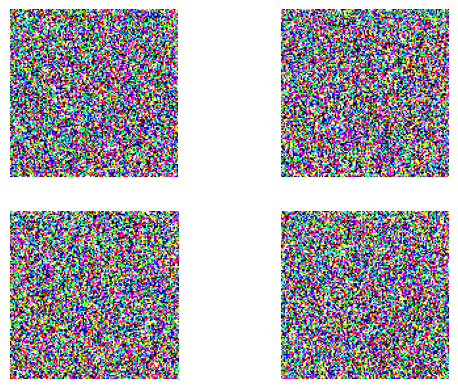

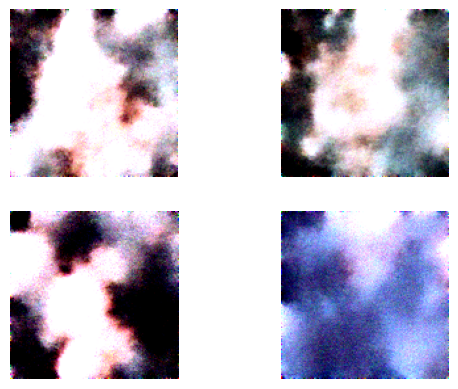

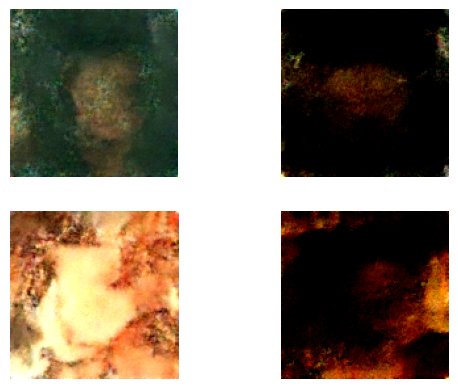

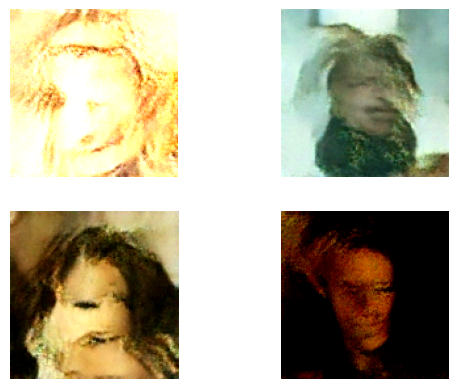

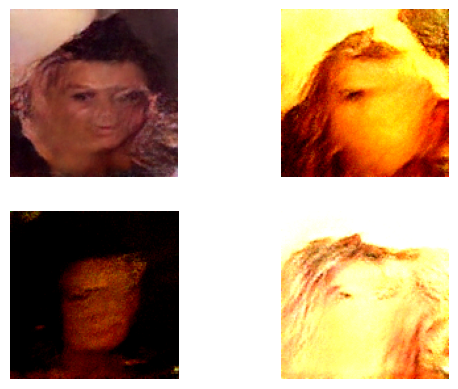

...

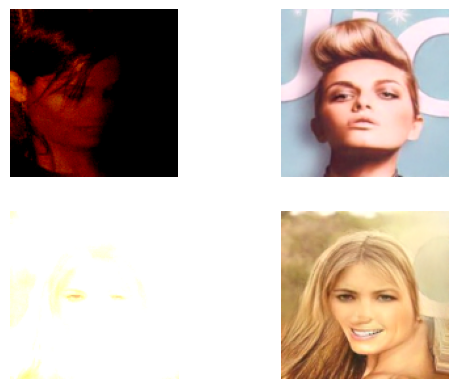

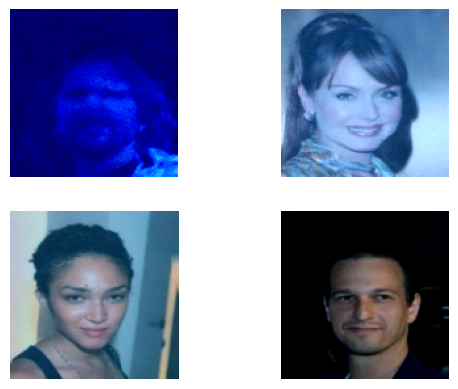

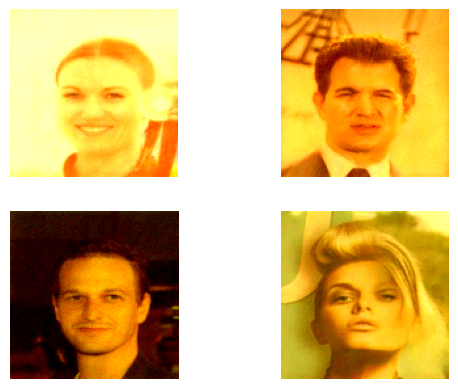

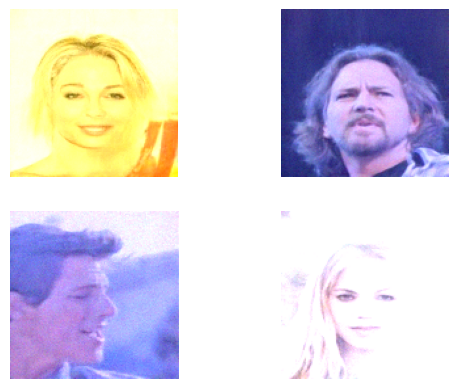

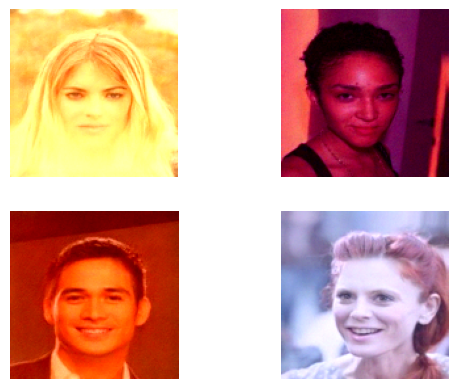

In [ ]:

subset_dataset = Subset(dataset, indices)
dataloader = torch.utils.data.DataLoader(subset_dataset, batch_size=batch_size, shuffle=True, drop_last=True)

# Setup Model
model = UNet(in_ch = img_channel)
model.to(g_device)
optimizer = torch.optim.Adam(model.parameters(), lr=2e-5)
diffusion_model = DiffusionModel(n_steps, model, g_device)

# Training
loss_lst = []
loss_best = float('inf')
for ep in range(epoches):
    # print(f"Epoch - {ep}")
    tq = tqdm(enumerate(dataloader), total = len(dataloader), desc="Training")
    loss_e = 0
    for i, x0, in tq:
        x0 = x0[0].to(g_device)
        _loss = diffusion_model.training(x0, batch_size, optimizer)
        loss_lst.append(_loss)
        loss_e += _loss
        tq.set_description(f"Epoch - {ep} / {epoches}- Loss: {loss_e:.5f}; step {i}; epoch {ep}")
    g_writer.add_scalar("Loss/Sum", loss_e, ep)
    g_writer.add_scalar("Loss/AVG", loss_e/len(dataloader), ep)

    if loss_e < loss_best:
        print(f"best loss : {loss_e}")
        loss_best = loss_e
        _model_path = os.path.join(g_model_path, f'unet_best.pth')
        torch.save(diffusion_model.function_approximator.state_dict(), _model_path)

    _model_path = os.path.join(g_model_path, f'unet_last.pth')
    torch.save(diffusion_model.function_approximator.state_dict(), _model_path)


    diffusion_model.function_approximator.eval()
    if ep % (nsample*10) == 0 or ep == epoches-1:
        _, t_list = diffusion_model.sampling(n_samples=nb_images, image_channels=img_channel, img_size=(128, 128))
        vfp = os.path.join(g_video_path, f"test_{ep:03d}.mp4")
        save_video(t_list, 2, 2, vfp)

        st = time.time()
        samples = diffusion_model.ddpm_sampling(n_samples=nb_images, image_channels=img_channel, img_size=(128, 128), use_tqdm=True)
        # print(f"DDPM-Sampling {time.time() - st } seconds")
        ddpm_sampling_ts = time.time() - st
        img_op = os.path.join(g_video_path, f"ddpm_{ep:03d}.jpg")
        samples = (samples.to("cpu") + 1) * 0.5
        ts.save(samples, img_op, ncols = 2)

        st = time.time()
        samples = diffusion_model.ddim_sampling(n_samples=nb_images, image_channels=img_channel, img_size=(128, 128), use_tqdm=True)
        # print(f"DDIM-Sampling {time.time() - st } seconds")
        ddim_sampling_ts = time.time() - st
        img_op = os.path.join(g_video_path, f"ddim_{ep:03d}.jpg")
        samples = (samples.to("cpu") + 1) * 0.5
        ts.save(samples, img_op, ncols = 2)

        st = time.time()
        samples = diffusion_model.dpm_solver_sampling(n_samples=nb_images, n_steps=10, image_channels=img_channel, img_size=(128, 128), use_tqdm=True)
        # print(f"DPM-Solver-Sampling {time.time() - st } seconds")
        dpm_sampling_ts = time.time() - st
        img_op = os.path.join(g_video_path, f"dpm_solver_{ep:03d}.jpg")
        samples = (samples.to("cpu") + 1) * 0.5
        ts.save(samples, img_op, ncols = 2)

        print(f"ddpm - {ddpm_sampling_ts:.5f}, ddim - {ddim_sampling_ts:.5f}, dpm_sampling - {dpm_sampling_ts:.5f}")


    diffusion_model.function_approximator.train()

plt.plot(loss_lst)
plt.show()